In [1]:
from scipy.stats import gaussian_kde
import numpy as np 
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (4, 3)     # default figure size
plt.rcParams["axes.grid"] = True            # enable grid on all axes
plt.rcParams["figure.autolayout"] = True 
import pickle
import seaborn as sns
from itertools import cycle
from matplotlib.ticker import MaxNLocator, FormatStrFormatter
import pandas as pd
from scipy import stats
from mpl_toolkits.mplot3d import Axes3D  # noqa: F401
import torch
import plotly.graph_objects as go
import ipywidgets as widgets
from IPython.display import display
import torch.nn as nn
from stable_baselines3 import DQN
import re
import gymnasium as gym

# Aux Functions

In [2]:
def plotly_eye_to_view_init(eye):
    """
    Convert a Plotly camera 'eye' dict to Matplotlib view_init(elev, azim).
    eye: dict like {'x': ..., 'y': ..., 'z': ...}
    """
    x, y, z = eye["x"], eye["y"], eye["z"]
    azim = np.degrees(np.arctan2(y, x))
    r_xy = np.hypot(x, y)
    elev = np.degrees(np.arctan2(z, r_xy))
    return elev, azim

In [3]:
def save_action_surface_pdf(
    elev, azim, action_idx, q_values, n_grid, time_pct, inv_pct, filename="q_surface_action.pdf",
    global_vmin=None, global_vmax=None, cmap="plasma"
):
    Z = q_values[:, action_idx].reshape(n_grid, n_grid)

    vmin = np.nanmin(Z) if global_vmin is None else global_vmin
    vmax = np.nanmax(Z) if global_vmax is None else global_vmax

    # Bigger canvas; we’ll leave generous margins
    fig = plt.figure(figsize=(8.0, 6.0))
    ax = fig.add_subplot(111, projection='3d')
    ax.set_proj_type('ortho')  # cleaner text (less perspective distortion)

    # Surface colored by Q-value (viridis ~ Plotly)
    surf = ax.plot_surface(
        time_pct, inv_pct, Z,
        cmap=cmap, vmin=vmin, vmax=vmax,
        rstride=1, cstride=1, linewidth=0, antialiased=True
    )

    # Labels & ticks
    ax.set_xlabel("Time (%)", labelpad=10)
    ax.set_ylabel("Remaining Inventory (%)", labelpad=10)

    ax.zaxis.set_rotate_label(False)                 # keep our rotation
    ax.set_zlabel("Q-value", rotation=90, labelpad=10)  # bottom→top

    ax.set_xlim(0, 100); ax.set_ylim(0, 100)
    ax.set_xticks(np.arange(0, 101, 20))
    ax.set_yticks(np.arange(0, 101, 20))
    ax.tick_params(pad=4)
    ax.set_box_aspect((1, 1, 0.8))
    ax.view_init(elev=elev, azim=azim)

    # Slim colorbar with clear label
    cbar = fig.colorbar(surf, ax=ax, shrink=0.82, pad=0.10)
    # cbar.set_label("Q-value")

    # Give extra room so axis labels never clip
    fig.subplots_adjust(left=0.16, right=0.92, bottom=0.16, top=0.98)

    # Safe vector export
    fig.savefig(filename, format="pdf", bbox_inches="tight", pad_inches=0.30)
    plt.close(fig)


In [4]:
def compute_t_test(types, run_names, size=20_000, reference='ddqn', side='greater'):
    dic_is = {}
    for typ, run_name in zip(types, run_names):
        with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
            dic = pickle.load(f)
        final_is = np.array(dic['final_is'])
        final_is = np.random.choice(final_is, size=size, replace=False)
        dic_is[typ] = final_is

    for typ in types:
        if typ != reference:
            t_stat, p_value = stats.ttest_ind(dic_is[reference], dic_is[typ], equal_var=False, alternative=side)
            print(f'T-test between {reference} and {typ}: t-statistic = {t_stat:.4f}, p-value = {p_value:.4f}')
            if p_value < 0.05:
                print(f'Statistically significant difference between {reference} and {typ} (p < 0.05)')
            print('\n')


In [5]:
def plot_mean_distance_boxplots(executed, trader_times, run_id=None):
    """
    For each run in `executed` (a dict of run_id → list of executed volumes),
    compute the mean number of zeros between consecutive non-zero volumes
    (i.e. the “gap” length), group those means by the length of the run,
    and draw a boxplot for each possible run length 1..len(trader_times)-1.
    
    Parameters
    ----------
    executed : dict[int, list[int]]
        Keys are run IDs; values are lists of volumes (integers) executed
        at each trader time step (zeros allowed).
    trader_times : Sequence
        Any sequence whose length defines the maximum possible run length.
    """
    # x-axis values: 1, 2, ..., len(trader_times)-1
    x_vals = list(range(1, len(trader_times)))
    
    def mean_zero_gap(vols):
        # find indices of non-zero executions
        idxs = [i for i, v in enumerate(vols) if v != 0]
        # need at least two to form a “gap”
        if len(idxs) < 2:
            return None
        # gap = count of zeros between each pair of non-zeros
        gaps = [idxs[i+1] - idxs[i] - 1 for i in range(len(idxs)-1)]
        return sum(gaps) / len(gaps)
    
    # initialize storage for each possible length
    grouped = {L: [] for L in x_vals}
    
    # compute mean gap for each run, bucket by run length
    for i, vols in executed.items():
        L = len(vols)
        if L in grouped:
            mg = mean_zero_gap(vols) 
            if mg is not None:
                grouped[L].append(mg)
    
    # prepare data & positions for boxplot (skip lengths with no data)
    data   = []
    pos    = []
    for L in x_vals:
        if grouped[L]:
            data.append(grouped[L])
            pos.append(L)
    
    # draw
    plt.figure(figsize=(5, 4))
    plt.boxplot(data, positions=pos, widths=0.6, showfliers=False)
    plt.xlabel('Episode length')
    plt.ylabel('Mean gap between executions')
    plt.grid(axis='y', linestyle='--', alpha=0.5)
    ax = plt.gca()
    ax.set_xlim(min(pos) - 0.5, max(pos) + 0.5)
    ax.xaxis.set_major_locator(MaxNLocator(nbins=6, integer=True, prune='both'))
    ax.xaxis.set_major_formatter(FormatStrFormatter('%d'))
    plt.tight_layout()
    plt.savefig(f"/scratch/network/te6653/qrm_optimal_execution/plots/gaps/{run_id}.pdf", bbox_inches="tight")

    plt.figure(figsize=(5, 4))
    plt.boxplot(data, positions=pos, widths=0.6)
    plt.xlabel('Episode length')
    plt.ylabel('Mean gap between executions')
    plt.grid(axis='y', linestyle='--', alpha=0.5)
    ax = plt.gca()
    ax.set_xlim(min(pos) - 0.5, max(pos) + 0.5)
    ax.xaxis.set_major_locator(MaxNLocator(nbins=6, integer=True, prune='both'))
    ax.xaxis.set_major_formatter(FormatStrFormatter('%d'))
    plt.tight_layout()
    plt.savefig(f"/scratch/network/te6653/qrm_optimal_execution/plots/gaps/{run_id}_outliers.pdf", bbox_inches="tight")
    plt.show()


In [6]:
def plot_intra_mean_distance_boxplots(executed, trader_times, run_id=None):
    """
    For each run in `executed` (a dict of run_id → list of executed volumes),
    compute the mean number of zeros between consecutive non-zero volumes
    (i.e. the “gap” length), group those means by the length of the run,
    and draw a boxplot for each possible run length 1..len(trader_times)-1.
    
    Parameters
    ----------
    executed : dict[int, list[int]]
        Keys are run IDs; values are lists of volumes (integers) executed
        at each trader time step (zeros allowed).
    trader_times : Sequence
        Any sequence whose length defines the maximum possible run length.
    """
    # x-axis values: 1, 2, ..., len(trader_times)-1
    x_vals = list(range(1, len(trader_times)))
    
    def var_zero_gap(vols):
        # find indices of non-zero executions
        idxs = [i for i, v in enumerate(vols) if v != 0]
        # need at least two to form a “gap”
        if len(idxs) < 2:
            return None
        # gap = count of zeros between each pair of non-zeros
        gaps = [idxs[i+1] - idxs[i] - 1 for i in range(len(idxs)-1)]
        return np.var(gaps)
    
    # initialize storage for each possible length
    grouped = {L: [] for L in x_vals}
    
    # compute mean gap for each run, bucket by run length
    for i, vols in executed.items():
        L = len(vols)
        if L in grouped:
            mg = var_zero_gap(vols) 
            if mg is not None:
                grouped[L].append(mg)
    
    # prepare data & positions for boxplot (skip lengths with no data)
    data   = []
    pos    = []
    for L in x_vals:
        if grouped[L]:
            data.append(grouped[L])
            pos.append(L)
    
    # draw
    plt.figure(figsize=(5, 4))
    plt.boxplot(data, positions=pos, widths=0.6, showfliers=False)
    plt.xlabel('Episode length')
    plt.ylabel('Mean gap between executions')
    plt.grid(axis='y', linestyle='--', alpha=0.5)
    ax = plt.gca()
    ax.set_xlim(min(pos) - 0.5, max(pos) + 0.5)
    ax.xaxis.set_major_locator(MaxNLocator(nbins=6, integer=True, prune='both'))
    ax.xaxis.set_major_formatter(FormatStrFormatter('%d'))
    plt.tight_layout()
    plt.savefig(f"/scratch/network/te6653/qrm_optimal_execution/plots/gaps/variance_{run_id}.pdf", bbox_inches="tight")

    plt.figure(figsize=(5, 4))
    plt.boxplot(data, positions=pos, widths=0.6)
    plt.xlabel('Episode length')
    plt.ylabel('Mean gap between executions')
    plt.grid(axis='y', linestyle='--', alpha=0.5)
    ax = plt.gca()
    ax.set_xlim(min(pos) - 0.5, max(pos) + 0.5)
    ax.xaxis.set_major_locator(MaxNLocator(nbins=6, integer=True, prune='both'))
    ax.xaxis.set_major_formatter(FormatStrFormatter('%d'))
    plt.tight_layout()
    plt.savefig(f"/scratch/network/te6653/qrm_optimal_execution/plots/gaps/variance_{run_id}_outliers.pdf", bbox_inches="tight")
    plt.show()


In [7]:
def plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True,
    best_labels=None,
    run_id=None
):
    # --- Load all final_IS and inventory dicts ---
    final_is = {}
    actions = {}
    ddqn_lengths = []

    for lbl, rn in zip(run_labels, run_names):
        with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{rn}.pkl', 'rb') as f:
            dic = pickle.load(f)
        final_is[lbl] = np.asarray(dic['final_is'])
        exec_dict = dic[metric]
        actions[lbl] = exec_dict
        if lbl == 'DDQN':
            seqs = [exec_dict[i] for i in sorted(exec_dict)]
            ddqn_lengths = [len(seq) for seq in seqs]

    # --- Prepare x-grids for IS plots ---
    maxi = max(np.max(np.abs(v)) for v in final_is.values())
    x_sym = np.linspace(-maxi, maxi, 1000)
    all_vals = np.concatenate(list(final_is.values()))
    x_auto = np.linspace(all_vals.min(), all_vals.max(), 1000)

    # filename prefix
    safe_title = re.sub(r'[^-\w]+', '_', title) if title else 'overview'
    prefix = f"{safe_title}" + (f"_{run_id}" if run_id is not None else "")

    # ===============================
    # Figure 1: IS KDE (all methods), symmetric limits
    # ===============================
    fig1, ax1 = plt.subplots(figsize=(4,3))
    labels_to_plot = final_is.keys()
    if not kde_only:
        for lbl in labels_to_plot:
            vals = final_is[lbl]
            ax1.hist(vals, bins=27, density=True, alpha=0.3, label=f'{lbl} hist')

    for lbl in labels_to_plot:
        print(f'[{lbl}] IS: mean={final_is[lbl].mean():.3f}, std={final_is[lbl].std():.3f} \n')
        vals = final_is[lbl]
        kde = gaussian_kde(vals)
        y = kde(x_sym)
        if lbl != 'DDQN':
            ax1.plot(x_sym, y, label=lbl)
        else:
            ax1.plot(x_sym, y, linestyle='--', color='C3', label=lbl)

    # ax1.set_title(f"{title} — IS (all methods, symmetric)", fontsize=11)
    ax1.set_xlabel('Implementation Shortfall')
    ax1.set_ylabel('Density')
    extra = 2.5
    ax1.set_xlim(x_sym.min() + extra, x_sym.max() - extra)
    ax1.grid(True)
    ax1.legend()
    fig1.tight_layout()
    fig1.savefig(f"/scratch/network/te6653/qrm_optimal_execution/plots/overview/{run_id}_subplot_1.pdf", bbox_inches="tight")


    # ===============================
    # Figure 2: IS KDE (best performing) auto-limits
    # ===============================
    fig2, ax2 = plt.subplots(figsize=(4,3))
    labels_to_plot = best_labels if (best_labels is not None) else final_is.keys()

    if not kde_only:
        for lbl in labels_to_plot:
            vals = final_is[lbl]
            ax2.hist(vals, bins=27, density=True, alpha=0.3, label=f'{lbl} hist')

    for lbl in labels_to_plot:
        vals = final_is[lbl]
        kde = gaussian_kde(vals)
        y = kde(x_auto)
        if lbl != 'DDQN':
            ax2.plot(x_auto, y, label=lbl)
        else:
            ax2.plot(x_auto, y, linestyle='--', color='C3', label=lbl)

    # ax2.set_title(f"{title} — IS (best performing, auto-limits)", fontsize=11)
    ax2.set_xlabel('Implementation Shortfall')
    ax2.set_ylabel('Density')
    ax2.grid(True)
    ax2.legend()
    fig2.tight_layout()
    fig2.savefig(f"/scratch/network/te6653/qrm_optimal_execution/plots/overview/{run_id}_subplot_2.pdf", bbox_inches="tight")

    # ===============================
    # Figure 3: Avg. Inventory Trajectory (μ ± σ/2)
    # ===============================
    fig3, ax3 = plt.subplots(figsize=(4,3))
    for lbl, exec_dict in actions.items():
        seqs = [exec_dict[i] for i in sorted(exec_dict)]
        inv = np.zeros((len(seqs), len(trader_times)))
        for i, seq in enumerate(seqs):
            inv[i, :len(seq)] = seq
        inv = np.cumsum(inv, axis=1) / initial_inventory

        # Stats
        mask = inv[:, -1] < 1 # Runs that did not reach full inventory
        pct = np.mean(mask) * 100
        if np.any(mask):
            inv_abs = inv[mask] * initial_inventory
            missing = initial_inventory - inv_abs[:, -1]
            avg_missing = np.mean(missing)
            std_missing = np.std(missing)
            max_missing = np.max(missing)
            print(f'[{lbl}] {pct:.4f}% of runs did not reach full inventory')
            print(f'    Missing volume: avg={avg_missing:.2f}, std={std_missing:.2f}, max={max_missing:.2f}\n')
        else:
            print(f'[{lbl}] 0.0000% of runs did not reach full inventory')

        mu = inv.mean(axis=0)
        s = inv.std(axis=0)
        x_vals = np.arange(1, len(trader_times) + 1)
        if lbl != 'DDQN':
            ax3.plot(x_vals, mu, label=lbl)
            ax3.fill_between(x_vals, mu - s/2, mu + s/2, alpha=0.2)
        else:
            ax3.plot(x_vals, mu, linestyle='--', color='C3', label=lbl)
            ax3.fill_between(x_vals, mu - s/2, mu + s/2, alpha=0.2, color='C3')

    ax3.set_xlim(1, len(trader_times))
    ax3.set_xlabel('Trader Step')
    ax3.set_ylabel('Executed Inventory (%)')
    # ax3.set_title(f"{title} — Avg. Inventory Trajectory (μ ± σ/2)", fontsize=11)
    ax3.grid(True)
    ax3.legend()
    fig3.tight_layout()
    fig3.savefig(f"/scratch/network/te6653/qrm_optimal_execution/plots/overview/{run_id}_subplot_3.pdf", bbox_inches="tight")

    # ===============================
    # Figure 4: DDQN Episode Lengths (PDF + ECDF)
    # ===============================
    times = np.array(ddqn_lengths)
    fig4, ax4 = plt.subplots(figsize=(4,3))
    max_len = len(trader_times)
    bin_edges = np.arange(0.5, max_len + 1.5, 1)

    ax4.hist(times, bins=bin_edges, density=True, alpha=0.9, color='C3', label='Density')
    ax4b = ax4.twinx()
    sorted_t = np.sort(times)
    ecdf = np.arange(1, len(sorted_t) + 1) / len(sorted_t)
    ax4b.step(sorted_t, ecdf, where='post', color='k', label='ECDF')

    ax4.set_xlabel('Trader Step')
    ax4.set_ylabel('Density', color='k')
    ax4b.set_ylabel('ECDF', color='k')
    # ax4.set_title(f"{title} — Episode Length", fontsize=11)
    ax4.grid(True, which='both')
    ax4.set_xlim(0.5, max_len + 0.5)
    ax4b.set_xlim(ax4.get_xlim())
    ax4.xaxis.set_major_locator(MaxNLocator(nbins=6, integer=True, prune='both'))
    ax4.xaxis.set_major_formatter(FormatStrFormatter('%d'))

    # single combined legend
    h1, l1 = ax4.get_legend_handles_labels()
    h2, l2 = ax4b.get_legend_handles_labels()
    ax4.legend(h1 + h2, l1 + l2, loc='best')

    fig4.tight_layout()
    fig4.savefig(f"/scratch/network/te6653/qrm_optimal_execution/plots/overview/{run_id}_subplot_4.pdf", bbox_inches="tight")
    plt.show()


# Useless/Deprecated Functions

In [ ]:
def plot_delta_price_and_lengths(
    run_names,
    run_labels,
    p_ref: float = 100.005,
    print_stats: bool = False
):
    """
    Plot side-by-side KDEs of:
      • final_price − p_ref
      • episode lengths
    for each method in run_labels/run_names.
    """
    # 1) Load data
    final_prices = {}
    lengths = {}
    for lbl, rn in zip(run_labels, run_names):
        with open(f'data_wandb/dictionaries/{rn}.pkl', 'rb') as f:
            dic = pickle.load(f)
        # final price diff
        prices = dic['mid_prices_events']
        final_prices[lbl] = np.array([prices[k][-1] for k in sorted(prices)]) - p_ref
        # episode lengths
        lengths[lbl] = np.array([len(prices[k]) for k in sorted(prices)])

    # 2) Create subplots
    fig, (ax_price, ax_len) = plt.subplots(1, 2, figsize=(9, 4), sharey=False)

    # 3) Plot price diffusivity KDEs
    for lbl, values in final_prices.items():
        if print_stats:
            print(f'[{lbl}] price diff: mean={values.mean():.3f}, std={values.std():.3f}')
        kde = gaussian_kde(values)
        x = np.linspace(values.min(), values.max(), 1000)
        y = kde(x)
        if lbl != 'DDQN':
            ax_price.plot(x, y, label=lbl)
        else:
            ax_price.plot(x, y, linestyle='--', color='C3', label=lbl)

    ax_price.set_title('Price Diffusivity', fontsize=12)
    ax_price.set_xlabel(r'$\Delta$P = Final – Initial Price')
    ax_price.set_ylabel('Density')
    ax_price.grid(True, linestyle=':', alpha=0.7)
    ax_price.legend(fontsize=9)

    # 4) Plot episode length KDEs
    for lbl, values in lengths.items():
        if print_stats:
            print(f'[{lbl}] length: mean={values.mean():.1f}, std={values.std():.1f}')
        kde = gaussian_kde(values)
        x = np.linspace(values.min(), values.max(), 1000)
        y = kde(x)
        if lbl != 'DDQN':
            ax_len.plot(x, y, label=lbl)
        else:
            ax_len.plot(x, y, linestyle='--', color='C3', label=lbl)

    ax_len.set_title('Episode Length', fontsize=11)
    ax_len.set_xlabel('Episode Length')
    ax_len.set_ylabel('Density')
    ax_len.grid(True, linestyle=':', alpha=0.7)
    ax_len.legend(fontsize=9)

    # 5) Final layout
    plt.tight_layout()
    plt.show()


In [ ]:
def plot_length_by_percents(
    ax,
    mid_prices_events: dict,
    cut_percent_list: list,
    title: str,
    which: str = 'longest',
    kde_only: bool = True,
    p_ref: float = 100.005
):
    """
    Draw on `ax` the KDE of all episode lengths plus KDEs of the
    top‐percent longest or shortest episodes, where percentiles are
    computed on (final_price − p_ref).

    Parameters
    ----------
    ax : matplotlib Axes
        Axis to draw on.
    mid_prices_events : dict[int, list[float]]
        {episode_idx: list of mid‐prices for that episode}.
    cut_percent_list : list of float
        Percentiles p to trim both tails of (final_price − p_ref),
        e.g. [5, 10, 25].
    title : str
        Plot title.
    which : {'longest', 'shortest'}, default='longest'
        If 'longest', keep episodes with final deviations ≥ the
        (100−p)th percentile; if 'shortest', keep ≤ the pth percentile.
    kde_only : bool, default=True
        If False, plot histogram of all lengths behind the KDE.
    p_ref : float, default=100.005
        Reference price to subtract from each episode's final price.
    """
    # 1) sort keys, compute final deviations & lengths
    keys = sorted(mid_prices_events)
    final_prices = np.array([mid_prices_events[k][-1] for k in keys])
    filter_array = final_prices - p_ref
    lengths = np.array([len(mid_prices_events[k]) for k in keys])

    # 2) prepare x‑grid over lengths
    x = np.linspace(lengths.min(), lengths.max(), 1000)

    # 3) optional histogram of all lengths
    if not kde_only:
        bin_edges = np.arange(lengths.min() - 0.5,
                              lengths.max() + 1.5, 1)
        ax.hist(lengths,
                bins=bin_edges,
                density=True,
                alpha=0.3,
                color='gray',
                label='All episodes (hist)')

    # 4) full-data KDE
    kde_all = gaussian_kde(lengths)
    y_all = kde_all(x)
    ax.plot(x, y_all,
            color='k',
            lw=2,
            label='All episodes')

    # 5) colors for percentile curves
    colors = plt.rcParams['axes.prop_cycle'].by_key()['color'][1:]
    
    # 6) overlay each percentile subset
    for pct, col in zip(cut_percent_list, colors):
        if which == 'longest':
            cutoff = np.percentile(filter_array, 100 - pct)
            mask = filter_array >= cutoff
            label = rf'Top {pct}% $\Delta$P'
        elif which == 'shortest':
            cutoff = np.percentile(filter_array, pct)
            mask = filter_array <= cutoff
            label = rf'Bottom {pct}% $\Delta$P'
        else:
            raise ValueError("`which` must be 'longest' or 'shortest'")

        lengths_sel = lengths[mask]
        kde_sel = gaussian_kde(lengths_sel)
        y_sel = kde_sel(x)

        ax.plot(x, y_sel,
                linestyle='--',
                color=col,
                lw=1.5,
                label=label)

    # 7) finalize styling
    ax.set_xlabel('Episode Length')
    ax.set_ylabel('Density')
    ax.set_title(title, fontsize=11)
    ax.grid(True)
    ax.legend()


In [ ]:
def plot_length_middle(
    mid_prices_events: dict,
    cut_percent_list: list,
    title: str,
    kde_only: bool = True,
    p_ref: float = 100.005
):
    """
    Plot KDE of episode lengths for all episodes, plus KDEs of the 'middle'
    episodes defined by trimming both tails of final price deviations.

    Parameters
    ----------
    mid_prices_events : dict
        {episode_idx: list of mid‐prices for that episode}.
    cut_percent_list : list of float
        Percentiles p at which to trim both tails of (final_price − p_ref),
        e.g. [5, 10, 45].
    title : str
        Plot title.
    kde_only : bool, default=True
        If False, draw a histogram of all episode lengths behind the KDEs.
    p_ref : float, default=100.005
        Reference price to subtract from each episode's final price.
    """
    plt.figure(figsize=(5, 4))
    # 1) Extract final price deviations and lengths
    keys = sorted(mid_prices_events)
    final_prices = np.array([mid_prices_events[k][-1] for k in keys])
    filter_array = final_prices - p_ref
    lengths = np.array([len(mid_prices_events[k]) for k in keys])

    # 2) Shared x‑grid over lengths
    x = np.linspace(lengths.min(), lengths.max(), 1000)

    # 3) Optional histogram of all lengths
    if not kde_only:
        bin_edges = np.arange(lengths.min() - 0.5,
                              lengths.max() + 1.5, 1)
        plt.hist(lengths,
                 bins=bin_edges,
                 density=True,
                 alpha=0.3,
                 color='gray',
                 label='All episodes (hist)')

    # 4) Full-data KDE of lengths
    kde_all = gaussian_kde(lengths)
    y_all = kde_all(x)
    plt.plot(x, y_all,
             color='k',
             lw=2,
             label='All episodes')

    # 5) KDEs of middle subsets for each cut percentile
    colors = plt.rcParams['axes.prop_cycle'].by_key()['color']
    color_iter = cycle(colors[1:])  # skip first (blue)

    for p, col in zip(cut_percent_list, color_iter):
        low_cut = np.percentile(filter_array, p)
        high_cut = np.percentile(filter_array, 100 - p)
        mask_mid = (filter_array >= low_cut) & (filter_array <= high_cut)

        lengths_mid = lengths[mask_mid]
        kde_mid = gaussian_kde(lengths_mid)
        y_mid = kde_mid(x)
        mid_pct = 100 - 2 * p

        plt.plot(x, y_mid,
                 linestyle='--',
                 color=col,
                 lw=1.5,
                 label=f'Middle {mid_pct:.0f}%')

    # 6) Final styling
    plt.xlabel('Episode Length')
    plt.ylabel('Density')
    plt.title(title, fontsize=11)
    plt.grid(True)
    plt.legend(fontsize=8)
    plt.tight_layout()
    plt.show()


In [ ]:
def plot_shortfall_middle(
    final_is,
    executed_dict,
    cut_percent_list,
    title,
    kde_only: bool = True
):
    """
    Plot KDE of all final IS plus KDEs for the 'middle' episodes,
    where for each p in cut_percent_list we remove the bottom p%
    and top p% of episodes (by length), plotting the middle (100‑2p)%.
    
    Parameters
    ----------
    final_is : array‑like, shape (n_episodes,)
        Final implementation shortfall for each episode.
    executed_dict : dict
        {episode_idx: list of executed quantities for that episode}.
    cut_percent_list : list of float
        Percentiles p for trimming both tails (e.g. [5, 10, 45]).
    title : str
        Plot title.
    kde_only : bool, default=True
        If False, draw a histogram of all IS behind the KDEs.
    """
    final_is = np.asarray(final_is)
    n = len(final_is)

    # 1) compute episode lengths
    lengths = np.array([len(executed_dict[i]) for i in range(n)])

    # 2) shared x‑grid
    maxi = np.max(np.abs(final_is))
    x = np.linspace(-maxi, maxi, 1000)

    plt.figure(figsize=(5, 4))
    # 3) optional histogram of all IS
    if not kde_only:
        plt.hist(final_is,
                 bins=27,
                 density=True,
                 alpha=0.3,
                 color='gray',
                 label='All episodes (hist)')

    # 4) full‑data KDE
    kde_all = gaussian_kde(final_is)
    y_all = kde_all(x)
    plt.plot(x, y_all,
             color='k',
             lw=2,
             label='All episodes')

    # 5) middle‑subset KDEs for each cut percentile
    colors = plt.rcParams['axes.prop_cycle'].by_key()['color']
    color_iter = cycle(colors[1:])  # skip black

    for p, col in zip(cut_percent_list, color_iter):
        low_cut  = np.percentile(lengths, p)
        high_cut = np.percentile(lengths, 100 - p)
        mask_mid = (lengths >= low_cut) & (lengths <= high_cut)

        IS_mid = final_is[mask_mid]
        kde_mid = gaussian_kde(IS_mid)
        y_mid   = kde_mid(x)
        pct_mid = 100 - 2 * p

        plt.plot(x, y_mid,
                 linestyle='--',
                 color=col,
                 lw=1.5,
                 label=f'Middle {pct_mid}%')

    # 6) finalize plot
    plt.xlabel('Implementation Shortfall')
    plt.ylabel('Density')
    plt.title(title, fontsize=11)
    plt.grid(True)
    plt.legend(loc='upper right')
    plt.tight_layout()
    plt.show()


In [ ]:
def plot_shortfall_by_percents(
    ax,
    final_is,
    executed_dict,
    top_percents,
    title,
    which: str = 'longest',
    kde_only: bool = True
):
    """
    Draw on `ax` the KDE of all final IS plus superimposed KDEs for
    top‐percent longest or shortest episodes.

    Parameters
    ----------
    ax : matplotlib Axes
    final_is : array‑like, shape (n_episodes,)
    executed_dict : dict {episode_idx: list of executed quantities}
    top_percents : list of float
    which : 'longest' or 'shortest'
    kde_only : bool
    """
    final_is = np.asarray(final_is)
    n = len(final_is)
    lengths = np.array([len(executed_dict[i]) for i in range(n)])
    # shared x‑grid
    maxi = np.max(np.abs(final_is))
    x = np.linspace(-maxi, maxi, 1000)

    # Optional histogram of all IS
    if not kde_only:
        ax.hist(final_is,
                bins=27,
                density=True,
                alpha=0.3,
                color='gray',
                label='All episodes (hist)')

    # Full‐data KDE
    kde_all = gaussian_kde(final_is)
    y_all = kde_all(x)
    ax.plot(x, y_all,
            color='k',
            lw=2,
            label='All episodes')

    # get colors for the percent curves (skip blue)
    default_colors = plt.rcParams['axes.prop_cycle'].by_key()['color']
    pct_colors = default_colors[1:]

    # Overlay each percentile subset
    for pct, col in zip(top_percents, pct_colors):
        if which == 'longest':
            cutoff = np.percentile(lengths, 100 - pct)
            mask = lengths >= cutoff
            label = f'Top {pct}% longest'
        elif which == 'shortest':
            cutoff = np.percentile(lengths, pct)
            mask = lengths <= cutoff
            label = f'Top {pct}% shortest'
        else:
            raise ValueError("`which` must be 'longest' or 'shortest'")

        IS_sel = final_is[mask]
        kde_sel = gaussian_kde(IS_sel)
        y_sel = kde_sel(x)

        ax.plot(x, y_sel,
                linestyle='--',
                color=col,
                lw=1.5,
                label=label)

    ax.set_xlabel('Implementation Shortfall')
    ax.set_ylabel('Density')
    title_dir = 'Longest' if which == 'longest' else 'Shortest'
    ax.set_title(title, fontsize=11)
    ax.grid(True)
    ax.legend(loc='upper right')


In [ ]:
def plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True,
    best_labels=None, 
    run_id=None
):
    """
    2×2 subplot:
      ┌───────────────────────┬───────────────────────────┐
      │ (0,0): IS KDE centered│ (0,1): inventory mean +   │
      │   symmetric around 0  │       ±σ/2 PDF/ECDF top   │
      ├───────────────────────┼───────────────────────────┤
      │ (1,0): IS KDE of best │ (1,1): episode length     │
      │  methods (auto‑limits)│        distribution       │
      └───────────────────────┴───────────────────────────┘

    best_labels: list of run_labels to include in bottom‑left plot
    """
    # --- Load all final_IS and inventory dicts ---
    final_is = {}
    actions = {}
    ddqn_lengths = []

    for lbl, rn in zip(run_labels, run_names):
        with open(f'data_wandb/dictionaries/{rn}.pkl', 'rb') as f:
            dic = pickle.load(f)
        final_is[lbl] = np.asarray(dic['final_is'])
        exec_dict = dic[metric]
        actions[lbl] = exec_dict
        if lbl == 'DDQN':
            seqs = [exec_dict[i] for i in sorted(exec_dict)]
            ddqn_lengths = [len(seq) for seq in seqs]

    # --- Prepare x‑grids for IS plots ---
    # symmetric grid
    maxi = max(np.max(np.abs(v)) for v in final_is.values())
    x_sym = np.linspace(-maxi, maxi, 1000)
    # auto grid for bottom‑left
    all_vals = np.concatenate(list(final_is.values()))
    x_auto = np.linspace(all_vals.min(), all_vals.max(), 1000)

    # --- Create 2×2 subplots ---
    fig, axes = plt.subplots(2, 2, figsize=(10, 7))
    ax_is_sym, ax_inv_top = axes[0]
    ax_is_auto, ax_inv_bot = axes[1]

    # ---- Left column: IS KDEs ----
    for k, (ax, x_grid, fix_limits) in enumerate([
        (ax_is_sym, x_sym, True),
        (ax_is_auto, x_auto, False)
    ]):
        # choose which labels to plot
        labels_to_plot = (
            best_labels if (k == 1 and best_labels is not None)
            else final_is.keys()
        )

        # optional histogram
        if not kde_only:
            for lbl in labels_to_plot:
                vals = final_is[lbl]
                ax.hist(vals, bins=27, density=True, alpha=0.3, label=f'{lbl} hist')

        # KDE curves
        for lbl in labels_to_plot:
            print(f'[{lbl}] IS: mean={final_is[lbl].mean():.3f}, std={final_is[lbl].std():.3f} \n')
            vals = final_is[lbl]
            kde = gaussian_kde(vals)
            y = kde(x_grid)
            if lbl != 'DDQN':
                ax.plot(x_grid, y, label=lbl)
            else:
                ax.plot(x_grid, y, linestyle='--', color='C3', label=lbl)

        ax.set_title(f"IS {'(all methods)' if fix_limits else '(best performing)'}", fontsize=11)
        ax.set_ylabel('Density')
        if not fix_limits:
            ax.set_xlabel('Implementation Shortfall')
        else:
            ax.set_xlabel('')
        ax.grid(True)
        if fix_limits:
            ax.set_xlim(x_grid.min(), x_grid.max())
        ax.legend()

    # ---- Top-right: average inventory ±σ/2 ----
    ax1 = ax_inv_top
    for lbl, exec_dict in actions.items():
        seqs = [exec_dict[i] for i in sorted(exec_dict)]
        inv = np.zeros((len(seqs), len(trader_times)))
        for i, seq in enumerate(seqs):
            inv[i, :len(seq)] = seq
        inv = np.cumsum(inv, axis=1) / initial_inventory
        mask = inv[:, -1] < 1 # Runs that did not reach full inventory
        pct = np.mean(mask) * 100
        if np.any(mask):
            inv_abs = inv[mask] * initial_inventory
            missing = initial_inventory - inv_abs[:, -1]
            avg_missing = np.mean(missing)
            std_missing = np.std(missing)
            max_missing = np.max(missing)
            print(f'[{lbl}] {pct:.4f}% of runs did not reach full inventory')
            print(f'    Missing volume: avg={avg_missing:.2f}, std={std_missing:.2f}, max={max_missing:.2f}\n')
        else:
            print(f'[{lbl}] 0.0000% of runs did not reach full inventory')
        mu = inv.mean(axis=0)
        s = inv.std(axis=0)
        x_vals = np.arange(1, len(trader_times) + 1)
        if lbl != 'DDQN':
            ax1.plot(x_vals, mu, label=lbl)
            ax1.fill_between(x_vals, mu - s/2, mu + s/2, alpha=0.2)
        else:
            ax1.plot(x_vals, mu, linestyle='--', color='C3', label=lbl)
            ax1.fill_between(x_vals, mu - s/2, mu + s/2, alpha=0.2, color='C3')
    

    ax1.set_xlim(1, len(trader_times))
    ax1.set_xlabel('Trader Step')
    ax1.set_ylabel('Executed Inventory (%)')
    ax1.set_title('Avg. Inventory Trajectory', fontsize=11)
    ax1.grid(True)
    ax1.legend()

    # ---- Bottom-right: DDQN episode lengths PDF + ECDF ----
    ax2 = ax_inv_bot
    times = np.array(ddqn_lengths)
    max_len = len(trader_times)
    bin_edges = np.arange(0.5, max_len + 1.5, 1)

    ax2.hist(times, bins=bin_edges, density=True, alpha=0.9,
             color='C3', label='Density')
    ax2b = ax2.twinx()
    sorted_t = np.sort(times)
    ecdf = np.arange(1, len(sorted_t) + 1) / len(sorted_t)
    ax2b.step(sorted_t, ecdf, where='post', color='k', label='ECDF')

    ax2.set_xlabel('Trader Step')
    ax2.set_ylabel('Density', color='C3')
    ax2b.set_ylabel('ECDF', color='k')
    ax2.set_title('Episode Length', fontsize=11)
    ax2.grid(True, which='both')
    ax2.set_xlim(0.5, max_len + 0.5)
    # ax2.set_xticks(np.arange(1, max_len + 1))
    ax2b.set_xlim(ax2.get_xlim())

    # combined legend
    l1, ll1 = ax2.get_legend_handles_labels()
    l2, ll2 = ax2b.get_legend_handles_labels()
    ax2b.legend(l1 + l2, ll1 + ll2, loc='best')

    plt.tight_layout()

    plt.show()

In [ ]:
def plot_inventory(initial_inventory, trader_times, run_names, run_labels, pdf_name, title, metric='executed'):
    """ 
        Plot the average executed inventory with PDF and ECDF superimposed.
    """

    actions = {}
    for i, run_name in enumerate(run_names):
        with open(f'data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
            dic = pickle.load(f)
        actions[run_labels[i]] = dic[metric]

    fig, (ax1, ax2) = plt.subplots(
        2, 1, figsize=(6, 6),
        gridspec_kw={'height_ratios': [3, 3]}
    )

    ep_lengths = []
    for key, values in actions.items():
        inventory = np.zeros((len(values), len(trader_times)))
        for i in range(len(values)):
            inventory[i][:len(values[i])] = values[i]
            if key == 'DDQN':
                ep_lengths.append(len(values[i])) 

        inventory = np.cumsum(inventory, axis=1) / initial_inventory
        mean_inventory = inventory.mean(axis=0)
        std_inventory = inventory.std(axis=0)

        if key != 'DDQN':
            ax1.plot(range(len(trader_times)), mean_inventory, label=key)
        else: 
            ax1.plot(range(len(trader_times)), mean_inventory, label=key, linestyle='--', color='C3')
        ax1.fill_between(
            range(len(trader_times)),
            mean_inventory - std_inventory,
            mean_inventory + std_inventory,
            alpha=0.3
        )
            
    ax1.set_ylabel('Executed Inventory (%)')
    ax1.set_title(f'Average Inventory Trajectory - {title}', fontsize=11)
    ax1.grid(True)
    ax1.legend()

    # --- PDF + ECDF on same axis ---
    # trader_time_step = trader_times[1] - trader_times[0]
    ep_times =np.array(ep_lengths) #  * trader_time_step

    # Left axis: PDF
    counts, bins, patches = ax2.hist(ep_times, bins=30, density=True, alpha=0.9, color='C3', label='Density')

    # Right axis: ECDF
    ax2b = ax2.twinx()
    sorted_times = np.sort(ep_times)
    ecdf = np.arange(1, len(sorted_times)+1) / len(sorted_times)
    ax2b.step(sorted_times, ecdf, where='post', color='k', label='ECDF')

    # Labels and styling
    ax2.set_xlabel('Trader Step')
    ax2.set_ylabel('Density', color='C3')
    ax2b.set_ylabel('ECDF', color='k')
    ax2.set_title('Episode Length Distribution', fontsize=11)
    ax2.grid(True, which='both')

    # Match x-limits for both axes
    ax2b.set_xlim(ax2.get_xlim())

    # Combine legends
    lines1, labels1 = ax2.get_legend_handles_labels()
    lines2, labels2 = ax2b.get_legend_handles_labels()
    ax2b.legend(lines1 + lines2, labels1 + labels2, loc='best')

    plt.tight_layout()
    # plt.savefig(f'plots/inventory/{pdf_name}.pdf', bbox_inches='tight')
    plt.show()
    plt.close()


In [ ]:
def plot_is(run_names, run_labels, pdf_name, title, kde_only=True):
    """   Plot the density of implementation shortfall"""
    final_is = {}

    for i, run_name in enumerate(run_names):
        with open(f'data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
            dic = pickle.load(f)
        final_is[run_labels[i]] = dic['final_is']

    plt.figure(figsize=(7, 5))

    maxi = max(
        max(np.abs(np.max(values)), np.abs(np.min(values)))
        for values in final_is.values()
    )
    x = np.linspace(-maxi, maxi, 1000)

    for key, values in final_is.items():
        print(f'Method {key}')
        print(f'Mean: {np.mean(values):.2f}, Std: {np.std(values):.2f} \n')
        kde = gaussian_kde(values)
        y_kde = kde(x)
        
        if not kde_only:
            plt.hist(values, bins=27, density=True, alpha=0.3, label=f'{key}')

        if key != 'DDQN':
            plt.plot(x, y_kde, label=f'{key}')
        else:
            plt.plot(x, y_kde, label=f'{key}', linestyle='--', color='C3')

    plt.xlabel('Implementation Shortfall')
    plt.ylabel('Density')
    plt.title(title, fontsize=11)
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    # plt.savefig(f'plots/implementation_shortfall/{pdf_name}.pdf', bbox_inches='tight')
    plt.show()

# Final Runs

## 3-dim: kfryeeez

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.386, std=0.473 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.0000% of runs did not reach full inventory


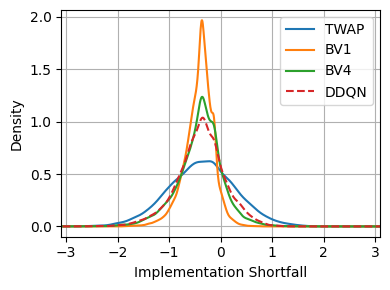

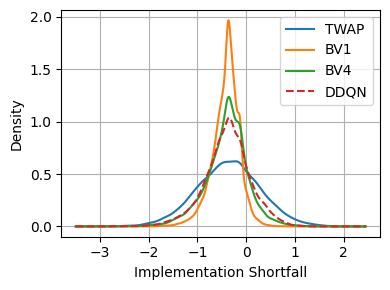

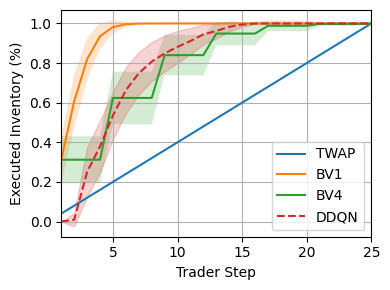

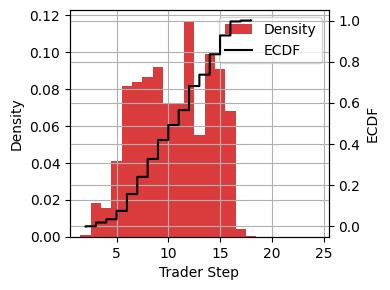

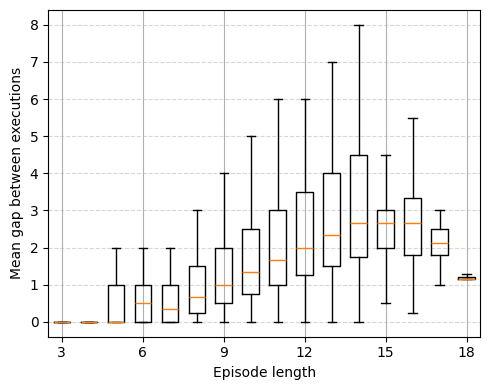

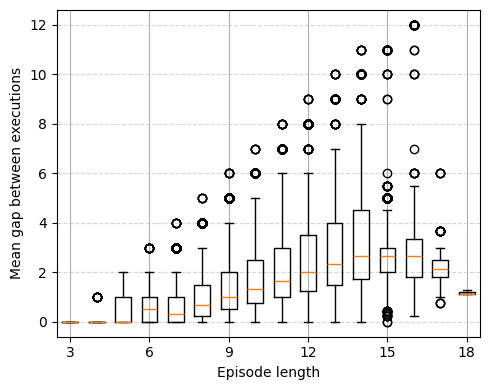

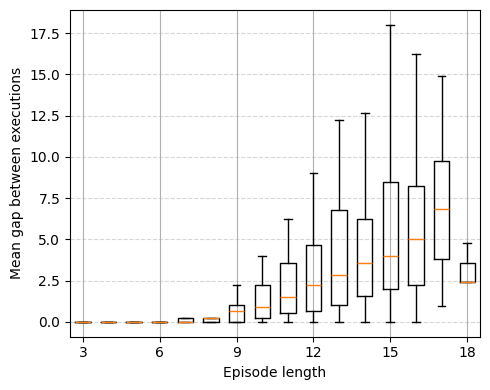

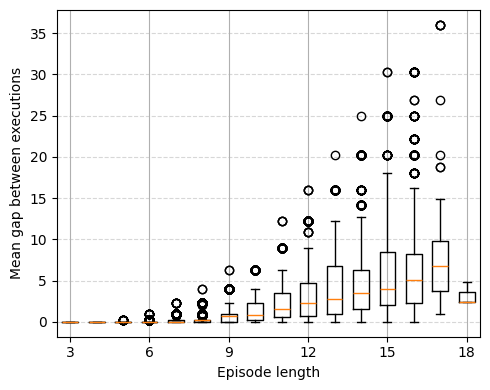

In [10]:
run_id = 'kfryeeez'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

T-test between ddqn and twap: t-statistic = 12.4261, p-value = 0.0000
Statistically significant difference between ddqn and twap (p < 0.05)


T-test between ddqn and front_load: t-statistic = 28.6044, p-value = 0.0000
Statistically significant difference between ddqn and front_load (p < 0.05)


T-test between ddqn and best_volume_4: t-statistic = 22.1021, p-value = 0.0000
Statistically significant difference between ddqn and best_volume_4 (p < 0.05)




: 

### Q values

unzip the saved model to load the NN weights

In [ ]:
class DummyEnv(gym.Env):
    def __init__(self):
        super().__init__()
        self.observation_space = gym.spaces.Box(
            low=-1.0, high=1.0, shape=(state_dim,), dtype=float
        )
        self.action_space = gym.spaces.Discrete(action_dim)

    def reset(self):
        return self.observation_space.sample(), {}

    def step(self, action):
        return self.observation_space.sample(), 0.0, True, False, {}

dummy_env = DummyEnv()

# --- Define same policy as training ---
policy_kwargs = dict(
    net_arch=[30, 30, 30, 30, 30],
    activation_fn=nn.LeakyReLU,
)

# --- Recreate model with dummy env ---
model = DQN(
    policy="MlpPolicy",
    env=dummy_env,
    policy_kwargs=policy_kwargs,
    device="cpu",  # or "cuda"
)

# --- Load NN weights ---
path = f"/scratch/network/te6653/qrm_optimal_execution/save_model/ddqn_{run_id}/policy.pth"
state_dict = torch.load(path, map_location=model.device)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# --- Now you can call the NN directly ---
obs = torch.zeros((1, state_dim))  # example input
q_values = model.policy.q_net(obs)
print("Q-values:", q_values)


Q-values: tensor([[-0.2623, -0.2399]], grad_fn=<AddmmBackward0>)


Pick the action: `show_action`

In [ ]:

# --- assume your SB3 DQN `model` is already created and loaded ---
model.policy.set_training_mode(False)
device = model.device

# ---- Parameters ----
times_min = -1.0
times_max = 1.0
inv_min   = -1.0
inv_max   =  1.0

price   = 0.0
ask_vol = 0.0
bid_vol = 0.0

# ---- Grids ----
n_grid = 101
times = np.linspace(times_min, times_max, n_grid, dtype=np.float32)
invs  = np.linspace(inv_min,   inv_max,   n_grid, dtype=np.float32)
T_raw, I_raw = np.meshgrid(times, invs)

# Percent axes for plotting
time_pct = (T_raw - times_min) / (times_max - times_min) * 100.0
inv_pct  = (I_raw  - inv_min)   / (inv_max   - inv_min)   * 100.0

# ---- Build (N, 5) batch of states from the raw grid ----
N = n_grid * n_grid
states = np.column_stack([
    I_raw.reshape(-1),            # inventory
    T_raw.reshape(-1),            # time
    np.full(N, price,   np.float32),
    np.full(N, ask_vol, np.float32),
    np.full(N, bid_vol, np.float32),
]).astype(np.float32)
obs = torch.as_tensor(states, device=device)

# ---- Get Q-values ----
with torch.no_grad():
    pi = model.policy
    try:
        if getattr(pi, "features_extractor", None) is not None:
            feats = pi.features_extractor(obs)
            q_tensor = pi.q_net(feats)
        else:
            feats = pi.extract_features(obs)
            q_tensor = pi.q_net(feats)
    except Exception:
        q_tensor = pi.q_net(obs)

q_values  = q_tensor.detach().cpu().numpy()
n_actions = q_values.shape[1]

# ---- Standard Plotly figure ----
fig = go.Figure()
for a in range(n_actions):
    Z = q_values[:, a].reshape(n_grid, n_grid)
    fig.add_trace(
        go.Surface(
            x=time_pct, y=inv_pct, z=Z,
            name=f"Action {a}",
            showscale=(a == 0),                 # one colorbar
            colorbar=(dict(title="Q-value") if a == 0 else None)
        )
    )

# show only the action you want initially
show_action = 1
for i in range(n_actions):
    fig.data[i].visible = (i == show_action)

fig.update_layout(
    scene=dict(
        xaxis_title="Time (%)",
        yaxis_title="Remaining Inventory (%)",
        zaxis_title="Q-value",
        aspectmode="cube",
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)),  # optional starting view
)

# ---- Use FigureWidget so UI rotations sync back to Python ----
figw = go.FigureWidget(fig)
display(figw)

# ✅ Correct callback signature: (layout, value)
def _on_cam_change(layout, camera_value):
    print("Updated camera:", camera_value)

figw.layout.on_change(_on_cam_change, 'scene.camera')

# Button to print the current camera on demand
btn = widgets.Button(description="Print current camera")
out = widgets.Output()

def _print_cam(_):
    with out:
        print(figw.layout.scene.camera)

btn.on_click(_print_cam)
display(btn, out)

fig.update_layout(scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)))

# IMPORTANT: don't call fig.show() here; it opens a non-synced view.


FigureWidget({
    'data': [{'colorbar': {'title': {'text': 'Q-value'}},
              'name': 'Action 0',
              'showscale': True,
              'type': 'surface',
              'uid': 'a2b088a9-6c2f-40d6-9807-71df2b1467e0',
              'visible': False,
              'x': {'bdata': ('AAAAAPD/fz8EAABAAABAQPz/f0ACAK' ... 'IAAMBCAADCQgAAxEIAAMZCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'y': {'bdata': ('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAA' ... 'IAAMhCAADIQgAAyEIAAMhCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'z': {'bdata': ('0FlZPLA8XTzQH2E8kAJlPEDlaDxIyG' ... '+KzcO/VN7Gvxzvyb/m/8y/shDQvw=='),
                    'dtype': 'f4',
                    'shape': '101, 101'}},
             {'name': 'Action 1',
              'showscale': False,
              'type': 'surface',
              'uid': 'a42c88c4-3b55-4dcf-b562-2662439f6e8b',
              'visible': True,
   

Button(description='Print current camera', style=ButtonStyle())

Output()

In [ ]:
plotly_eye = {'x': 2.2, 'y': 2.2, 'z': 1.3}
elev, azim = plotly_eye_to_view_init(plotly_eye)
save_action_surface_pdf(elev, azim, show_action, q_values, n_grid, time_pct, inv_pct, filename=f"/scratch/network/te6653/qrm_optimal_execution/plots/q_values/{run_id}_q_surface_action{show_action}.pdf")

: 

## 4-dim: uuc7cxji

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.325, std=0.594 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.1550% of runs did not reach full inventory
    Missing volume: avg=6.77, std=4.90, max=19.00



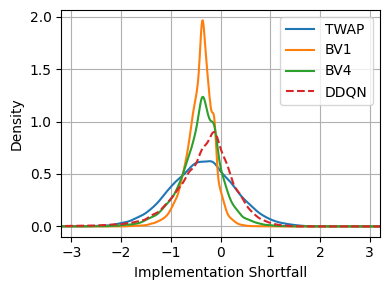

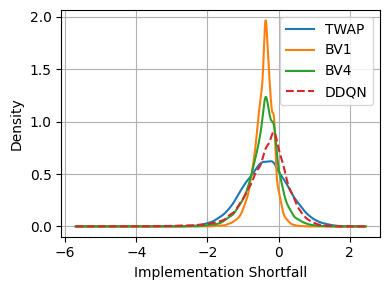

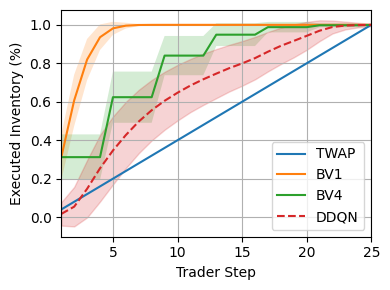

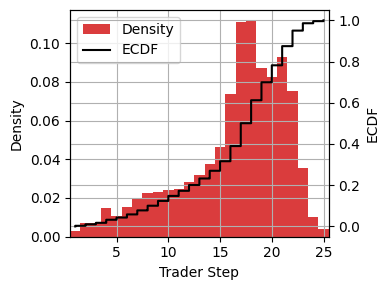

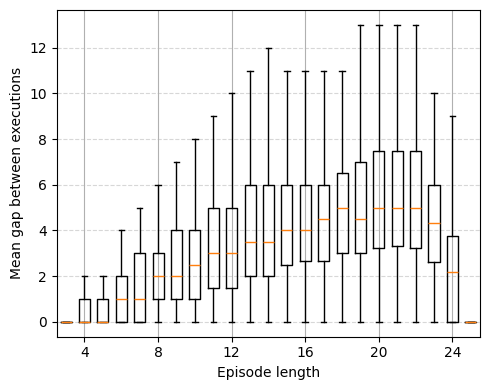

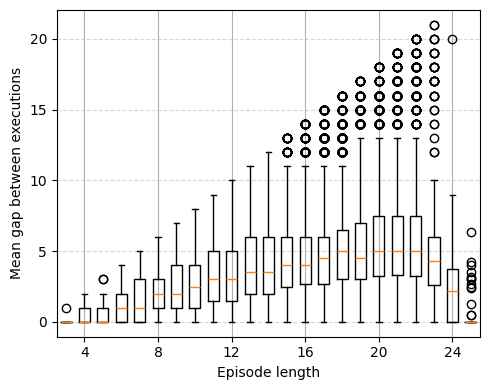

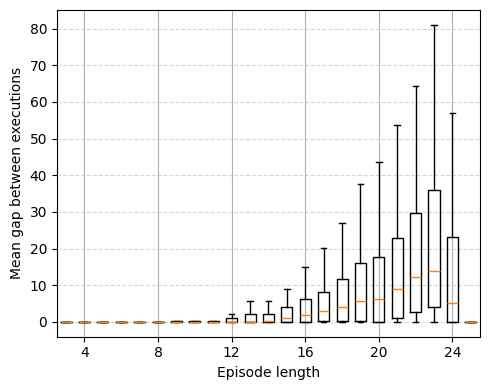

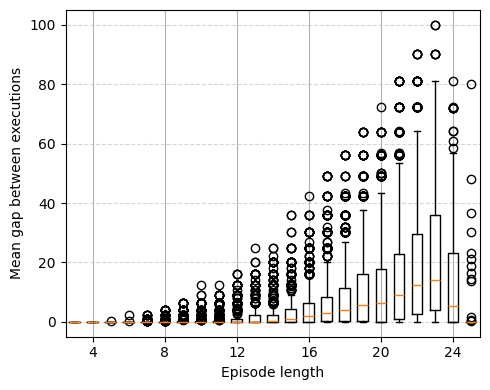

In [10]:
run_id = 'uuc7cxji'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [10]:
compute_t_test(types, run_names, reference='ddqn')

T-test between ddqn and twap: t-statistic = 6.3740, p-value = 0.0000
Statistically significant difference between ddqn and twap (p < 0.05)


T-test between ddqn and front_load: t-statistic = 19.0640, p-value = 0.0000
Statistically significant difference between ddqn and front_load (p < 0.05)


T-test between ddqn and best_volume_4: t-statistic = 14.1954, p-value = 0.0000
Statistically significant difference between ddqn and best_volume_4 (p < 0.05)




### Q values

unzip the saved model to load the NN weights

In [ ]:
class DummyEnv(gym.Env):
    def __init__(self):
        super().__init__()
        self.observation_space = gym.spaces.Box(
            low=-1.0, high=1.0, shape=(state_dim,), dtype=float
        )
        self.action_space = gym.spaces.Discrete(action_dim)

    def reset(self):
        return self.observation_space.sample(), {}

    def step(self, action):
        return self.observation_space.sample(), 0.0, True, False, {}

dummy_env = DummyEnv()

# --- Define same policy as training ---
policy_kwargs = dict(
    net_arch=[30, 30, 30, 30, 30],
    activation_fn=nn.LeakyReLU,
)

# --- Recreate model with dummy env ---
model = DQN(
    policy="MlpPolicy",
    env=dummy_env,
    policy_kwargs=policy_kwargs,
    device="cpu",  # or "cuda"
)

# --- Load NN weights ---
path = f"/scratch/network/te6653/qrm_optimal_execution/save_model/ddqn_{run_id}/policy.pth"
state_dict = torch.load(path, map_location=model.device)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# --- Now you can call the NN directly ---
obs = torch.zeros((1, state_dim))  # example input
q_values = model.policy.q_net(obs)
print("Q-values:", q_values)


Q-values: tensor([[-0.2623, -0.2399]], grad_fn=<AddmmBackward0>)


Pick the action: `show_action`

In [ ]:

# --- assume your SB3 DQN `model` is already created and loaded ---
model.policy.set_training_mode(False)
device = model.device

# ---- Parameters ----
times_min = -1.0
times_max = 1.0
inv_min   = -1.0
inv_max   =  1.0

price   = 0.0
ask_vol = 0.0
bid_vol = 0.0

# ---- Grids ----
n_grid = 101
times = np.linspace(times_min, times_max, n_grid, dtype=np.float32)
invs  = np.linspace(inv_min,   inv_max,   n_grid, dtype=np.float32)
T_raw, I_raw = np.meshgrid(times, invs)

# Percent axes for plotting
time_pct = (T_raw - times_min) / (times_max - times_min) * 100.0
inv_pct  = (I_raw  - inv_min)   / (inv_max   - inv_min)   * 100.0

# ---- Build (N, 5) batch of states from the raw grid ----
N = n_grid * n_grid
states = np.column_stack([
    I_raw.reshape(-1),            # inventory
    T_raw.reshape(-1),            # time
    np.full(N, price,   np.float32),
    np.full(N, ask_vol, np.float32),
    np.full(N, bid_vol, np.float32),
]).astype(np.float32)
obs = torch.as_tensor(states, device=device)

# ---- Get Q-values ----
with torch.no_grad():
    pi = model.policy
    try:
        if getattr(pi, "features_extractor", None) is not None:
            feats = pi.features_extractor(obs)
            q_tensor = pi.q_net(feats)
        else:
            feats = pi.extract_features(obs)
            q_tensor = pi.q_net(feats)
    except Exception:
        q_tensor = pi.q_net(obs)

q_values  = q_tensor.detach().cpu().numpy()
n_actions = q_values.shape[1]

# ---- Standard Plotly figure ----
fig = go.Figure()
for a in range(n_actions):
    Z = q_values[:, a].reshape(n_grid, n_grid)
    fig.add_trace(
        go.Surface(
            x=time_pct, y=inv_pct, z=Z,
            name=f"Action {a}",
            showscale=(a == 0),                 # one colorbar
            colorbar=(dict(title="Q-value") if a == 0 else None)
        )
    )

# show only the action you want initially
show_action = 1
for i in range(n_actions):
    fig.data[i].visible = (i == show_action)

fig.update_layout(
    scene=dict(
        xaxis_title="Time (%)",
        yaxis_title="Remaining Inventory (%)",
        zaxis_title="Q-value",
        aspectmode="cube",
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)),  # optional starting view
)

# ---- Use FigureWidget so UI rotations sync back to Python ----
figw = go.FigureWidget(fig)
display(figw)

# ✅ Correct callback signature: (layout, value)
def _on_cam_change(layout, camera_value):
    print("Updated camera:", camera_value)

figw.layout.on_change(_on_cam_change, 'scene.camera')

# Button to print the current camera on demand
btn = widgets.Button(description="Print current camera")
out = widgets.Output()

def _print_cam(_):
    with out:
        print(figw.layout.scene.camera)

btn.on_click(_print_cam)
display(btn, out)

fig.update_layout(scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)))

# IMPORTANT: don't call fig.show() here; it opens a non-synced view.


FigureWidget({
    'data': [{'colorbar': {'title': {'text': 'Q-value'}},
              'name': 'Action 0',
              'showscale': True,
              'type': 'surface',
              'uid': 'a2b088a9-6c2f-40d6-9807-71df2b1467e0',
              'visible': False,
              'x': {'bdata': ('AAAAAPD/fz8EAABAAABAQPz/f0ACAK' ... 'IAAMBCAADCQgAAxEIAAMZCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'y': {'bdata': ('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAA' ... 'IAAMhCAADIQgAAyEIAAMhCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'z': {'bdata': ('0FlZPLA8XTzQH2E8kAJlPEDlaDxIyG' ... '+KzcO/VN7Gvxzvyb/m/8y/shDQvw=='),
                    'dtype': 'f4',
                    'shape': '101, 101'}},
             {'name': 'Action 1',
              'showscale': False,
              'type': 'surface',
              'uid': 'a42c88c4-3b55-4dcf-b562-2662439f6e8b',
              'visible': True,
   

Button(description='Print current camera', style=ButtonStyle())

Output()

In [ ]:
plotly_eye = {'x': 2.2, 'y': 2.2, 'z': 1.3}
elev, azim = plotly_eye_to_view_init(plotly_eye)
save_action_surface_pdf(elev, azim, show_action, q_values, n_grid, time_pct, inv_pct, filename=f"/scratch/network/te6653/qrm_optimal_execution/plots/q_values/{run_id}_q_surface_action{show_action}.pdf")

: 

## 5-dim: k3631p6d

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.290, std=0.541 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.0150% of runs did not reach full inventory
    Missing volume: avg=2.33, std=0.94, max=3.00



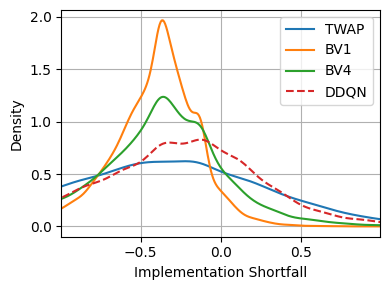

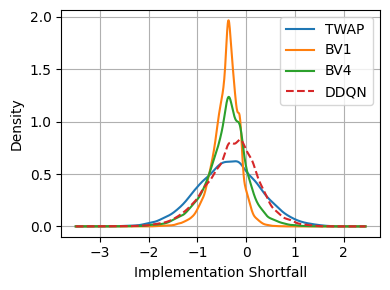

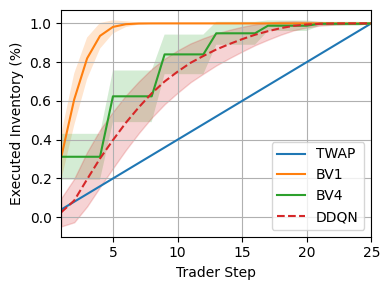

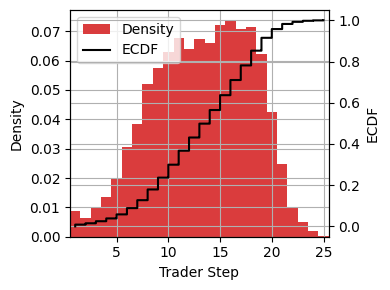

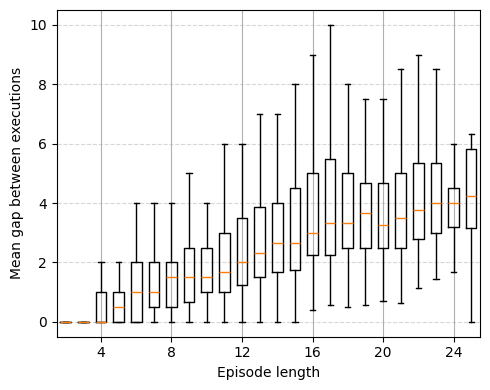

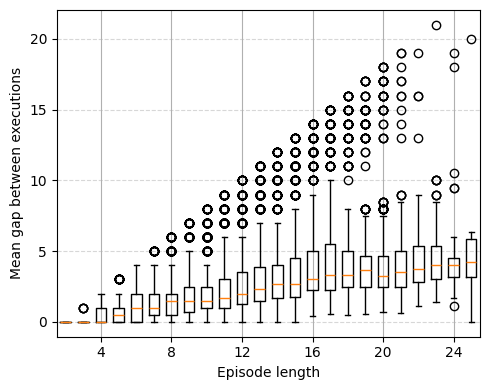

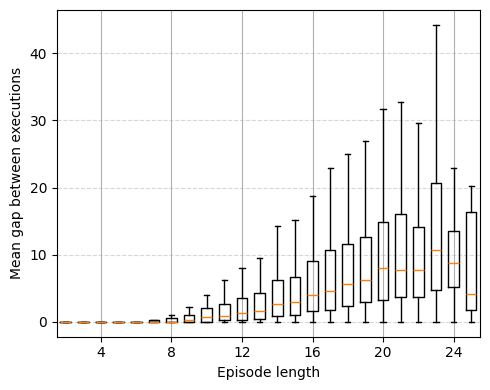

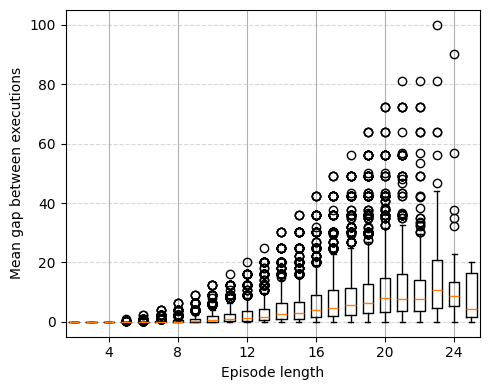

In [8]:
run_id = 'k3631p6d'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

T-test between ddqn and twap: t-statistic = 12.4261, p-value = 0.0000
Statistically significant difference between ddqn and twap (p < 0.05)


T-test between ddqn and front_load: t-statistic = 28.6044, p-value = 0.0000
Statistically significant difference between ddqn and front_load (p < 0.05)


T-test between ddqn and best_volume_4: t-statistic = 22.1021, p-value = 0.0000
Statistically significant difference between ddqn and best_volume_4 (p < 0.05)




: 

### Q values

unzip the saved model to load the NN weights

In [9]:
class DummyEnv(gym.Env):
    def __init__(self):
        super().__init__()
        self.observation_space = gym.spaces.Box(
            low=-1.0, high=1.0, shape=(state_dim,), dtype=float
        )
        self.action_space = gym.spaces.Discrete(action_dim)

    def reset(self):
        return self.observation_space.sample(), {}

    def step(self, action):
        return self.observation_space.sample(), 0.0, True, False, {}

dummy_env = DummyEnv()

# --- Define same policy as training ---
policy_kwargs = dict(
    net_arch=[30, 30, 30, 30, 30],
    activation_fn=nn.LeakyReLU,
)

# --- Recreate model with dummy env ---
model = DQN(
    policy="MlpPolicy",
    env=dummy_env,
    policy_kwargs=policy_kwargs,
    device="cpu",  # or "cuda"
)

# --- Load NN weights ---
path = f"/scratch/network/te6653/qrm_optimal_execution/save_model/ddqn_{run_id}/policy.pth"
state_dict = torch.load(path, map_location=model.device)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# --- Now you can call the NN directly ---
obs = torch.zeros((1, state_dim))  # example input
q_values = model.policy.q_net(obs)
print("Q-values:", q_values)


Q-values: tensor([[-0.2623, -0.2399]], grad_fn=<AddmmBackward0>)


Pick the action: `show_action`

In [10]:

# --- assume your SB3 DQN `model` is already created and loaded ---
model.policy.set_training_mode(False)
device = model.device

# ---- Parameters ----
times_min = -1.0
times_max = 1.0
inv_min   = -1.0
inv_max   =  1.0

price   = 0.0
ask_vol = 0.0
bid_vol = 0.0

# ---- Grids ----
n_grid = 101
times = np.linspace(times_min, times_max, n_grid, dtype=np.float32)
invs  = np.linspace(inv_min,   inv_max,   n_grid, dtype=np.float32)
T_raw, I_raw = np.meshgrid(times, invs)

# Percent axes for plotting
time_pct = (T_raw - times_min) / (times_max - times_min) * 100.0
inv_pct  = (I_raw  - inv_min)   / (inv_max   - inv_min)   * 100.0

# ---- Build (N, 5) batch of states from the raw grid ----
N = n_grid * n_grid
states = np.column_stack([
    I_raw.reshape(-1),            # inventory
    T_raw.reshape(-1),            # time
    np.full(N, price,   np.float32),
    np.full(N, ask_vol, np.float32),
    np.full(N, bid_vol, np.float32),
]).astype(np.float32)
obs = torch.as_tensor(states, device=device)

# ---- Get Q-values ----
with torch.no_grad():
    pi = model.policy
    try:
        if getattr(pi, "features_extractor", None) is not None:
            feats = pi.features_extractor(obs)
            q_tensor = pi.q_net(feats)
        else:
            feats = pi.extract_features(obs)
            q_tensor = pi.q_net(feats)
    except Exception:
        q_tensor = pi.q_net(obs)

q_values  = q_tensor.detach().cpu().numpy()
n_actions = q_values.shape[1]

# ---- Standard Plotly figure ----
fig = go.Figure()
for a in range(n_actions):
    Z = q_values[:, a].reshape(n_grid, n_grid)
    fig.add_trace(
        go.Surface(
            x=time_pct, y=inv_pct, z=Z,
            name=f"Action {a}",
            showscale=(a == 0),                 # one colorbar
            colorbar=(dict(title="Q-value") if a == 0 else None)
        )
    )

# show only the action you want initially
show_action = 0
for i in range(n_actions):
    fig.data[i].visible = (i == show_action)

fig.update_layout(
    scene=dict(
        xaxis_title="Time (%)",
        yaxis_title="Remaining Inventory (%)",
        zaxis_title="Q-value",
        aspectmode="cube",
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)),  # optional starting view
)

# ---- Use FigureWidget so UI rotations sync back to Python ----
figw = go.FigureWidget(fig)
display(figw)

# ✅ Correct callback signature: (layout, value)
def _on_cam_change(layout, camera_value):
    print("Updated camera:", camera_value)

figw.layout.on_change(_on_cam_change, 'scene.camera')

# Button to print the current camera on demand
btn = widgets.Button(description="Print current camera")
out = widgets.Output()

def _print_cam(_):
    with out:
        print(figw.layout.scene.camera)

btn.on_click(_print_cam)
display(btn, out)

fig.update_layout(scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)))

# IMPORTANT: don't call fig.show() here; it opens a non-synced view.


FigureWidget({
    'data': [{'colorbar': {'title': {'text': 'Q-value'}},
              'name': 'Action 0',
              'showscale': True,
              'type': 'surface',
              'uid': '9fd81880-b114-4ba5-92c3-445eed653ada',
              'visible': True,
              'x': {'bdata': ('AAAAAPD/fz8EAABAAABAQPz/f0ACAK' ... 'IAAMBCAADCQgAAxEIAAMZCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'y': {'bdata': ('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAA' ... 'IAAMhCAADIQgAAyEIAAMhCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'z': {'bdata': ('0FlZPLA8XTzQH2E8kAJlPEDlaDxIyG' ... '+KzcO/VN7Gvxzvyb/m/8y/shDQvw=='),
                    'dtype': 'f4',
                    'shape': '101, 101'}},
             {'name': 'Action 1',
              'showscale': False,
              'type': 'surface',
              'uid': '83ba2d57-a423-4291-b013-b42cf94e7d99',
              'visible': False,
   

Button(description='Print current camera', style=ButtonStyle())

Output()

In [ ]:
plotly_eye = {'x': 2.2, 'y': 2.2, 'z': 1.3}
elev, azim = plotly_eye_to_view_init(plotly_eye)
save_action_surface_pdf(elev, azim, show_action, q_values, n_grid, time_pct, inv_pct, cmap='cividis', filename=f"/scratch/network/te6653/qrm_optimal_execution/plots/q_values/{run_id}_q_surface_action{show_action}.pdf")

: 

## 5-dim: ag9nxmfw [0, 0.5, 1.0]

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.282, std=0.610 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.3850% of runs did not reach full inventory
    Missing volume: avg=2.13, std=1.24, max=6.00



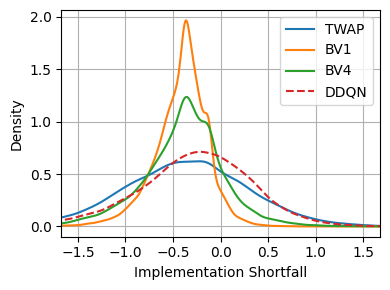

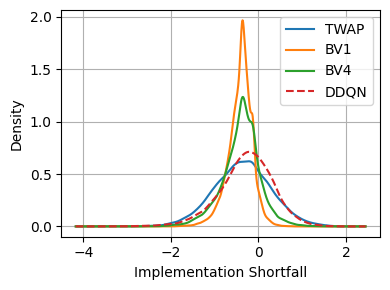

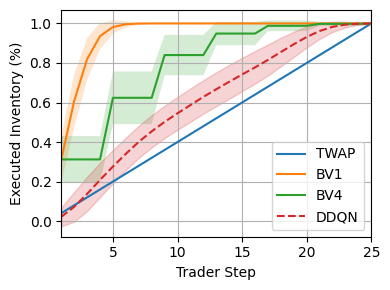

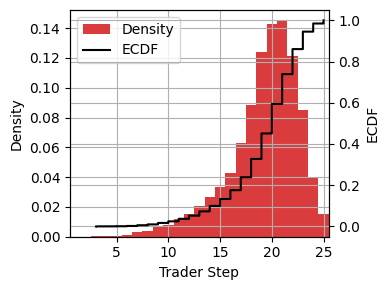

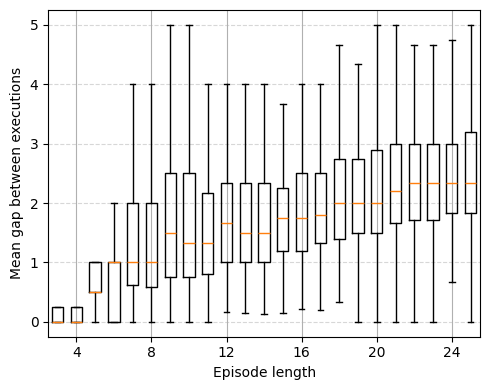

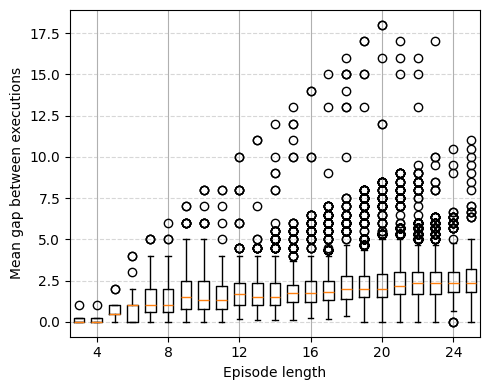

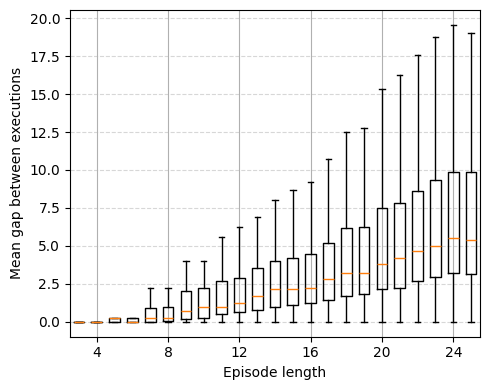

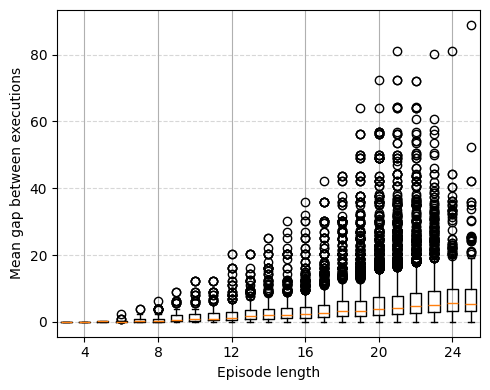

In [8]:
run_id = 'ag9nxmfw'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

T-test between ddqn and twap: t-statistic = 12.4261, p-value = 0.0000
Statistically significant difference between ddqn and twap (p < 0.05)


T-test between ddqn and front_load: t-statistic = 28.6044, p-value = 0.0000
Statistically significant difference between ddqn and front_load (p < 0.05)


T-test between ddqn and best_volume_4: t-statistic = 22.1021, p-value = 0.0000
Statistically significant difference between ddqn and best_volume_4 (p < 0.05)




: 

### Q values

unzip the saved model to load the NN weights

In [ ]:
class DummyEnv(gym.Env):
    def __init__(self):
        super().__init__()
        self.observation_space = gym.spaces.Box(
            low=-1.0, high=1.0, shape=(state_dim,), dtype=float
        )
        self.action_space = gym.spaces.Discrete(action_dim)

    def reset(self):
        return self.observation_space.sample(), {}

    def step(self, action):
        return self.observation_space.sample(), 0.0, True, False, {}

dummy_env = DummyEnv()

# --- Define same policy as training ---
policy_kwargs = dict(
    net_arch=[30, 30, 30, 30, 30],
    activation_fn=nn.LeakyReLU,
)

# --- Recreate model with dummy env ---
model = DQN(
    policy="MlpPolicy",
    env=dummy_env,
    policy_kwargs=policy_kwargs,
    device="cpu",  # or "cuda"
)

# --- Load NN weights ---
path = f"/scratch/network/te6653/qrm_optimal_execution/save_model/ddqn_{run_id}/policy.pth"
state_dict = torch.load(path, map_location=model.device)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# --- Now you can call the NN directly ---
obs = torch.zeros((1, state_dim))  # example input
q_values = model.policy.q_net(obs)
print("Q-values:", q_values)


Q-values: tensor([[-0.2623, -0.2399]], grad_fn=<AddmmBackward0>)


Pick the action: `show_action`

In [ ]:

# --- assume your SB3 DQN `model` is already created and loaded ---
model.policy.set_training_mode(False)
device = model.device

# ---- Parameters ----
times_min = -1.0
times_max = 1.0
inv_min   = -1.0
inv_max   =  1.0

price   = 0.0
ask_vol = 0.0
bid_vol = 0.0

# ---- Grids ----
n_grid = 101
times = np.linspace(times_min, times_max, n_grid, dtype=np.float32)
invs  = np.linspace(inv_min,   inv_max,   n_grid, dtype=np.float32)
T_raw, I_raw = np.meshgrid(times, invs)

# Percent axes for plotting
time_pct = (T_raw - times_min) / (times_max - times_min) * 100.0
inv_pct  = (I_raw  - inv_min)   / (inv_max   - inv_min)   * 100.0

# ---- Build (N, 5) batch of states from the raw grid ----
N = n_grid * n_grid
states = np.column_stack([
    I_raw.reshape(-1),            # inventory
    T_raw.reshape(-1),            # time
    np.full(N, price,   np.float32),
    np.full(N, ask_vol, np.float32),
    np.full(N, bid_vol, np.float32),
]).astype(np.float32)
obs = torch.as_tensor(states, device=device)

# ---- Get Q-values ----
with torch.no_grad():
    pi = model.policy
    try:
        if getattr(pi, "features_extractor", None) is not None:
            feats = pi.features_extractor(obs)
            q_tensor = pi.q_net(feats)
        else:
            feats = pi.extract_features(obs)
            q_tensor = pi.q_net(feats)
    except Exception:
        q_tensor = pi.q_net(obs)

q_values  = q_tensor.detach().cpu().numpy()
n_actions = q_values.shape[1]

# ---- Standard Plotly figure ----
fig = go.Figure()
for a in range(n_actions):
    Z = q_values[:, a].reshape(n_grid, n_grid)
    fig.add_trace(
        go.Surface(
            x=time_pct, y=inv_pct, z=Z,
            name=f"Action {a}",
            showscale=(a == 0),                 # one colorbar
            colorbar=(dict(title="Q-value") if a == 0 else None)
        )
    )

# show only the action you want initially
show_action = 1
for i in range(n_actions):
    fig.data[i].visible = (i == show_action)

fig.update_layout(
    scene=dict(
        xaxis_title="Time (%)",
        yaxis_title="Remaining Inventory (%)",
        zaxis_title="Q-value",
        aspectmode="cube",
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)),  # optional starting view
)

# ---- Use FigureWidget so UI rotations sync back to Python ----
figw = go.FigureWidget(fig)
display(figw)

# ✅ Correct callback signature: (layout, value)
def _on_cam_change(layout, camera_value):
    print("Updated camera:", camera_value)

figw.layout.on_change(_on_cam_change, 'scene.camera')

# Button to print the current camera on demand
btn = widgets.Button(description="Print current camera")
out = widgets.Output()

def _print_cam(_):
    with out:
        print(figw.layout.scene.camera)

btn.on_click(_print_cam)
display(btn, out)

fig.update_layout(scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)))

# IMPORTANT: don't call fig.show() here; it opens a non-synced view.


FigureWidget({
    'data': [{'colorbar': {'title': {'text': 'Q-value'}},
              'name': 'Action 0',
              'showscale': True,
              'type': 'surface',
              'uid': 'a2b088a9-6c2f-40d6-9807-71df2b1467e0',
              'visible': False,
              'x': {'bdata': ('AAAAAPD/fz8EAABAAABAQPz/f0ACAK' ... 'IAAMBCAADCQgAAxEIAAMZCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'y': {'bdata': ('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAA' ... 'IAAMhCAADIQgAAyEIAAMhCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'z': {'bdata': ('0FlZPLA8XTzQH2E8kAJlPEDlaDxIyG' ... '+KzcO/VN7Gvxzvyb/m/8y/shDQvw=='),
                    'dtype': 'f4',
                    'shape': '101, 101'}},
             {'name': 'Action 1',
              'showscale': False,
              'type': 'surface',
              'uid': 'a42c88c4-3b55-4dcf-b562-2662439f6e8b',
              'visible': True,
   

Button(description='Print current camera', style=ButtonStyle())

Output()

In [ ]:
plotly_eye = {'x': 2.2, 'y': 2.2, 'z': 1.3}
elev, azim = plotly_eye_to_view_init(plotly_eye)
save_action_surface_pdf(elev, azim, show_action, q_values, n_grid, time_pct, inv_pct, filename=f"/scratch/network/te6653/qrm_optimal_execution/plots/q_values/{run_id}_q_surface_action{show_action}.pdf")

: 

## Comparing

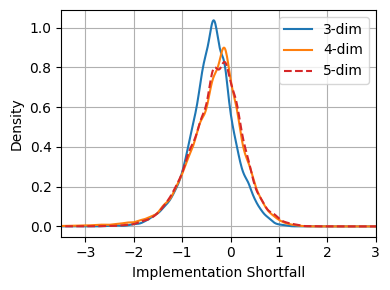

In [9]:
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/ddqn_kfryeeez.pkl', 'rb') as f:
    dic = pickle.load(f)

final_is_3 = np.array(dic['final_is'])
maxi = np.max(np.abs(final_is_3))

with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/ddqn_uuc7cxji.pkl', 'rb') as f:
    dic = pickle.load(f)

final_is_4 = np.array(dic['final_is'])
maxi = max(np.max(np.abs(final_is_4)), maxi)

with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/ddqn_k3631p6d.pkl', 'rb') as f:
    dic = pickle.load(f)

final_is_5 = np.array(dic['final_is'])
maxi = max(np.max(np.abs(final_is_5)), maxi)

x_kde = np.linspace(-maxi, maxi, 1000)
kde_3 = gaussian_kde(final_is_3)
y_kde_3 = kde_3(x_kde)
kde_4 = gaussian_kde(final_is_4)
y_kde_4 = kde_4(x_kde)
kde_5 = gaussian_kde(final_is_5)
y_kde_5 = kde_5(x_kde)

plt.figure(figsize=(4, 3))
plt.plot(x_kde, y_kde_3, label='3-dim')
plt.plot(x_kde, y_kde_4, label='4-dim')
plt.plot(x_kde, y_kde_5, label='5-dim', linestyle='--', color='C3')
plt.xlabel('Implementation Shortfall')
plt.ylabel('Density')
plt.xlim((-3.5, 3))

# plt.grid()
plt.legend()
plt.savefig(f'/scratch/network/te6653/qrm_optimal_execution/plots/overview/summary_is.pdf', bbox_inches='tight')
plt.show()

# Latest Plot Analysis

## 5-dim: xog6dkv6 

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.254, std=0.700 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.2400% of runs did not reach full inventory
    Missing volume: avg=2.65, std=2.29, max=11.00



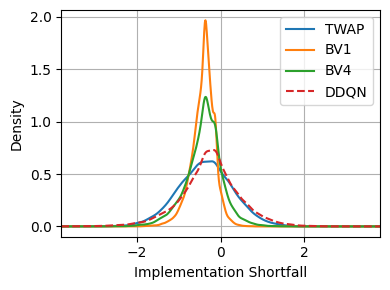

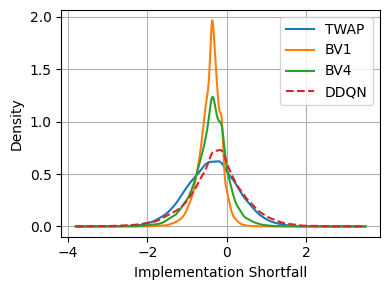

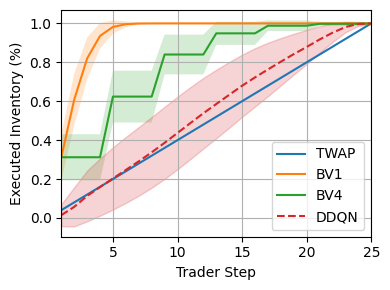

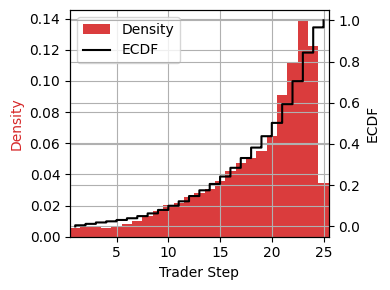

NameError: name 'plot_mean_distance_boxplots' is not defined

: 

In [ ]:
run_id = 'xog6dkv6'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

## 5-dim: 1eqqnzo7 

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.265, std=0.670 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.0950% of runs did not reach full inventory
    Missing volume: avg=3.37, std=2.41, max=10.00



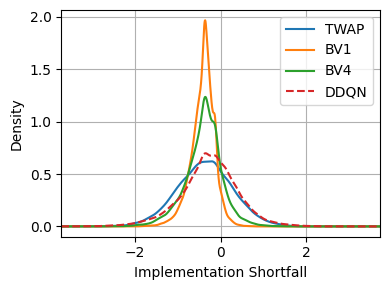

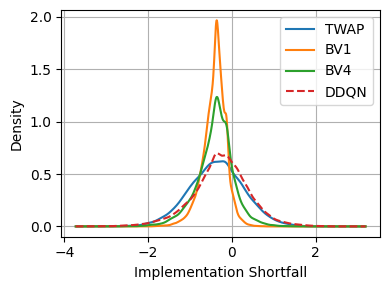

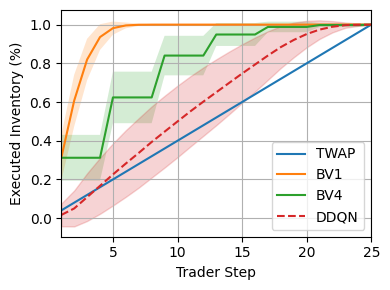

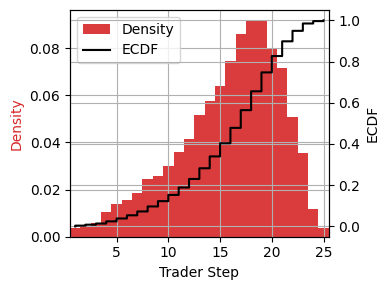

NameError: name 'plot_mean_distance_boxplots' is not defined

: 

In [ ]:
run_id = '1eqqnzo7'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

## 5-dim: wnt1s8hm 

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.288, std=0.732 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.0000% of runs did not reach full inventory


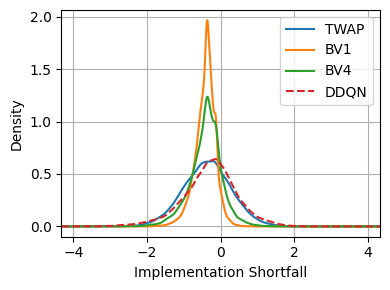

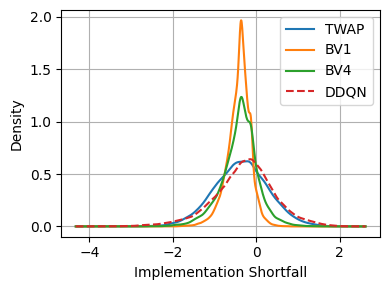

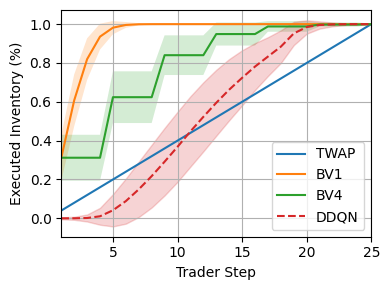

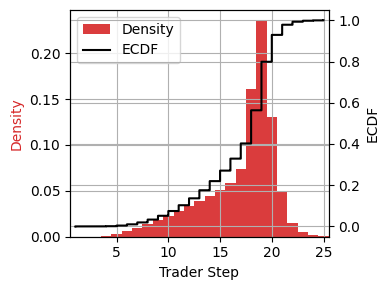

NameError: name 'plot_mean_distance_boxplots' is not defined

: 

In [ ]:
run_id = 'wnt1s8hm'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

## 5-dim: wvxjlemt 

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.295, std=0.577 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.0000% of runs did not reach full inventory


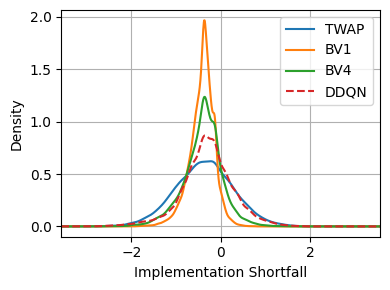

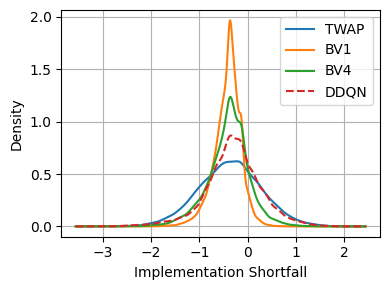

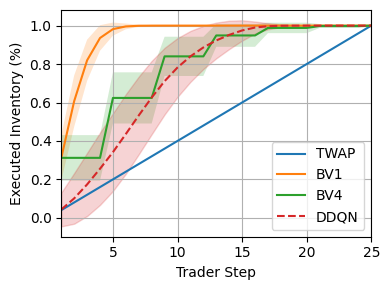

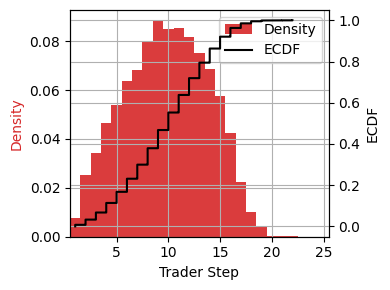

NameError: name 'plot_mean_distance_boxplots' is not defined

: 

In [ ]:
run_id = 'wvxjlemt'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

## 5-dim: vz1jwa5u 

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.296, std=0.557 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.0000% of runs did not reach full inventory


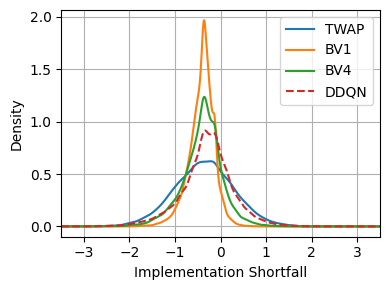

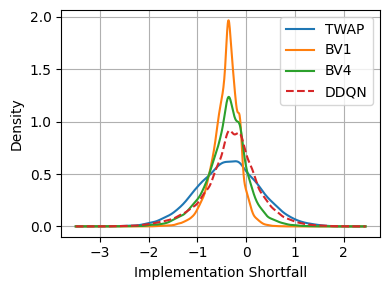

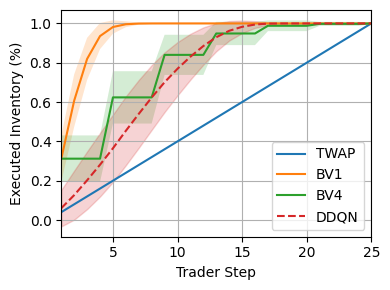

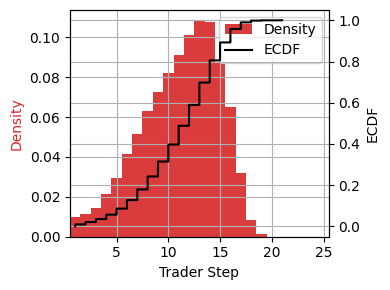

NameError: name 'plot_mean_distance_boxplots' is not defined

: 

In [ ]:
run_id = 'vz1jwa5u'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

### Q values

unzip the saved model to load the NN weights

In [ ]:
class DummyEnv(gym.Env):
    def __init__(self):
        super().__init__()
        self.observation_space = gym.spaces.Box(
            low=-1.0, high=1.0, shape=(state_dim,), dtype=float
        )
        self.action_space = gym.spaces.Discrete(action_dim)

    def reset(self):
        return self.observation_space.sample(), {}

    def step(self, action):
        return self.observation_space.sample(), 0.0, True, False, {}

dummy_env = DummyEnv()

# --- Define same policy as training ---
policy_kwargs = dict(
    net_arch=[30, 30, 30, 30, 30],
    activation_fn=nn.LeakyReLU,
)

# --- Recreate model with dummy env ---
model = DQN(
    policy="MlpPolicy",
    env=dummy_env,
    policy_kwargs=policy_kwargs,
    device="cpu",  # or "cuda"
)

# --- Load NN weights ---
path = f"/scratch/network/te6653/qrm_optimal_execution/save_model/ddqn_{run_id}/policy.pth"
state_dict = torch.load(path, map_location=model.device)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# --- Now you can call the NN directly ---
obs = torch.zeros((1, state_dim))  # example input
q_values = model.policy.q_net(obs)
print("Q-values:", q_values)


c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/attr_value.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/tensor.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framewo

Q-values: tensor([[-0.2632, -0.2349]], grad_fn=<AddmmBackward0>)


Pick the action: `show_action`

In [ ]:

# --- assume your SB3 DQN `model` is already created and loaded ---
model.policy.set_training_mode(False)
device = model.device

# ---- Parameters ----
times_min = -0.7
times_max = 1.0
inv_min   = -1.0
inv_max   =  1.0

price   = 0.0
ask_vol = 0.0
bid_vol = 0.0

# ---- Grids ----
n_grid = 101
times = np.linspace(times_min, times_max, n_grid, dtype=np.float32)
invs  = np.linspace(inv_min,   inv_max,   n_grid, dtype=np.float32)
T_raw, I_raw = np.meshgrid(times, invs)

# Percent axes for plotting
time_pct = (T_raw - times_min) / (times_max - times_min) * 100.0
inv_pct  = (I_raw  - inv_min)   / (inv_max   - inv_min)   * 100.0

# ---- Build (N, 5) batch of states from the raw grid ----
N = n_grid * n_grid
states = np.column_stack([
    I_raw.reshape(-1),            # inventory
    T_raw.reshape(-1),            # time
    np.full(N, price,   np.float32),
    np.full(N, ask_vol, np.float32),
    np.full(N, bid_vol, np.float32),
]).astype(np.float32)
obs = torch.as_tensor(states, device=device)

# ---- Get Q-values ----
with torch.no_grad():
    pi = model.policy
    try:
        if getattr(pi, "features_extractor", None) is not None:
            feats = pi.features_extractor(obs)
            q_tensor = pi.q_net(feats)
        else:
            feats = pi.extract_features(obs)
            q_tensor = pi.q_net(feats)
    except Exception:
        q_tensor = pi.q_net(obs)

q_values  = q_tensor.detach().cpu().numpy()
n_actions = q_values.shape[1]

# ---- Standard Plotly figure ----
fig = go.Figure()
for a in range(n_actions):
    Z = q_values[:, a].reshape(n_grid, n_grid)
    fig.add_trace(
        go.Surface(
            x=time_pct, y=inv_pct, z=Z,
            name=f"Action {a}",
            showscale=(a == 0),                 # one colorbar
            colorbar=(dict(title="Q-value") if a == 0 else None)
        )
    )

# show only the action you want initially
show_action = 1
for i in range(n_actions):
    fig.data[i].visible = (i == show_action)

fig.update_layout(
    scene=dict(
        xaxis_title="Time (%)",
        yaxis_title="Remaining Inventory (%)",
        zaxis_title="Q-value",
        aspectmode="cube",
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)),  # optional starting view
)

# ---- Use FigureWidget so UI rotations sync back to Python ----
figw = go.FigureWidget(fig)
display(figw)

# ✅ Correct callback signature: (layout, value)
def _on_cam_change(layout, camera_value):
    print("Updated camera:", camera_value)

figw.layout.on_change(_on_cam_change, 'scene.camera')

# Button to print the current camera on demand
btn = widgets.Button(description="Print current camera")
out = widgets.Output()

def _print_cam(_):
    with out:
        print(figw.layout.scene.camera)

btn.on_click(_print_cam)
display(btn, out)

fig.update_layout(scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)))

# IMPORTANT: don't call fig.show() here; it opens a non-synced view.


FigureWidget({
    'data': [{'colorbar': {'title': {'text': 'Q-value'}},
              'name': 'Action 0',
              'showscale': True,
              'type': 'surface',
              'uid': 'f54b2a48-591c-4520-8101-49d930fe1012',
              'visible': False,
              'x': {'bdata': ('AAAAANn/fz/1//8/AABAQPX/f0D9/5' ... 'IAAMBC///BQv//w0L//8VCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'y': {'bdata': ('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAA' ... 'IAAMhCAADIQgAAyEIAAMhCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'z': {'bdata': ('lgsAPgze9z0cpe893MnnPcw34z2Ewt' ... 'E+mJnBMkilwbAxscG3Lr3B9A7JwQ=='),
                    'dtype': 'f4',
                    'shape': '101, 101'}},
             {'name': 'Action 1',
              'showscale': False,
              'type': 'surface',
              'uid': 'cf895fb1-54b8-42a7-89e7-5296be534bb4',
              'visible': True,
   

Button(description='Print current camera', style=ButtonStyle())

Output()

In [ ]:
plotly_eye = {'x': 3.2, 'y': 3.2, 'z': 1.3}
elev, azim = plotly_eye_to_view_init(plotly_eye)
save_action_surface_pdf(elev, azim, show_action, q_values, n_grid, time_pct, inv_pct, filename=f"/scratch/network/te6653/qrm_optimal_execution/plots/q_values/{run_id}_q_surface_action{show_action}.pdf")

## 5-dim: ucq3sutj 

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.309, std=0.522 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.0000% of runs did not reach full inventory


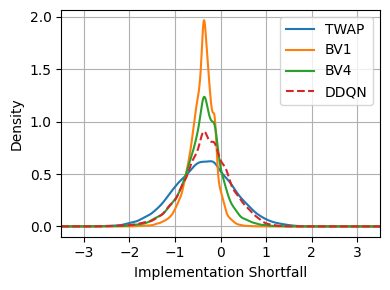

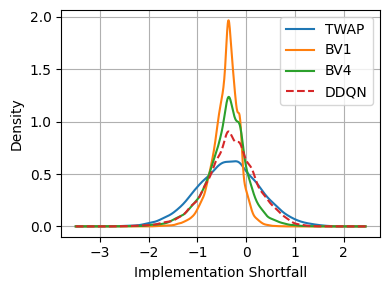

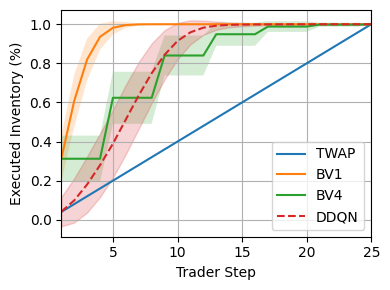

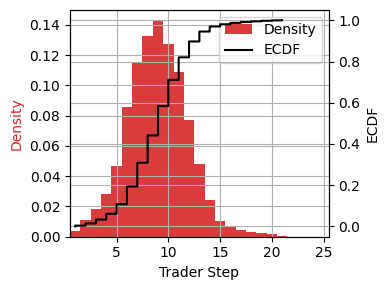

NameError: name 'plot_mean_distance_boxplots' is not defined

In [3]:
run_id = 'ucq3sutj'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

### Q values

unzip the saved model to load the NN weights

In [ ]:
class DummyEnv(gym.Env):
    def __init__(self):
        super().__init__()
        self.observation_space = gym.spaces.Box(
            low=-1.0, high=1.0, shape=(state_dim,), dtype=float
        )
        self.action_space = gym.spaces.Discrete(action_dim)

    def reset(self):
        return self.observation_space.sample(), {}

    def step(self, action):
        return self.observation_space.sample(), 0.0, True, False, {}

dummy_env = DummyEnv()

# --- Define same policy as training ---
policy_kwargs = dict(
    net_arch=[30, 30, 30, 30, 30],
    activation_fn=nn.LeakyReLU,
)

# --- Recreate model with dummy env ---
model = DQN(
    policy="MlpPolicy",
    env=dummy_env,
    policy_kwargs=policy_kwargs,
    device="cpu",  # or "cuda"
)

# --- Load NN weights ---
path = f"/scratch/network/te6653/qrm_optimal_execution/save_model/ddqn_{run_id}/policy.pth"
state_dict = torch.load(path, map_location=model.device)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# --- Now you can call the NN directly ---
obs = torch.zeros((1, state_dim))  # example input
q_values = model.policy.q_net(obs)
print("Q-values:", q_values)


c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/attr_value.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/tensor.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framewo

Q-values: tensor([[-0.2632, -0.2349]], grad_fn=<AddmmBackward0>)


Pick the action: `show_action`

In [ ]:

# --- assume your SB3 DQN `model` is already created and loaded ---
model.policy.set_training_mode(False)
device = model.device

# ---- Parameters ----
times_min = -0.7
times_max = 1.0
inv_min   = -1.0
inv_max   =  1.0

price   = 0.0
ask_vol = 0.0
bid_vol = 0.0

# ---- Grids ----
n_grid = 101
times = np.linspace(times_min, times_max, n_grid, dtype=np.float32)
invs  = np.linspace(inv_min,   inv_max,   n_grid, dtype=np.float32)
T_raw, I_raw = np.meshgrid(times, invs)

# Percent axes for plotting
time_pct = (T_raw - times_min) / (times_max - times_min) * 100.0
inv_pct  = (I_raw  - inv_min)   / (inv_max   - inv_min)   * 100.0

# ---- Build (N, 5) batch of states from the raw grid ----
N = n_grid * n_grid
states = np.column_stack([
    I_raw.reshape(-1),            # inventory
    T_raw.reshape(-1),            # time
    np.full(N, price,   np.float32),
    np.full(N, ask_vol, np.float32),
    np.full(N, bid_vol, np.float32),
]).astype(np.float32)
obs = torch.as_tensor(states, device=device)

# ---- Get Q-values ----
with torch.no_grad():
    pi = model.policy
    try:
        if getattr(pi, "features_extractor", None) is not None:
            feats = pi.features_extractor(obs)
            q_tensor = pi.q_net(feats)
        else:
            feats = pi.extract_features(obs)
            q_tensor = pi.q_net(feats)
    except Exception:
        q_tensor = pi.q_net(obs)

q_values  = q_tensor.detach().cpu().numpy()
n_actions = q_values.shape[1]

# ---- Standard Plotly figure ----
fig = go.Figure()
for a in range(n_actions):
    Z = q_values[:, a].reshape(n_grid, n_grid)
    fig.add_trace(
        go.Surface(
            x=time_pct, y=inv_pct, z=Z,
            name=f"Action {a}",
            showscale=(a == 0),                 # one colorbar
            colorbar=(dict(title="Q-value") if a == 0 else None)
        )
    )

# show only the action you want initially
show_action = 1
for i in range(n_actions):
    fig.data[i].visible = (i == show_action)

fig.update_layout(
    scene=dict(
        xaxis_title="Time (%)",
        yaxis_title="Remaining Inventory (%)",
        zaxis_title="Q-value",
        aspectmode="cube",
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)),  # optional starting view
)

# ---- Use FigureWidget so UI rotations sync back to Python ----
figw = go.FigureWidget(fig)
display(figw)

# ✅ Correct callback signature: (layout, value)
def _on_cam_change(layout, camera_value):
    print("Updated camera:", camera_value)

figw.layout.on_change(_on_cam_change, 'scene.camera')

# Button to print the current camera on demand
btn = widgets.Button(description="Print current camera")
out = widgets.Output()

def _print_cam(_):
    with out:
        print(figw.layout.scene.camera)

btn.on_click(_print_cam)
display(btn, out)

fig.update_layout(scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)))

# IMPORTANT: don't call fig.show() here; it opens a non-synced view.


FigureWidget({
    'data': [{'colorbar': {'title': {'text': 'Q-value'}},
              'name': 'Action 0',
              'showscale': True,
              'type': 'surface',
              'uid': 'f54b2a48-591c-4520-8101-49d930fe1012',
              'visible': False,
              'x': {'bdata': ('AAAAANn/fz/1//8/AABAQPX/f0D9/5' ... 'IAAMBC///BQv//w0L//8VCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'y': {'bdata': ('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAA' ... 'IAAMhCAADIQgAAyEIAAMhCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'z': {'bdata': ('lgsAPgze9z0cpe893MnnPcw34z2Ewt' ... 'E+mJnBMkilwbAxscG3Lr3B9A7JwQ=='),
                    'dtype': 'f4',
                    'shape': '101, 101'}},
             {'name': 'Action 1',
              'showscale': False,
              'type': 'surface',
              'uid': 'cf895fb1-54b8-42a7-89e7-5296be534bb4',
              'visible': True,
   

Button(description='Print current camera', style=ButtonStyle())

Output()

In [ ]:
plotly_eye = {'x': 3.2, 'y': 3.2, 'z': 1.3}
elev, azim = plotly_eye_to_view_init(plotly_eye)
save_action_surface_pdf(elev, azim, show_action, q_values, n_grid, time_pct, inv_pct, filename=f"/scratch/network/te6653/qrm_optimal_execution/plots/q_values/{run_id}_q_surface_action{show_action}.pdf")

## 5-dim: ghje2guj - custom 3

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.288, std=0.718 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.0400% of runs did not reach full inventory
    Missing volume: avg=2.75, std=2.05, max=7.00



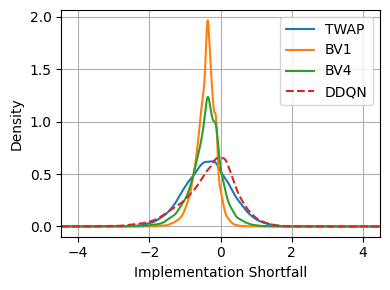

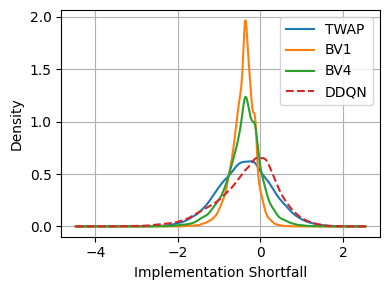

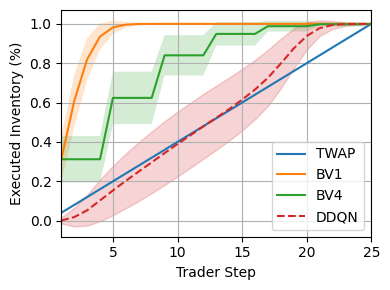

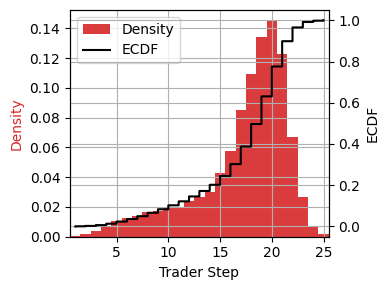

NameError: name 'plot_mean_distance_boxplots' is not defined

: 

In [ ]:
run_id = 'ghje2guj'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

### Q values

unzip the saved model to load the NN weights

In [ ]:
class DummyEnv(gym.Env):
    def __init__(self):
        super().__init__()
        self.observation_space = gym.spaces.Box(
            low=-1.0, high=1.0, shape=(state_dim,), dtype=float
        )
        self.action_space = gym.spaces.Discrete(action_dim)

    def reset(self):
        return self.observation_space.sample(), {}

    def step(self, action):
        return self.observation_space.sample(), 0.0, True, False, {}

dummy_env = DummyEnv()

# --- Define same policy as training ---
policy_kwargs = dict(
    net_arch=[30, 30, 30, 30, 30],
    activation_fn=nn.LeakyReLU,
)

# --- Recreate model with dummy env ---
model = DQN(
    policy="MlpPolicy",
    env=dummy_env,
    policy_kwargs=policy_kwargs,
    device="cpu",  # or "cuda"
)

# --- Load NN weights ---
path = f"/scratch/network/te6653/qrm_optimal_execution/save_model/ddqn_{run_id}/policy.pth"
state_dict = torch.load(path, map_location=model.device)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# --- Now you can call the NN directly ---
obs = torch.zeros((1, state_dim))  # example input
q_values = model.policy.q_net(obs)
print("Q-values:", q_values)


c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/attr_value.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/tensor.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framewo

Q-values: tensor([[-0.2632, -0.2349]], grad_fn=<AddmmBackward0>)


Pick the action: `show_action`

In [ ]:

# --- assume your SB3 DQN `model` is already created and loaded ---
model.policy.set_training_mode(False)
device = model.device

# ---- Parameters ----
times_min = -0.7
times_max = 1.0
inv_min   = -1.0
inv_max   =  1.0

price   = 0.0
ask_vol = 0.0
bid_vol = 0.0

# ---- Grids ----
n_grid = 101
times = np.linspace(times_min, times_max, n_grid, dtype=np.float32)
invs  = np.linspace(inv_min,   inv_max,   n_grid, dtype=np.float32)
T_raw, I_raw = np.meshgrid(times, invs)

# Percent axes for plotting
time_pct = (T_raw - times_min) / (times_max - times_min) * 100.0
inv_pct  = (I_raw  - inv_min)   / (inv_max   - inv_min)   * 100.0

# ---- Build (N, 5) batch of states from the raw grid ----
N = n_grid * n_grid
states = np.column_stack([
    I_raw.reshape(-1),            # inventory
    T_raw.reshape(-1),            # time
    np.full(N, price,   np.float32),
    np.full(N, ask_vol, np.float32),
    np.full(N, bid_vol, np.float32),
]).astype(np.float32)
obs = torch.as_tensor(states, device=device)

# ---- Get Q-values ----
with torch.no_grad():
    pi = model.policy
    try:
        if getattr(pi, "features_extractor", None) is not None:
            feats = pi.features_extractor(obs)
            q_tensor = pi.q_net(feats)
        else:
            feats = pi.extract_features(obs)
            q_tensor = pi.q_net(feats)
    except Exception:
        q_tensor = pi.q_net(obs)

q_values  = q_tensor.detach().cpu().numpy()
n_actions = q_values.shape[1]

# ---- Standard Plotly figure ----
fig = go.Figure()
for a in range(n_actions):
    Z = q_values[:, a].reshape(n_grid, n_grid)
    fig.add_trace(
        go.Surface(
            x=time_pct, y=inv_pct, z=Z,
            name=f"Action {a}",
            showscale=(a == 0),                 # one colorbar
            colorbar=(dict(title="Q-value") if a == 0 else None)
        )
    )

# show only the action you want initially
show_action = 1
for i in range(n_actions):
    fig.data[i].visible = (i == show_action)

fig.update_layout(
    scene=dict(
        xaxis_title="Time (%)",
        yaxis_title="Remaining Inventory (%)",
        zaxis_title="Q-value",
        aspectmode="cube",
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)),  # optional starting view
)

# ---- Use FigureWidget so UI rotations sync back to Python ----
figw = go.FigureWidget(fig)
display(figw)

# ✅ Correct callback signature: (layout, value)
def _on_cam_change(layout, camera_value):
    print("Updated camera:", camera_value)

figw.layout.on_change(_on_cam_change, 'scene.camera')

# Button to print the current camera on demand
btn = widgets.Button(description="Print current camera")
out = widgets.Output()

def _print_cam(_):
    with out:
        print(figw.layout.scene.camera)

btn.on_click(_print_cam)
display(btn, out)

fig.update_layout(scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)))

# IMPORTANT: don't call fig.show() here; it opens a non-synced view.


FigureWidget({
    'data': [{'colorbar': {'title': {'text': 'Q-value'}},
              'name': 'Action 0',
              'showscale': True,
              'type': 'surface',
              'uid': 'f54b2a48-591c-4520-8101-49d930fe1012',
              'visible': False,
              'x': {'bdata': ('AAAAANn/fz/1//8/AABAQPX/f0D9/5' ... 'IAAMBC///BQv//w0L//8VCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'y': {'bdata': ('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAA' ... 'IAAMhCAADIQgAAyEIAAMhCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'z': {'bdata': ('lgsAPgze9z0cpe893MnnPcw34z2Ewt' ... 'E+mJnBMkilwbAxscG3Lr3B9A7JwQ=='),
                    'dtype': 'f4',
                    'shape': '101, 101'}},
             {'name': 'Action 1',
              'showscale': False,
              'type': 'surface',
              'uid': 'cf895fb1-54b8-42a7-89e7-5296be534bb4',
              'visible': True,
   

Button(description='Print current camera', style=ButtonStyle())

Output()

In [ ]:
plotly_eye = {'x': 3.2, 'y': 3.2, 'z': 1.3}
elev, azim = plotly_eye_to_view_init(plotly_eye)
save_action_surface_pdf(elev, azim, show_action, q_values, n_grid, time_pct, inv_pct, filename=f"/scratch/network/te6653/qrm_optimal_execution/plots/q_values/{run_id}_q_surface_action{show_action}.pdf")

## 5-dim: 2fflneue - custom 3

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.293, std=0.645 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.0100% of runs did not reach full inventory
    Missing volume: avg=2.00, std=0.00, max=2.00



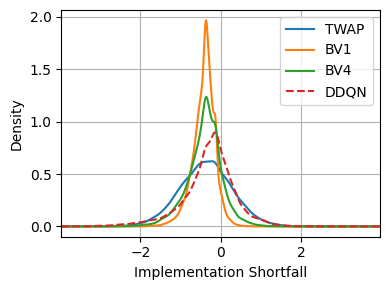

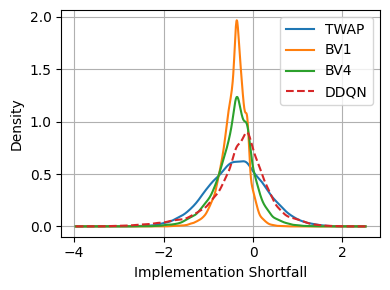

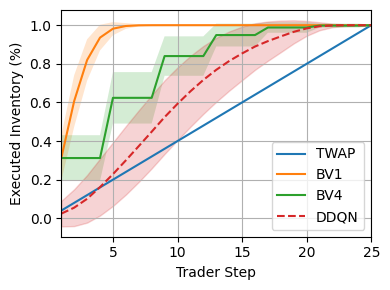

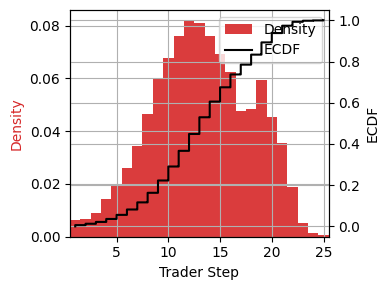

NameError: name 'plot_mean_distance_boxplots' is not defined

: 

In [ ]:
run_id = '2fflneue'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

### Q values

unzip the saved model to load the NN weights

In [ ]:
class DummyEnv(gym.Env):
    def __init__(self):
        super().__init__()
        self.observation_space = gym.spaces.Box(
            low=-1.0, high=1.0, shape=(state_dim,), dtype=float
        )
        self.action_space = gym.spaces.Discrete(action_dim)

    def reset(self):
        return self.observation_space.sample(), {}

    def step(self, action):
        return self.observation_space.sample(), 0.0, True, False, {}

dummy_env = DummyEnv()

# --- Define same policy as training ---
policy_kwargs = dict(
    net_arch=[30, 30, 30, 30, 30],
    activation_fn=nn.LeakyReLU,
)

# --- Recreate model with dummy env ---
model = DQN(
    policy="MlpPolicy",
    env=dummy_env,
    policy_kwargs=policy_kwargs,
    device="cpu",  # or "cuda"
)

# --- Load NN weights ---
path = f"/scratch/network/te6653/qrm_optimal_execution/save_model/ddqn_{run_id}/policy.pth"
state_dict = torch.load(path, map_location=model.device)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# --- Now you can call the NN directly ---
obs = torch.zeros((1, state_dim))  # example input
q_values = model.policy.q_net(obs)
print("Q-values:", q_values)


c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/attr_value.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/tensor.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framewo

Q-values: tensor([[-0.2632, -0.2349]], grad_fn=<AddmmBackward0>)


Pick the action: `show_action`

In [ ]:

# --- assume your SB3 DQN `model` is already created and loaded ---
model.policy.set_training_mode(False)
device = model.device

# ---- Parameters ----
times_min = -0.7
times_max = 1.0
inv_min   = -1.0
inv_max   =  1.0

price   = 0.0
ask_vol = 0.0
bid_vol = 0.0

# ---- Grids ----
n_grid = 101
times = np.linspace(times_min, times_max, n_grid, dtype=np.float32)
invs  = np.linspace(inv_min,   inv_max,   n_grid, dtype=np.float32)
T_raw, I_raw = np.meshgrid(times, invs)

# Percent axes for plotting
time_pct = (T_raw - times_min) / (times_max - times_min) * 100.0
inv_pct  = (I_raw  - inv_min)   / (inv_max   - inv_min)   * 100.0

# ---- Build (N, 5) batch of states from the raw grid ----
N = n_grid * n_grid
states = np.column_stack([
    I_raw.reshape(-1),            # inventory
    T_raw.reshape(-1),            # time
    np.full(N, price,   np.float32),
    np.full(N, ask_vol, np.float32),
    np.full(N, bid_vol, np.float32),
]).astype(np.float32)
obs = torch.as_tensor(states, device=device)

# ---- Get Q-values ----
with torch.no_grad():
    pi = model.policy
    try:
        if getattr(pi, "features_extractor", None) is not None:
            feats = pi.features_extractor(obs)
            q_tensor = pi.q_net(feats)
        else:
            feats = pi.extract_features(obs)
            q_tensor = pi.q_net(feats)
    except Exception:
        q_tensor = pi.q_net(obs)

q_values  = q_tensor.detach().cpu().numpy()
n_actions = q_values.shape[1]

# ---- Standard Plotly figure ----
fig = go.Figure()
for a in range(n_actions):
    Z = q_values[:, a].reshape(n_grid, n_grid)
    fig.add_trace(
        go.Surface(
            x=time_pct, y=inv_pct, z=Z,
            name=f"Action {a}",
            showscale=(a == 0),                 # one colorbar
            colorbar=(dict(title="Q-value") if a == 0 else None)
        )
    )

# show only the action you want initially
show_action = 1
for i in range(n_actions):
    fig.data[i].visible = (i == show_action)

fig.update_layout(
    scene=dict(
        xaxis_title="Time (%)",
        yaxis_title="Remaining Inventory (%)",
        zaxis_title="Q-value",
        aspectmode="cube",
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)),  # optional starting view
)

# ---- Use FigureWidget so UI rotations sync back to Python ----
figw = go.FigureWidget(fig)
display(figw)

# ✅ Correct callback signature: (layout, value)
def _on_cam_change(layout, camera_value):
    print("Updated camera:", camera_value)

figw.layout.on_change(_on_cam_change, 'scene.camera')

# Button to print the current camera on demand
btn = widgets.Button(description="Print current camera")
out = widgets.Output()

def _print_cam(_):
    with out:
        print(figw.layout.scene.camera)

btn.on_click(_print_cam)
display(btn, out)

fig.update_layout(scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)))

# IMPORTANT: don't call fig.show() here; it opens a non-synced view.


FigureWidget({
    'data': [{'colorbar': {'title': {'text': 'Q-value'}},
              'name': 'Action 0',
              'showscale': True,
              'type': 'surface',
              'uid': 'f54b2a48-591c-4520-8101-49d930fe1012',
              'visible': False,
              'x': {'bdata': ('AAAAANn/fz/1//8/AABAQPX/f0D9/5' ... 'IAAMBC///BQv//w0L//8VCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'y': {'bdata': ('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAA' ... 'IAAMhCAADIQgAAyEIAAMhCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'z': {'bdata': ('lgsAPgze9z0cpe893MnnPcw34z2Ewt' ... 'E+mJnBMkilwbAxscG3Lr3B9A7JwQ=='),
                    'dtype': 'f4',
                    'shape': '101, 101'}},
             {'name': 'Action 1',
              'showscale': False,
              'type': 'surface',
              'uid': 'cf895fb1-54b8-42a7-89e7-5296be534bb4',
              'visible': True,
   

Button(description='Print current camera', style=ButtonStyle())

Output()

In [ ]:
plotly_eye = {'x': 3.2, 'y': 3.2, 'z': 1.3}
elev, azim = plotly_eye_to_view_init(plotly_eye)
save_action_surface_pdf(elev, azim, show_action, q_values, n_grid, time_pct, inv_pct, filename=f"/scratch/network/te6653/qrm_optimal_execution/plots/q_values/{run_id}_q_surface_action{show_action}.pdf")

## 5-dim: k3631p6d - custom 3

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.290, std=0.541 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.0150% of runs did not reach full inventory
    Missing volume: avg=2.33, std=0.94, max=3.00



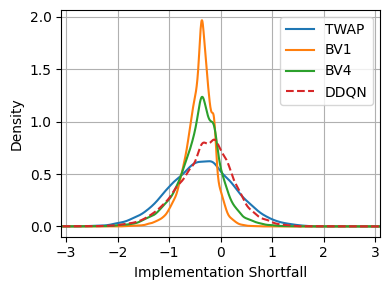

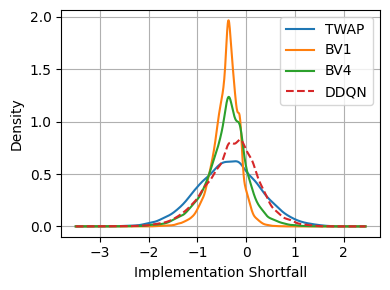

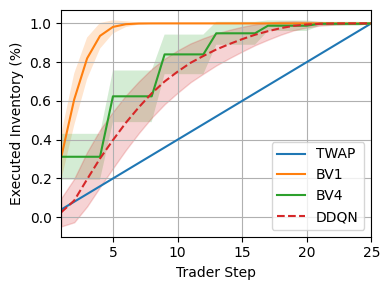

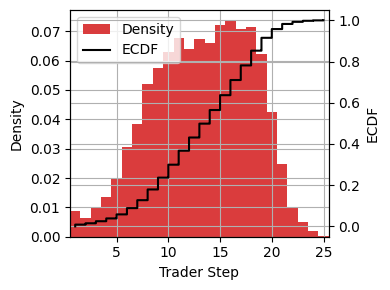

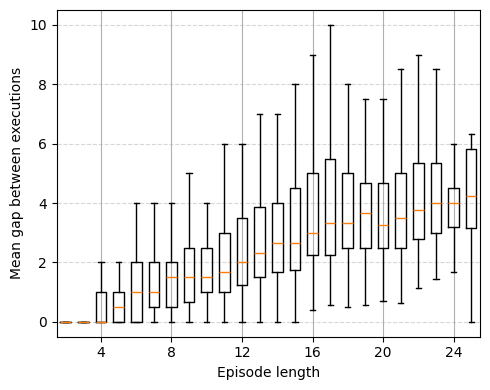

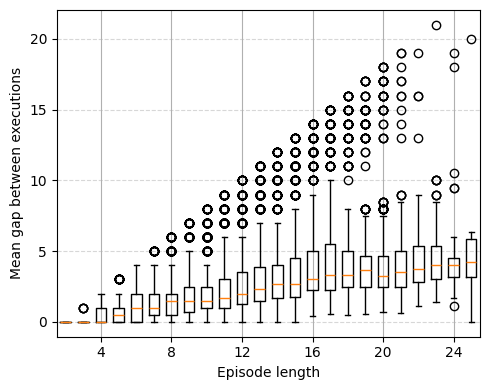

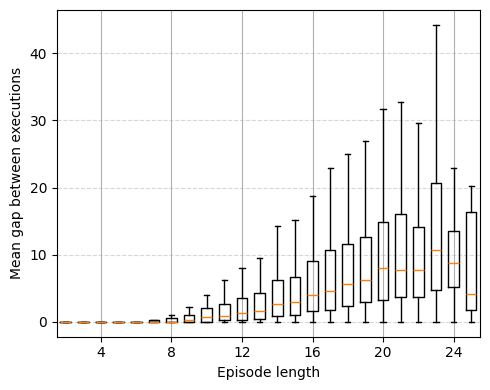

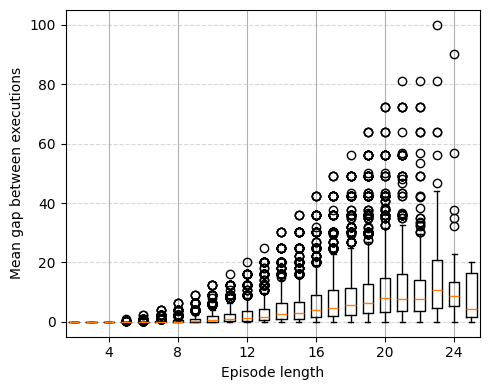

In [9]:
run_id = 'k3631p6d'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

T-test between ddqn and twap: t-statistic = 12.4261, p-value = 0.0000
Statistically significant difference between ddqn and twap (p < 0.05)


T-test between ddqn and front_load: t-statistic = 28.6044, p-value = 0.0000
Statistically significant difference between ddqn and front_load (p < 0.05)


T-test between ddqn and best_volume_4: t-statistic = 22.1021, p-value = 0.0000
Statistically significant difference between ddqn and best_volume_4 (p < 0.05)




: 

### Q values

unzip the saved model to load the NN weights

In [10]:
class DummyEnv(gym.Env):
    def __init__(self):
        super().__init__()
        self.observation_space = gym.spaces.Box(
            low=-1.0, high=1.0, shape=(state_dim,), dtype=float
        )
        self.action_space = gym.spaces.Discrete(action_dim)

    def reset(self):
        return self.observation_space.sample(), {}

    def step(self, action):
        return self.observation_space.sample(), 0.0, True, False, {}

dummy_env = DummyEnv()

# --- Define same policy as training ---
policy_kwargs = dict(
    net_arch=[30, 30, 30, 30, 30],
    activation_fn=nn.LeakyReLU,
)

# --- Recreate model with dummy env ---
model = DQN(
    policy="MlpPolicy",
    env=dummy_env,
    policy_kwargs=policy_kwargs,
    device="cpu",  # or "cuda"
)

# --- Load NN weights ---
path = f"/scratch/network/te6653/qrm_optimal_execution/save_model/ddqn_{run_id}/policy.pth"
state_dict = torch.load(path, map_location=model.device)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# --- Now you can call the NN directly ---
obs = torch.zeros((1, state_dim))  # example input
q_values = model.policy.q_net(obs)
print("Q-values:", q_values)


Q-values: tensor([[-0.2623, -0.2399]], grad_fn=<AddmmBackward0>)


Pick the action: `show_action`

In [13]:

# --- assume your SB3 DQN `model` is already created and loaded ---
model.policy.set_training_mode(False)
device = model.device

# ---- Parameters ----
times_min = -1.0
times_max = 1.0
inv_min   = -1.0
inv_max   =  1.0

price   = 0.0
ask_vol = 0.0
bid_vol = 0.0

# ---- Grids ----
n_grid = 101
times = np.linspace(times_min, times_max, n_grid, dtype=np.float32)
invs  = np.linspace(inv_min,   inv_max,   n_grid, dtype=np.float32)
T_raw, I_raw = np.meshgrid(times, invs)

# Percent axes for plotting
time_pct = (T_raw - times_min) / (times_max - times_min) * 100.0
inv_pct  = (I_raw  - inv_min)   / (inv_max   - inv_min)   * 100.0

# ---- Build (N, 5) batch of states from the raw grid ----
N = n_grid * n_grid
states = np.column_stack([
    I_raw.reshape(-1),            # inventory
    T_raw.reshape(-1),            # time
    np.full(N, price,   np.float32),
    np.full(N, ask_vol, np.float32),
    np.full(N, bid_vol, np.float32),
]).astype(np.float32)
obs = torch.as_tensor(states, device=device)

# ---- Get Q-values ----
with torch.no_grad():
    pi = model.policy
    try:
        if getattr(pi, "features_extractor", None) is not None:
            feats = pi.features_extractor(obs)
            q_tensor = pi.q_net(feats)
        else:
            feats = pi.extract_features(obs)
            q_tensor = pi.q_net(feats)
    except Exception:
        q_tensor = pi.q_net(obs)

q_values  = q_tensor.detach().cpu().numpy()
n_actions = q_values.shape[1]

# ---- Standard Plotly figure ----
fig = go.Figure()
for a in range(n_actions):
    Z = q_values[:, a].reshape(n_grid, n_grid)
    fig.add_trace(
        go.Surface(
            x=time_pct, y=inv_pct, z=Z,
            name=f"Action {a}",
            showscale=(a == 0),                 # one colorbar
            colorbar=(dict(title="Q-value") if a == 0 else None)
        )
    )

# show only the action you want initially
show_action = 1
for i in range(n_actions):
    fig.data[i].visible = (i == show_action)

fig.update_layout(
    scene=dict(
        xaxis_title="Time (%)",
        yaxis_title="Remaining Inventory (%)",
        zaxis_title="Q-value",
        aspectmode="cube",
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)),  # optional starting view
)

# ---- Use FigureWidget so UI rotations sync back to Python ----
figw = go.FigureWidget(fig)
display(figw)

# ✅ Correct callback signature: (layout, value)
def _on_cam_change(layout, camera_value):
    print("Updated camera:", camera_value)

figw.layout.on_change(_on_cam_change, 'scene.camera')

# Button to print the current camera on demand
btn = widgets.Button(description="Print current camera")
out = widgets.Output()

def _print_cam(_):
    with out:
        print(figw.layout.scene.camera)

btn.on_click(_print_cam)
display(btn, out)

fig.update_layout(scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)))

# IMPORTANT: don't call fig.show() here; it opens a non-synced view.


FigureWidget({
    'data': [{'colorbar': {'title': {'text': 'Q-value'}},
              'name': 'Action 0',
              'showscale': True,
              'type': 'surface',
              'uid': 'a2b088a9-6c2f-40d6-9807-71df2b1467e0',
              'visible': False,
              'x': {'bdata': ('AAAAAPD/fz8EAABAAABAQPz/f0ACAK' ... 'IAAMBCAADCQgAAxEIAAMZCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'y': {'bdata': ('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAA' ... 'IAAMhCAADIQgAAyEIAAMhCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'z': {'bdata': ('0FlZPLA8XTzQH2E8kAJlPEDlaDxIyG' ... '+KzcO/VN7Gvxzvyb/m/8y/shDQvw=='),
                    'dtype': 'f4',
                    'shape': '101, 101'}},
             {'name': 'Action 1',
              'showscale': False,
              'type': 'surface',
              'uid': 'a42c88c4-3b55-4dcf-b562-2662439f6e8b',
              'visible': True,
   

Button(description='Print current camera', style=ButtonStyle())

Output()

In [ ]:
plotly_eye = {'x': 2.2, 'y': 2.2, 'z': 1.3}
elev, azim = plotly_eye_to_view_init(plotly_eye)
save_action_surface_pdf(elev, azim, show_action, q_values, n_grid, time_pct, inv_pct, filename=f"/scratch/network/te6653/qrm_optimal_execution/plots/q_values/{run_id}_q_surface_action{show_action}.pdf")

: 

## 5-dim: 2xsyi0ja - custom 3

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.282, std=0.620 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.1300% of runs did not reach full inventory
    Missing volume: avg=4.00, std=3.09, max=13.00



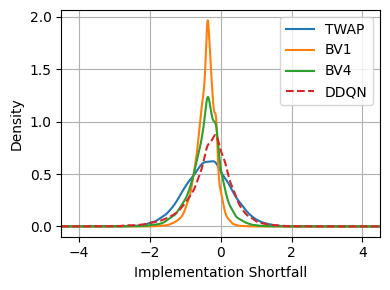

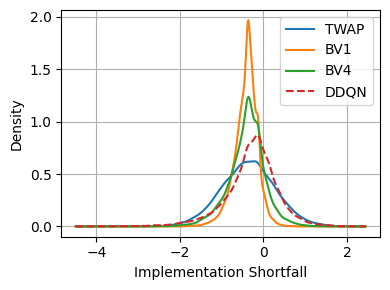

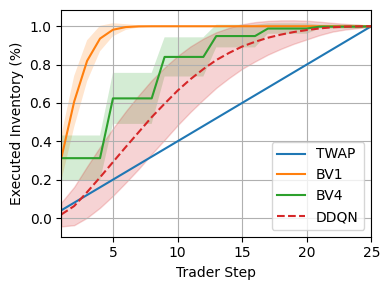

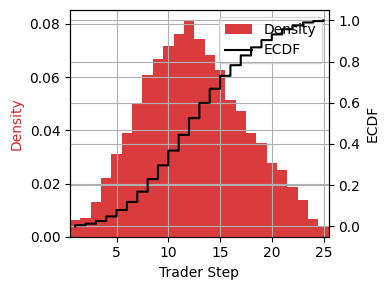

NameError: name 'plot_mean_distance_boxplots' is not defined

In [3]:
run_id = '2xsyi0ja'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

### Q values

unzip the saved model to load the NN weights

In [ ]:
class DummyEnv(gym.Env):
    def __init__(self):
        super().__init__()
        self.observation_space = gym.spaces.Box(
            low=-1.0, high=1.0, shape=(state_dim,), dtype=float
        )
        self.action_space = gym.spaces.Discrete(action_dim)

    def reset(self):
        return self.observation_space.sample(), {}

    def step(self, action):
        return self.observation_space.sample(), 0.0, True, False, {}

dummy_env = DummyEnv()

# --- Define same policy as training ---
policy_kwargs = dict(
    net_arch=[30, 30, 30, 30, 30],
    activation_fn=nn.LeakyReLU,
)

# --- Recreate model with dummy env ---
model = DQN(
    policy="MlpPolicy",
    env=dummy_env,
    policy_kwargs=policy_kwargs,
    device="cpu",  # or "cuda"
)

# --- Load NN weights ---
path = f"/scratch/network/te6653/qrm_optimal_execution/save_model/ddqn_{run_id}/policy.pth"
state_dict = torch.load(path, map_location=model.device)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# --- Now you can call the NN directly ---
obs = torch.zeros((1, state_dim))  # example input
q_values = model.policy.q_net(obs)
print("Q-values:", q_values)


c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/attr_value.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/tensor.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framewo

Q-values: tensor([[-0.2632, -0.2349]], grad_fn=<AddmmBackward0>)


Pick the action: `show_action`

In [ ]:

# --- assume your SB3 DQN `model` is already created and loaded ---
model.policy.set_training_mode(False)
device = model.device

# ---- Parameters ----
times_min = -0.7
times_max = 1.0
inv_min   = -1.0
inv_max   =  1.0

price   = 0.0
ask_vol = 0.0
bid_vol = 0.0

# ---- Grids ----
n_grid = 101
times = np.linspace(times_min, times_max, n_grid, dtype=np.float32)
invs  = np.linspace(inv_min,   inv_max,   n_grid, dtype=np.float32)
T_raw, I_raw = np.meshgrid(times, invs)

# Percent axes for plotting
time_pct = (T_raw - times_min) / (times_max - times_min) * 100.0
inv_pct  = (I_raw  - inv_min)   / (inv_max   - inv_min)   * 100.0

# ---- Build (N, 5) batch of states from the raw grid ----
N = n_grid * n_grid
states = np.column_stack([
    I_raw.reshape(-1),            # inventory
    T_raw.reshape(-1),            # time
    np.full(N, price,   np.float32),
    np.full(N, ask_vol, np.float32),
    np.full(N, bid_vol, np.float32),
]).astype(np.float32)
obs = torch.as_tensor(states, device=device)

# ---- Get Q-values ----
with torch.no_grad():
    pi = model.policy
    try:
        if getattr(pi, "features_extractor", None) is not None:
            feats = pi.features_extractor(obs)
            q_tensor = pi.q_net(feats)
        else:
            feats = pi.extract_features(obs)
            q_tensor = pi.q_net(feats)
    except Exception:
        q_tensor = pi.q_net(obs)

q_values  = q_tensor.detach().cpu().numpy()
n_actions = q_values.shape[1]

# ---- Standard Plotly figure ----
fig = go.Figure()
for a in range(n_actions):
    Z = q_values[:, a].reshape(n_grid, n_grid)
    fig.add_trace(
        go.Surface(
            x=time_pct, y=inv_pct, z=Z,
            name=f"Action {a}",
            showscale=(a == 0),                 # one colorbar
            colorbar=(dict(title="Q-value") if a == 0 else None)
        )
    )

# show only the action you want initially
show_action = 1
for i in range(n_actions):
    fig.data[i].visible = (i == show_action)

fig.update_layout(
    scene=dict(
        xaxis_title="Time (%)",
        yaxis_title="Remaining Inventory (%)",
        zaxis_title="Q-value",
        aspectmode="cube",
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)),  # optional starting view
)

# ---- Use FigureWidget so UI rotations sync back to Python ----
figw = go.FigureWidget(fig)
display(figw)

# ✅ Correct callback signature: (layout, value)
def _on_cam_change(layout, camera_value):
    print("Updated camera:", camera_value)

figw.layout.on_change(_on_cam_change, 'scene.camera')

# Button to print the current camera on demand
btn = widgets.Button(description="Print current camera")
out = widgets.Output()

def _print_cam(_):
    with out:
        print(figw.layout.scene.camera)

btn.on_click(_print_cam)
display(btn, out)

fig.update_layout(scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)))

# IMPORTANT: don't call fig.show() here; it opens a non-synced view.


FigureWidget({
    'data': [{'colorbar': {'title': {'text': 'Q-value'}},
              'name': 'Action 0',
              'showscale': True,
              'type': 'surface',
              'uid': 'f54b2a48-591c-4520-8101-49d930fe1012',
              'visible': False,
              'x': {'bdata': ('AAAAANn/fz/1//8/AABAQPX/f0D9/5' ... 'IAAMBC///BQv//w0L//8VCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'y': {'bdata': ('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAA' ... 'IAAMhCAADIQgAAyEIAAMhCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'z': {'bdata': ('lgsAPgze9z0cpe893MnnPcw34z2Ewt' ... 'E+mJnBMkilwbAxscG3Lr3B9A7JwQ=='),
                    'dtype': 'f4',
                    'shape': '101, 101'}},
             {'name': 'Action 1',
              'showscale': False,
              'type': 'surface',
              'uid': 'cf895fb1-54b8-42a7-89e7-5296be534bb4',
              'visible': True,
   

Button(description='Print current camera', style=ButtonStyle())

Output()

In [ ]:
plotly_eye = {'x': 3.2, 'y': 3.2, 'z': 1.3}
elev, azim = plotly_eye_to_view_init(plotly_eye)
save_action_surface_pdf(elev, azim, show_action, q_values, n_grid, time_pct, inv_pct, filename=f"/scratch/network/te6653/qrm_optimal_execution/plots/q_values/{run_id}_q_surface_action{show_action}.pdf")

## 5-dim: 9cah8h26 - custom 3

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.285, std=0.635 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.0150% of runs did not reach full inventory
    Missing volume: avg=2.33, std=1.25, max=4.00



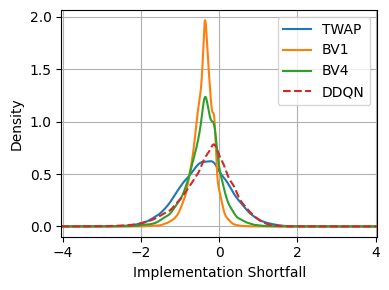

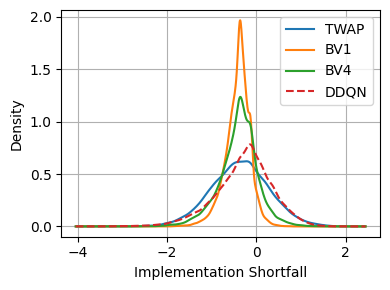

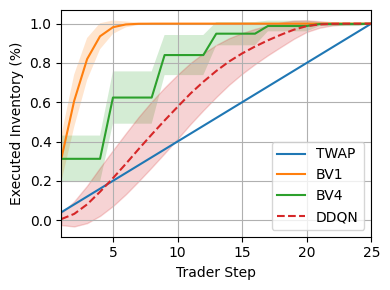

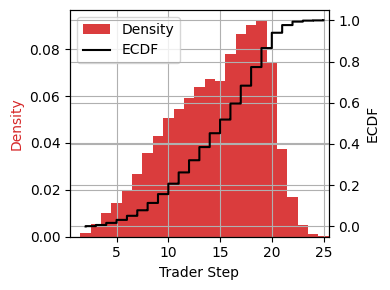

NameError: name 'plot_mean_distance_boxplots' is not defined

: 

In [ ]:
run_id = '9cah8h26'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

### Q values

unzip the saved model to load the NN weights

In [ ]:
class DummyEnv(gym.Env):
    def __init__(self):
        super().__init__()
        self.observation_space = gym.spaces.Box(
            low=-1.0, high=1.0, shape=(state_dim,), dtype=float
        )
        self.action_space = gym.spaces.Discrete(action_dim)

    def reset(self):
        return self.observation_space.sample(), {}

    def step(self, action):
        return self.observation_space.sample(), 0.0, True, False, {}

dummy_env = DummyEnv()

# --- Define same policy as training ---
policy_kwargs = dict(
    net_arch=[30, 30, 30, 30, 30],
    activation_fn=nn.LeakyReLU,
)

# --- Recreate model with dummy env ---
model = DQN(
    policy="MlpPolicy",
    env=dummy_env,
    policy_kwargs=policy_kwargs,
    device="cpu",  # or "cuda"
)

# --- Load NN weights ---
path = f"/scratch/network/te6653/qrm_optimal_execution/save_model/ddqn_{run_id}/policy.pth"
state_dict = torch.load(path, map_location=model.device)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# --- Now you can call the NN directly ---
obs = torch.zeros((1, state_dim))  # example input
q_values = model.policy.q_net(obs)
print("Q-values:", q_values)


c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/attr_value.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/tensor.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framewo

Q-values: tensor([[-0.2632, -0.2349]], grad_fn=<AddmmBackward0>)


Pick the action: `show_action`

In [ ]:

# --- assume your SB3 DQN `model` is already created and loaded ---
model.policy.set_training_mode(False)
device = model.device

# ---- Parameters ----
times_min = -0.7
times_max = 1.0
inv_min   = -1.0
inv_max   =  1.0

price   = 0.0
ask_vol = 0.0
bid_vol = 0.0

# ---- Grids ----
n_grid = 101
times = np.linspace(times_min, times_max, n_grid, dtype=np.float32)
invs  = np.linspace(inv_min,   inv_max,   n_grid, dtype=np.float32)
T_raw, I_raw = np.meshgrid(times, invs)

# Percent axes for plotting
time_pct = (T_raw - times_min) / (times_max - times_min) * 100.0
inv_pct  = (I_raw  - inv_min)   / (inv_max   - inv_min)   * 100.0

# ---- Build (N, 5) batch of states from the raw grid ----
N = n_grid * n_grid
states = np.column_stack([
    I_raw.reshape(-1),            # inventory
    T_raw.reshape(-1),            # time
    np.full(N, price,   np.float32),
    np.full(N, ask_vol, np.float32),
    np.full(N, bid_vol, np.float32),
]).astype(np.float32)
obs = torch.as_tensor(states, device=device)

# ---- Get Q-values ----
with torch.no_grad():
    pi = model.policy
    try:
        if getattr(pi, "features_extractor", None) is not None:
            feats = pi.features_extractor(obs)
            q_tensor = pi.q_net(feats)
        else:
            feats = pi.extract_features(obs)
            q_tensor = pi.q_net(feats)
    except Exception:
        q_tensor = pi.q_net(obs)

q_values  = q_tensor.detach().cpu().numpy()
n_actions = q_values.shape[1]

# ---- Standard Plotly figure ----
fig = go.Figure()
for a in range(n_actions):
    Z = q_values[:, a].reshape(n_grid, n_grid)
    fig.add_trace(
        go.Surface(
            x=time_pct, y=inv_pct, z=Z,
            name=f"Action {a}",
            showscale=(a == 0),                 # one colorbar
            colorbar=(dict(title="Q-value") if a == 0 else None)
        )
    )

# show only the action you want initially
show_action = 1
for i in range(n_actions):
    fig.data[i].visible = (i == show_action)

fig.update_layout(
    scene=dict(
        xaxis_title="Time (%)",
        yaxis_title="Remaining Inventory (%)",
        zaxis_title="Q-value",
        aspectmode="cube",
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)),  # optional starting view
)

# ---- Use FigureWidget so UI rotations sync back to Python ----
figw = go.FigureWidget(fig)
display(figw)

# ✅ Correct callback signature: (layout, value)
def _on_cam_change(layout, camera_value):
    print("Updated camera:", camera_value)

figw.layout.on_change(_on_cam_change, 'scene.camera')

# Button to print the current camera on demand
btn = widgets.Button(description="Print current camera")
out = widgets.Output()

def _print_cam(_):
    with out:
        print(figw.layout.scene.camera)

btn.on_click(_print_cam)
display(btn, out)

fig.update_layout(scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)))

# IMPORTANT: don't call fig.show() here; it opens a non-synced view.


FigureWidget({
    'data': [{'colorbar': {'title': {'text': 'Q-value'}},
              'name': 'Action 0',
              'showscale': True,
              'type': 'surface',
              'uid': 'f54b2a48-591c-4520-8101-49d930fe1012',
              'visible': False,
              'x': {'bdata': ('AAAAANn/fz/1//8/AABAQPX/f0D9/5' ... 'IAAMBC///BQv//w0L//8VCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'y': {'bdata': ('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAA' ... 'IAAMhCAADIQgAAyEIAAMhCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'z': {'bdata': ('lgsAPgze9z0cpe893MnnPcw34z2Ewt' ... 'E+mJnBMkilwbAxscG3Lr3B9A7JwQ=='),
                    'dtype': 'f4',
                    'shape': '101, 101'}},
             {'name': 'Action 1',
              'showscale': False,
              'type': 'surface',
              'uid': 'cf895fb1-54b8-42a7-89e7-5296be534bb4',
              'visible': True,
   

Button(description='Print current camera', style=ButtonStyle())

Output()

In [ ]:
plotly_eye = {'x': 3.2, 'y': 3.2, 'z': 1.3}
elev, azim = plotly_eye_to_view_init(plotly_eye)
save_action_surface_pdf(elev, azim, show_action, q_values, n_grid, time_pct, inv_pct, filename=f"/scratch/network/te6653/qrm_optimal_execution/plots/q_values/{run_id}_q_surface_action{show_action}.pdf")

## 5-dim: gibd5ndj - custom 3

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.298, std=0.705 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.3100% of runs did not reach full inventory
    Missing volume: avg=11.73, std=8.68, max=25.00



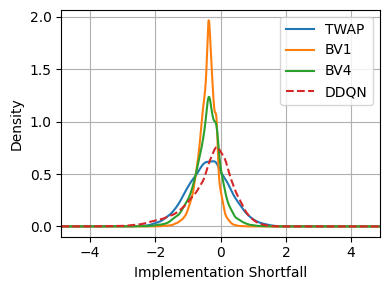

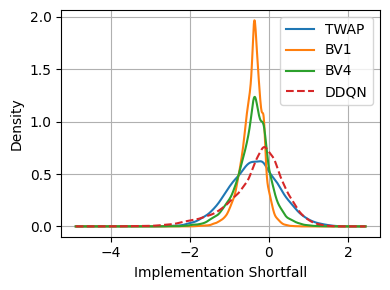

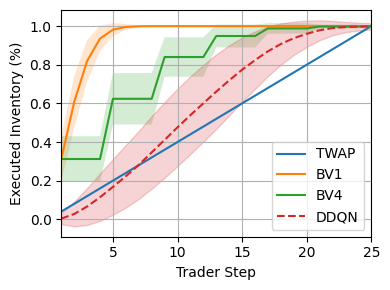

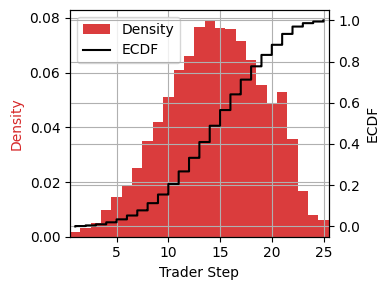

NameError: name 'plot_mean_distance_boxplots' is not defined

: 

In [ ]:
run_id = 'gibd5ndj'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

### Q values

unzip the saved model to load the NN weights

In [ ]:
class DummyEnv(gym.Env):
    def __init__(self):
        super().__init__()
        self.observation_space = gym.spaces.Box(
            low=-1.0, high=1.0, shape=(state_dim,), dtype=float
        )
        self.action_space = gym.spaces.Discrete(action_dim)

    def reset(self):
        return self.observation_space.sample(), {}

    def step(self, action):
        return self.observation_space.sample(), 0.0, True, False, {}

dummy_env = DummyEnv()

# --- Define same policy as training ---
policy_kwargs = dict(
    net_arch=[30, 30, 30, 30, 30],
    activation_fn=nn.LeakyReLU,
)

# --- Recreate model with dummy env ---
model = DQN(
    policy="MlpPolicy",
    env=dummy_env,
    policy_kwargs=policy_kwargs,
    device="cpu",  # or "cuda"
)

# --- Load NN weights ---
path = f"/scratch/network/te6653/qrm_optimal_execution/save_model/ddqn_{run_id}/policy.pth"
state_dict = torch.load(path, map_location=model.device)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# --- Now you can call the NN directly ---
obs = torch.zeros((1, state_dim))  # example input
q_values = model.policy.q_net(obs)
print("Q-values:", q_values)


c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/attr_value.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/tensor.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framewo

Q-values: tensor([[-0.2632, -0.2349]], grad_fn=<AddmmBackward0>)


Pick the action: `show_action`

In [ ]:

# --- assume your SB3 DQN `model` is already created and loaded ---
model.policy.set_training_mode(False)
device = model.device

# ---- Parameters ----
times_min = -0.7
times_max = 1.0
inv_min   = -1.0
inv_max   =  1.0

price   = 0.0
ask_vol = 0.0
bid_vol = 0.0

# ---- Grids ----
n_grid = 101
times = np.linspace(times_min, times_max, n_grid, dtype=np.float32)
invs  = np.linspace(inv_min,   inv_max,   n_grid, dtype=np.float32)
T_raw, I_raw = np.meshgrid(times, invs)

# Percent axes for plotting
time_pct = (T_raw - times_min) / (times_max - times_min) * 100.0
inv_pct  = (I_raw  - inv_min)   / (inv_max   - inv_min)   * 100.0

# ---- Build (N, 5) batch of states from the raw grid ----
N = n_grid * n_grid
states = np.column_stack([
    I_raw.reshape(-1),            # inventory
    T_raw.reshape(-1),            # time
    np.full(N, price,   np.float32),
    np.full(N, ask_vol, np.float32),
    np.full(N, bid_vol, np.float32),
]).astype(np.float32)
obs = torch.as_tensor(states, device=device)

# ---- Get Q-values ----
with torch.no_grad():
    pi = model.policy
    try:
        if getattr(pi, "features_extractor", None) is not None:
            feats = pi.features_extractor(obs)
            q_tensor = pi.q_net(feats)
        else:
            feats = pi.extract_features(obs)
            q_tensor = pi.q_net(feats)
    except Exception:
        q_tensor = pi.q_net(obs)

q_values  = q_tensor.detach().cpu().numpy()
n_actions = q_values.shape[1]

# ---- Standard Plotly figure ----
fig = go.Figure()
for a in range(n_actions):
    Z = q_values[:, a].reshape(n_grid, n_grid)
    fig.add_trace(
        go.Surface(
            x=time_pct, y=inv_pct, z=Z,
            name=f"Action {a}",
            showscale=(a == 0),                 # one colorbar
            colorbar=(dict(title="Q-value") if a == 0 else None)
        )
    )

# show only the action you want initially
show_action = 1
for i in range(n_actions):
    fig.data[i].visible = (i == show_action)

fig.update_layout(
    scene=dict(
        xaxis_title="Time (%)",
        yaxis_title="Remaining Inventory (%)",
        zaxis_title="Q-value",
        aspectmode="cube",
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)),  # optional starting view
)

# ---- Use FigureWidget so UI rotations sync back to Python ----
figw = go.FigureWidget(fig)
display(figw)

# ✅ Correct callback signature: (layout, value)
def _on_cam_change(layout, camera_value):
    print("Updated camera:", camera_value)

figw.layout.on_change(_on_cam_change, 'scene.camera')

# Button to print the current camera on demand
btn = widgets.Button(description="Print current camera")
out = widgets.Output()

def _print_cam(_):
    with out:
        print(figw.layout.scene.camera)

btn.on_click(_print_cam)
display(btn, out)

fig.update_layout(scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)))

# IMPORTANT: don't call fig.show() here; it opens a non-synced view.


FigureWidget({
    'data': [{'colorbar': {'title': {'text': 'Q-value'}},
              'name': 'Action 0',
              'showscale': True,
              'type': 'surface',
              'uid': 'f54b2a48-591c-4520-8101-49d930fe1012',
              'visible': False,
              'x': {'bdata': ('AAAAANn/fz/1//8/AABAQPX/f0D9/5' ... 'IAAMBC///BQv//w0L//8VCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'y': {'bdata': ('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAA' ... 'IAAMhCAADIQgAAyEIAAMhCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'z': {'bdata': ('lgsAPgze9z0cpe893MnnPcw34z2Ewt' ... 'E+mJnBMkilwbAxscG3Lr3B9A7JwQ=='),
                    'dtype': 'f4',
                    'shape': '101, 101'}},
             {'name': 'Action 1',
              'showscale': False,
              'type': 'surface',
              'uid': 'cf895fb1-54b8-42a7-89e7-5296be534bb4',
              'visible': True,
   

Button(description='Print current camera', style=ButtonStyle())

Output()

In [ ]:
plotly_eye = {'x': 3.2, 'y': 3.2, 'z': 1.3}
elev, azim = plotly_eye_to_view_init(plotly_eye)
save_action_surface_pdf(elev, azim, show_action, q_values, n_grid, time_pct, inv_pct, filename=f"/scratch/network/te6653/qrm_optimal_execution/plots/q_values/{run_id}_q_surface_action{show_action}.pdf")

## 5-dim: hyb649aq - custom 3

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.288, std=0.655 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 1.1100% of runs did not reach full inventory
    Missing volume: avg=12.85, std=8.60, max=25.00



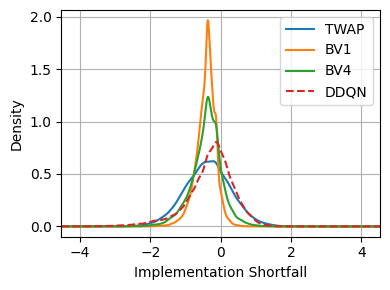

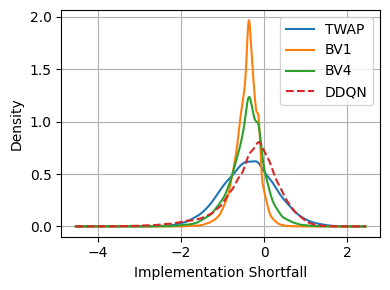

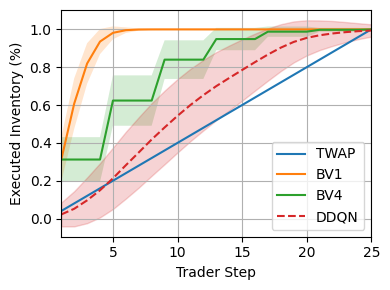

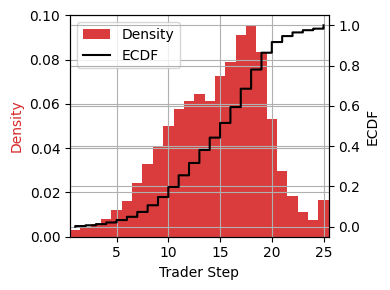

NameError: name 'plot_mean_distance_boxplots' is not defined

: 

In [ ]:
run_id = 'hyb649aq'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

### Q values

unzip the saved model to load the NN weights

In [ ]:
class DummyEnv(gym.Env):
    def __init__(self):
        super().__init__()
        self.observation_space = gym.spaces.Box(
            low=-1.0, high=1.0, shape=(state_dim,), dtype=float
        )
        self.action_space = gym.spaces.Discrete(action_dim)

    def reset(self):
        return self.observation_space.sample(), {}

    def step(self, action):
        return self.observation_space.sample(), 0.0, True, False, {}

dummy_env = DummyEnv()

# --- Define same policy as training ---
policy_kwargs = dict(
    net_arch=[30, 30, 30, 30, 30],
    activation_fn=nn.LeakyReLU,
)

# --- Recreate model with dummy env ---
model = DQN(
    policy="MlpPolicy",
    env=dummy_env,
    policy_kwargs=policy_kwargs,
    device="cpu",  # or "cuda"
)

# --- Load NN weights ---
path = f"/scratch/network/te6653/qrm_optimal_execution/save_model/ddqn_{run_id}/policy.pth"
state_dict = torch.load(path, map_location=model.device)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# --- Now you can call the NN directly ---
obs = torch.zeros((1, state_dim))  # example input
q_values = model.policy.q_net(obs)
print("Q-values:", q_values)


c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/attr_value.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/tensor.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framewo

Q-values: tensor([[-0.2632, -0.2349]], grad_fn=<AddmmBackward0>)


Pick the action: `show_action`

In [ ]:

# --- assume your SB3 DQN `model` is already created and loaded ---
model.policy.set_training_mode(False)
device = model.device

# ---- Parameters ----
times_min = -0.7
times_max = 1.0
inv_min   = -1.0
inv_max   =  1.0

price   = 0.0
ask_vol = 0.0
bid_vol = 0.0

# ---- Grids ----
n_grid = 101
times = np.linspace(times_min, times_max, n_grid, dtype=np.float32)
invs  = np.linspace(inv_min,   inv_max,   n_grid, dtype=np.float32)
T_raw, I_raw = np.meshgrid(times, invs)

# Percent axes for plotting
time_pct = (T_raw - times_min) / (times_max - times_min) * 100.0
inv_pct  = (I_raw  - inv_min)   / (inv_max   - inv_min)   * 100.0

# ---- Build (N, 5) batch of states from the raw grid ----
N = n_grid * n_grid
states = np.column_stack([
    I_raw.reshape(-1),            # inventory
    T_raw.reshape(-1),            # time
    np.full(N, price,   np.float32),
    np.full(N, ask_vol, np.float32),
    np.full(N, bid_vol, np.float32),
]).astype(np.float32)
obs = torch.as_tensor(states, device=device)

# ---- Get Q-values ----
with torch.no_grad():
    pi = model.policy
    try:
        if getattr(pi, "features_extractor", None) is not None:
            feats = pi.features_extractor(obs)
            q_tensor = pi.q_net(feats)
        else:
            feats = pi.extract_features(obs)
            q_tensor = pi.q_net(feats)
    except Exception:
        q_tensor = pi.q_net(obs)

q_values  = q_tensor.detach().cpu().numpy()
n_actions = q_values.shape[1]

# ---- Standard Plotly figure ----
fig = go.Figure()
for a in range(n_actions):
    Z = q_values[:, a].reshape(n_grid, n_grid)
    fig.add_trace(
        go.Surface(
            x=time_pct, y=inv_pct, z=Z,
            name=f"Action {a}",
            showscale=(a == 0),                 # one colorbar
            colorbar=(dict(title="Q-value") if a == 0 else None)
        )
    )

# show only the action you want initially
show_action = 1
for i in range(n_actions):
    fig.data[i].visible = (i == show_action)

fig.update_layout(
    scene=dict(
        xaxis_title="Time (%)",
        yaxis_title="Remaining Inventory (%)",
        zaxis_title="Q-value",
        aspectmode="cube",
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)),  # optional starting view
)

# ---- Use FigureWidget so UI rotations sync back to Python ----
figw = go.FigureWidget(fig)
display(figw)

# ✅ Correct callback signature: (layout, value)
def _on_cam_change(layout, camera_value):
    print("Updated camera:", camera_value)

figw.layout.on_change(_on_cam_change, 'scene.camera')

# Button to print the current camera on demand
btn = widgets.Button(description="Print current camera")
out = widgets.Output()

def _print_cam(_):
    with out:
        print(figw.layout.scene.camera)

btn.on_click(_print_cam)
display(btn, out)

fig.update_layout(scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)))

# IMPORTANT: don't call fig.show() here; it opens a non-synced view.


FigureWidget({
    'data': [{'colorbar': {'title': {'text': 'Q-value'}},
              'name': 'Action 0',
              'showscale': True,
              'type': 'surface',
              'uid': 'f54b2a48-591c-4520-8101-49d930fe1012',
              'visible': False,
              'x': {'bdata': ('AAAAANn/fz/1//8/AABAQPX/f0D9/5' ... 'IAAMBC///BQv//w0L//8VCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'y': {'bdata': ('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAA' ... 'IAAMhCAADIQgAAyEIAAMhCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'z': {'bdata': ('lgsAPgze9z0cpe893MnnPcw34z2Ewt' ... 'E+mJnBMkilwbAxscG3Lr3B9A7JwQ=='),
                    'dtype': 'f4',
                    'shape': '101, 101'}},
             {'name': 'Action 1',
              'showscale': False,
              'type': 'surface',
              'uid': 'cf895fb1-54b8-42a7-89e7-5296be534bb4',
              'visible': True,
   

Button(description='Print current camera', style=ButtonStyle())

Output()

In [ ]:
plotly_eye = {'x': 3.2, 'y': 3.2, 'z': 1.3}
elev, azim = plotly_eye_to_view_init(plotly_eye)
save_action_surface_pdf(elev, azim, show_action, q_values, n_grid, time_pct, inv_pct, filename=f"/scratch/network/te6653/qrm_optimal_execution/plots/q_values/{run_id}_q_surface_action{show_action}.pdf")

## 5-dim: dexgzljg - custom 2

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.279, std=0.584 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.0050% of runs did not reach full inventory
    Missing volume: avg=7.00, std=0.00, max=7.00



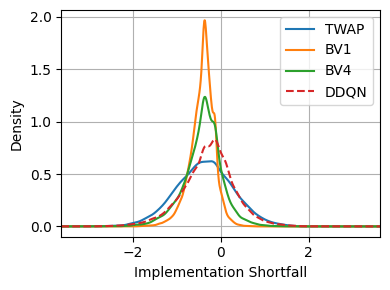

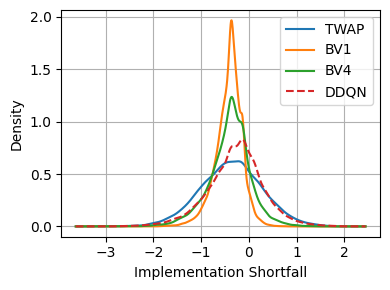

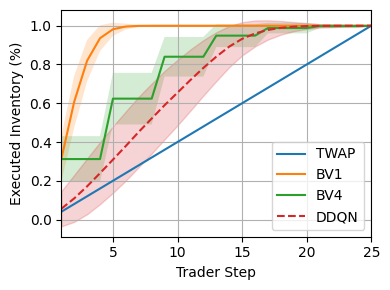

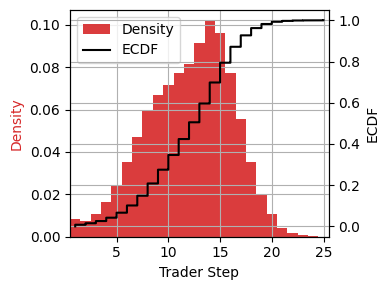

NameError: name 'plot_mean_distance_boxplots' is not defined

: 

In [ ]:
run_id = 'dexgzljg'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

### Q values

unzip the saved model to load the NN weights

In [ ]:
class DummyEnv(gym.Env):
    def __init__(self):
        super().__init__()
        self.observation_space = gym.spaces.Box(
            low=-1.0, high=1.0, shape=(state_dim,), dtype=float
        )
        self.action_space = gym.spaces.Discrete(action_dim)

    def reset(self):
        return self.observation_space.sample(), {}

    def step(self, action):
        return self.observation_space.sample(), 0.0, True, False, {}

dummy_env = DummyEnv()

# --- Define same policy as training ---
policy_kwargs = dict(
    net_arch=[30, 30, 30, 30, 30],
    activation_fn=nn.LeakyReLU,
)

# --- Recreate model with dummy env ---
model = DQN(
    policy="MlpPolicy",
    env=dummy_env,
    policy_kwargs=policy_kwargs,
    device="cpu",  # or "cuda"
)

# --- Load NN weights ---
path = f"/scratch/network/te6653/qrm_optimal_execution/save_model/ddqn_{run_id}/policy.pth"
state_dict = torch.load(path, map_location=model.device)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# --- Now you can call the NN directly ---
obs = torch.zeros((1, state_dim))  # example input
q_values = model.policy.q_net(obs)
print("Q-values:", q_values)


c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/attr_value.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/tensor.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framewo

Q-values: tensor([[-0.2632, -0.2349]], grad_fn=<AddmmBackward0>)


Pick the action: `show_action`

In [ ]:

# --- assume your SB3 DQN `model` is already created and loaded ---
model.policy.set_training_mode(False)
device = model.device

# ---- Parameters ----
times_min = -0.7
times_max = 1.0
inv_min   = -1.0
inv_max   =  1.0

price   = 0.0
ask_vol = 0.0
bid_vol = 0.0

# ---- Grids ----
n_grid = 101
times = np.linspace(times_min, times_max, n_grid, dtype=np.float32)
invs  = np.linspace(inv_min,   inv_max,   n_grid, dtype=np.float32)
T_raw, I_raw = np.meshgrid(times, invs)

# Percent axes for plotting
time_pct = (T_raw - times_min) / (times_max - times_min) * 100.0
inv_pct  = (I_raw  - inv_min)   / (inv_max   - inv_min)   * 100.0

# ---- Build (N, 5) batch of states from the raw grid ----
N = n_grid * n_grid
states = np.column_stack([
    I_raw.reshape(-1),            # inventory
    T_raw.reshape(-1),            # time
    np.full(N, price,   np.float32),
    np.full(N, ask_vol, np.float32),
    np.full(N, bid_vol, np.float32),
]).astype(np.float32)
obs = torch.as_tensor(states, device=device)

# ---- Get Q-values ----
with torch.no_grad():
    pi = model.policy
    try:
        if getattr(pi, "features_extractor", None) is not None:
            feats = pi.features_extractor(obs)
            q_tensor = pi.q_net(feats)
        else:
            feats = pi.extract_features(obs)
            q_tensor = pi.q_net(feats)
    except Exception:
        q_tensor = pi.q_net(obs)

q_values  = q_tensor.detach().cpu().numpy()
n_actions = q_values.shape[1]

# ---- Standard Plotly figure ----
fig = go.Figure()
for a in range(n_actions):
    Z = q_values[:, a].reshape(n_grid, n_grid)
    fig.add_trace(
        go.Surface(
            x=time_pct, y=inv_pct, z=Z,
            name=f"Action {a}",
            showscale=(a == 0),                 # one colorbar
            colorbar=(dict(title="Q-value") if a == 0 else None)
        )
    )

# show only the action you want initially
show_action = 1
for i in range(n_actions):
    fig.data[i].visible = (i == show_action)

fig.update_layout(
    scene=dict(
        xaxis_title="Time (%)",
        yaxis_title="Remaining Inventory (%)",
        zaxis_title="Q-value",
        aspectmode="cube",
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)),  # optional starting view
)

# ---- Use FigureWidget so UI rotations sync back to Python ----
figw = go.FigureWidget(fig)
display(figw)

# ✅ Correct callback signature: (layout, value)
def _on_cam_change(layout, camera_value):
    print("Updated camera:", camera_value)

figw.layout.on_change(_on_cam_change, 'scene.camera')

# Button to print the current camera on demand
btn = widgets.Button(description="Print current camera")
out = widgets.Output()

def _print_cam(_):
    with out:
        print(figw.layout.scene.camera)

btn.on_click(_print_cam)
display(btn, out)

fig.update_layout(scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)))

# IMPORTANT: don't call fig.show() here; it opens a non-synced view.


FigureWidget({
    'data': [{'colorbar': {'title': {'text': 'Q-value'}},
              'name': 'Action 0',
              'showscale': True,
              'type': 'surface',
              'uid': 'f54b2a48-591c-4520-8101-49d930fe1012',
              'visible': False,
              'x': {'bdata': ('AAAAANn/fz/1//8/AABAQPX/f0D9/5' ... 'IAAMBC///BQv//w0L//8VCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'y': {'bdata': ('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAA' ... 'IAAMhCAADIQgAAyEIAAMhCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'z': {'bdata': ('lgsAPgze9z0cpe893MnnPcw34z2Ewt' ... 'E+mJnBMkilwbAxscG3Lr3B9A7JwQ=='),
                    'dtype': 'f4',
                    'shape': '101, 101'}},
             {'name': 'Action 1',
              'showscale': False,
              'type': 'surface',
              'uid': 'cf895fb1-54b8-42a7-89e7-5296be534bb4',
              'visible': True,
   

Button(description='Print current camera', style=ButtonStyle())

Output()

In [ ]:
plotly_eye = {'x': 3.2, 'y': 3.2, 'z': 1.3}
elev, azim = plotly_eye_to_view_init(plotly_eye)
save_action_surface_pdf(elev, azim, show_action, q_values, n_grid, time_pct, inv_pct, filename=f"/scratch/network/te6653/qrm_optimal_execution/plots/q_values/{run_id}_q_surface_action{show_action}.pdf")

## 5-dim: m0b8jsnu - 2630426 21/09/2025 3h-30N-1-share

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.298, std=0.793 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.0000% of runs did not reach full inventory
[DDQN] 7.9950% of runs did not reach full inventory
    Missing volume: avg=1.00, std=0.00, max=1.00



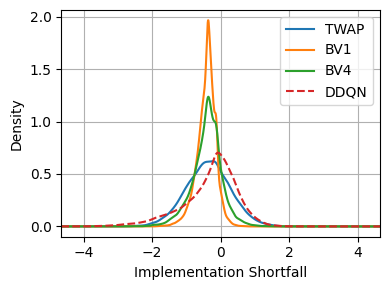

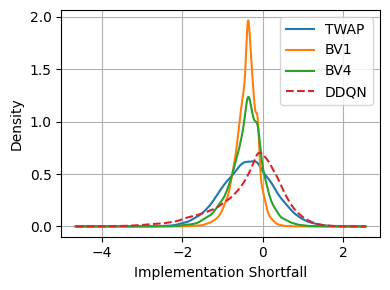

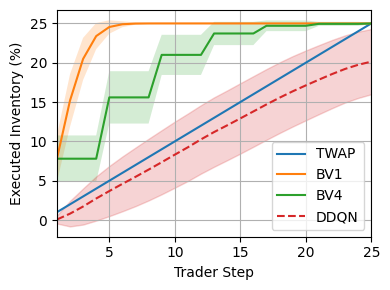

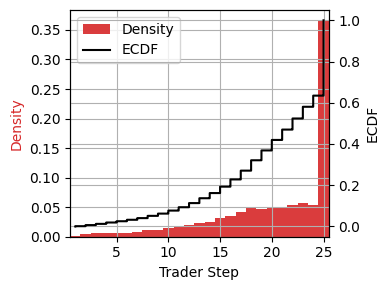

NameError: name 'plot_mean_distance_boxplots' is not defined

: 

In [ ]:
run_id = 'm0b8jsnu'
state_dim = 5
action_dim = 2
initial_inventory = 1
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

### Q values

unzip the saved model to load the NN weights

In [ ]:
class DummyEnv(gym.Env):
    def __init__(self):
        super().__init__()
        self.observation_space = gym.spaces.Box(
            low=-1.0, high=1.0, shape=(state_dim,), dtype=float
        )
        self.action_space = gym.spaces.Discrete(action_dim)

    def reset(self):
        return self.observation_space.sample(), {}

    def step(self, action):
        return self.observation_space.sample(), 0.0, True, False, {}

dummy_env = DummyEnv()

# --- Define same policy as training ---
policy_kwargs = dict(
    net_arch=[30, 30, 30, 30, 30],
    activation_fn=nn.LeakyReLU,
)

# --- Recreate model with dummy env ---
model = DQN(
    policy="MlpPolicy",
    env=dummy_env,
    policy_kwargs=policy_kwargs,
    device="cpu",  # or "cuda"
)

# --- Load NN weights ---
path = f"/scratch/network/te6653/qrm_optimal_execution/save_model/ddqn_{run_id}/policy.pth"
state_dict = torch.load(path, map_location=model.device)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# --- Now you can call the NN directly ---
obs = torch.zeros((1, state_dim))  # example input
q_values = model.policy.q_net(obs)
print("Q-values:", q_values)


c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/attr_value.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/tensor.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framewo

Q-values: tensor([[-0.2632, -0.2349]], grad_fn=<AddmmBackward0>)


Pick the action: `show_action`

In [ ]:

# --- assume your SB3 DQN `model` is already created and loaded ---
model.policy.set_training_mode(False)
device = model.device

# ---- Parameters ----
times_min = -0.7
times_max = 1.0
inv_min   = -1.0
inv_max   =  1.0

price   = 0.0
ask_vol = 0.0
bid_vol = 0.0

# ---- Grids ----
n_grid = 101
times = np.linspace(times_min, times_max, n_grid, dtype=np.float32)
invs  = np.linspace(inv_min,   inv_max,   n_grid, dtype=np.float32)
T_raw, I_raw = np.meshgrid(times, invs)

# Percent axes for plotting
time_pct = (T_raw - times_min) / (times_max - times_min) * 100.0
inv_pct  = (I_raw  - inv_min)   / (inv_max   - inv_min)   * 100.0

# ---- Build (N, 5) batch of states from the raw grid ----
N = n_grid * n_grid
states = np.column_stack([
    I_raw.reshape(-1),            # inventory
    T_raw.reshape(-1),            # time
    np.full(N, price,   np.float32),
    np.full(N, ask_vol, np.float32),
    np.full(N, bid_vol, np.float32),
]).astype(np.float32)
obs = torch.as_tensor(states, device=device)

# ---- Get Q-values ----
with torch.no_grad():
    pi = model.policy
    try:
        if getattr(pi, "features_extractor", None) is not None:
            feats = pi.features_extractor(obs)
            q_tensor = pi.q_net(feats)
        else:
            feats = pi.extract_features(obs)
            q_tensor = pi.q_net(feats)
    except Exception:
        q_tensor = pi.q_net(obs)

q_values  = q_tensor.detach().cpu().numpy()
n_actions = q_values.shape[1]

# ---- Standard Plotly figure ----
fig = go.Figure()
for a in range(n_actions):
    Z = q_values[:, a].reshape(n_grid, n_grid)
    fig.add_trace(
        go.Surface(
            x=time_pct, y=inv_pct, z=Z,
            name=f"Action {a}",
            showscale=(a == 0),                 # one colorbar
            colorbar=(dict(title="Q-value") if a == 0 else None)
        )
    )

# show only the action you want initially
show_action = 1
for i in range(n_actions):
    fig.data[i].visible = (i == show_action)

fig.update_layout(
    scene=dict(
        xaxis_title="Time (%)",
        yaxis_title="Remaining Inventory (%)",
        zaxis_title="Q-value",
        aspectmode="cube",
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)),  # optional starting view
)

# ---- Use FigureWidget so UI rotations sync back to Python ----
figw = go.FigureWidget(fig)
display(figw)

# ✅ Correct callback signature: (layout, value)
def _on_cam_change(layout, camera_value):
    print("Updated camera:", camera_value)

figw.layout.on_change(_on_cam_change, 'scene.camera')

# Button to print the current camera on demand
btn = widgets.Button(description="Print current camera")
out = widgets.Output()

def _print_cam(_):
    with out:
        print(figw.layout.scene.camera)

btn.on_click(_print_cam)
display(btn, out)

fig.update_layout(scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)))

# IMPORTANT: don't call fig.show() here; it opens a non-synced view.


FigureWidget({
    'data': [{'colorbar': {'title': {'text': 'Q-value'}},
              'name': 'Action 0',
              'showscale': True,
              'type': 'surface',
              'uid': 'f54b2a48-591c-4520-8101-49d930fe1012',
              'visible': False,
              'x': {'bdata': ('AAAAANn/fz/1//8/AABAQPX/f0D9/5' ... 'IAAMBC///BQv//w0L//8VCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'y': {'bdata': ('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAA' ... 'IAAMhCAADIQgAAyEIAAMhCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'z': {'bdata': ('lgsAPgze9z0cpe893MnnPcw34z2Ewt' ... 'E+mJnBMkilwbAxscG3Lr3B9A7JwQ=='),
                    'dtype': 'f4',
                    'shape': '101, 101'}},
             {'name': 'Action 1',
              'showscale': False,
              'type': 'surface',
              'uid': 'cf895fb1-54b8-42a7-89e7-5296be534bb4',
              'visible': True,
   

Button(description='Print current camera', style=ButtonStyle())

Output()

In [ ]:
plotly_eye = {'x': 3.2, 'y': 3.2, 'z': 1.3}
elev, azim = plotly_eye_to_view_init(plotly_eye)
save_action_surface_pdf(elev, azim, show_action, q_values, n_grid, time_pct, inv_pct, filename=f"/scratch/network/te6653/qrm_optimal_execution/plots/q_values/{run_id}_q_surface_action{show_action}.pdf")

## 5-dim: og0qwlq3 - 2630426 21/09/2025 3h-30N-1-share

### General

[DDQN] IS: mean=-0.353, std=0.817 

[DDQN] 0.0000% of runs did not reach full inventory


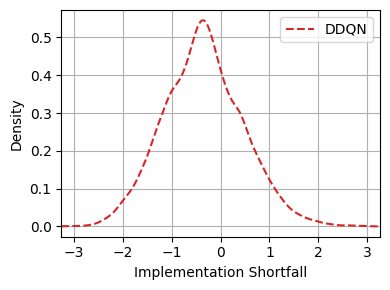

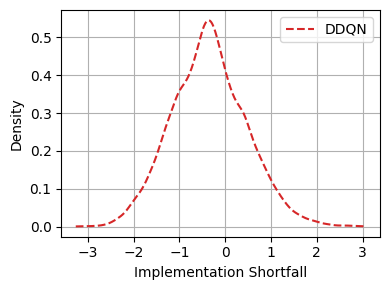

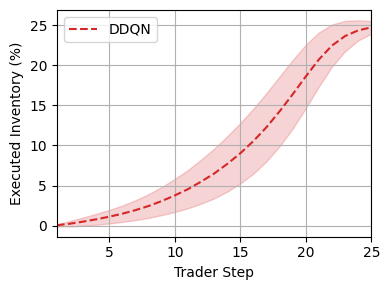

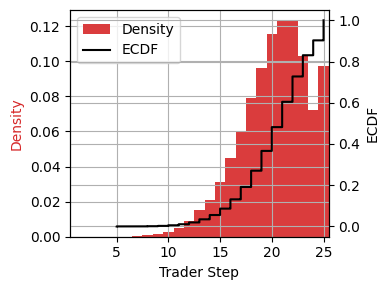

NameError: name 'plot_mean_distance_boxplots' is not defined

: 

In [ ]:
run_id = 'og0qwlq3'
state_dim = 5
action_dim = 2
initial_inventory = 1
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['DDQN']
best_labels = ['DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

### Q values

unzip the saved model to load the NN weights

In [ ]:
class DummyEnv(gym.Env):
    def __init__(self):
        super().__init__()
        self.observation_space = gym.spaces.Box(
            low=-1.0, high=1.0, shape=(state_dim,), dtype=float
        )
        self.action_space = gym.spaces.Discrete(action_dim)

    def reset(self):
        return self.observation_space.sample(), {}

    def step(self, action):
        return self.observation_space.sample(), 0.0, True, False, {}

dummy_env = DummyEnv()

# --- Define same policy as training ---
policy_kwargs = dict(
    net_arch=[30, 30, 30, 30, 30],
    activation_fn=nn.LeakyReLU,
)

# --- Recreate model with dummy env ---
model = DQN(
    policy="MlpPolicy",
    env=dummy_env,
    policy_kwargs=policy_kwargs,
    device="cpu",  # or "cuda"
)

# --- Load NN weights ---
path = f"/scratch/network/te6653/qrm_optimal_execution/save_model/ddqn_{run_id}/policy.pth"
state_dict = torch.load(path, map_location=model.device)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# --- Now you can call the NN directly ---
obs = torch.zeros((1, state_dim))  # example input
q_values = model.policy.q_net(obs)
print("Q-values:", q_values)


c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/attr_value.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/tensor.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framewo

Q-values: tensor([[-0.2632, -0.2349]], grad_fn=<AddmmBackward0>)


Pick the action: `show_action`

In [ ]:

# --- assume your SB3 DQN `model` is already created and loaded ---
model.policy.set_training_mode(False)
device = model.device

# ---- Parameters ----
times_min = -0.7
times_max = 1.0
inv_min   = -1.0
inv_max   =  1.0

price   = 0.0
ask_vol = 0.0
bid_vol = 0.0

# ---- Grids ----
n_grid = 101
times = np.linspace(times_min, times_max, n_grid, dtype=np.float32)
invs  = np.linspace(inv_min,   inv_max,   n_grid, dtype=np.float32)
T_raw, I_raw = np.meshgrid(times, invs)

# Percent axes for plotting
time_pct = (T_raw - times_min) / (times_max - times_min) * 100.0
inv_pct  = (I_raw  - inv_min)   / (inv_max   - inv_min)   * 100.0

# ---- Build (N, 5) batch of states from the raw grid ----
N = n_grid * n_grid
states = np.column_stack([
    I_raw.reshape(-1),            # inventory
    T_raw.reshape(-1),            # time
    np.full(N, price,   np.float32),
    np.full(N, ask_vol, np.float32),
    np.full(N, bid_vol, np.float32),
]).astype(np.float32)
obs = torch.as_tensor(states, device=device)

# ---- Get Q-values ----
with torch.no_grad():
    pi = model.policy
    try:
        if getattr(pi, "features_extractor", None) is not None:
            feats = pi.features_extractor(obs)
            q_tensor = pi.q_net(feats)
        else:
            feats = pi.extract_features(obs)
            q_tensor = pi.q_net(feats)
    except Exception:
        q_tensor = pi.q_net(obs)

q_values  = q_tensor.detach().cpu().numpy()
n_actions = q_values.shape[1]

# ---- Standard Plotly figure ----
fig = go.Figure()
for a in range(n_actions):
    Z = q_values[:, a].reshape(n_grid, n_grid)
    fig.add_trace(
        go.Surface(
            x=time_pct, y=inv_pct, z=Z,
            name=f"Action {a}",
            showscale=(a == 0),                 # one colorbar
            colorbar=(dict(title="Q-value") if a == 0 else None)
        )
    )

# show only the action you want initially
show_action = 1
for i in range(n_actions):
    fig.data[i].visible = (i == show_action)

fig.update_layout(
    scene=dict(
        xaxis_title="Time (%)",
        yaxis_title="Remaining Inventory (%)",
        zaxis_title="Q-value",
        aspectmode="cube",
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)),  # optional starting view
)

# ---- Use FigureWidget so UI rotations sync back to Python ----
figw = go.FigureWidget(fig)
display(figw)

# ✅ Correct callback signature: (layout, value)
def _on_cam_change(layout, camera_value):
    print("Updated camera:", camera_value)

figw.layout.on_change(_on_cam_change, 'scene.camera')

# Button to print the current camera on demand
btn = widgets.Button(description="Print current camera")
out = widgets.Output()

def _print_cam(_):
    with out:
        print(figw.layout.scene.camera)

btn.on_click(_print_cam)
display(btn, out)

fig.update_layout(scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)))

# IMPORTANT: don't call fig.show() here; it opens a non-synced view.


FigureWidget({
    'data': [{'colorbar': {'title': {'text': 'Q-value'}},
              'name': 'Action 0',
              'showscale': True,
              'type': 'surface',
              'uid': 'f54b2a48-591c-4520-8101-49d930fe1012',
              'visible': False,
              'x': {'bdata': ('AAAAANn/fz/1//8/AABAQPX/f0D9/5' ... 'IAAMBC///BQv//w0L//8VCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'y': {'bdata': ('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAA' ... 'IAAMhCAADIQgAAyEIAAMhCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'z': {'bdata': ('lgsAPgze9z0cpe893MnnPcw34z2Ewt' ... 'E+mJnBMkilwbAxscG3Lr3B9A7JwQ=='),
                    'dtype': 'f4',
                    'shape': '101, 101'}},
             {'name': 'Action 1',
              'showscale': False,
              'type': 'surface',
              'uid': 'cf895fb1-54b8-42a7-89e7-5296be534bb4',
              'visible': True,
   

Button(description='Print current camera', style=ButtonStyle())

Output()

In [ ]:
plotly_eye = {'x': 3.2, 'y': 3.2, 'z': 1.3}
elev, azim = plotly_eye_to_view_init(plotly_eye)
save_action_surface_pdf(elev, azim, show_action, q_values, n_grid, time_pct, inv_pct, filename=f"/scratch/network/te6653/qrm_optimal_execution/plots/q_values/{run_id}_q_surface_action{show_action}.pdf")

## 5-dim: zxc69mou - 2630428 22/09/2025 8h-30N-exp-decay-lr

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.290, std=0.497 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.0100% of runs did not reach full inventory
    Missing volume: avg=1.00, std=0.00, max=1.00



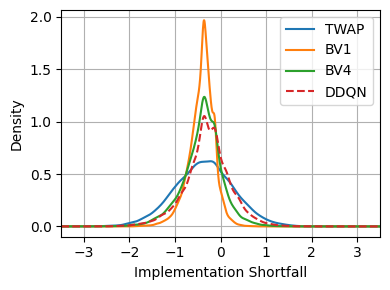

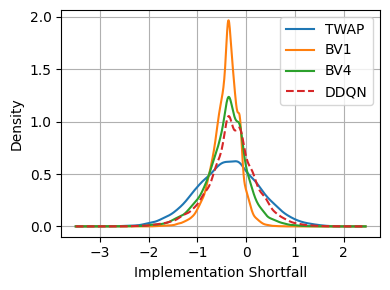

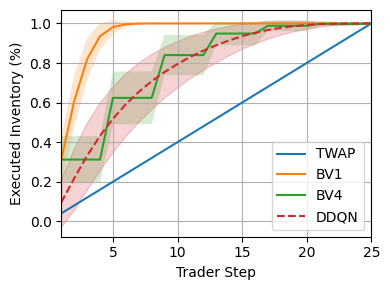

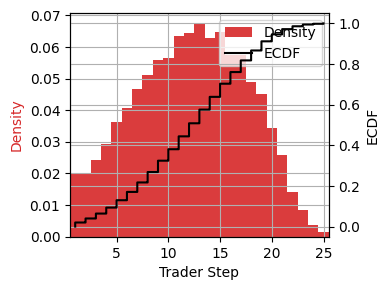

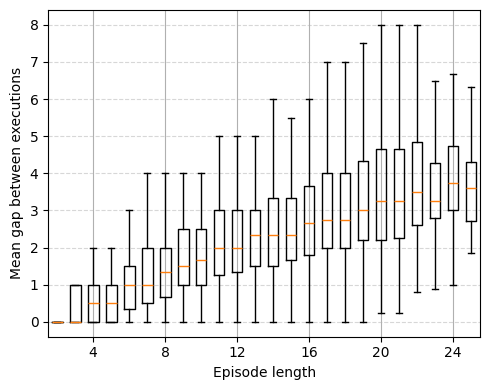

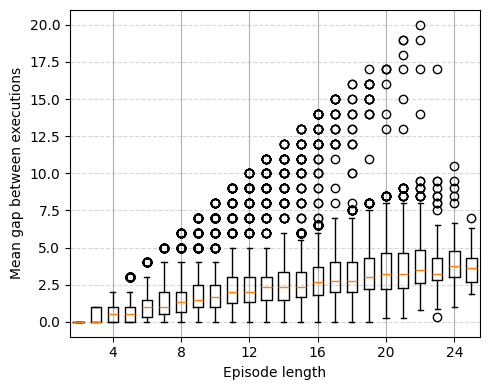

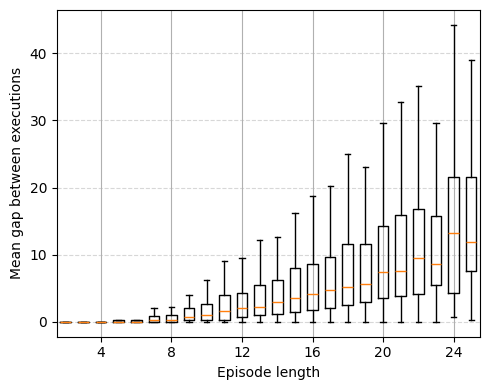

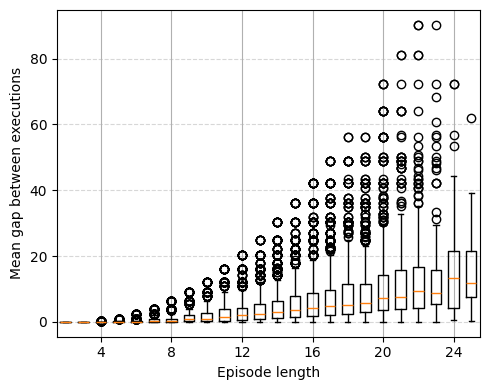

: 

In [ ]:
run_id = 'zxc69mou'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

### Q values

unzip the saved model to load the NN weights

In [ ]:
class DummyEnv(gym.Env):
    def __init__(self):
        super().__init__()
        self.observation_space = gym.spaces.Box(
            low=-1.0, high=1.0, shape=(state_dim,), dtype=float
        )
        self.action_space = gym.spaces.Discrete(action_dim)

    def reset(self):
        return self.observation_space.sample(), {}

    def step(self, action):
        return self.observation_space.sample(), 0.0, True, False, {}

dummy_env = DummyEnv()

# --- Define same policy as training ---
policy_kwargs = dict(
    net_arch=[30, 30, 30, 30, 30],
    activation_fn=nn.LeakyReLU,
)

# --- Recreate model with dummy env ---
model = DQN(
    policy="MlpPolicy",
    env=dummy_env,
    policy_kwargs=policy_kwargs,
    device="cpu",  # or "cuda"
)

# --- Load NN weights ---
path = f"/scratch/network/te6653/qrm_optimal_execution/save_model/ddqn_{run_id}/policy.pth"
state_dict = torch.load(path, map_location=model.device)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# --- Now you can call the NN directly ---
obs = torch.zeros((1, state_dim))  # example input
q_values = model.policy.q_net(obs)
print("Q-values:", q_values)


c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/attr_value.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/tensor.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framewo

Q-values: tensor([[-0.2632, -0.2349]], grad_fn=<AddmmBackward0>)


Pick the action: `show_action`

In [ ]:

# --- assume your SB3 DQN `model` is already created and loaded ---
model.policy.set_training_mode(False)
device = model.device

# ---- Parameters ----
times_min = -0.7
times_max = 1.0
inv_min   = -1.0
inv_max   =  1.0

price   = 0.0
ask_vol = 0.0
bid_vol = 0.0

# ---- Grids ----
n_grid = 101
times = np.linspace(times_min, times_max, n_grid, dtype=np.float32)
invs  = np.linspace(inv_min,   inv_max,   n_grid, dtype=np.float32)
T_raw, I_raw = np.meshgrid(times, invs)

# Percent axes for plotting
time_pct = (T_raw - times_min) / (times_max - times_min) * 100.0
inv_pct  = (I_raw  - inv_min)   / (inv_max   - inv_min)   * 100.0

# ---- Build (N, 5) batch of states from the raw grid ----
N = n_grid * n_grid
states = np.column_stack([
    I_raw.reshape(-1),            # inventory
    T_raw.reshape(-1),            # time
    np.full(N, price,   np.float32),
    np.full(N, ask_vol, np.float32),
    np.full(N, bid_vol, np.float32),
]).astype(np.float32)
obs = torch.as_tensor(states, device=device)

# ---- Get Q-values ----
with torch.no_grad():
    pi = model.policy
    try:
        if getattr(pi, "features_extractor", None) is not None:
            feats = pi.features_extractor(obs)
            q_tensor = pi.q_net(feats)
        else:
            feats = pi.extract_features(obs)
            q_tensor = pi.q_net(feats)
    except Exception:
        q_tensor = pi.q_net(obs)

q_values  = q_tensor.detach().cpu().numpy()
n_actions = q_values.shape[1]

# ---- Standard Plotly figure ----
fig = go.Figure()
for a in range(n_actions):
    Z = q_values[:, a].reshape(n_grid, n_grid)
    fig.add_trace(
        go.Surface(
            x=time_pct, y=inv_pct, z=Z,
            name=f"Action {a}",
            showscale=(a == 0),                 # one colorbar
            colorbar=(dict(title="Q-value") if a == 0 else None)
        )
    )

# show only the action you want initially
show_action = 1
for i in range(n_actions):
    fig.data[i].visible = (i == show_action)

fig.update_layout(
    scene=dict(
        xaxis_title="Time (%)",
        yaxis_title="Remaining Inventory (%)",
        zaxis_title="Q-value",
        aspectmode="cube",
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)),  # optional starting view
)

# ---- Use FigureWidget so UI rotations sync back to Python ----
figw = go.FigureWidget(fig)
display(figw)

# ✅ Correct callback signature: (layout, value)
def _on_cam_change(layout, camera_value):
    print("Updated camera:", camera_value)

figw.layout.on_change(_on_cam_change, 'scene.camera')

# Button to print the current camera on demand
btn = widgets.Button(description="Print current camera")
out = widgets.Output()

def _print_cam(_):
    with out:
        print(figw.layout.scene.camera)

btn.on_click(_print_cam)
display(btn, out)

fig.update_layout(scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)))

# IMPORTANT: don't call fig.show() here; it opens a non-synced view.


FigureWidget({
    'data': [{'colorbar': {'title': {'text': 'Q-value'}},
              'name': 'Action 0',
              'showscale': True,
              'type': 'surface',
              'uid': 'f54b2a48-591c-4520-8101-49d930fe1012',
              'visible': False,
              'x': {'bdata': ('AAAAANn/fz/1//8/AABAQPX/f0D9/5' ... 'IAAMBC///BQv//w0L//8VCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'y': {'bdata': ('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAA' ... 'IAAMhCAADIQgAAyEIAAMhCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'z': {'bdata': ('lgsAPgze9z0cpe893MnnPcw34z2Ewt' ... 'E+mJnBMkilwbAxscG3Lr3B9A7JwQ=='),
                    'dtype': 'f4',
                    'shape': '101, 101'}},
             {'name': 'Action 1',
              'showscale': False,
              'type': 'surface',
              'uid': 'cf895fb1-54b8-42a7-89e7-5296be534bb4',
              'visible': True,
   

Button(description='Print current camera', style=ButtonStyle())

Output()

In [ ]:
plotly_eye = {'x': 3.2, 'y': 3.2, 'z': 1.3}
elev, azim = plotly_eye_to_view_init(plotly_eye)
save_action_surface_pdf(elev, azim, show_action, q_values, n_grid, time_pct, inv_pct, filename=f"/scratch/network/te6653/qrm_optimal_execution/plots/q_values/{run_id}_q_surface_action{show_action}.pdf")

## 5-dim: 55ke44jx - 2630356 21/09/2025 3h-30N-exp-decay-lr

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.278, std=0.549 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.0500% of runs did not reach full inventory
    Missing volume: avg=3.40, std=1.80, max=6.00



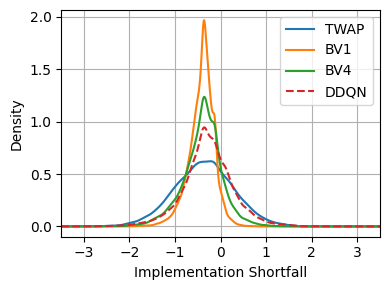

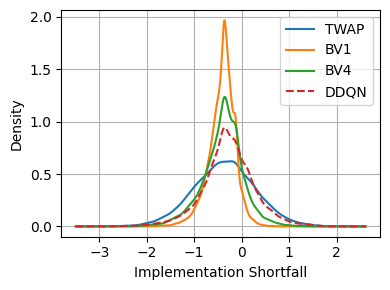

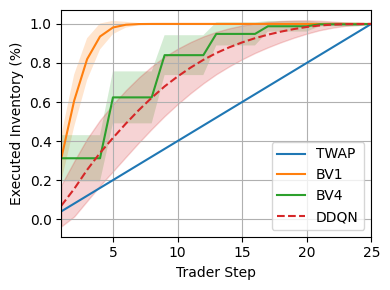

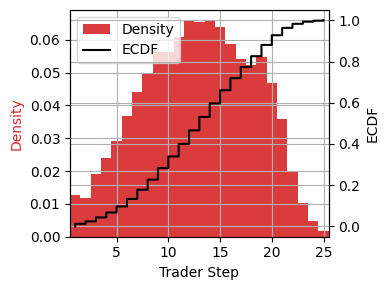

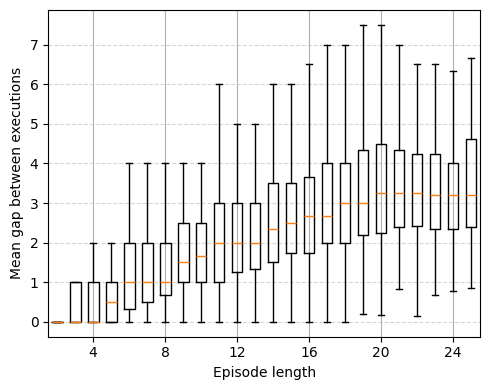

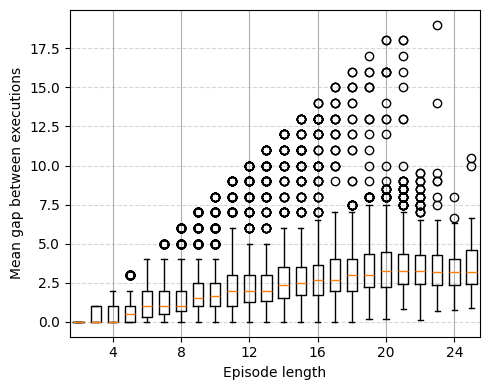

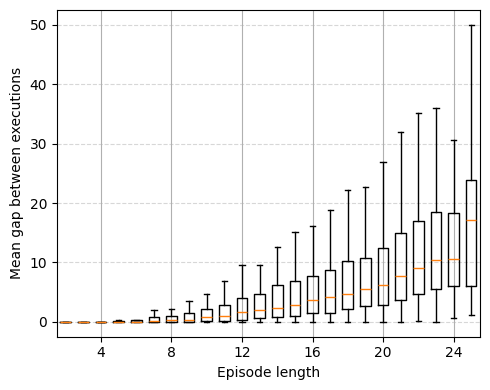

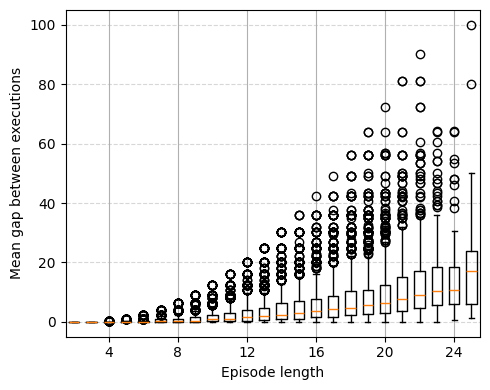

: 

In [ ]:
run_id = '55ke44jx'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

### Q values

unzip the saved model to load the NN weights

In [ ]:
class DummyEnv(gym.Env):
    def __init__(self):
        super().__init__()
        self.observation_space = gym.spaces.Box(
            low=-1.0, high=1.0, shape=(state_dim,), dtype=float
        )
        self.action_space = gym.spaces.Discrete(action_dim)

    def reset(self):
        return self.observation_space.sample(), {}

    def step(self, action):
        return self.observation_space.sample(), 0.0, True, False, {}

dummy_env = DummyEnv()

# --- Define same policy as training ---
policy_kwargs = dict(
    net_arch=[30, 30, 30, 30, 30],
    activation_fn=nn.LeakyReLU,
)

# --- Recreate model with dummy env ---
model = DQN(
    policy="MlpPolicy",
    env=dummy_env,
    policy_kwargs=policy_kwargs,
    device="cpu",  # or "cuda"
)

# --- Load NN weights ---
path = f"/scratch/network/te6653/qrm_optimal_execution/save_model/ddqn_{run_id}/policy.pth"
state_dict = torch.load(path, map_location=model.device)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# --- Now you can call the NN directly ---
obs = torch.zeros((1, state_dim))  # example input
q_values = model.policy.q_net(obs)
print("Q-values:", q_values)


c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/attr_value.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/tensor.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framewo

Q-values: tensor([[-0.2632, -0.2349]], grad_fn=<AddmmBackward0>)


Pick the action: `show_action`

In [ ]:

# --- assume your SB3 DQN `model` is already created and loaded ---
model.policy.set_training_mode(False)
device = model.device

# ---- Parameters ----
times_min = -0.7
times_max = 1.0
inv_min   = -1.0
inv_max   =  1.0

price   = 0.0
ask_vol = 0.0
bid_vol = 0.0

# ---- Grids ----
n_grid = 101
times = np.linspace(times_min, times_max, n_grid, dtype=np.float32)
invs  = np.linspace(inv_min,   inv_max,   n_grid, dtype=np.float32)
T_raw, I_raw = np.meshgrid(times, invs)

# Percent axes for plotting
time_pct = (T_raw - times_min) / (times_max - times_min) * 100.0
inv_pct  = (I_raw  - inv_min)   / (inv_max   - inv_min)   * 100.0

# ---- Build (N, 5) batch of states from the raw grid ----
N = n_grid * n_grid
states = np.column_stack([
    I_raw.reshape(-1),            # inventory
    T_raw.reshape(-1),            # time
    np.full(N, price,   np.float32),
    np.full(N, ask_vol, np.float32),
    np.full(N, bid_vol, np.float32),
]).astype(np.float32)
obs = torch.as_tensor(states, device=device)

# ---- Get Q-values ----
with torch.no_grad():
    pi = model.policy
    try:
        if getattr(pi, "features_extractor", None) is not None:
            feats = pi.features_extractor(obs)
            q_tensor = pi.q_net(feats)
        else:
            feats = pi.extract_features(obs)
            q_tensor = pi.q_net(feats)
    except Exception:
        q_tensor = pi.q_net(obs)

q_values  = q_tensor.detach().cpu().numpy()
n_actions = q_values.shape[1]

# ---- Standard Plotly figure ----
fig = go.Figure()
for a in range(n_actions):
    Z = q_values[:, a].reshape(n_grid, n_grid)
    fig.add_trace(
        go.Surface(
            x=time_pct, y=inv_pct, z=Z,
            name=f"Action {a}",
            showscale=(a == 0),                 # one colorbar
            colorbar=(dict(title="Q-value") if a == 0 else None)
        )
    )

# show only the action you want initially
show_action = 1
for i in range(n_actions):
    fig.data[i].visible = (i == show_action)

fig.update_layout(
    scene=dict(
        xaxis_title="Time (%)",
        yaxis_title="Remaining Inventory (%)",
        zaxis_title="Q-value",
        aspectmode="cube",
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)),  # optional starting view
)

# ---- Use FigureWidget so UI rotations sync back to Python ----
figw = go.FigureWidget(fig)
display(figw)

# ✅ Correct callback signature: (layout, value)
def _on_cam_change(layout, camera_value):
    print("Updated camera:", camera_value)

figw.layout.on_change(_on_cam_change, 'scene.camera')

# Button to print the current camera on demand
btn = widgets.Button(description="Print current camera")
out = widgets.Output()

def _print_cam(_):
    with out:
        print(figw.layout.scene.camera)

btn.on_click(_print_cam)
display(btn, out)

fig.update_layout(scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)))

# IMPORTANT: don't call fig.show() here; it opens a non-synced view.


FigureWidget({
    'data': [{'colorbar': {'title': {'text': 'Q-value'}},
              'name': 'Action 0',
              'showscale': True,
              'type': 'surface',
              'uid': 'f54b2a48-591c-4520-8101-49d930fe1012',
              'visible': False,
              'x': {'bdata': ('AAAAANn/fz/1//8/AABAQPX/f0D9/5' ... 'IAAMBC///BQv//w0L//8VCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'y': {'bdata': ('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAA' ... 'IAAMhCAADIQgAAyEIAAMhCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'z': {'bdata': ('lgsAPgze9z0cpe893MnnPcw34z2Ewt' ... 'E+mJnBMkilwbAxscG3Lr3B9A7JwQ=='),
                    'dtype': 'f4',
                    'shape': '101, 101'}},
             {'name': 'Action 1',
              'showscale': False,
              'type': 'surface',
              'uid': 'cf895fb1-54b8-42a7-89e7-5296be534bb4',
              'visible': True,
   

Button(description='Print current camera', style=ButtonStyle())

Output()

In [ ]:
plotly_eye = {'x': 3.2, 'y': 3.2, 'z': 1.3}
elev, azim = plotly_eye_to_view_init(plotly_eye)
save_action_surface_pdf(elev, azim, show_action, q_values, n_grid, time_pct, inv_pct, filename=f"/scratch/network/te6653/qrm_optimal_execution/plots/q_values/{run_id}_q_surface_action{show_action}.pdf")

## 5-dim: 289ickcm - 2630354 21/09/2025 3h-30N-1_share

### General

[DDQN] IS: mean=-0.381, std=0.825 

[DDQN] 2.9700% of runs did not reach full inventory
    Missing volume: avg=8.05, std=6.06, max=25.00



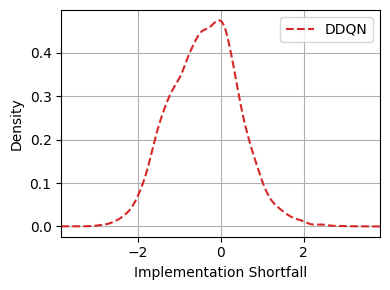

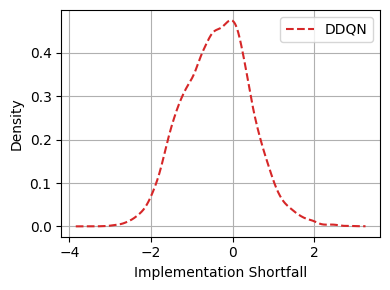

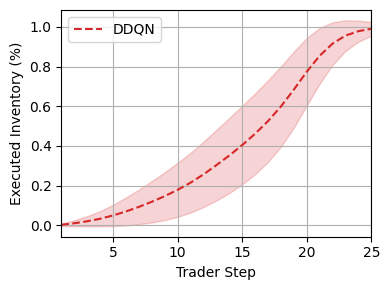

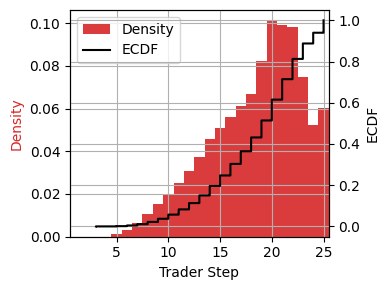

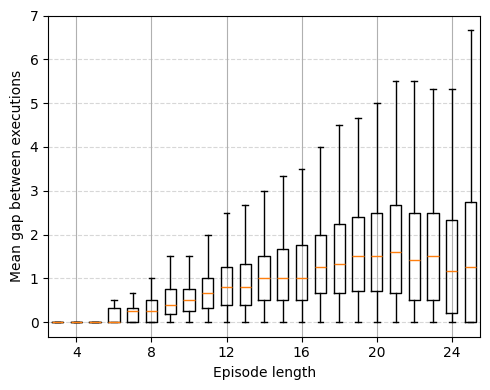

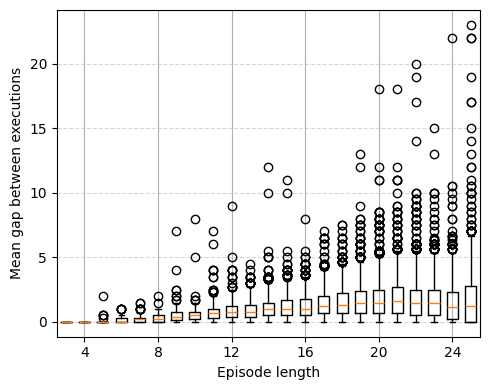

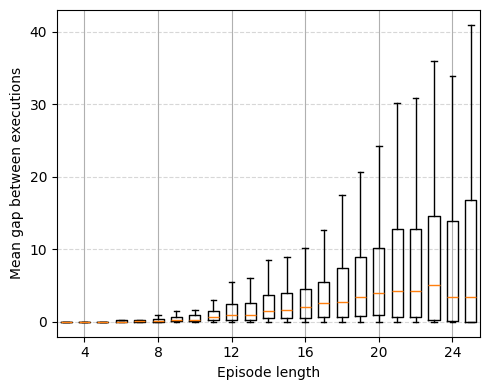

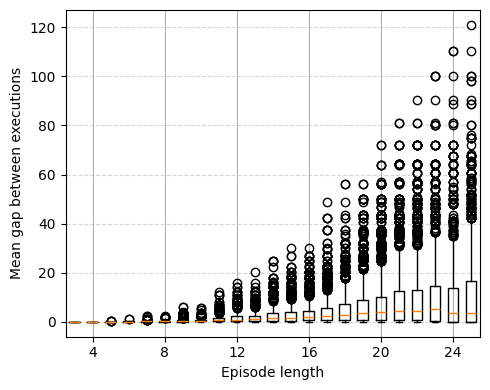

: 

In [ ]:
run_id = '289ickcm'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['DDQN']
best_labels = ['DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

### Q values

unzip the saved model to load the NN weights

In [ ]:
class DummyEnv(gym.Env):
    def __init__(self):
        super().__init__()
        self.observation_space = gym.spaces.Box(
            low=-1.0, high=1.0, shape=(state_dim,), dtype=float
        )
        self.action_space = gym.spaces.Discrete(action_dim)

    def reset(self):
        return self.observation_space.sample(), {}

    def step(self, action):
        return self.observation_space.sample(), 0.0, True, False, {}

dummy_env = DummyEnv()

# --- Define same policy as training ---
policy_kwargs = dict(
    net_arch=[30, 30, 30, 30, 30],
    activation_fn=nn.LeakyReLU,
)

# --- Recreate model with dummy env ---
model = DQN(
    policy="MlpPolicy",
    env=dummy_env,
    policy_kwargs=policy_kwargs,
    device="cpu",  # or "cuda"
)

# --- Load NN weights ---
path = f"/scratch/network/te6653/qrm_optimal_execution/save_model/ddqn_{run_id}/policy.pth"
state_dict = torch.load(path, map_location=model.device)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# --- Now you can call the NN directly ---
obs = torch.zeros((1, state_dim))  # example input
q_values = model.policy.q_net(obs)
print("Q-values:", q_values)


c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/attr_value.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/tensor.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framewo

Q-values: tensor([[-0.2632, -0.2349]], grad_fn=<AddmmBackward0>)


Pick the action: `show_action`

In [ ]:

# --- assume your SB3 DQN `model` is already created and loaded ---
model.policy.set_training_mode(False)
device = model.device

# ---- Parameters ----
times_min = -0.7
times_max = 1.0
inv_min   = -1.0
inv_max   =  1.0

price   = 0.0
ask_vol = 0.0
bid_vol = 0.0

# ---- Grids ----
n_grid = 101
times = np.linspace(times_min, times_max, n_grid, dtype=np.float32)
invs  = np.linspace(inv_min,   inv_max,   n_grid, dtype=np.float32)
T_raw, I_raw = np.meshgrid(times, invs)

# Percent axes for plotting
time_pct = (T_raw - times_min) / (times_max - times_min) * 100.0
inv_pct  = (I_raw  - inv_min)   / (inv_max   - inv_min)   * 100.0

# ---- Build (N, 5) batch of states from the raw grid ----
N = n_grid * n_grid
states = np.column_stack([
    I_raw.reshape(-1),            # inventory
    T_raw.reshape(-1),            # time
    np.full(N, price,   np.float32),
    np.full(N, ask_vol, np.float32),
    np.full(N, bid_vol, np.float32),
]).astype(np.float32)
obs = torch.as_tensor(states, device=device)

# ---- Get Q-values ----
with torch.no_grad():
    pi = model.policy
    try:
        if getattr(pi, "features_extractor", None) is not None:
            feats = pi.features_extractor(obs)
            q_tensor = pi.q_net(feats)
        else:
            feats = pi.extract_features(obs)
            q_tensor = pi.q_net(feats)
    except Exception:
        q_tensor = pi.q_net(obs)

q_values  = q_tensor.detach().cpu().numpy()
n_actions = q_values.shape[1]

# ---- Standard Plotly figure ----
fig = go.Figure()
for a in range(n_actions):
    Z = q_values[:, a].reshape(n_grid, n_grid)
    fig.add_trace(
        go.Surface(
            x=time_pct, y=inv_pct, z=Z,
            name=f"Action {a}",
            showscale=(a == 0),                 # one colorbar
            colorbar=(dict(title="Q-value") if a == 0 else None)
        )
    )

# show only the action you want initially
show_action = 1
for i in range(n_actions):
    fig.data[i].visible = (i == show_action)

fig.update_layout(
    scene=dict(
        xaxis_title="Time (%)",
        yaxis_title="Remaining Inventory (%)",
        zaxis_title="Q-value",
        aspectmode="cube",
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)),  # optional starting view
)

# ---- Use FigureWidget so UI rotations sync back to Python ----
figw = go.FigureWidget(fig)
display(figw)

# ✅ Correct callback signature: (layout, value)
def _on_cam_change(layout, camera_value):
    print("Updated camera:", camera_value)

figw.layout.on_change(_on_cam_change, 'scene.camera')

# Button to print the current camera on demand
btn = widgets.Button(description="Print current camera")
out = widgets.Output()

def _print_cam(_):
    with out:
        print(figw.layout.scene.camera)

btn.on_click(_print_cam)
display(btn, out)

fig.update_layout(scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)))

# IMPORTANT: don't call fig.show() here; it opens a non-synced view.


FigureWidget({
    'data': [{'colorbar': {'title': {'text': 'Q-value'}},
              'name': 'Action 0',
              'showscale': True,
              'type': 'surface',
              'uid': 'f54b2a48-591c-4520-8101-49d930fe1012',
              'visible': False,
              'x': {'bdata': ('AAAAANn/fz/1//8/AABAQPX/f0D9/5' ... 'IAAMBC///BQv//w0L//8VCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'y': {'bdata': ('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAA' ... 'IAAMhCAADIQgAAyEIAAMhCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'z': {'bdata': ('lgsAPgze9z0cpe893MnnPcw34z2Ewt' ... 'E+mJnBMkilwbAxscG3Lr3B9A7JwQ=='),
                    'dtype': 'f4',
                    'shape': '101, 101'}},
             {'name': 'Action 1',
              'showscale': False,
              'type': 'surface',
              'uid': 'cf895fb1-54b8-42a7-89e7-5296be534bb4',
              'visible': True,
   

Button(description='Print current camera', style=ButtonStyle())

Output()

In [ ]:
plotly_eye = {'x': 3.2, 'y': 3.2, 'z': 1.3}
elev, azim = plotly_eye_to_view_init(plotly_eye)
save_action_surface_pdf(elev, azim, show_action, q_values, n_grid, time_pct, inv_pct, filename=f"/scratch/network/te6653/qrm_optimal_execution/plots/q_values/{run_id}_q_surface_action{show_action}.pdf")

## 5-dim: tra4ryc9 - 2630152 21/09/2025 3h-30N-upd_freq=200

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.316, std=0.456 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.0950% of runs did not reach full inventory
    Missing volume: avg=1.58, std=0.88, max=4.00



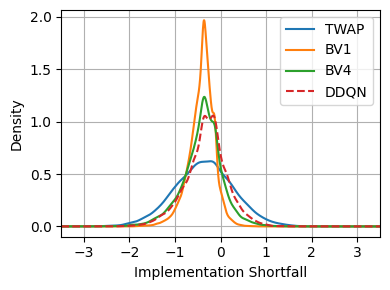

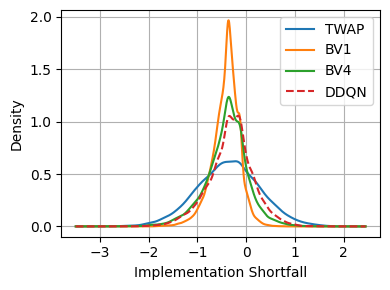

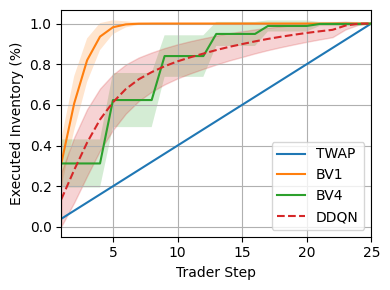

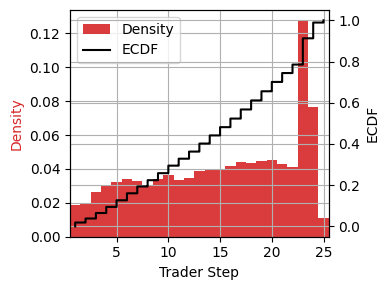

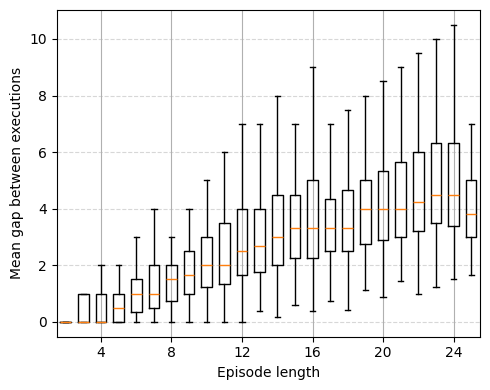

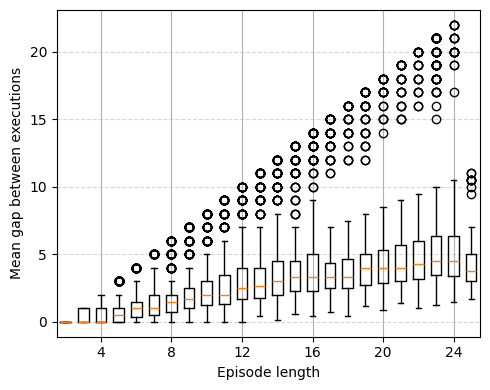

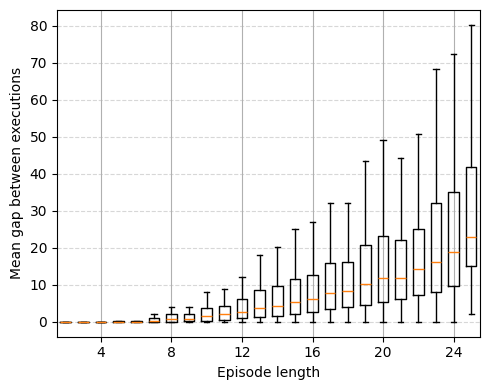

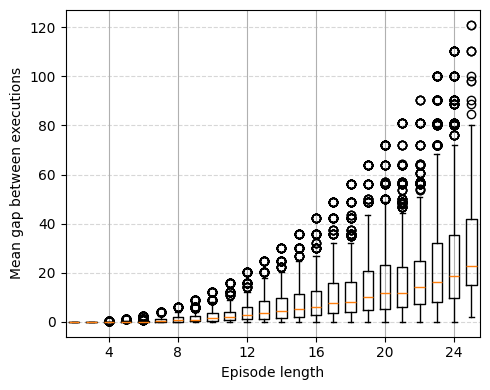

: 

In [ ]:
run_id = 'tra4ryc9'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

### Q values

unzip the saved model to load the NN weights

In [ ]:
class DummyEnv(gym.Env):
    def __init__(self):
        super().__init__()
        self.observation_space = gym.spaces.Box(
            low=-1.0, high=1.0, shape=(state_dim,), dtype=float
        )
        self.action_space = gym.spaces.Discrete(action_dim)

    def reset(self):
        return self.observation_space.sample(), {}

    def step(self, action):
        return self.observation_space.sample(), 0.0, True, False, {}

dummy_env = DummyEnv()

# --- Define same policy as training ---
policy_kwargs = dict(
    net_arch=[30, 30, 30, 30, 30],
    activation_fn=nn.LeakyReLU,
)

# --- Recreate model with dummy env ---
model = DQN(
    policy="MlpPolicy",
    env=dummy_env,
    policy_kwargs=policy_kwargs,
    device="cpu",  # or "cuda"
)

# --- Load NN weights ---
path = f"/scratch/network/te6653/qrm_optimal_execution/save_model/ddqn_{run_id}/policy.pth"
state_dict = torch.load(path, map_location=model.device)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# --- Now you can call the NN directly ---
obs = torch.zeros((1, state_dim))  # example input
q_values = model.policy.q_net(obs)
print("Q-values:", q_values)


c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/attr_value.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/tensor.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framewo

Q-values: tensor([[-0.2632, -0.2349]], grad_fn=<AddmmBackward0>)


Pick the action: `show_action`

In [ ]:

# --- assume your SB3 DQN `model` is already created and loaded ---
model.policy.set_training_mode(False)
device = model.device

# ---- Parameters ----
times_min = -0.7
times_max = 1.0
inv_min   = -1.0
inv_max   =  1.0

price   = 0.0
ask_vol = 0.0
bid_vol = 0.0

# ---- Grids ----
n_grid = 101
times = np.linspace(times_min, times_max, n_grid, dtype=np.float32)
invs  = np.linspace(inv_min,   inv_max,   n_grid, dtype=np.float32)
T_raw, I_raw = np.meshgrid(times, invs)

# Percent axes for plotting
time_pct = (T_raw - times_min) / (times_max - times_min) * 100.0
inv_pct  = (I_raw  - inv_min)   / (inv_max   - inv_min)   * 100.0

# ---- Build (N, 5) batch of states from the raw grid ----
N = n_grid * n_grid
states = np.column_stack([
    I_raw.reshape(-1),            # inventory
    T_raw.reshape(-1),            # time
    np.full(N, price,   np.float32),
    np.full(N, ask_vol, np.float32),
    np.full(N, bid_vol, np.float32),
]).astype(np.float32)
obs = torch.as_tensor(states, device=device)

# ---- Get Q-values ----
with torch.no_grad():
    pi = model.policy
    try:
        if getattr(pi, "features_extractor", None) is not None:
            feats = pi.features_extractor(obs)
            q_tensor = pi.q_net(feats)
        else:
            feats = pi.extract_features(obs)
            q_tensor = pi.q_net(feats)
    except Exception:
        q_tensor = pi.q_net(obs)

q_values  = q_tensor.detach().cpu().numpy()
n_actions = q_values.shape[1]

# ---- Standard Plotly figure ----
fig = go.Figure()
for a in range(n_actions):
    Z = q_values[:, a].reshape(n_grid, n_grid)
    fig.add_trace(
        go.Surface(
            x=time_pct, y=inv_pct, z=Z,
            name=f"Action {a}",
            showscale=(a == 0),                 # one colorbar
            colorbar=(dict(title="Q-value") if a == 0 else None)
        )
    )

# show only the action you want initially
show_action = 1
for i in range(n_actions):
    fig.data[i].visible = (i == show_action)

fig.update_layout(
    scene=dict(
        xaxis_title="Time (%)",
        yaxis_title="Remaining Inventory (%)",
        zaxis_title="Q-value",
        aspectmode="cube",
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)),  # optional starting view
)

# ---- Use FigureWidget so UI rotations sync back to Python ----
figw = go.FigureWidget(fig)
display(figw)

# ✅ Correct callback signature: (layout, value)
def _on_cam_change(layout, camera_value):
    print("Updated camera:", camera_value)

figw.layout.on_change(_on_cam_change, 'scene.camera')

# Button to print the current camera on demand
btn = widgets.Button(description="Print current camera")
out = widgets.Output()

def _print_cam(_):
    with out:
        print(figw.layout.scene.camera)

btn.on_click(_print_cam)
display(btn, out)

fig.update_layout(scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)))

# IMPORTANT: don't call fig.show() here; it opens a non-synced view.


FigureWidget({
    'data': [{'colorbar': {'title': {'text': 'Q-value'}},
              'name': 'Action 0',
              'showscale': True,
              'type': 'surface',
              'uid': 'f54b2a48-591c-4520-8101-49d930fe1012',
              'visible': False,
              'x': {'bdata': ('AAAAANn/fz/1//8/AABAQPX/f0D9/5' ... 'IAAMBC///BQv//w0L//8VCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'y': {'bdata': ('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAA' ... 'IAAMhCAADIQgAAyEIAAMhCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'z': {'bdata': ('lgsAPgze9z0cpe893MnnPcw34z2Ewt' ... 'E+mJnBMkilwbAxscG3Lr3B9A7JwQ=='),
                    'dtype': 'f4',
                    'shape': '101, 101'}},
             {'name': 'Action 1',
              'showscale': False,
              'type': 'surface',
              'uid': 'cf895fb1-54b8-42a7-89e7-5296be534bb4',
              'visible': True,
   

Button(description='Print current camera', style=ButtonStyle())

Output()

In [ ]:
plotly_eye = {'x': 3.2, 'y': 3.2, 'z': 1.3}
elev, azim = plotly_eye_to_view_init(plotly_eye)
save_action_surface_pdf(elev, azim, show_action, q_values, n_grid, time_pct, inv_pct, filename=f"/scratch/network/te6653/qrm_optimal_execution/plots/q_values/{run_id}_q_surface_action{show_action}.pdf")

## 5-dim: lfao2w0o - 2630149 21/09/2025 3h-30N-upd_freq=500

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.282, std=0.556 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.3500% of runs did not reach full inventory
    Missing volume: avg=1.91, std=1.32, max=6.00



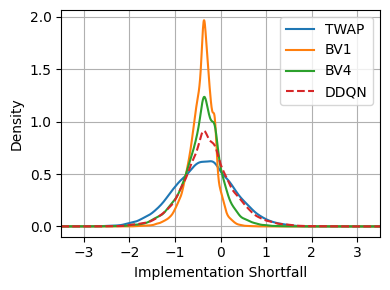

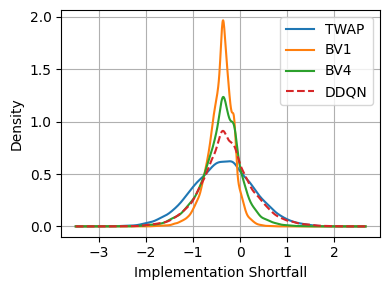

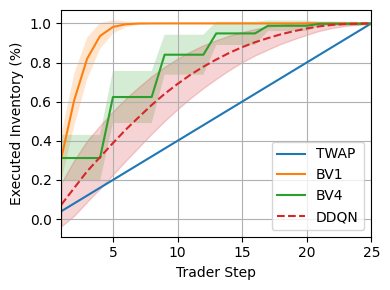

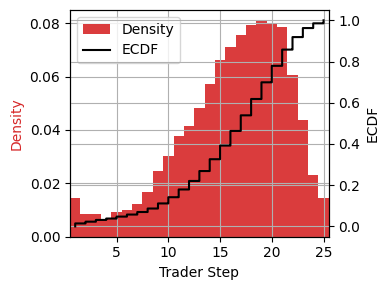

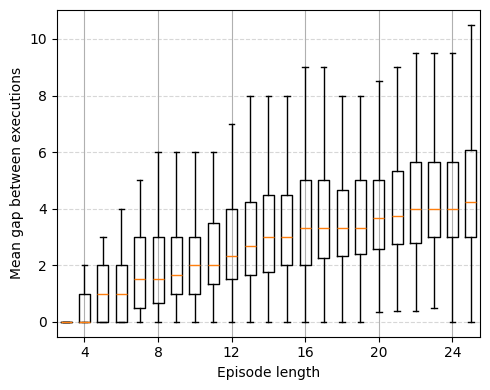

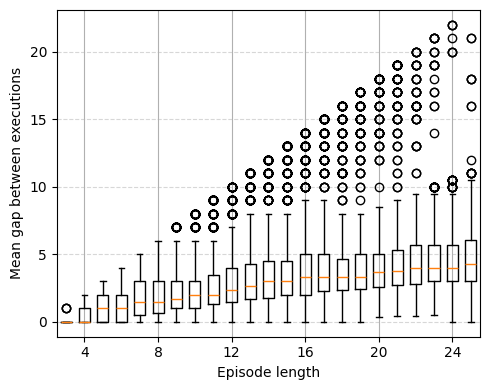

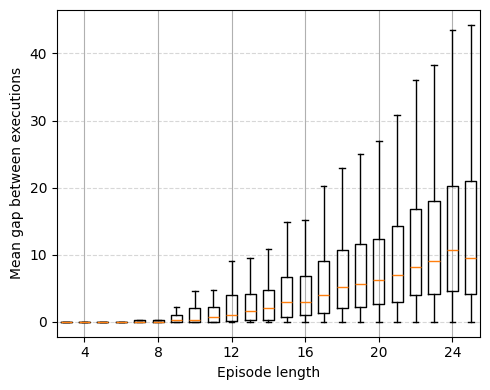

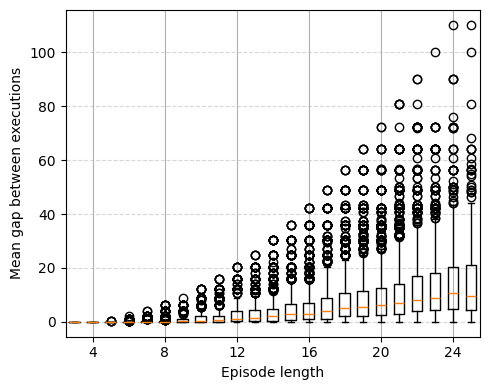

: 

In [ ]:
run_id = 'lfao2w0o'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

### Q values

unzip the saved model to load the NN weights

In [ ]:
class DummyEnv(gym.Env):
    def __init__(self):
        super().__init__()
        self.observation_space = gym.spaces.Box(
            low=-1.0, high=1.0, shape=(state_dim,), dtype=float
        )
        self.action_space = gym.spaces.Discrete(action_dim)

    def reset(self):
        return self.observation_space.sample(), {}

    def step(self, action):
        return self.observation_space.sample(), 0.0, True, False, {}

dummy_env = DummyEnv()

# --- Define same policy as training ---
policy_kwargs = dict(
    net_arch=[30, 30, 30, 30, 30],
    activation_fn=nn.LeakyReLU,
)

# --- Recreate model with dummy env ---
model = DQN(
    policy="MlpPolicy",
    env=dummy_env,
    policy_kwargs=policy_kwargs,
    device="cpu",  # or "cuda"
)

# --- Load NN weights ---
path = f"/scratch/network/te6653/qrm_optimal_execution/save_model/ddqn_{run_id}/policy.pth"
state_dict = torch.load(path, map_location=model.device)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# --- Now you can call the NN directly ---
obs = torch.zeros((1, state_dim))  # example input
q_values = model.policy.q_net(obs)
print("Q-values:", q_values)


c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/attr_value.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/tensor.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framewo

Q-values: tensor([[-0.2632, -0.2349]], grad_fn=<AddmmBackward0>)


Pick the action: `show_action`

In [ ]:

# --- assume your SB3 DQN `model` is already created and loaded ---
model.policy.set_training_mode(False)
device = model.device

# ---- Parameters ----
times_min = -0.7
times_max = 1.0
inv_min   = -1.0
inv_max   =  1.0

price   = 0.0
ask_vol = 0.0
bid_vol = 0.0

# ---- Grids ----
n_grid = 101
times = np.linspace(times_min, times_max, n_grid, dtype=np.float32)
invs  = np.linspace(inv_min,   inv_max,   n_grid, dtype=np.float32)
T_raw, I_raw = np.meshgrid(times, invs)

# Percent axes for plotting
time_pct = (T_raw - times_min) / (times_max - times_min) * 100.0
inv_pct  = (I_raw  - inv_min)   / (inv_max   - inv_min)   * 100.0

# ---- Build (N, 5) batch of states from the raw grid ----
N = n_grid * n_grid
states = np.column_stack([
    I_raw.reshape(-1),            # inventory
    T_raw.reshape(-1),            # time
    np.full(N, price,   np.float32),
    np.full(N, ask_vol, np.float32),
    np.full(N, bid_vol, np.float32),
]).astype(np.float32)
obs = torch.as_tensor(states, device=device)

# ---- Get Q-values ----
with torch.no_grad():
    pi = model.policy
    try:
        if getattr(pi, "features_extractor", None) is not None:
            feats = pi.features_extractor(obs)
            q_tensor = pi.q_net(feats)
        else:
            feats = pi.extract_features(obs)
            q_tensor = pi.q_net(feats)
    except Exception:
        q_tensor = pi.q_net(obs)

q_values  = q_tensor.detach().cpu().numpy()
n_actions = q_values.shape[1]

# ---- Standard Plotly figure ----
fig = go.Figure()
for a in range(n_actions):
    Z = q_values[:, a].reshape(n_grid, n_grid)
    fig.add_trace(
        go.Surface(
            x=time_pct, y=inv_pct, z=Z,
            name=f"Action {a}",
            showscale=(a == 0),                 # one colorbar
            colorbar=(dict(title="Q-value") if a == 0 else None)
        )
    )

# show only the action you want initially
show_action = 1
for i in range(n_actions):
    fig.data[i].visible = (i == show_action)

fig.update_layout(
    scene=dict(
        xaxis_title="Time (%)",
        yaxis_title="Remaining Inventory (%)",
        zaxis_title="Q-value",
        aspectmode="cube",
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)),  # optional starting view
)

# ---- Use FigureWidget so UI rotations sync back to Python ----
figw = go.FigureWidget(fig)
display(figw)

# ✅ Correct callback signature: (layout, value)
def _on_cam_change(layout, camera_value):
    print("Updated camera:", camera_value)

figw.layout.on_change(_on_cam_change, 'scene.camera')

# Button to print the current camera on demand
btn = widgets.Button(description="Print current camera")
out = widgets.Output()

def _print_cam(_):
    with out:
        print(figw.layout.scene.camera)

btn.on_click(_print_cam)
display(btn, out)

fig.update_layout(scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)))

# IMPORTANT: don't call fig.show() here; it opens a non-synced view.


FigureWidget({
    'data': [{'colorbar': {'title': {'text': 'Q-value'}},
              'name': 'Action 0',
              'showscale': True,
              'type': 'surface',
              'uid': 'f54b2a48-591c-4520-8101-49d930fe1012',
              'visible': False,
              'x': {'bdata': ('AAAAANn/fz/1//8/AABAQPX/f0D9/5' ... 'IAAMBC///BQv//w0L//8VCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'y': {'bdata': ('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAA' ... 'IAAMhCAADIQgAAyEIAAMhCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'z': {'bdata': ('lgsAPgze9z0cpe893MnnPcw34z2Ewt' ... 'E+mJnBMkilwbAxscG3Lr3B9A7JwQ=='),
                    'dtype': 'f4',
                    'shape': '101, 101'}},
             {'name': 'Action 1',
              'showscale': False,
              'type': 'surface',
              'uid': 'cf895fb1-54b8-42a7-89e7-5296be534bb4',
              'visible': True,
   

Button(description='Print current camera', style=ButtonStyle())

Output()

In [ ]:
plotly_eye = {'x': 3.2, 'y': 3.2, 'z': 1.3}
elev, azim = plotly_eye_to_view_init(plotly_eye)
save_action_surface_pdf(elev, azim, show_action, q_values, n_grid, time_pct, inv_pct, filename=f"/scratch/network/te6653/qrm_optimal_execution/plots/q_values/{run_id}_q_surface_action{show_action}.pdf")

## 5-dim: 9qvtu197 - 2629857 20/09/2025 8h-30N-eps=0.03-upd_freq=500

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.316, std=0.456 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.0950% of runs did not reach full inventory
    Missing volume: avg=1.58, std=0.88, max=4.00



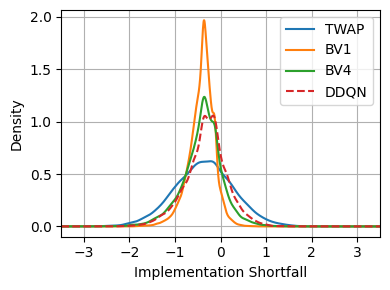

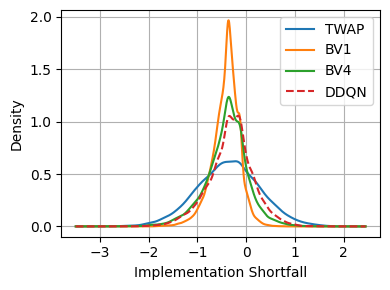

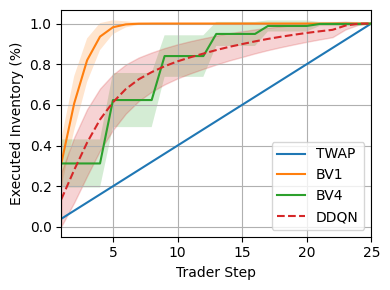

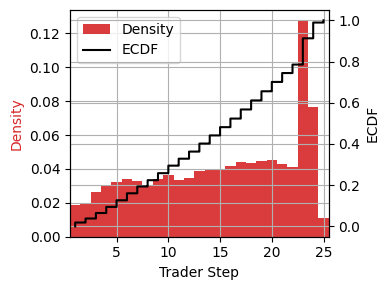

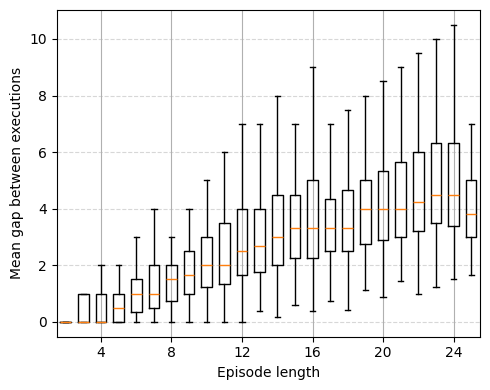

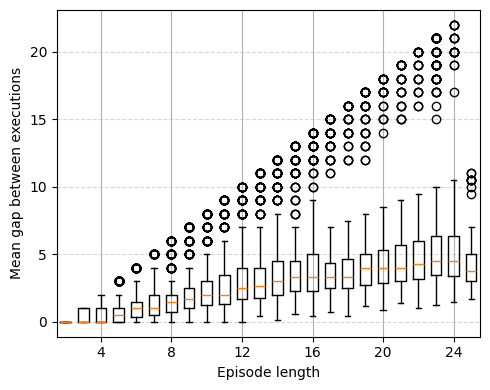

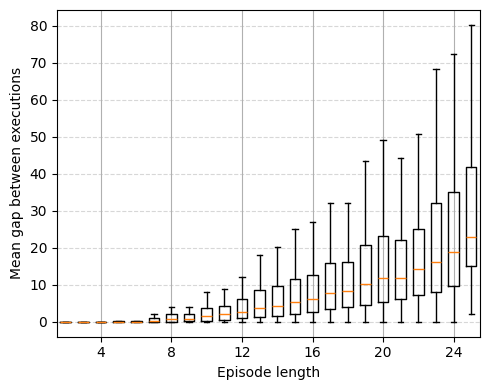

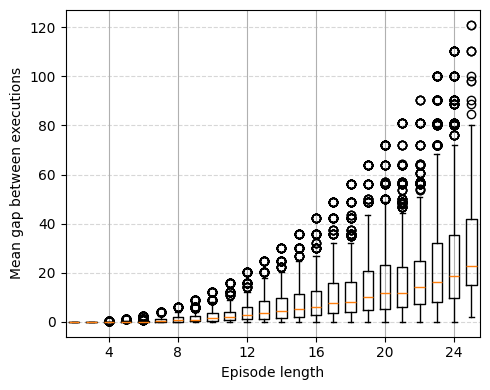

: 

In [ ]:
run_id = '9qvtu197'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

### Q values

unzip the saved model to load the NN weights

In [ ]:
class DummyEnv(gym.Env):
    def __init__(self):
        super().__init__()
        self.observation_space = gym.spaces.Box(
            low=-1.0, high=1.0, shape=(state_dim,), dtype=float
        )
        self.action_space = gym.spaces.Discrete(action_dim)

    def reset(self):
        return self.observation_space.sample(), {}

    def step(self, action):
        return self.observation_space.sample(), 0.0, True, False, {}

dummy_env = DummyEnv()

# --- Define same policy as training ---
policy_kwargs = dict(
    net_arch=[30, 30, 30, 30, 30],
    activation_fn=nn.LeakyReLU,
)

# --- Recreate model with dummy env ---
model = DQN(
    policy="MlpPolicy",
    env=dummy_env,
    policy_kwargs=policy_kwargs,
    device="cpu",  # or "cuda"
)

# --- Load NN weights ---
path = f"/scratch/network/te6653/qrm_optimal_execution/save_model/ddqn_{run_id}/policy.pth"
state_dict = torch.load(path, map_location=model.device)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# --- Now you can call the NN directly ---
obs = torch.zeros((1, state_dim))  # example input
q_values = model.policy.q_net(obs)
print("Q-values:", q_values)


c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/attr_value.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/tensor.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framewo

Q-values: tensor([[-0.2632, -0.2349]], grad_fn=<AddmmBackward0>)


Pick the action: `show_action`

In [ ]:

# --- assume your SB3 DQN `model` is already created and loaded ---
model.policy.set_training_mode(False)
device = model.device

# ---- Parameters ----
times_min = -0.7
times_max = 1.0
inv_min   = -1.0
inv_max   =  1.0

price   = 0.0
ask_vol = 0.0
bid_vol = 0.0

# ---- Grids ----
n_grid = 101
times = np.linspace(times_min, times_max, n_grid, dtype=np.float32)
invs  = np.linspace(inv_min,   inv_max,   n_grid, dtype=np.float32)
T_raw, I_raw = np.meshgrid(times, invs)

# Percent axes for plotting
time_pct = (T_raw - times_min) / (times_max - times_min) * 100.0
inv_pct  = (I_raw  - inv_min)   / (inv_max   - inv_min)   * 100.0

# ---- Build (N, 5) batch of states from the raw grid ----
N = n_grid * n_grid
states = np.column_stack([
    I_raw.reshape(-1),            # inventory
    T_raw.reshape(-1),            # time
    np.full(N, price,   np.float32),
    np.full(N, ask_vol, np.float32),
    np.full(N, bid_vol, np.float32),
]).astype(np.float32)
obs = torch.as_tensor(states, device=device)

# ---- Get Q-values ----
with torch.no_grad():
    pi = model.policy
    try:
        if getattr(pi, "features_extractor", None) is not None:
            feats = pi.features_extractor(obs)
            q_tensor = pi.q_net(feats)
        else:
            feats = pi.extract_features(obs)
            q_tensor = pi.q_net(feats)
    except Exception:
        q_tensor = pi.q_net(obs)

q_values  = q_tensor.detach().cpu().numpy()
n_actions = q_values.shape[1]

# ---- Standard Plotly figure ----
fig = go.Figure()
for a in range(n_actions):
    Z = q_values[:, a].reshape(n_grid, n_grid)
    fig.add_trace(
        go.Surface(
            x=time_pct, y=inv_pct, z=Z,
            name=f"Action {a}",
            showscale=(a == 0),                 # one colorbar
            colorbar=(dict(title="Q-value") if a == 0 else None)
        )
    )

# show only the action you want initially
show_action = 1
for i in range(n_actions):
    fig.data[i].visible = (i == show_action)

fig.update_layout(
    scene=dict(
        xaxis_title="Time (%)",
        yaxis_title="Remaining Inventory (%)",
        zaxis_title="Q-value",
        aspectmode="cube",
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)),  # optional starting view
)

# ---- Use FigureWidget so UI rotations sync back to Python ----
figw = go.FigureWidget(fig)
display(figw)

# ✅ Correct callback signature: (layout, value)
def _on_cam_change(layout, camera_value):
    print("Updated camera:", camera_value)

figw.layout.on_change(_on_cam_change, 'scene.camera')

# Button to print the current camera on demand
btn = widgets.Button(description="Print current camera")
out = widgets.Output()

def _print_cam(_):
    with out:
        print(figw.layout.scene.camera)

btn.on_click(_print_cam)
display(btn, out)

fig.update_layout(scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)))

# IMPORTANT: don't call fig.show() here; it opens a non-synced view.


FigureWidget({
    'data': [{'colorbar': {'title': {'text': 'Q-value'}},
              'name': 'Action 0',
              'showscale': True,
              'type': 'surface',
              'uid': 'f54b2a48-591c-4520-8101-49d930fe1012',
              'visible': False,
              'x': {'bdata': ('AAAAANn/fz/1//8/AABAQPX/f0D9/5' ... 'IAAMBC///BQv//w0L//8VCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'y': {'bdata': ('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAA' ... 'IAAMhCAADIQgAAyEIAAMhCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'z': {'bdata': ('lgsAPgze9z0cpe893MnnPcw34z2Ewt' ... 'E+mJnBMkilwbAxscG3Lr3B9A7JwQ=='),
                    'dtype': 'f4',
                    'shape': '101, 101'}},
             {'name': 'Action 1',
              'showscale': False,
              'type': 'surface',
              'uid': 'cf895fb1-54b8-42a7-89e7-5296be534bb4',
              'visible': True,
   

Button(description='Print current camera', style=ButtonStyle())

Output()

In [ ]:
plotly_eye = {'x': 3.2, 'y': 3.2, 'z': 1.3}
elev, azim = plotly_eye_to_view_init(plotly_eye)
save_action_surface_pdf(elev, azim, show_action, q_values, n_grid, time_pct, inv_pct, filename=f"/scratch/network/te6653/qrm_optimal_execution/plots/q_values/{run_id}_q_surface_action{show_action}.pdf")

## 5-dim: fxgq0wtq - 2629853 20/09/2025 8h-30N - eps=0.03%

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 



[DDQN] IS: mean=-0.310, std=0.441 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.0700% of runs did not reach full inventory
    Missing volume: avg=2.07, std=1.58, max=6.00



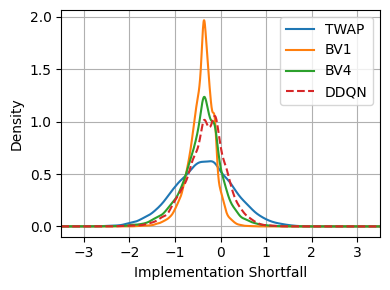

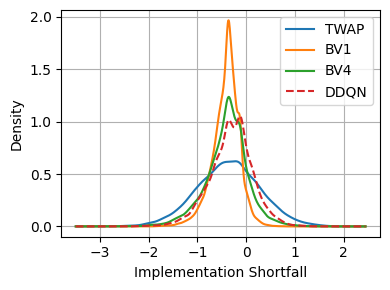

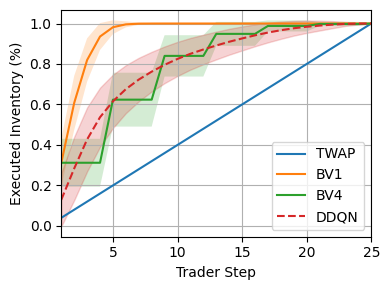

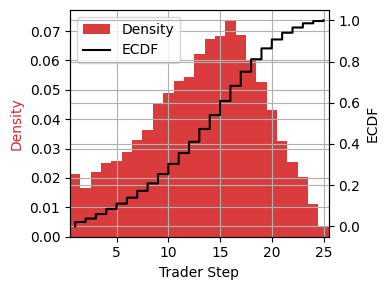

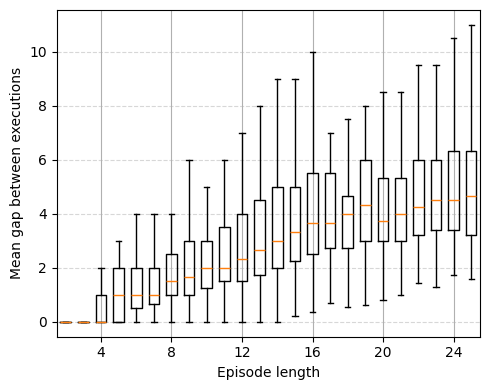

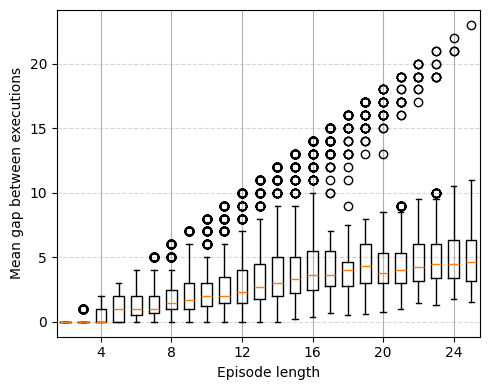

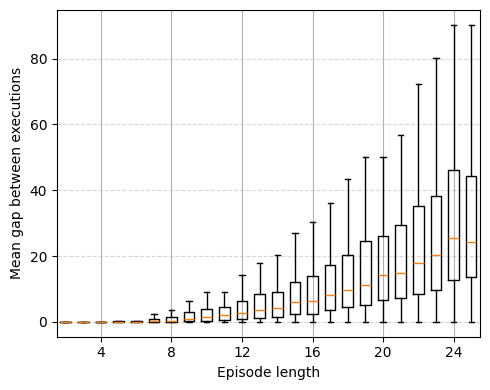

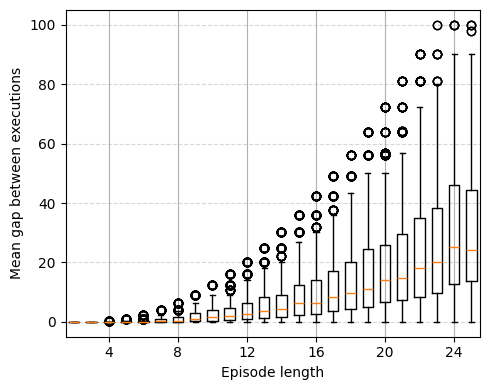

In [8]:
run_id = 'fxgq0wtq'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

### Q values

unzip the saved model to load the NN weights

In [ ]:
class DummyEnv(gym.Env):
    def __init__(self):
        super().__init__()
        self.observation_space = gym.spaces.Box(
            low=-1.0, high=1.0, shape=(state_dim,), dtype=float
        )
        self.action_space = gym.spaces.Discrete(action_dim)

    def reset(self):
        return self.observation_space.sample(), {}

    def step(self, action):
        return self.observation_space.sample(), 0.0, True, False, {}

dummy_env = DummyEnv()

# --- Define same policy as training ---
policy_kwargs = dict(
    net_arch=[30, 30, 30, 30, 30],
    activation_fn=nn.LeakyReLU,
)

# --- Recreate model with dummy env ---
model = DQN(
    policy="MlpPolicy",
    env=dummy_env,
    policy_kwargs=policy_kwargs,
    device="cpu",  # or "cuda"
)

# --- Load NN weights ---
path = f"/scratch/network/te6653/qrm_optimal_execution/save_model/ddqn_{run_id}/policy.pth"
state_dict = torch.load(path, map_location=model.device)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# --- Now you can call the NN directly ---
obs = torch.zeros((1, state_dim))  # example input
q_values = model.policy.q_net(obs)
print("Q-values:", q_values)


c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/attr_value.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/tensor.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framewo

Q-values: tensor([[-0.2632, -0.2349]], grad_fn=<AddmmBackward0>)


Pick the action: `show_action`

In [ ]:

# --- assume your SB3 DQN `model` is already created and loaded ---
model.policy.set_training_mode(False)
device = model.device

# ---- Parameters ----
times_min = -0.7
times_max = 1.0
inv_min   = -1.0
inv_max   =  1.0

price   = 0.0
ask_vol = 0.0
bid_vol = 0.0

# ---- Grids ----
n_grid = 101
times = np.linspace(times_min, times_max, n_grid, dtype=np.float32)
invs  = np.linspace(inv_min,   inv_max,   n_grid, dtype=np.float32)
T_raw, I_raw = np.meshgrid(times, invs)

# Percent axes for plotting
time_pct = (T_raw - times_min) / (times_max - times_min) * 100.0
inv_pct  = (I_raw  - inv_min)   / (inv_max   - inv_min)   * 100.0

# ---- Build (N, 5) batch of states from the raw grid ----
N = n_grid * n_grid
states = np.column_stack([
    I_raw.reshape(-1),            # inventory
    T_raw.reshape(-1),            # time
    np.full(N, price,   np.float32),
    np.full(N, ask_vol, np.float32),
    np.full(N, bid_vol, np.float32),
]).astype(np.float32)
obs = torch.as_tensor(states, device=device)

# ---- Get Q-values ----
with torch.no_grad():
    pi = model.policy
    try:
        if getattr(pi, "features_extractor", None) is not None:
            feats = pi.features_extractor(obs)
            q_tensor = pi.q_net(feats)
        else:
            feats = pi.extract_features(obs)
            q_tensor = pi.q_net(feats)
    except Exception:
        q_tensor = pi.q_net(obs)

q_values  = q_tensor.detach().cpu().numpy()
n_actions = q_values.shape[1]

# ---- Standard Plotly figure ----
fig = go.Figure()
for a in range(n_actions):
    Z = q_values[:, a].reshape(n_grid, n_grid)
    fig.add_trace(
        go.Surface(
            x=time_pct, y=inv_pct, z=Z,
            name=f"Action {a}",
            showscale=(a == 0),                 # one colorbar
            colorbar=(dict(title="Q-value") if a == 0 else None)
        )
    )

# show only the action you want initially
show_action = 1
for i in range(n_actions):
    fig.data[i].visible = (i == show_action)

fig.update_layout(
    scene=dict(
        xaxis_title="Time (%)",
        yaxis_title="Remaining Inventory (%)",
        zaxis_title="Q-value",
        aspectmode="cube",
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)),  # optional starting view
)

# ---- Use FigureWidget so UI rotations sync back to Python ----
figw = go.FigureWidget(fig)
display(figw)

# ✅ Correct callback signature: (layout, value)
def _on_cam_change(layout, camera_value):
    print("Updated camera:", camera_value)

figw.layout.on_change(_on_cam_change, 'scene.camera')

# Button to print the current camera on demand
btn = widgets.Button(description="Print current camera")
out = widgets.Output()

def _print_cam(_):
    with out:
        print(figw.layout.scene.camera)

btn.on_click(_print_cam)
display(btn, out)

fig.update_layout(scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)))

# IMPORTANT: don't call fig.show() here; it opens a non-synced view.


FigureWidget({
    'data': [{'colorbar': {'title': {'text': 'Q-value'}},
              'name': 'Action 0',
              'showscale': True,
              'type': 'surface',
              'uid': 'f54b2a48-591c-4520-8101-49d930fe1012',
              'visible': False,
              'x': {'bdata': ('AAAAANn/fz/1//8/AABAQPX/f0D9/5' ... 'IAAMBC///BQv//w0L//8VCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'y': {'bdata': ('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAA' ... 'IAAMhCAADIQgAAyEIAAMhCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'z': {'bdata': ('lgsAPgze9z0cpe893MnnPcw34z2Ewt' ... 'E+mJnBMkilwbAxscG3Lr3B9A7JwQ=='),
                    'dtype': 'f4',
                    'shape': '101, 101'}},
             {'name': 'Action 1',
              'showscale': False,
              'type': 'surface',
              'uid': 'cf895fb1-54b8-42a7-89e7-5296be534bb4',
              'visible': True,
   

Button(description='Print current camera', style=ButtonStyle())

Output()

In [ ]:
plotly_eye = {'x': 3.2, 'y': 3.2, 'z': 1.3}
elev, azim = plotly_eye_to_view_init(plotly_eye)
save_action_surface_pdf(elev, azim, show_action, q_values, n_grid, time_pct, inv_pct, filename=f"/scratch/network/te6653/qrm_optimal_execution/plots/q_values/{run_id}_q_surface_action{show_action}.pdf")

## 5-dim: uzejcwb9 - 26295902 19/09/2025 8h-30N

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.307, std=0.475 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.0300% of runs did not reach full inventory
    Missing volume: avg=1.50, std=1.12, max=4.00



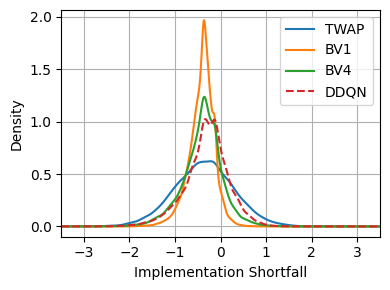

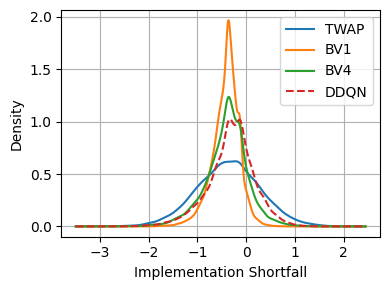

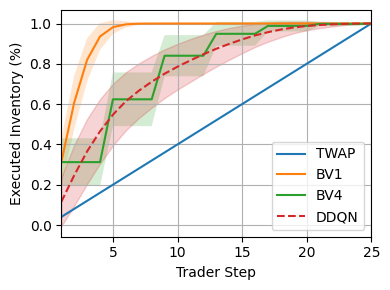

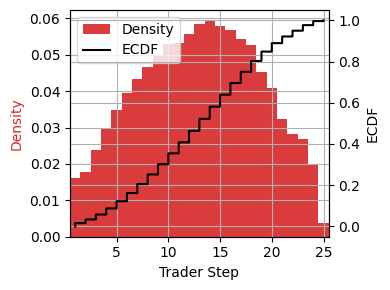

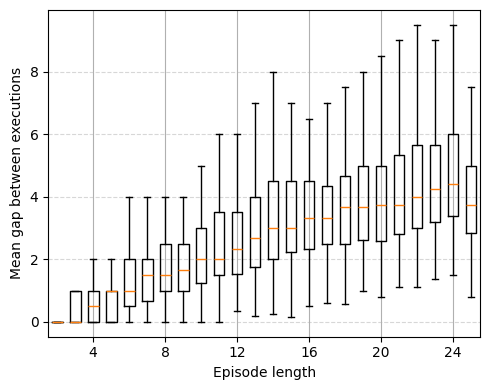

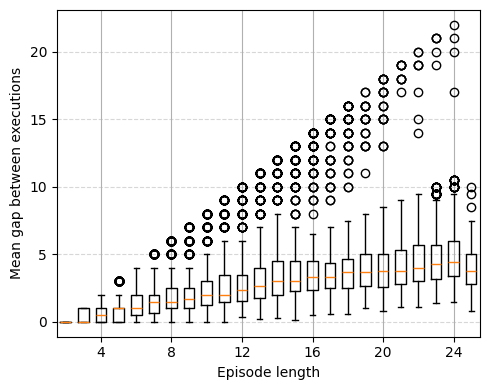

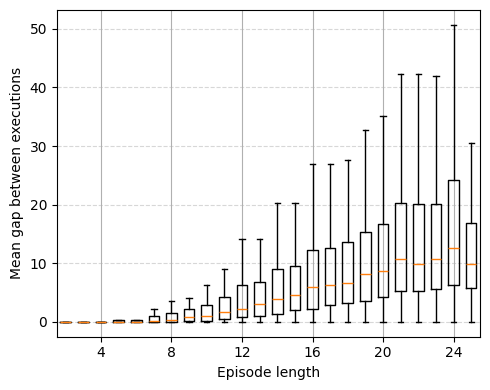

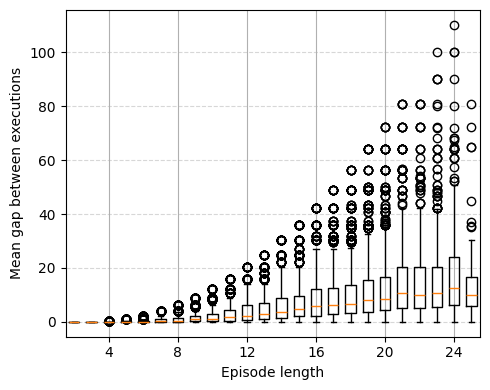

In [9]:
run_id = 'uzejcwb9'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

### Q values

unzip the saved model to load the NN weights

In [ ]:
class DummyEnv(gym.Env):
    def __init__(self):
        super().__init__()
        self.observation_space = gym.spaces.Box(
            low=-1.0, high=1.0, shape=(state_dim,), dtype=float
        )
        self.action_space = gym.spaces.Discrete(action_dim)

    def reset(self):
        return self.observation_space.sample(), {}

    def step(self, action):
        return self.observation_space.sample(), 0.0, True, False, {}

dummy_env = DummyEnv()

# --- Define same policy as training ---
policy_kwargs = dict(
    net_arch=[30, 30, 30, 30, 30],
    activation_fn=nn.LeakyReLU,
)

# --- Recreate model with dummy env ---
model = DQN(
    policy="MlpPolicy",
    env=dummy_env,
    policy_kwargs=policy_kwargs,
    device="cpu",  # or "cuda"
)

# --- Load NN weights ---
path = f"/scratch/network/te6653/qrm_optimal_execution/save_model/ddqn_{run_id}/policy.pth"
state_dict = torch.load(path, map_location=model.device)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# --- Now you can call the NN directly ---
obs = torch.zeros((1, state_dim))  # example input
q_values = model.policy.q_net(obs)
print("Q-values:", q_values)


c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/attr_value.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/tensor.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framewo

Q-values: tensor([[-0.2632, -0.2349]], grad_fn=<AddmmBackward0>)


Pick the action: `show_action`

In [ ]:

# --- assume your SB3 DQN `model` is already created and loaded ---
model.policy.set_training_mode(False)
device = model.device

# ---- Parameters ----
times_min = -0.7
times_max = 1.0
inv_min   = -1.0
inv_max   =  1.0

price   = 0.0
ask_vol = 0.0
bid_vol = 0.0

# ---- Grids ----
n_grid = 101
times = np.linspace(times_min, times_max, n_grid, dtype=np.float32)
invs  = np.linspace(inv_min,   inv_max,   n_grid, dtype=np.float32)
T_raw, I_raw = np.meshgrid(times, invs)

# Percent axes for plotting
time_pct = (T_raw - times_min) / (times_max - times_min) * 100.0
inv_pct  = (I_raw  - inv_min)   / (inv_max   - inv_min)   * 100.0

# ---- Build (N, 5) batch of states from the raw grid ----
N = n_grid * n_grid
states = np.column_stack([
    I_raw.reshape(-1),            # inventory
    T_raw.reshape(-1),            # time
    np.full(N, price,   np.float32),
    np.full(N, ask_vol, np.float32),
    np.full(N, bid_vol, np.float32),
]).astype(np.float32)
obs = torch.as_tensor(states, device=device)

# ---- Get Q-values ----
with torch.no_grad():
    pi = model.policy
    try:
        if getattr(pi, "features_extractor", None) is not None:
            feats = pi.features_extractor(obs)
            q_tensor = pi.q_net(feats)
        else:
            feats = pi.extract_features(obs)
            q_tensor = pi.q_net(feats)
    except Exception:
        q_tensor = pi.q_net(obs)

q_values  = q_tensor.detach().cpu().numpy()
n_actions = q_values.shape[1]

# ---- Standard Plotly figure ----
fig = go.Figure()
for a in range(n_actions):
    Z = q_values[:, a].reshape(n_grid, n_grid)
    fig.add_trace(
        go.Surface(
            x=time_pct, y=inv_pct, z=Z,
            name=f"Action {a}",
            showscale=(a == 0),                 # one colorbar
            colorbar=(dict(title="Q-value") if a == 0 else None)
        )
    )

# show only the action you want initially
show_action = 1
for i in range(n_actions):
    fig.data[i].visible = (i == show_action)

fig.update_layout(
    scene=dict(
        xaxis_title="Time (%)",
        yaxis_title="Remaining Inventory (%)",
        zaxis_title="Q-value",
        aspectmode="cube",
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)),  # optional starting view
)

# ---- Use FigureWidget so UI rotations sync back to Python ----
figw = go.FigureWidget(fig)
display(figw)

# ✅ Correct callback signature: (layout, value)
def _on_cam_change(layout, camera_value):
    print("Updated camera:", camera_value)

figw.layout.on_change(_on_cam_change, 'scene.camera')

# Button to print the current camera on demand
btn = widgets.Button(description="Print current camera")
out = widgets.Output()

def _print_cam(_):
    with out:
        print(figw.layout.scene.camera)

btn.on_click(_print_cam)
display(btn, out)

fig.update_layout(scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)))

# IMPORTANT: don't call fig.show() here; it opens a non-synced view.


FigureWidget({
    'data': [{'colorbar': {'title': {'text': 'Q-value'}},
              'name': 'Action 0',
              'showscale': True,
              'type': 'surface',
              'uid': 'f54b2a48-591c-4520-8101-49d930fe1012',
              'visible': False,
              'x': {'bdata': ('AAAAANn/fz/1//8/AABAQPX/f0D9/5' ... 'IAAMBC///BQv//w0L//8VCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'y': {'bdata': ('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAA' ... 'IAAMhCAADIQgAAyEIAAMhCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'z': {'bdata': ('lgsAPgze9z0cpe893MnnPcw34z2Ewt' ... 'E+mJnBMkilwbAxscG3Lr3B9A7JwQ=='),
                    'dtype': 'f4',
                    'shape': '101, 101'}},
             {'name': 'Action 1',
              'showscale': False,
              'type': 'surface',
              'uid': 'cf895fb1-54b8-42a7-89e7-5296be534bb4',
              'visible': True,
   

Button(description='Print current camera', style=ButtonStyle())

Output()

In [ ]:
plotly_eye = {'x': 3.2, 'y': 3.2, 'z': 1.3}
elev, azim = plotly_eye_to_view_init(plotly_eye)
save_action_surface_pdf(elev, azim, show_action, q_values, n_grid, time_pct, inv_pct, filename=f"/scratch/network/te6653/qrm_optimal_execution/plots/q_values/{run_id}_q_surface_action{show_action}.pdf")

## 5-dim: dziujy12 - 2629399 19/09/2025 8h-50N

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 



[DDQN] IS: mean=-0.339, std=0.389 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.0050% of runs did not reach full inventory
    Missing volume: avg=3.00, std=0.00, max=3.00



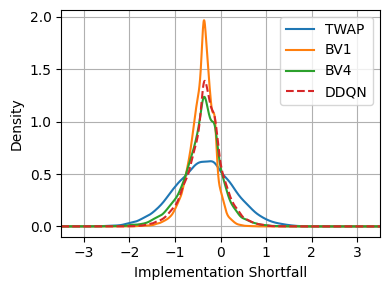

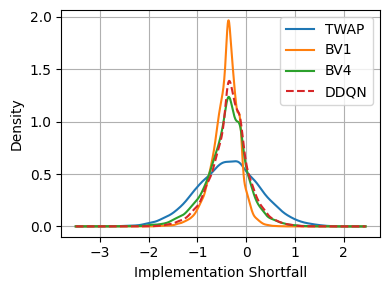

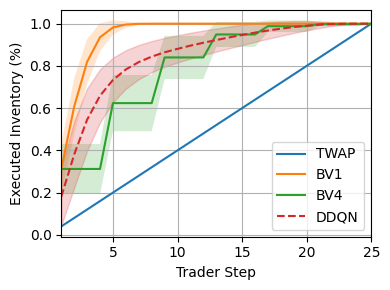

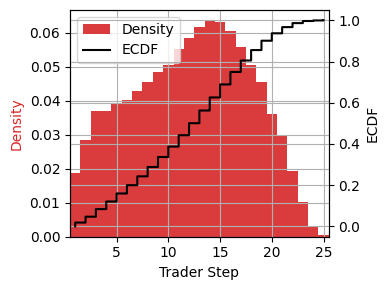

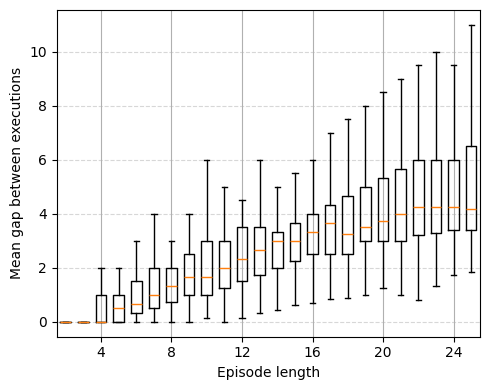

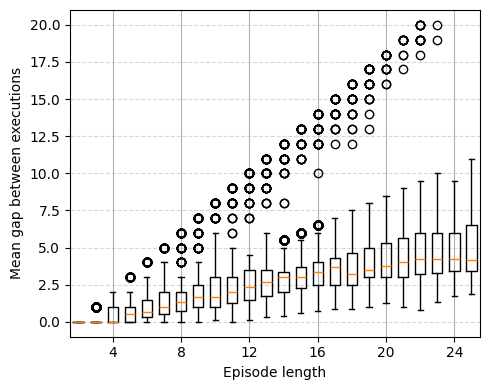

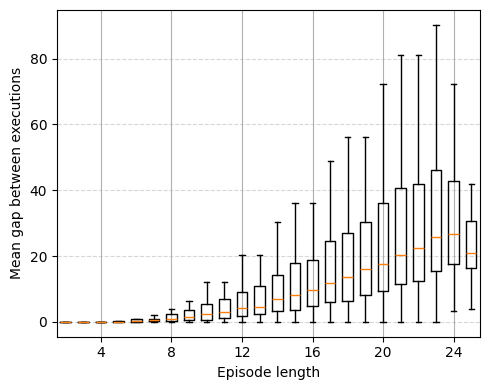

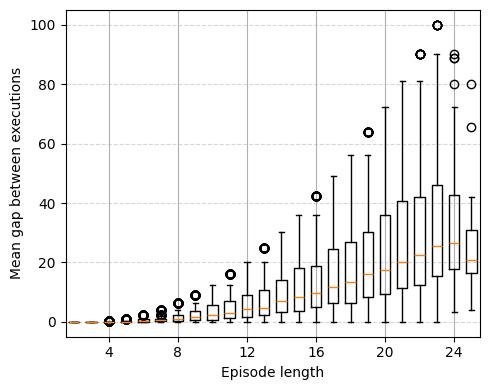

: 

In [ ]:
run_id = 'dziujy12'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

### Q values

unzip the saved model to load the NN weights

In [ ]:
class DummyEnv(gym.Env):
    def __init__(self):
        super().__init__()
        self.observation_space = gym.spaces.Box(
            low=-1.0, high=1.0, shape=(state_dim,), dtype=float
        )
        self.action_space = gym.spaces.Discrete(action_dim)

    def reset(self):
        return self.observation_space.sample(), {}

    def step(self, action):
        return self.observation_space.sample(), 0.0, True, False, {}

dummy_env = DummyEnv()

# --- Define same policy as training ---
policy_kwargs = dict(
    net_arch=[30, 30, 30, 30, 30],
    activation_fn=nn.LeakyReLU,
)

# --- Recreate model with dummy env ---
model = DQN(
    policy="MlpPolicy",
    env=dummy_env,
    policy_kwargs=policy_kwargs,
    device="cpu",  # or "cuda"
)

# --- Load NN weights ---
path = f"/scratch/network/te6653/qrm_optimal_execution/save_model/ddqn_{run_id}/policy.pth"
state_dict = torch.load(path, map_location=model.device)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# --- Now you can call the NN directly ---
obs = torch.zeros((1, state_dim))  # example input
q_values = model.policy.q_net(obs)
print("Q-values:", q_values)


c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/attr_value.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/tensor.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framewo

Q-values: tensor([[-0.2632, -0.2349]], grad_fn=<AddmmBackward0>)


Pick the action: `show_action`

In [ ]:

# --- assume your SB3 DQN `model` is already created and loaded ---
model.policy.set_training_mode(False)
device = model.device

# ---- Parameters ----
times_min = -0.7
times_max = 1.0
inv_min   = -1.0
inv_max   =  1.0

price   = 0.0
ask_vol = 0.0
bid_vol = 0.0

# ---- Grids ----
n_grid = 101
times = np.linspace(times_min, times_max, n_grid, dtype=np.float32)
invs  = np.linspace(inv_min,   inv_max,   n_grid, dtype=np.float32)
T_raw, I_raw = np.meshgrid(times, invs)

# Percent axes for plotting
time_pct = (T_raw - times_min) / (times_max - times_min) * 100.0
inv_pct  = (I_raw  - inv_min)   / (inv_max   - inv_min)   * 100.0

# ---- Build (N, 5) batch of states from the raw grid ----
N = n_grid * n_grid
states = np.column_stack([
    I_raw.reshape(-1),            # inventory
    T_raw.reshape(-1),            # time
    np.full(N, price,   np.float32),
    np.full(N, ask_vol, np.float32),
    np.full(N, bid_vol, np.float32),
]).astype(np.float32)
obs = torch.as_tensor(states, device=device)

# ---- Get Q-values ----
with torch.no_grad():
    pi = model.policy
    try:
        if getattr(pi, "features_extractor", None) is not None:
            feats = pi.features_extractor(obs)
            q_tensor = pi.q_net(feats)
        else:
            feats = pi.extract_features(obs)
            q_tensor = pi.q_net(feats)
    except Exception:
        q_tensor = pi.q_net(obs)

q_values  = q_tensor.detach().cpu().numpy()
n_actions = q_values.shape[1]

# ---- Standard Plotly figure ----
fig = go.Figure()
for a in range(n_actions):
    Z = q_values[:, a].reshape(n_grid, n_grid)
    fig.add_trace(
        go.Surface(
            x=time_pct, y=inv_pct, z=Z,
            name=f"Action {a}",
            showscale=(a == 0),                 # one colorbar
            colorbar=(dict(title="Q-value") if a == 0 else None)
        )
    )

# show only the action you want initially
show_action = 1
for i in range(n_actions):
    fig.data[i].visible = (i == show_action)

fig.update_layout(
    scene=dict(
        xaxis_title="Time (%)",
        yaxis_title="Remaining Inventory (%)",
        zaxis_title="Q-value",
        aspectmode="cube",
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)),  # optional starting view
)

# ---- Use FigureWidget so UI rotations sync back to Python ----
figw = go.FigureWidget(fig)
display(figw)

# ✅ Correct callback signature: (layout, value)
def _on_cam_change(layout, camera_value):
    print("Updated camera:", camera_value)

figw.layout.on_change(_on_cam_change, 'scene.camera')

# Button to print the current camera on demand
btn = widgets.Button(description="Print current camera")
out = widgets.Output()

def _print_cam(_):
    with out:
        print(figw.layout.scene.camera)

btn.on_click(_print_cam)
display(btn, out)

fig.update_layout(scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)))

# IMPORTANT: don't call fig.show() here; it opens a non-synced view.


FigureWidget({
    'data': [{'colorbar': {'title': {'text': 'Q-value'}},
              'name': 'Action 0',
              'showscale': True,
              'type': 'surface',
              'uid': 'f54b2a48-591c-4520-8101-49d930fe1012',
              'visible': False,
              'x': {'bdata': ('AAAAANn/fz/1//8/AABAQPX/f0D9/5' ... 'IAAMBC///BQv//w0L//8VCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'y': {'bdata': ('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAA' ... 'IAAMhCAADIQgAAyEIAAMhCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'z': {'bdata': ('lgsAPgze9z0cpe893MnnPcw34z2Ewt' ... 'E+mJnBMkilwbAxscG3Lr3B9A7JwQ=='),
                    'dtype': 'f4',
                    'shape': '101, 101'}},
             {'name': 'Action 1',
              'showscale': False,
              'type': 'surface',
              'uid': 'cf895fb1-54b8-42a7-89e7-5296be534bb4',
              'visible': True,
   

Button(description='Print current camera', style=ButtonStyle())

Output()

In [ ]:
plotly_eye = {'x': 3.2, 'y': 3.2, 'z': 1.3}
elev, azim = plotly_eye_to_view_init(plotly_eye)
save_action_surface_pdf(elev, azim, show_action, q_values, n_grid, time_pct, inv_pct, filename=f"/scratch/network/te6653/qrm_optimal_execution/plots/q_values/{run_id}_q_surface_action{show_action}.pdf")

## 5-dim: wk64rt4k - 2628309 09/17/2025 3h-30N

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.283, std=0.547 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.0900% of runs did not reach full inventory
    Missing volume: avg=1.67, std=0.88, max=4.00



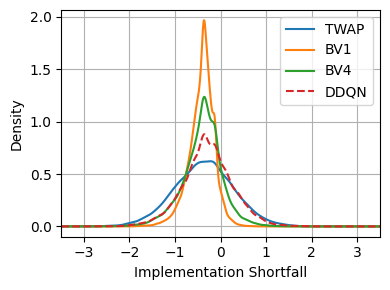

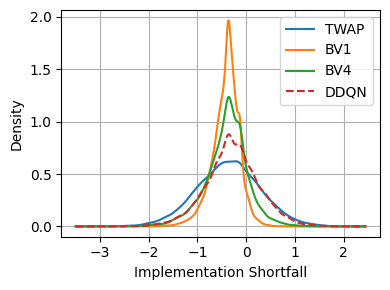

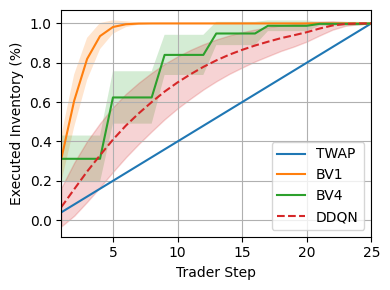

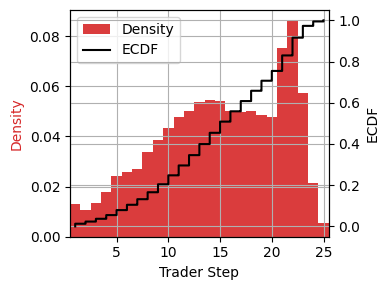

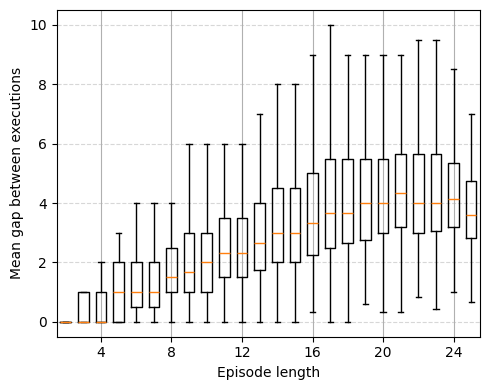

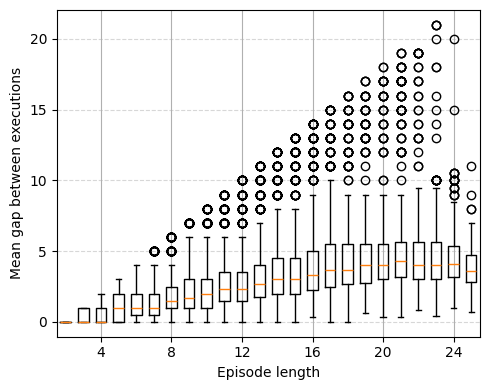

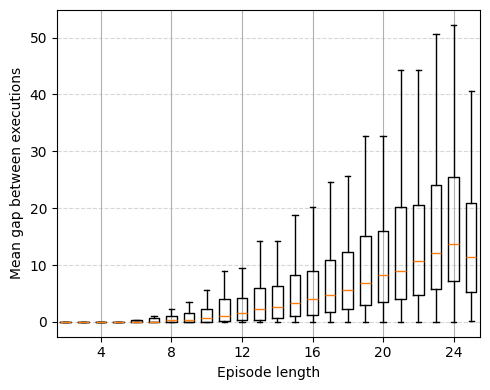

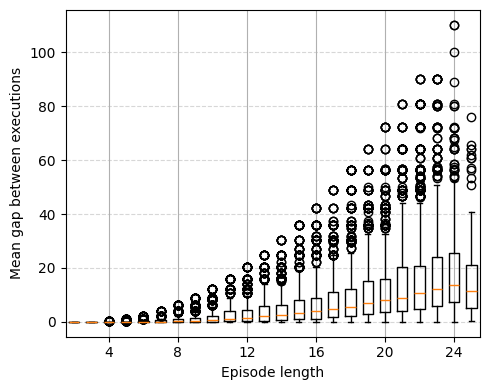

: 

In [ ]:
run_id = 'wk64rt4k'
state_dim = 5
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_2', 'best_volume_3', 'best_volume_4', 'ddqn']
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

### Q values

unzip the saved model to load the NN weights

In [ ]:
class DummyEnv(gym.Env):
    def __init__(self):
        super().__init__()
        self.observation_space = gym.spaces.Box(
            low=-1.0, high=1.0, shape=(state_dim,), dtype=float
        )
        self.action_space = gym.spaces.Discrete(action_dim)

    def reset(self):
        return self.observation_space.sample(), {}

    def step(self, action):
        return self.observation_space.sample(), 0.0, True, False, {}

dummy_env = DummyEnv()

# --- Define same policy as training ---
policy_kwargs = dict(
    net_arch=[30, 30, 30, 30, 30],
    activation_fn=nn.LeakyReLU,
)

# --- Recreate model with dummy env ---
model = DQN(
    policy="MlpPolicy",
    env=dummy_env,
    policy_kwargs=policy_kwargs,
    device="cpu",  # or "cuda"
)

# --- Load NN weights ---
path = f"/scratch/network/te6653/qrm_optimal_execution/save_model/ddqn_{run_id}/policy.pth"
state_dict = torch.load(path, map_location=model.device)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# --- Now you can call the NN directly ---
obs = torch.zeros((1, state_dim))  # example input
q_values = model.policy.q_net(obs)
print("Q-values:", q_values)


c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/attr_value.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/tensor.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framewo

Q-values: tensor([[-0.2632, -0.2349]], grad_fn=<AddmmBackward0>)


Pick the action: `show_action`

In [ ]:

# --- assume your SB3 DQN `model` is already created and loaded ---
model.policy.set_training_mode(False)
device = model.device

# ---- Parameters ----
times_min = -0.7
times_max = 1.0
inv_min   = -1.0
inv_max   =  1.0

price   = 0.0
ask_vol = 0.0
bid_vol = 0.0

# ---- Grids ----
n_grid = 101
times = np.linspace(times_min, times_max, n_grid, dtype=np.float32)
invs  = np.linspace(inv_min,   inv_max,   n_grid, dtype=np.float32)
T_raw, I_raw = np.meshgrid(times, invs)

# Percent axes for plotting
time_pct = (T_raw - times_min) / (times_max - times_min) * 100.0
inv_pct  = (I_raw  - inv_min)   / (inv_max   - inv_min)   * 100.0

# ---- Build (N, 5) batch of states from the raw grid ----
N = n_grid * n_grid
states = np.column_stack([
    I_raw.reshape(-1),            # inventory
    T_raw.reshape(-1),            # time
    np.full(N, price,   np.float32),
    np.full(N, ask_vol, np.float32),
    np.full(N, bid_vol, np.float32),
]).astype(np.float32)
obs = torch.as_tensor(states, device=device)

# ---- Get Q-values ----
with torch.no_grad():
    pi = model.policy
    try:
        if getattr(pi, "features_extractor", None) is not None:
            feats = pi.features_extractor(obs)
            q_tensor = pi.q_net(feats)
        else:
            feats = pi.extract_features(obs)
            q_tensor = pi.q_net(feats)
    except Exception:
        q_tensor = pi.q_net(obs)

q_values  = q_tensor.detach().cpu().numpy()
n_actions = q_values.shape[1]

# ---- Standard Plotly figure ----
fig = go.Figure()
for a in range(n_actions):
    Z = q_values[:, a].reshape(n_grid, n_grid)
    fig.add_trace(
        go.Surface(
            x=time_pct, y=inv_pct, z=Z,
            name=f"Action {a}",
            showscale=(a == 0),                 # one colorbar
            colorbar=(dict(title="Q-value") if a == 0 else None)
        )
    )

# show only the action you want initially
show_action = 1
for i in range(n_actions):
    fig.data[i].visible = (i == show_action)

fig.update_layout(
    scene=dict(
        xaxis_title="Time (%)",
        yaxis_title="Remaining Inventory (%)",
        zaxis_title="Q-value",
        aspectmode="cube",
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)),  # optional starting view
)

# ---- Use FigureWidget so UI rotations sync back to Python ----
figw = go.FigureWidget(fig)
display(figw)

# ✅ Correct callback signature: (layout, value)
def _on_cam_change(layout, camera_value):
    print("Updated camera:", camera_value)

figw.layout.on_change(_on_cam_change, 'scene.camera')

# Button to print the current camera on demand
btn = widgets.Button(description="Print current camera")
out = widgets.Output()

def _print_cam(_):
    with out:
        print(figw.layout.scene.camera)

btn.on_click(_print_cam)
display(btn, out)

fig.update_layout(scene_camera=dict(eye=dict(x=2.2, y=2.2, z=1.3)))

# IMPORTANT: don't call fig.show() here; it opens a non-synced view.


FigureWidget({
    'data': [{'colorbar': {'title': {'text': 'Q-value'}},
              'name': 'Action 0',
              'showscale': True,
              'type': 'surface',
              'uid': 'f54b2a48-591c-4520-8101-49d930fe1012',
              'visible': False,
              'x': {'bdata': ('AAAAANn/fz/1//8/AABAQPX/f0D9/5' ... 'IAAMBC///BQv//w0L//8VCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'y': {'bdata': ('AAAAAAAAAAAAAAAAAAAAAAAAAAAAAA' ... 'IAAMhCAADIQgAAyEIAAMhCAADIQg=='),
                    'dtype': 'f4',
                    'shape': '101, 101'},
              'z': {'bdata': ('lgsAPgze9z0cpe893MnnPcw34z2Ewt' ... 'E+mJnBMkilwbAxscG3Lr3B9A7JwQ=='),
                    'dtype': 'f4',
                    'shape': '101, 101'}},
             {'name': 'Action 1',
              'showscale': False,
              'type': 'surface',
              'uid': 'cf895fb1-54b8-42a7-89e7-5296be534bb4',
              'visible': True,
   

Button(description='Print current camera', style=ButtonStyle())

Output()

In [ ]:
plotly_eye = {'x': 3.2, 'y': 3.2, 'z': 1.3}
elev, azim = plotly_eye_to_view_init(plotly_eye)
save_action_surface_pdf(elev, azim, show_action, q_values, n_grid, time_pct, inv_pct, filename=f"/scratch/network/te6653/qrm_optimal_execution/plots/q_values/{run_id}_q_surface_action{show_action}.pdf")

## 4-dim: bz4hlygj - 26294607 19/09/2025 8h-30N

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.338, std=0.448 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.0300% of runs did not reach full inventory
    Missing volume: avg=1.50, std=0.50, max=2.00



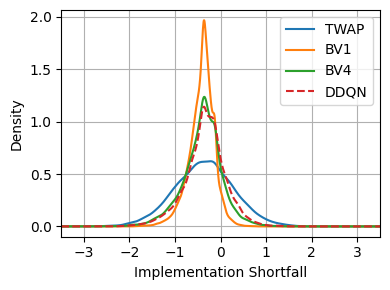

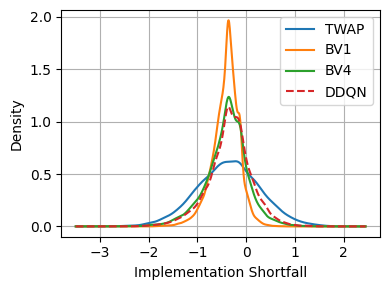

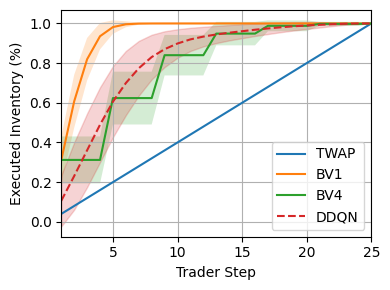

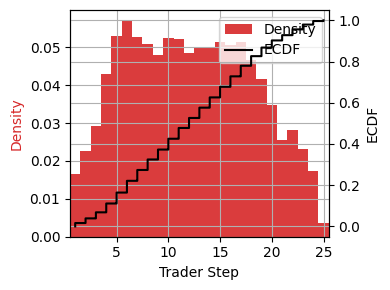

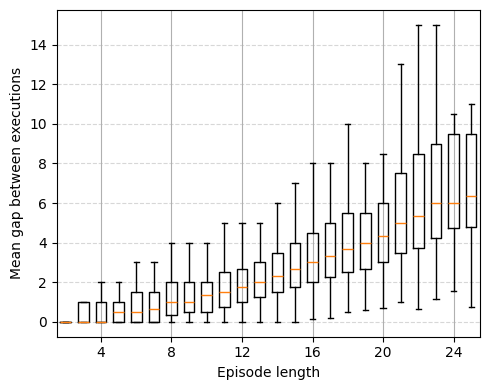

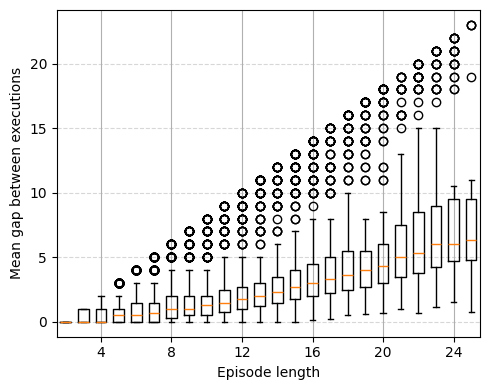

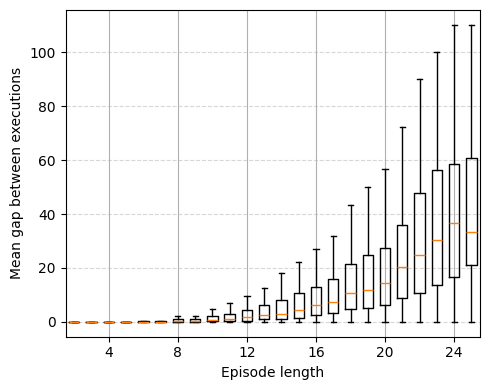

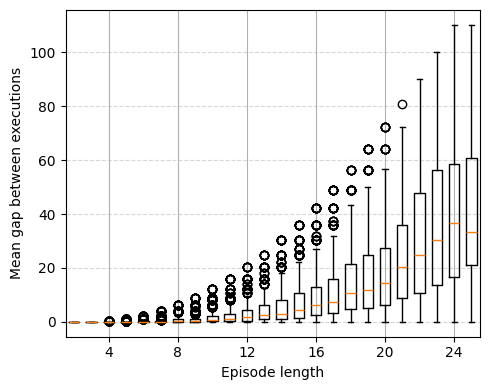

: 

In [ ]:
run_id = 't14pvod1'
state_dim = 4
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
# types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

## 4-dim: t14pvod1 - 2629402 19/09/2025 8h-50N

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.338, std=0.448 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.0300% of runs did not reach full inventory
    Missing volume: avg=1.50, std=0.50, max=2.00



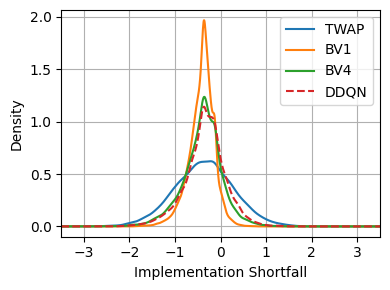

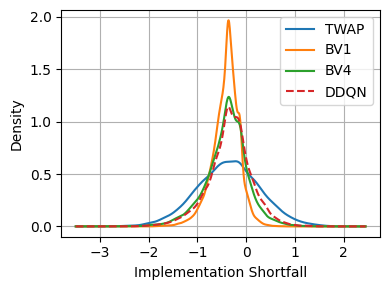

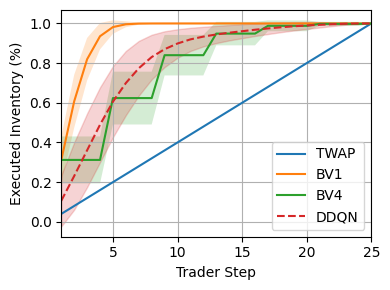

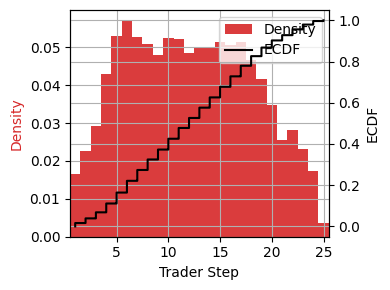

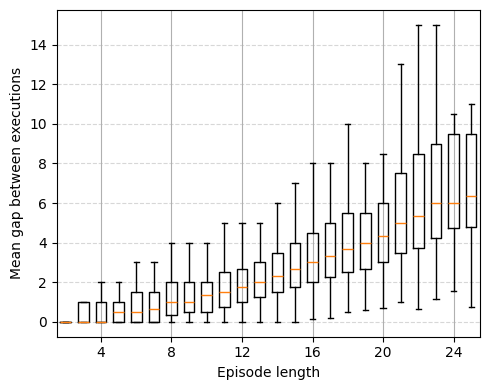

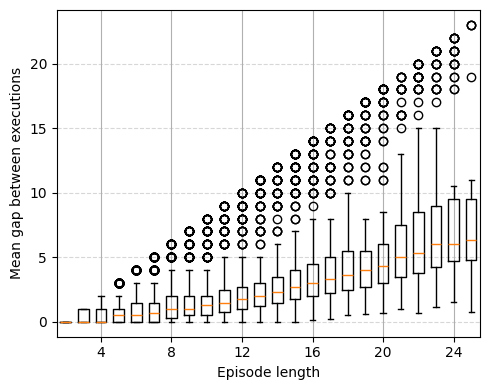

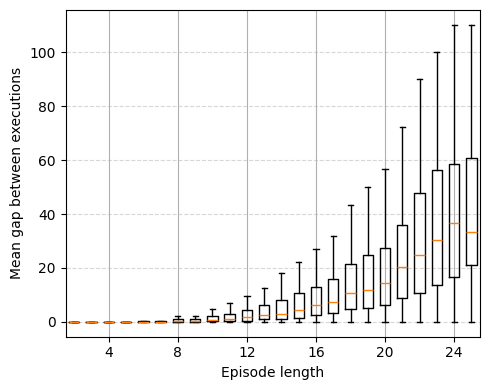

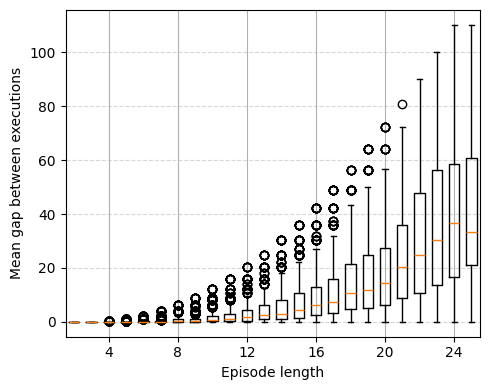

: 

In [ ]:
run_id = 't14pvod1'
state_dim = 4
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
# types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

## 4-dim: r5frl9t8 - 2628357 09/17/2025 3h-30N

### General

[TWAP] IS: mean=-0.365, std=0.652 

[BV1] IS: mean=-0.413, std=0.279 

[BV4] IS: mean=-0.399, std=0.437 

[DDQN] IS: mean=-0.327, std=0.523 

[TWAP] 0.0000% of runs did not reach full inventory
[BV1] 0.0000% of runs did not reach full inventory
[BV4] 0.2650% of runs did not reach full inventory
    Missing volume: avg=2.51, std=1.91, max=9.00

[DDQN] 0.0050% of runs did not reach full inventory
    Missing volume: avg=2.00, std=0.00, max=2.00



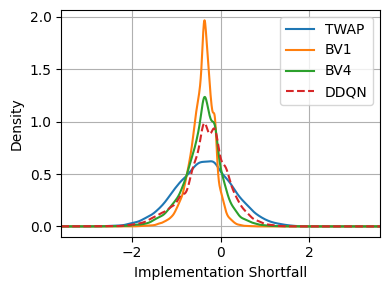

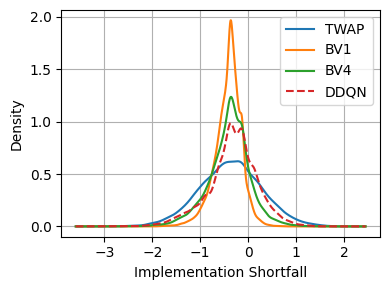

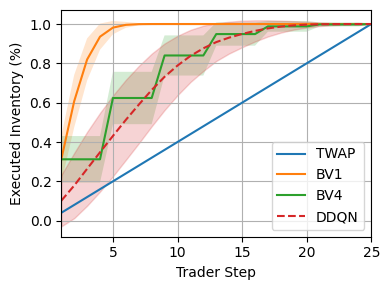

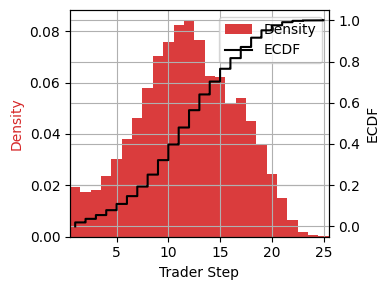

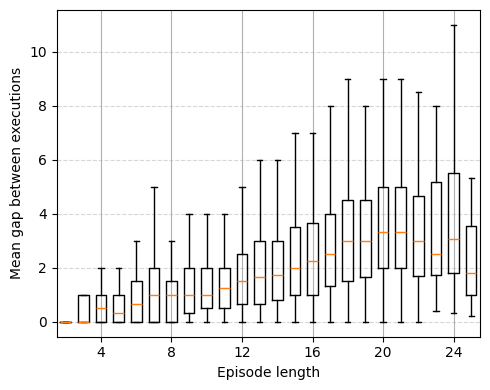

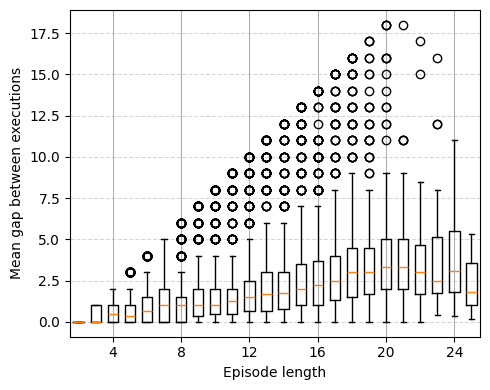

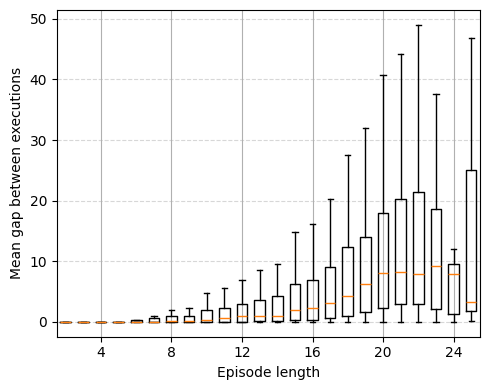

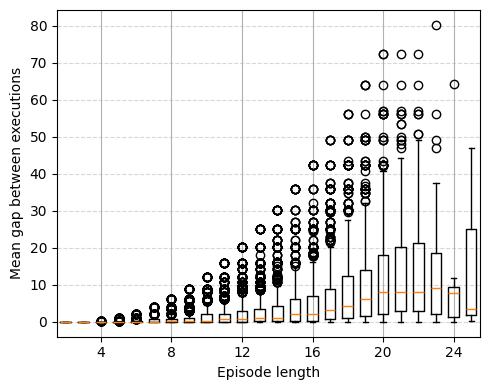

: 

In [ ]:
run_id = 'r5frl9t8'
state_dim = 4
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
# types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

In [ ]:
compute_t_test(types, run_names, reference='ddqn')

## 3-dim: 1jvxutej - 2628368 09/17/2025

### General

In [ ]:
run_id = '1jvxutej'
state_dim = 3
action_dim = 2
initial_inventory = 25
th = 600
ts = 25
types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
# types = ['twap', 'front_load', 'best_volume_4', 'ddqn']
run_ids = ['c1'] * (len(types)-1) + [run_id]
run_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']
best_labels = ['TWAP', 'BV1', 'BV4', 'DDQN']

### --------------- #############################################

trader_times_full = np.concatenate(([0], np.arange(0, th + ts, ts)))
trader_times = trader_times_full[1:]

run_names = [f'{type}_{ri}' for type, ri in zip(types, run_ids)]
title = f'{run_id}'

### --------------- #############################################

plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels, 
    run_id=run_id)

run_name = f'ddqn_{run_id}'
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)
executed = dic['executed']

plot_mean_distance_boxplots(executed, trader_times_full, run_id)
plot_intra_mean_distance_boxplots(executed, trader_times_full, run_id)

### t-test

twap is better in 3-dim

In [ ]:
compute_t_test(types, run_names, reference='twap')

## Summary 09/17/2025

is plot

In [ ]:
with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/ddqn_1jvxutej.pkl', 'rb') as f:
    dic = pickle.load(f)

final_is_3 = np.array(dic['final_is'])
maxi = np.max(np.abs(final_is_3))

with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/ddqn_r5frl9t8.pkl', 'rb') as f:
    dic = pickle.load(f)

final_is_4 = np.array(dic['final_is'])
maxi = max(np.max(np.abs(final_is_4)), maxi)

with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/ddqn_wk64rt4k.pkl', 'rb') as f:
    dic = pickle.load(f)

final_is_5 = np.array(dic['final_is'])
maxi = max(np.max(np.abs(final_is_5)), maxi)

x_kde = np.linspace(-maxi, maxi, 1000)
kde_3 = gaussian_kde(final_is_3)
y_kde_3 = kde_3(x_kde)
kde_4 = gaussian_kde(final_is_4)
y_kde_4 = kde_4(x_kde)
kde_5 = gaussian_kde(final_is_5)
y_kde_5 = kde_5(x_kde)

plt.figure(figsize=(4, 3))
plt.plot(x_kde, y_kde_3, label='3-dim')
plt.plot(x_kde, y_kde_4, label='4-dim')
plt.plot(x_kde, y_kde_5, label='5-dim', linestyle='--', color='C3')
plt.xlabel('Implementation Shortfall')
plt.ylabel('Density')
plt.xlim((-2.5, 2))

# plt.grid()
plt.legend()
plt.savefig(f'/scratch/network/te6653/qrm_optimal_execution/plots/overview/summary_is.pdf', bbox_inches='tight')
plt.show()

is the 5-dim statistically significantly better ?

In [ ]:
reference = final_is_5
t_stat, p_value = stats.ttest_ind(reference, final_is_4, equal_var=False, alternative='greater')
print(f'T-test between 5-dim and 4-dim: t-statistic = {t_stat:.4f}, p-value = {p_value:.4f}')
if p_value < 0.05:
    print(f'Statistically significant difference between 5-dim and 4-dim (p < 0.05)')
print('\n')

Method DDQN
Mean: -0.46, Std: 0.43 

Method Front Load
Mean: -0.49, Std: 0.37 

Method Best Volume
Mean: -0.46, Std: 0.41 

Method Best Volume 3
Mean: -0.44, Std: 0.44 



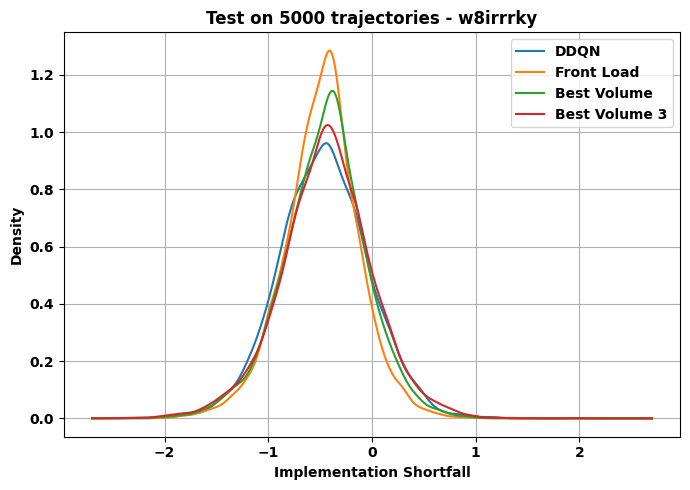

In [28]:
nb_episodes = 5000
run_id = 'w8irrrky'
types = ['ddqn', 'front_load', 'best_volume', 'best_volume_3']
run_names = [f'{type}_{run_id}' for type in types]
run_labels = ['DDQN', 'Front Load', 'Best Volume', 'Best Volume 3']
pdf_name = 's_11_ddqns'
title = f'Test on {nb_episodes} trajectories - {run_id}'
plot_is(run_names, run_labels, pdf_name, title)

# Average Price Trajectories

FULL CODE: this is the code when the option saving memory is False and you have all the LOB. Just change the file names to import dictionary with pickle.

In [ ]:
T = 10000
trader_time_step = 1000
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

path = 'C:/Users/etoma/OneDrive - CentraleSupelec/OneDrive/Desktop/test_git_code/qrm_optimal_execution'
with open(f'{path}/data_wandb/dictionaries/best_volume_srr1gewe.pkl', 'rb') as f:
    dic = pickle.load(f)

lobs = dic['lob']
lengths = []
for key, lob in lobs.items():
    lengths.append(len(lob))

print('Statistics of the lengths of the LOBs:')
print('min', min(lengths), 'max', max(lengths), 'mean', np.mean(lengths), 'std', np.std(lengths))


mid_prices_time = np.full((len(lobs), len(trader_times)), np.nan)

length = min(lengths)
mid_prices = np.zeros((len(lobs), length))
volumes = []
q_ask1_vol = []
best_ask_vol = []
for i, (key, lob) in enumerate(lobs.items()):
    matched_rows = lob[lob['time'].isin(trader_times)]
    n = len(matched_rows)
    mid_prices_time[i][:n] = matched_rows['p_mid'].to_numpy()

    n = min(len(lob), length)
    mid_prices[i, :n] = lob.p_mid.values[:n]
    # # total ask volume
    # vols = list(lob[['q_ask1', 'q_ask2', 'q_ask3']].values.sum(axis=1))
    # volumes += vols
    # # q_ask1 volume
    # vols = list(lob['q_ask1'].values)
    # q_ask1_vol += vols
    # # best ask volume
    # vols = lob[['q_ask1', 'q_ask2', 'q_ask3']].to_numpy()
    # mask = vols != 0
    # first_nonzero_indices = mask.argmax(axis=1)
    # row_indices = np.arange(vols.shape[0])
    # best_ask_vol = np.where(
    #     mask.any(axis=1),
    #     vols[row_indices, first_nonzero_indices],
    #     0 )


executed = dic['executed']
execs = []
for key, value in executed.items():
    execs += value

plt.figure(figsize=(6, 4))
plt.plot(np.nanmean(mid_prices_time, axis=0), label='Mean Mid Price')
plt.title('Average Mid Price at Trader Times')

plt.figure(figsize=(6, 4))
plt.plot(mid_prices.mean(axis=0), label='Mean Mid Price')
plt.title('Average Mid Price')

plt.figure(figsize=(6, 4))
sns.kdeplot(volumes, fill=True, color='blue', alpha=0.7)
plt.title('Total Ask Volume Distribution')
print('Average total ask volume', np.mean(volumes))

plt.figure(figsize=(6, 4))
sns.kdeplot(q_ask1_vol, fill=True, color='blue', alpha=0.7)
plt.title('q_ask1 Volume Distribution')
print('Average q_ask1 volume', np.mean(q_ask1_vol))

plt.figure(figsize=(6, 4))
sns.kdeplot(best_ask_vol, fill=True, color='blue', alpha=0.7)
plt.title('Best Ask Volume Distribution')
print('Average best ask volume', np.mean(best_ask_vol))

plt.figure(figsize=(6, 4))
sns.kdeplot(execs, fill=True, color='blue', alpha=0.7)
plt.hist(execs, bins=50, alpha=0.7, color='blue')
plt.title('Executions')

## T = 10 000, TTS = 1000, Inv=25

In [85]:
name_run = 'srr1gewe'

### Best Volume mod 2

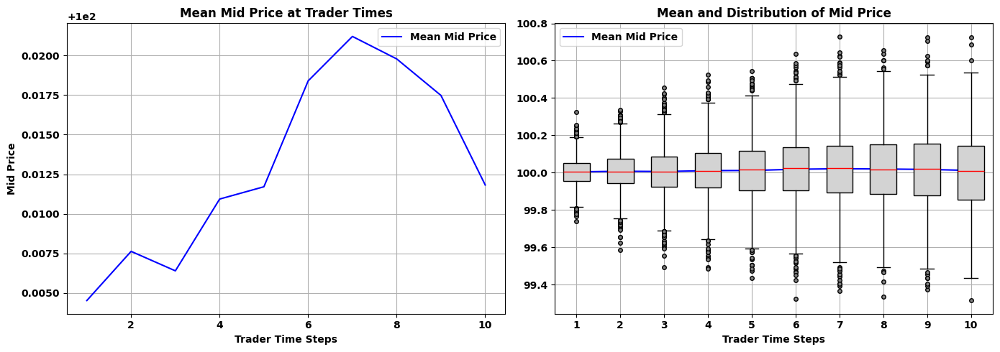

In [ ]:
T = 10000
trader_time_step = 1000
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']

arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
x_vals = range(1, len(trader_times))

fig, axs = plt.subplots(1, 2, figsize=(14, 5))

# Left plot: mean mid price only
axs[0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0].set_title('Mean Mid Price at Trader Times')
axs[0].set_xlabel('Trader Time Steps')
axs[0].set_ylabel('Mid Price')
axs[0].grid()
axs[0].legend()

# Right plot: mean mid price + boxplots
axs[1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1].set_title('Mean and Distribution of Mid Price')
axs[1].set_xlabel('Trader Time Steps')
axs[1].grid()
axs[1].legend()

plt.tight_layout()
plt.show()


### Front Load

C:\Users\etoma\AppData\Local\Temp\ipykernel_14672\2012177380.py:14: RuntimeWarning: Mean of empty slice
  mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)


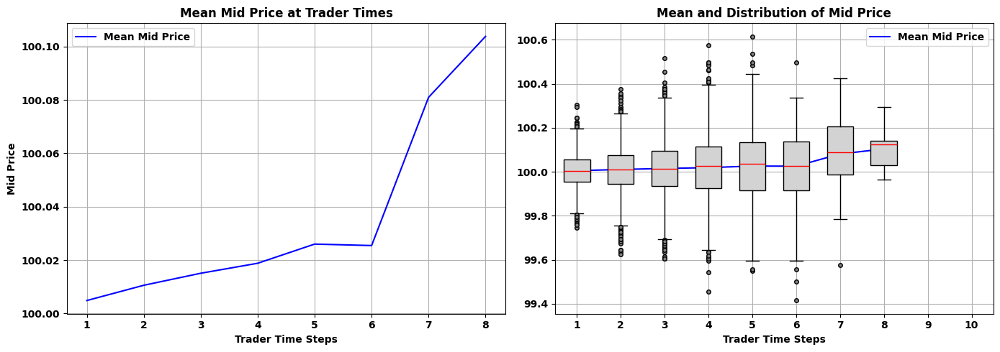

In [ ]:
T = 10000
trader_time_step = 1000
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/front_load_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']

arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
x_vals = range(1, len(trader_times))

fig, axs = plt.subplots(1, 2, figsize=(14, 5))

# Left plot: mean mid price only
axs[0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0].set_title('Mean Mid Price at Trader Times')
axs[0].set_xlabel('Trader Time Steps')
axs[0].set_ylabel('Mid Price')
axs[0].grid()
axs[0].legend()

# Right plot: mean mid price + boxplots
axs[1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1].set_title('Mean and Distribution of Mid Price')
axs[1].set_xlabel('Trader Time Steps')
axs[1].grid()
axs[1].legend()

plt.tight_layout()
plt.show()


## T = 10 000, TTS = 1000, Inv=40

In [86]:
name_run = 'inv_40'

### Best Volume mod 2

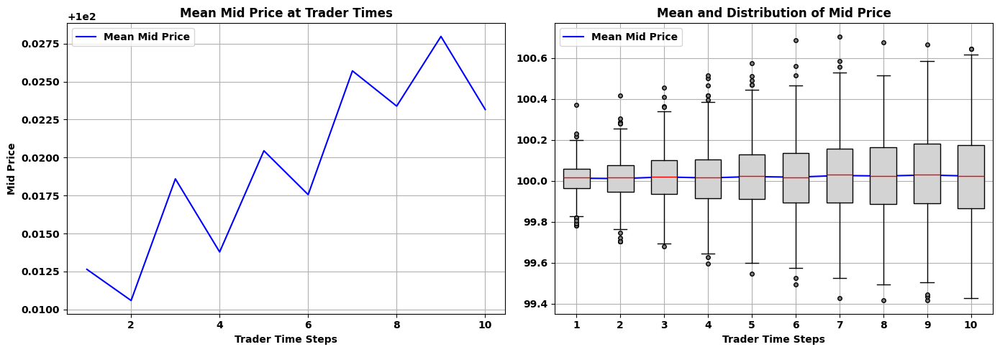

In [87]:
T = 10000
trader_time_step = 1000
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']

arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
x_vals = range(1, len(trader_times))

fig, axs = plt.subplots(1, 2, figsize=(14, 5))

# Left plot: mean mid price only
axs[0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0].set_title('Mean Mid Price at Trader Times')
axs[0].set_xlabel('Trader Time Steps')
axs[0].set_ylabel('Mid Price')
axs[0].grid()
axs[0].legend()

# Right plot: mean mid price + boxplots
axs[1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1].set_title('Mean and Distribution of Mid Price')
axs[1].set_xlabel('Trader Time Steps')
axs[1].grid()
axs[1].legend()

plt.tight_layout()
plt.show()


### Front Load

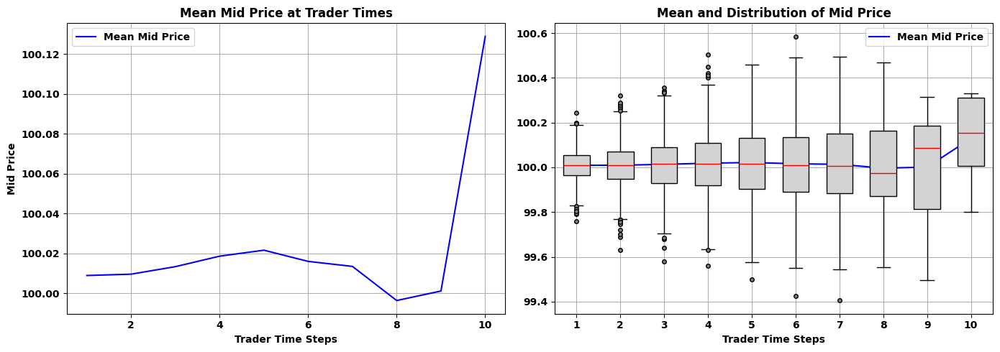

In [88]:
T = 10000
trader_time_step = 1000
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/front_load_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']

arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
x_vals = range(1, len(trader_times))

fig, axs = plt.subplots(1, 2, figsize=(14, 5))

# Left plot: mean mid price only
axs[0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0].set_title('Mean Mid Price at Trader Times')
axs[0].set_xlabel('Trader Time Steps')
axs[0].set_ylabel('Mid Price')
axs[0].grid()
axs[0].legend()

# Right plot: mean mid price + boxplots
axs[1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1].set_title('Mean and Distribution of Mid Price')
axs[1].set_xlabel('Trader Time Steps')
axs[1].grid()
axs[1].legend()

plt.tight_layout()
plt.show()


## T = 1000, TTS = 100, Inv=1000

In [103]:
T = 1000
trader_time_step = 100
name_run = 'tts_100_inv_1000'

### Best Volume mod 2

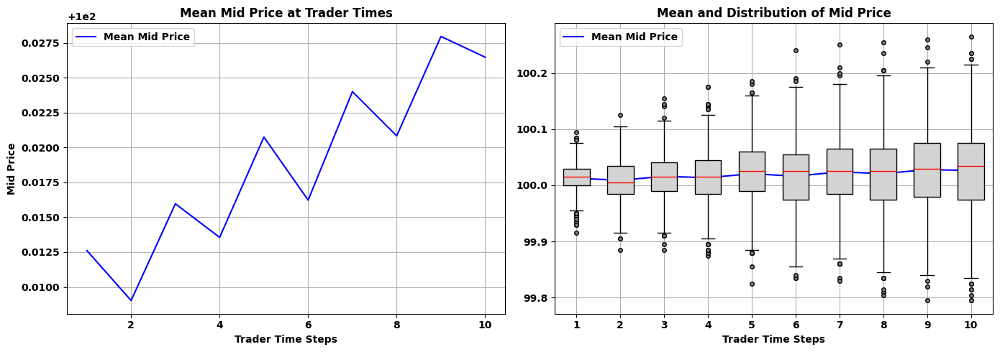

In [104]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']

arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
x_vals = range(1, len(trader_times))

fig, axs = plt.subplots(1, 2, figsize=(14, 5))

# Left plot: mean mid price only
axs[0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0].set_title('Mean Mid Price at Trader Times')
axs[0].set_xlabel('Trader Time Steps')
axs[0].set_ylabel('Mid Price')
axs[0].grid()
axs[0].legend()

# Right plot: mean mid price + boxplots
axs[1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1].set_title('Mean and Distribution of Mid Price')
axs[1].set_xlabel('Trader Time Steps')
axs[1].grid()
axs[1].legend()

plt.tight_layout()
plt.show()


### Front Load

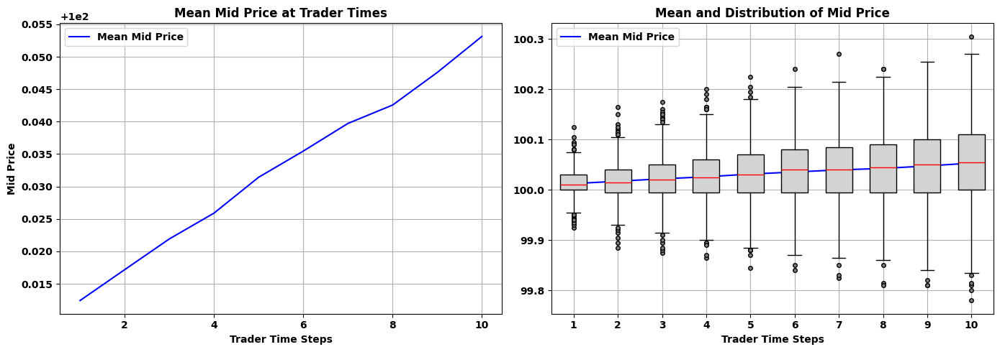

In [105]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/front_load_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']

arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
x_vals = range(1, len(trader_times))

fig, axs = plt.subplots(1, 2, figsize=(14, 5))

# Left plot: mean mid price only
axs[0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0].set_title('Mean Mid Price at Trader Times')
axs[0].set_xlabel('Trader Time Steps')
axs[0].set_ylabel('Mid Price')
axs[0].grid()
axs[0].legend()

# Right plot: mean mid price + boxplots
axs[1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1].set_title('Mean and Distribution of Mid Price')
axs[1].set_xlabel('Trader Time Steps')
axs[1].grid()
axs[1].legend()

plt.tight_layout()
plt.show()


## T = 1000, TTS = 50, Inv=1000

In [106]:
T = 1000
trader_time_step = 50
name_run = 'tts_50_inv_1000'

### Best Volume mod 2

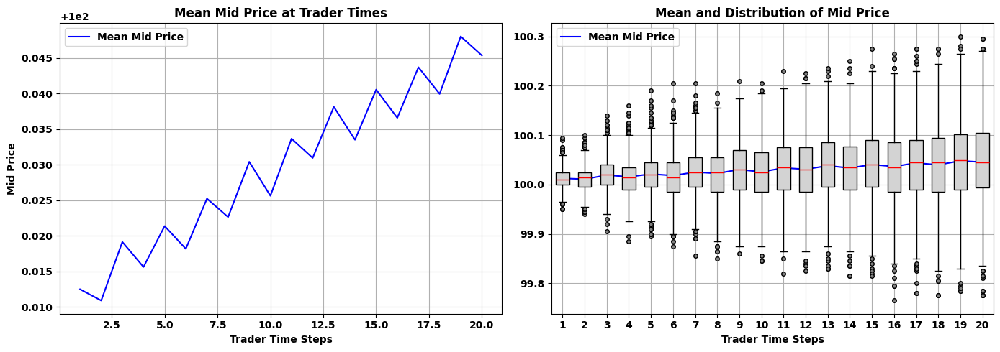

In [107]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']

arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
x_vals = range(1, len(trader_times))

fig, axs = plt.subplots(1, 2, figsize=(14, 5))

# Left plot: mean mid price only
axs[0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0].set_title('Mean Mid Price at Trader Times')
axs[0].set_xlabel('Trader Time Steps')
axs[0].set_ylabel('Mid Price')
axs[0].grid()
axs[0].legend()

# Right plot: mean mid price + boxplots
axs[1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1].set_title('Mean and Distribution of Mid Price')
axs[1].set_xlabel('Trader Time Steps')
axs[1].grid()
axs[1].legend()

plt.tight_layout()
plt.show()


### Front Load

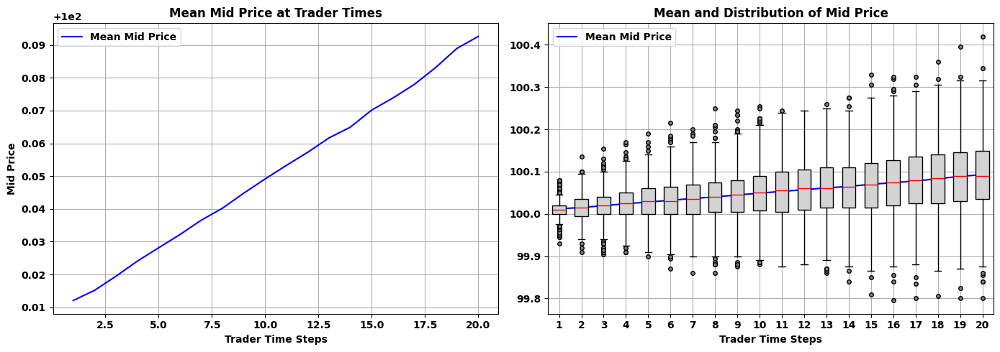

In [109]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/front_load_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']

arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
x_vals = range(1, len(trader_times))

fig, axs = plt.subplots(1, 2, figsize=(14, 5))

# Left plot: mean mid price only
axs[0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0].set_title('Mean Mid Price at Trader Times')
axs[0].set_xlabel('Trader Time Steps')
axs[0].set_ylabel('Mid Price')
axs[0].grid()
axs[0].legend()

# Right plot: mean mid price + boxplots
axs[1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1].set_title('Mean and Distribution of Mid Price')
axs[1].set_xlabel('Trader Time Steps')
axs[1].grid()
axs[1].legend()

plt.tight_layout()
plt.show()


## T = 1000, TTS = 25, Inv=1000

In [110]:
T = 1000
trader_time_step = 25
name_run = 'tts_25_inv_1000'

### Best Volume mod 2

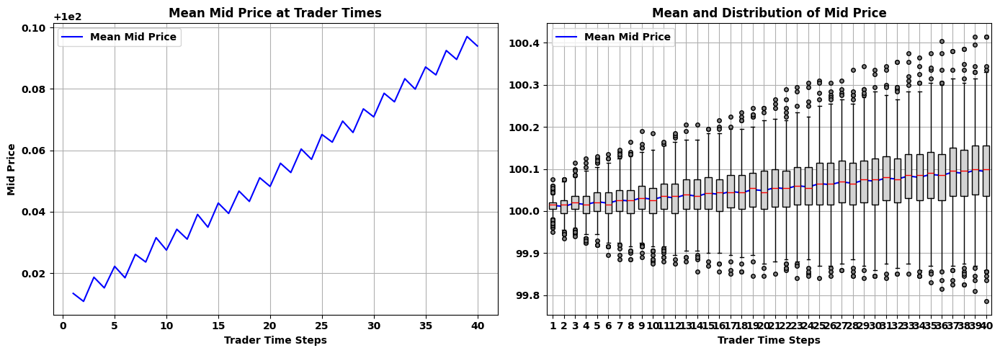

In [111]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']

arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
x_vals = range(1, len(trader_times))

fig, axs = plt.subplots(1, 2, figsize=(14, 5))

# Left plot: mean mid price only
axs[0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0].set_title('Mean Mid Price at Trader Times')
axs[0].set_xlabel('Trader Time Steps')
axs[0].set_ylabel('Mid Price')
axs[0].grid()
axs[0].legend()

# Right plot: mean mid price + boxplots
axs[1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1].set_title('Mean and Distribution of Mid Price')
axs[1].set_xlabel('Trader Time Steps')
axs[1].grid()
axs[1].legend()

plt.tight_layout()
plt.show()


### Front Load

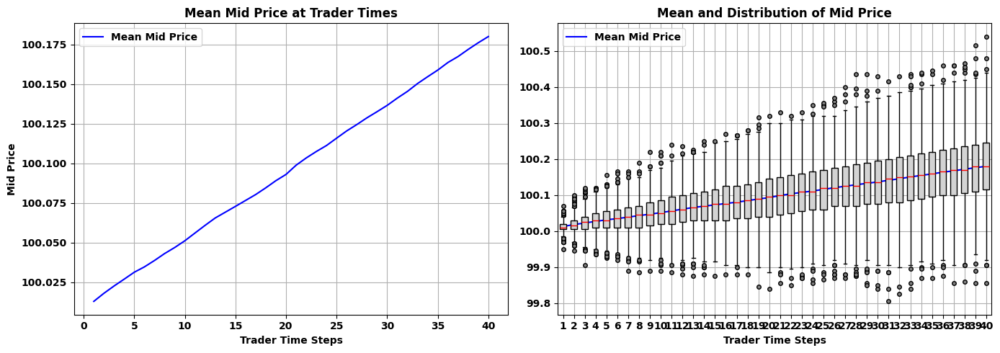

In [112]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/front_load_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']

arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
x_vals = range(1, len(trader_times))

fig, axs = plt.subplots(1, 2, figsize=(14, 5))

# Left plot: mean mid price only
axs[0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0].set_title('Mean Mid Price at Trader Times')
axs[0].set_xlabel('Trader Time Steps')
axs[0].set_ylabel('Mid Price')
axs[0].grid()
axs[0].legend()

# Right plot: mean mid price + boxplots
axs[1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1].set_title('Mean and Distribution of Mid Price')
axs[1].set_xlabel('Trader Time Steps')
axs[1].grid()
axs[1].legend()

plt.tight_layout()
plt.show()


## T = 100, TTS = 5, Inv=1000

In [126]:
T = 100
trader_time_step = 5
name_run = 'tts_5_inv_1000'

### Best Volume mod 2

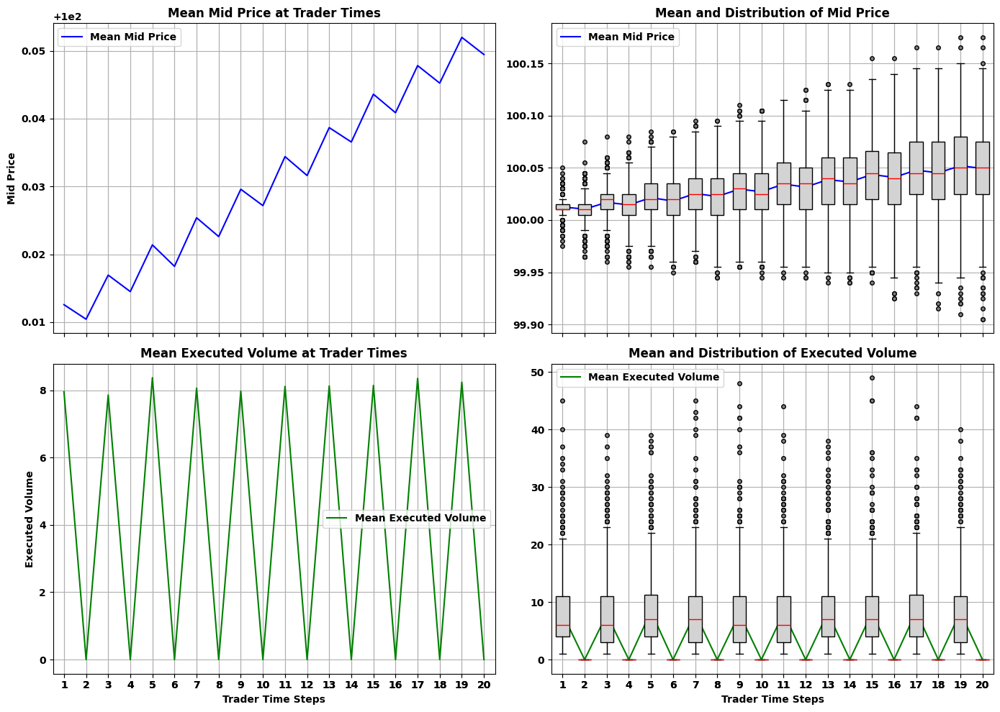

In [127]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


### Front Load

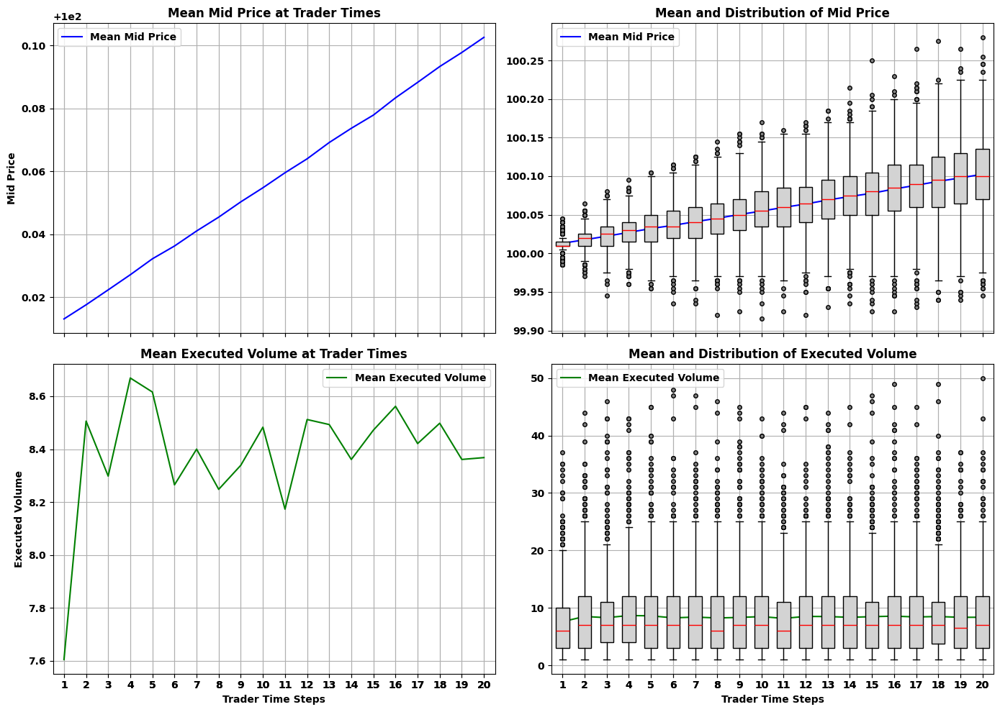

In [128]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/front_load_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


## T = 100, TTS = 3, Inv=1000

In [7]:
T = 100
trader_time_step = 3
name_run = 'tts_3_inv_1000'

### Best Volume mod 2

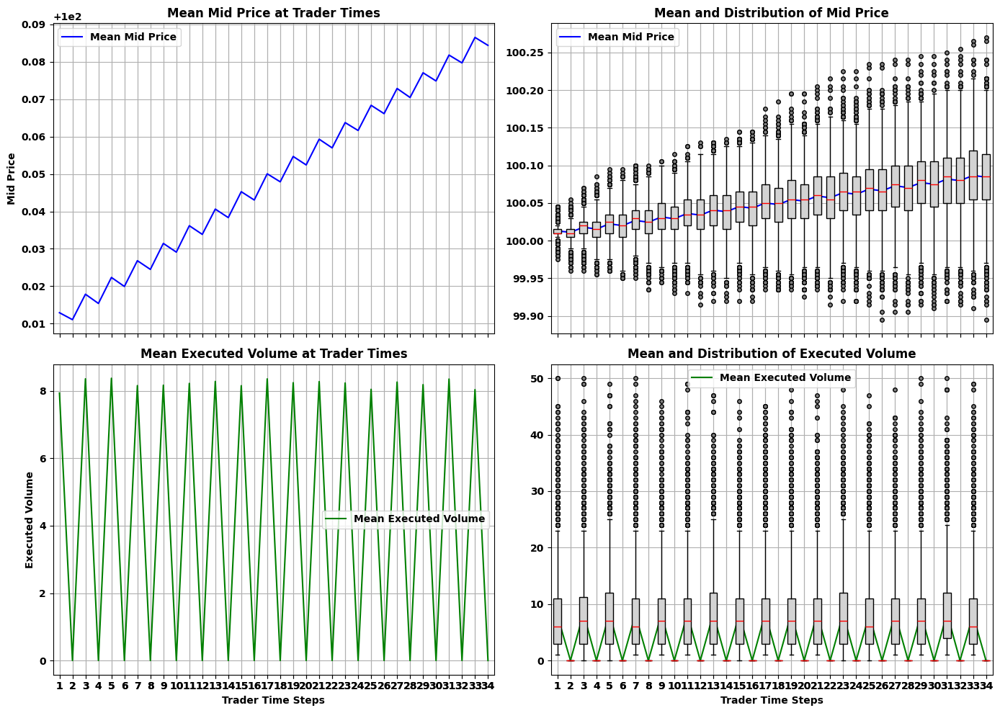

In [130]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


### Front Load

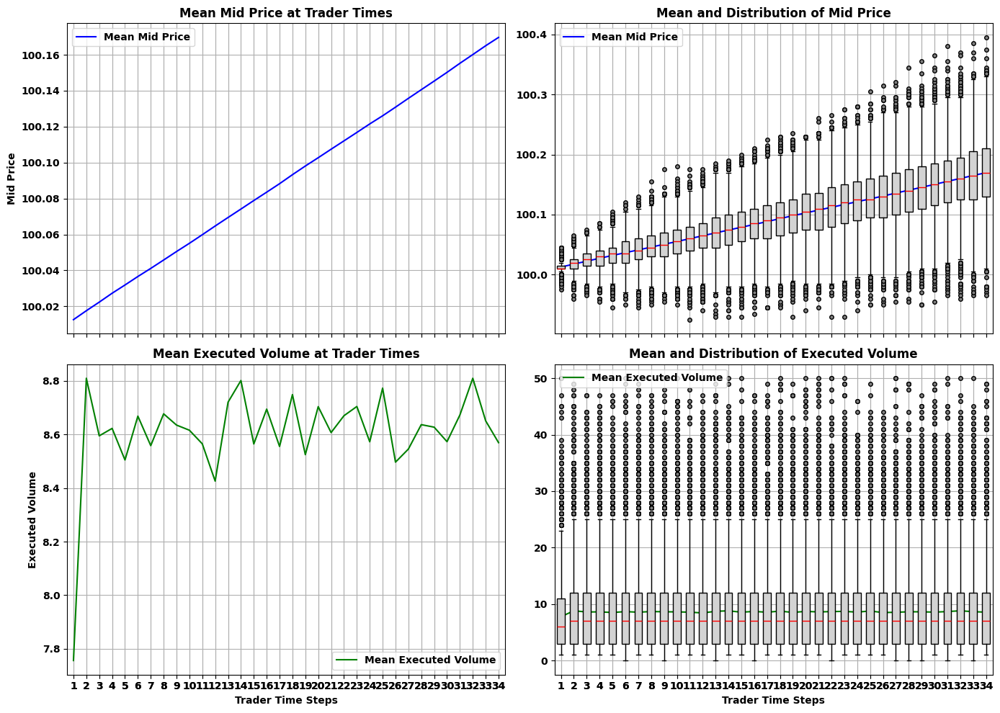

In [131]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/front_load_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


### Best Volume mod 3

C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\3659224606.py:23: RuntimeWarning: Mean of empty slice
  mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\3659224606.py:24: RuntimeWarning: Mean of empty slice
  mean_executed = np.nanmean(arr_executed, axis=0)


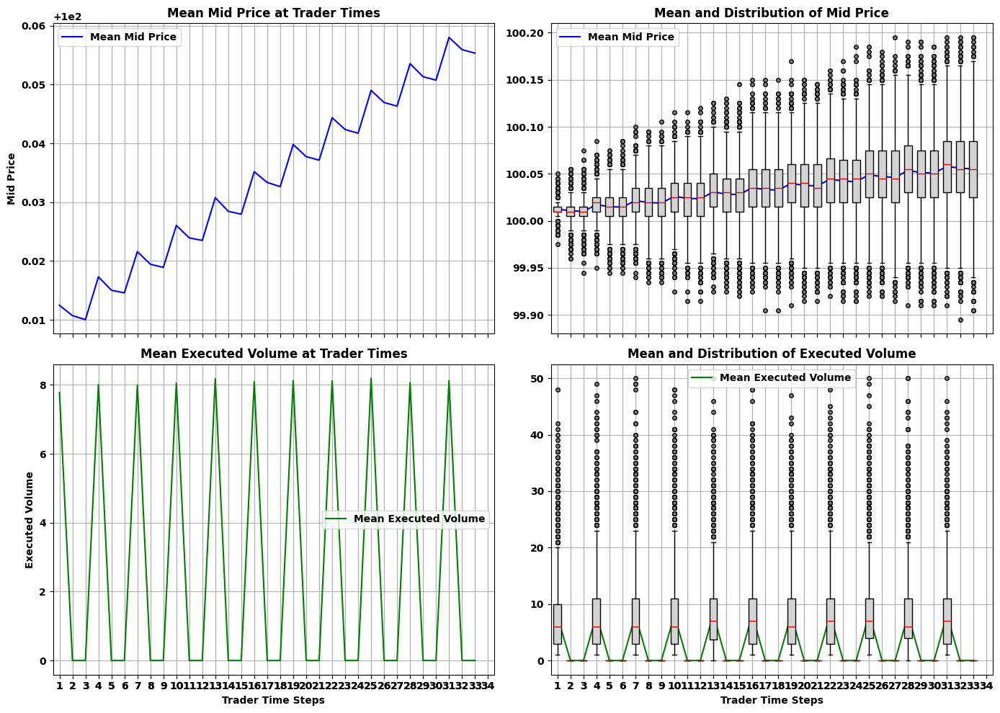

In [8]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_3_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


## T = 100, TTS = 3, Inv=42

In [9]:
T = 100
trader_time_step = 3
name_run = 'tts_3_inv_42'

### Best Volume mod 2

C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\2239523727.py:23: RuntimeWarning: Mean of empty slice
  mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\2239523727.py:24: RuntimeWarning: Mean of empty slice
  mean_executed = np.nanmean(arr_executed, axis=0)


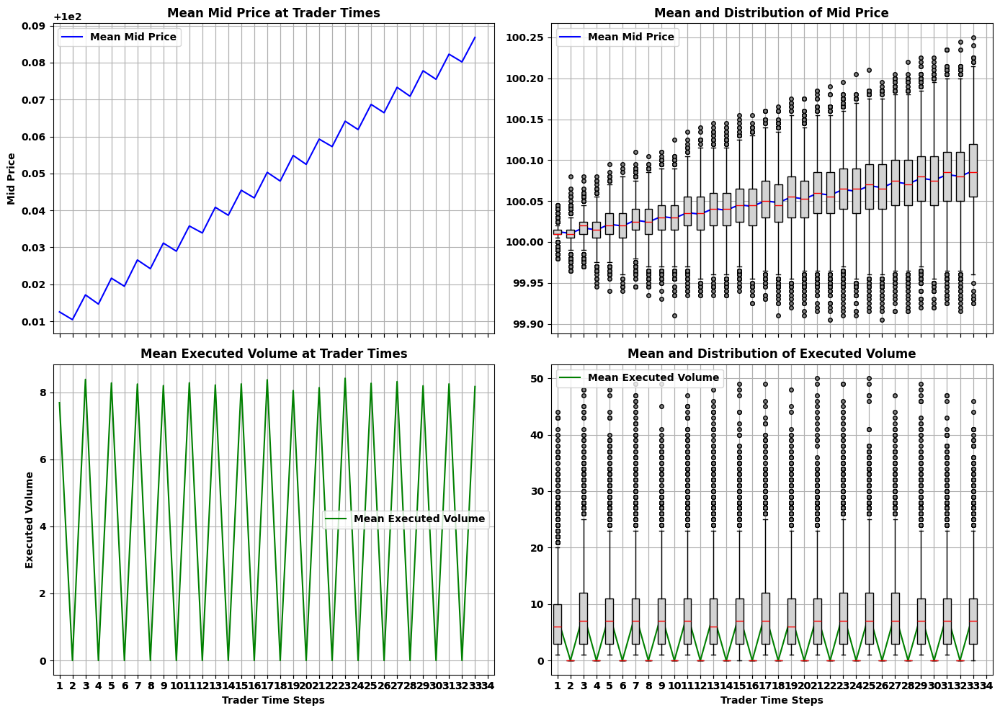

In [10]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


### Front Load

C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\3868877603.py:23: RuntimeWarning: Mean of empty slice
  mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\3868877603.py:24: RuntimeWarning: Mean of empty slice
  mean_executed = np.nanmean(arr_executed, axis=0)


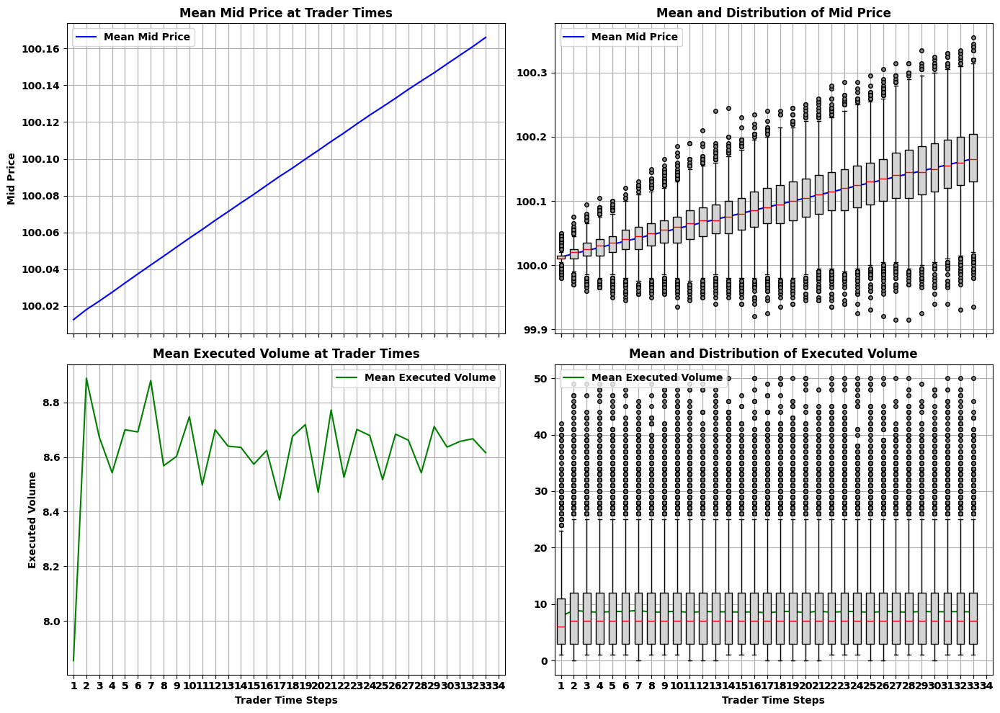

In [12]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/front_load_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


### Best Volume mod 3

C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\3659224606.py:23: RuntimeWarning: Mean of empty slice
  mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\3659224606.py:24: RuntimeWarning: Mean of empty slice
  mean_executed = np.nanmean(arr_executed, axis=0)


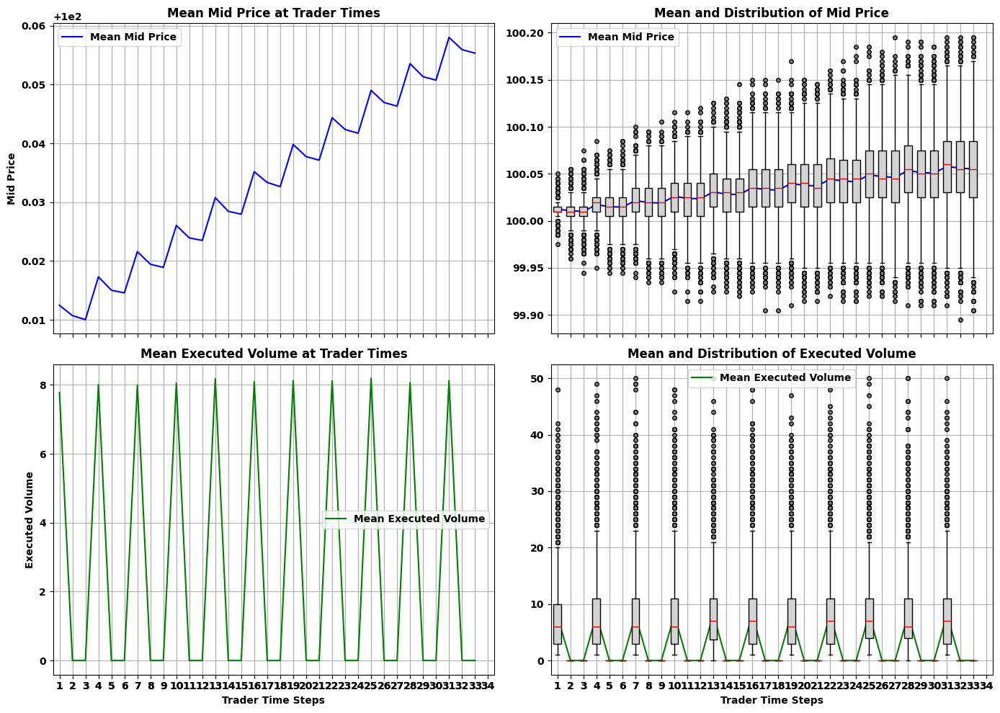

In [13]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_3_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


### DDQN bfbhq1tl

C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\3279008944.py:24: RuntimeWarning: Mean of empty slice
  mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\3279008944.py:25: RuntimeWarning: Mean of empty slice
  mean_executed = np.nanmean(arr_executed, axis=0)


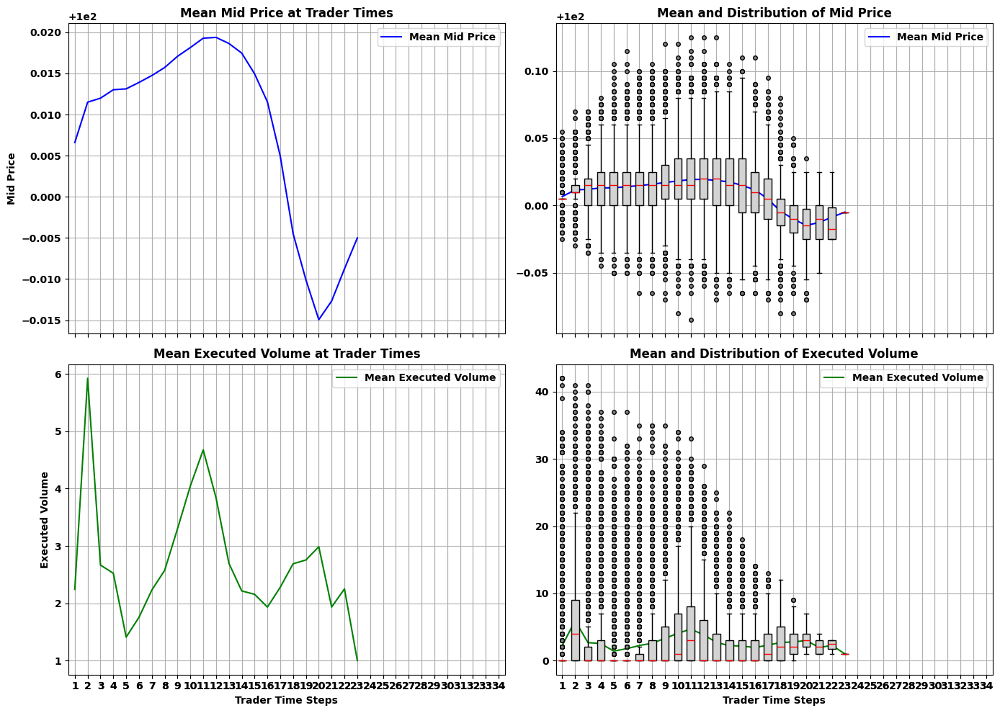

In [14]:
run_id = 'bfbhq1tl'
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/ddqn_{run_id}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


NOTE: it seems he doesn't execute much at the first time step...

### DDQN 4rly7uhb

C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\923858503.py:24: RuntimeWarning: Mean of empty slice
  mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\923858503.py:25: RuntimeWarning: Mean of empty slice
  mean_executed = np.nanmean(arr_executed, axis=0)


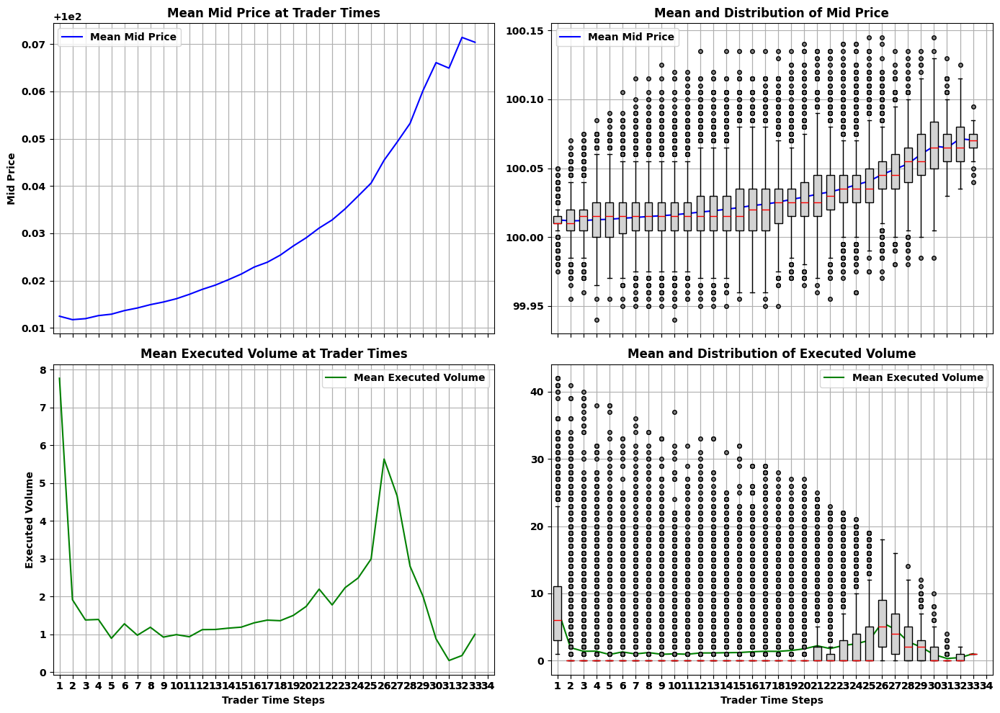

In [15]:
run_id = '4rly7uhb'
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/ddqn_{run_id}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


NOTE: this is clearly bad. 

## T = 78, TTS = 3, Inv=1000

In [51]:
T = 78
trader_time_step = 3
name_run = 'tts_3_inv_1000'

### Front Load

Step 1: Mean Executed = 7.7500, Std = 5.9259
Step 2: Mean Executed = 8.7452, Std = 7.0966
Step 3: Mean Executed = 8.6960, Std = 6.9155
Step 4: Mean Executed = 8.6544, Std = 6.9200
Step 5: Mean Executed = 8.6124, Std = 6.8737
Step 6: Mean Executed = 8.6736, Std = 7.0416
Step 7: Mean Executed = 8.6354, Std = 7.0942
Step 8: Mean Executed = 8.6600, Std = 7.0395
Step 9: Mean Executed = 8.6476, Std = 6.8700
Step 10: Mean Executed = 8.5208, Std = 6.8732
Step 11: Mean Executed = 8.6482, Std = 6.9333
Step 12: Mean Executed = 8.6408, Std = 6.8779
Step 13: Mean Executed = 8.6108, Std = 6.9451
Step 14: Mean Executed = 8.6320, Std = 6.9633
Step 15: Mean Executed = 8.5992, Std = 6.8876
Step 16: Mean Executed = 8.6354, Std = 7.1729
Step 17: Mean Executed = 8.6884, Std = 6.9116
Step 18: Mean Executed = 8.7420, Std = 6.9833
Step 19: Mean Executed = 8.5868, Std = 6.7949
Step 20: Mean Executed = 8.7916, Std = 7.2192
Step 21: Mean Executed = 8.5102, Std = 6.7399
Step 22: Mean Executed = 8.5742, Std = 6.87

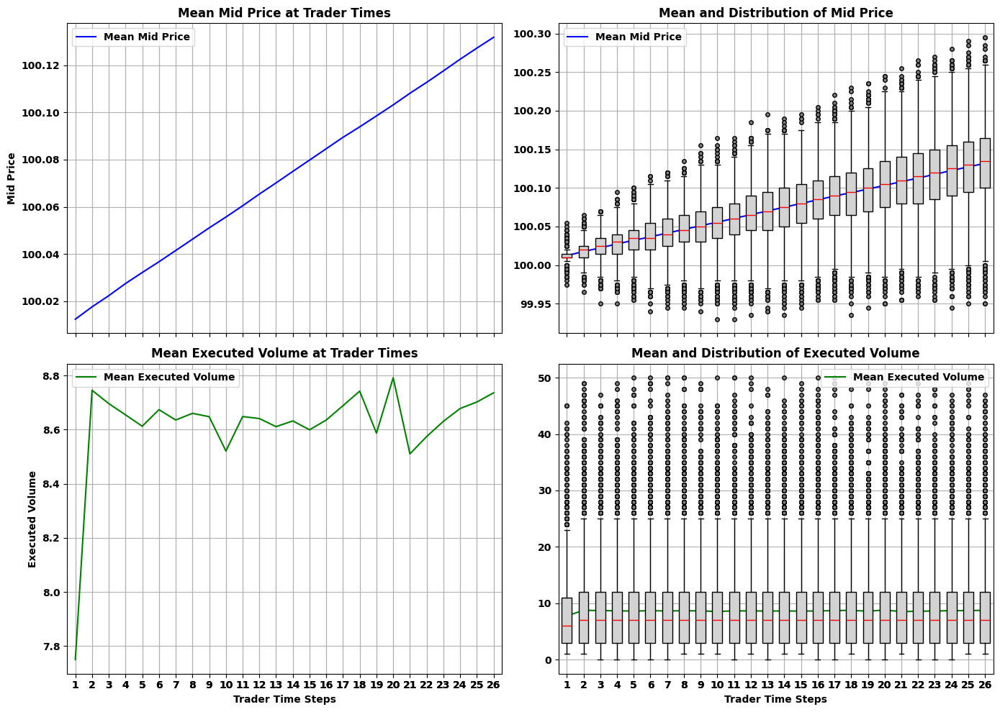

In [53]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/front_load_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means and stds
mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)
std_executed = np.nanstd(arr_executed, axis=0)

# 🔍 Print average and std of executed volume per step
for step, mean_val, std_val in zip(x_vals, mean_executed, std_executed):
    print(f"Step {step}: Mean Executed = {mean_val:.4f}, Std = {std_val:.4f}")

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
axs[0, 0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

axs[0, 1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


## T = 78, TTS = 3, Inv=30

In [226]:
T = 78
trader_time_step = 3
name_run = 'tts_3_inv_30'
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

### Best Volume mod 2

C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\2239523727.py:23: RuntimeWarning: Mean of empty slice
  mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\2239523727.py:24: RuntimeWarning: Mean of empty slice
  mean_executed = np.nanmean(arr_executed, axis=0)


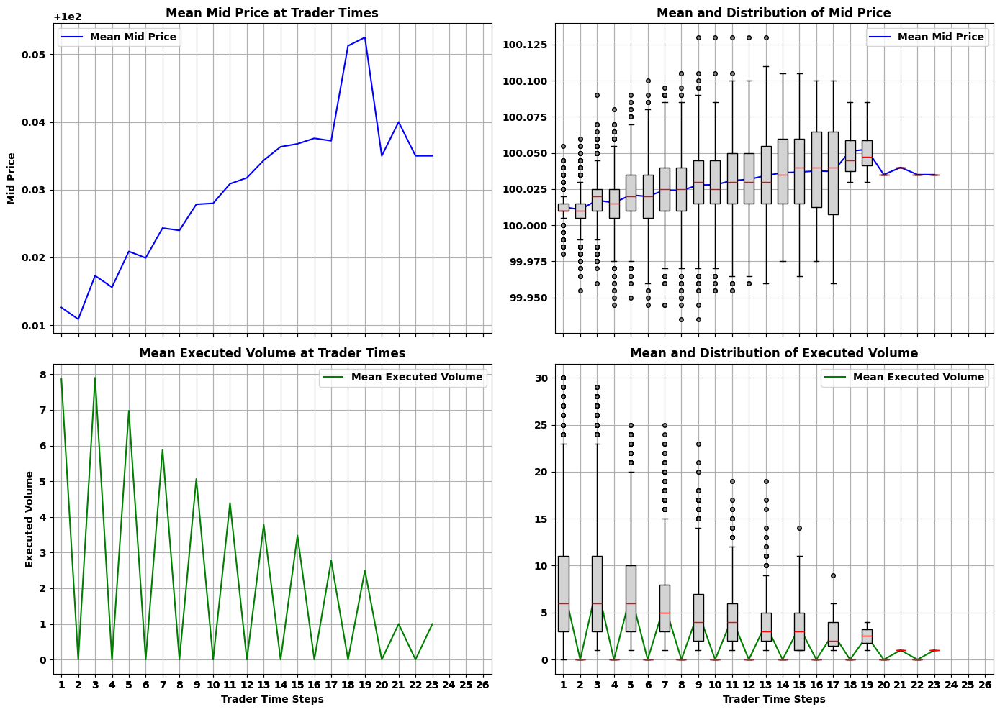

In [31]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


### Front Load

C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\3868877603.py:23: RuntimeWarning: Mean of empty slice
  mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\3868877603.py:24: RuntimeWarning: Mean of empty slice
  mean_executed = np.nanmean(arr_executed, axis=0)


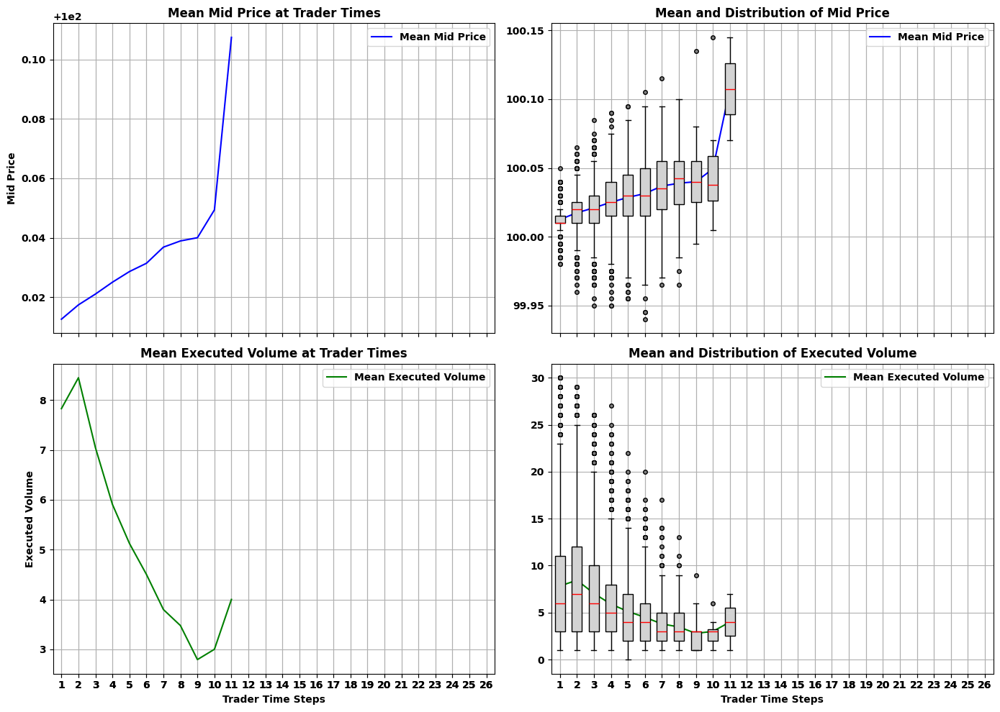

In [33]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/front_load_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


### Best Volume mod 3

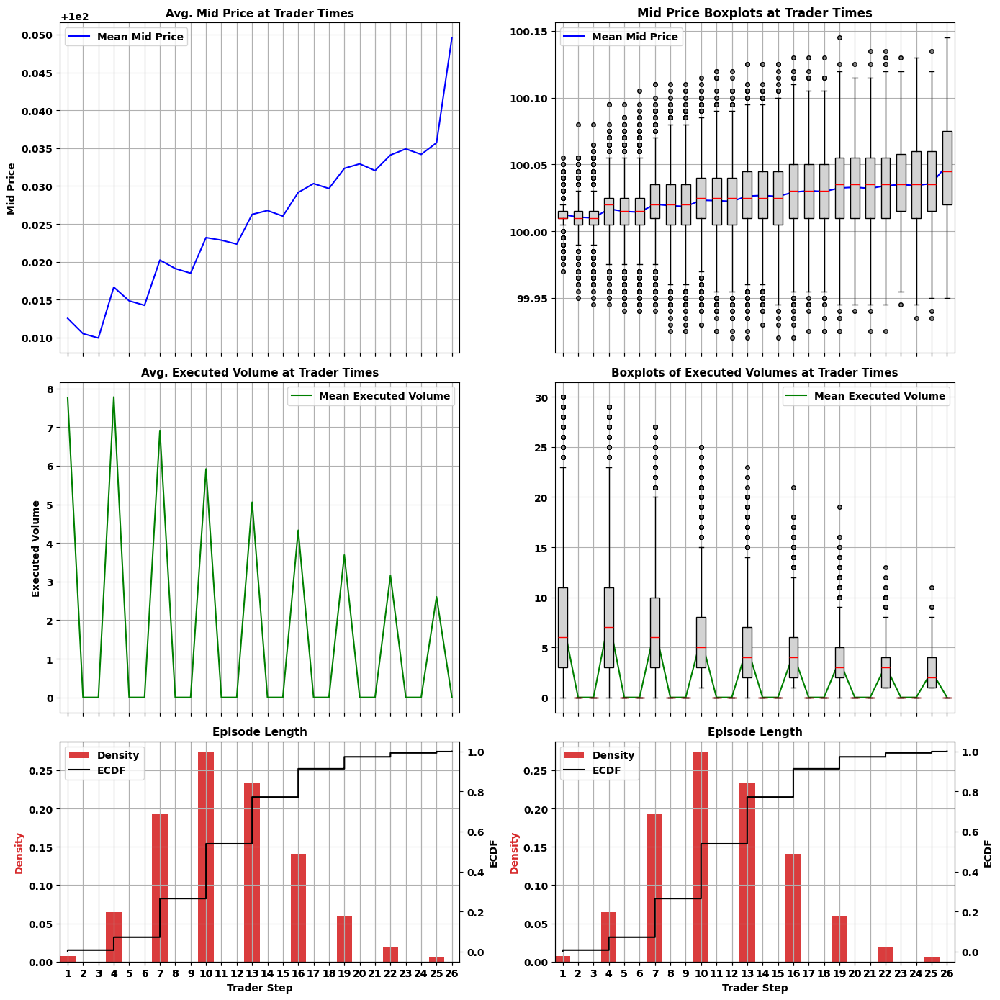

In [52]:
file_name = 'best_volume_3_tts_3_inv_30'
plot_run_analysis(file_name, trader_times_full)

## T = 78, TTS = 3, Inv= 30

[BV1] IS: mean=-0.453, std=0.405 

[BV3] IS: mean=-0.436, std=0.441 

[BV1] IS: mean=-0.453, std=0.405 

[BV3] IS: mean=-0.436, std=0.441 

[BV1] 0.0000% of runs did not reach full inventory
[BV3] 0.1250% of runs did not reach full inventory
    Missing volume: avg=4.12, std=3.17, max=13.00



c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


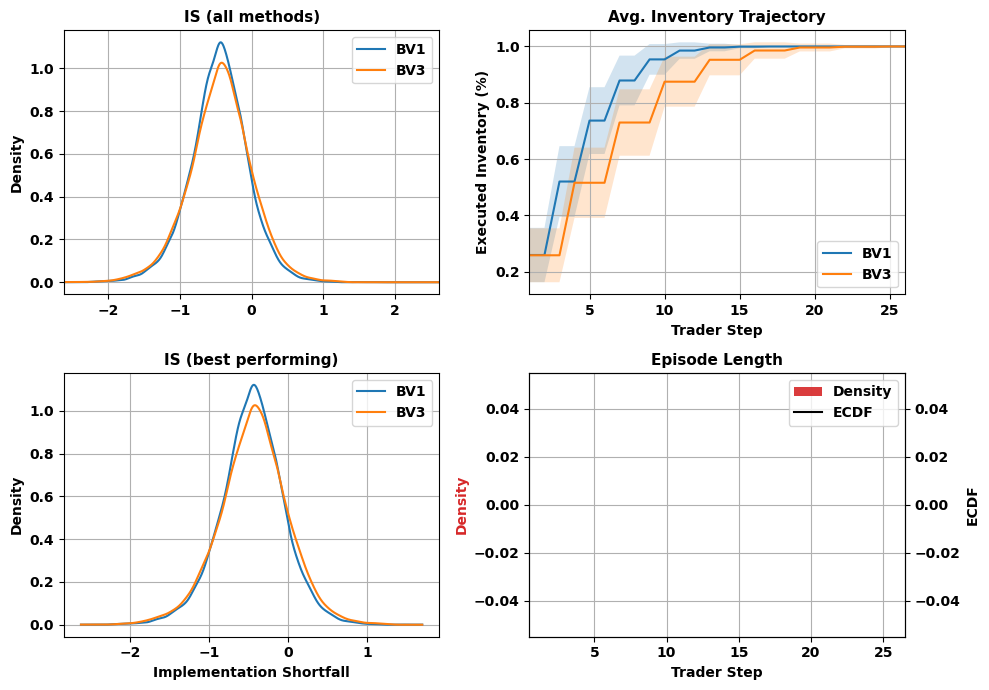

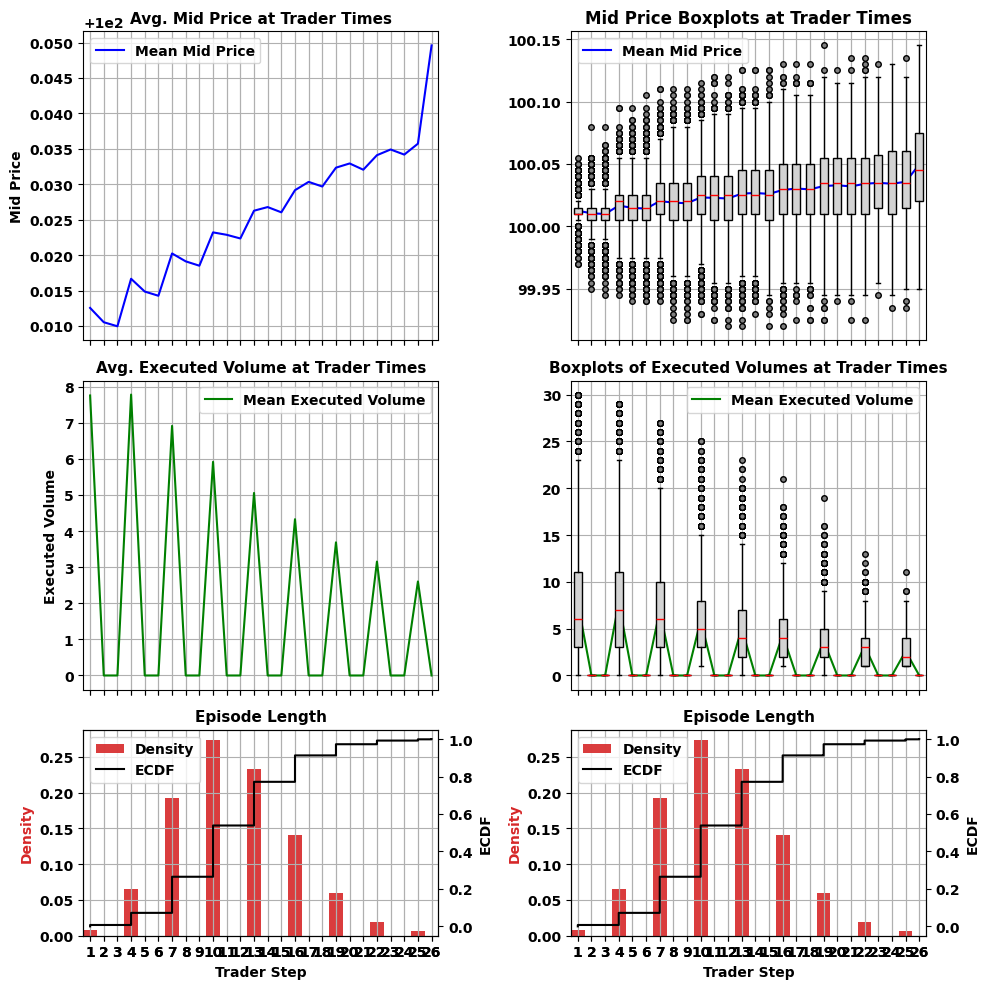

In [ ]:
run_id = 'T_78'
file_name = 'best_volume_3_T_78'

initial_inventory = 30
th = 78
tts = 3
trader_times_full = np.arange(0, th + tts, tts) 
trader_times = trader_times_full[1:]

types = ['best_volume', 'best_volume_3']
run_names = [f'{type}_{run_id}' for type in types]
run_labels = ['BV1', 'BV3']
best_labels = ['BV1', 'BV3']
pdf_name = 's_11_ddqns'
title = f'{run_id}'


plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels)


plot_run_analysis(file_name, trader_times_full)

## T = 10, TTS = 1, Inv=15

[BV1] IS: mean=-0.178, std=0.123 

[BV1] IS: mean=-0.178, std=0.123 

[BV1] 0.6850% of runs did not reach full inventory
    Missing volume: avg=2.74, std=1.73, max=9.00



c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


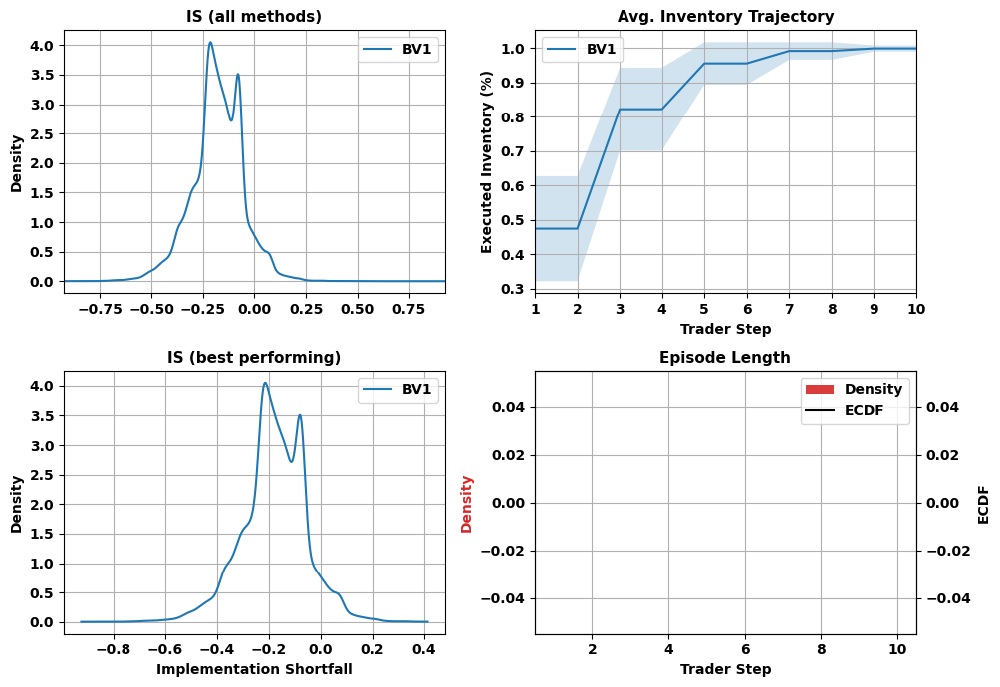

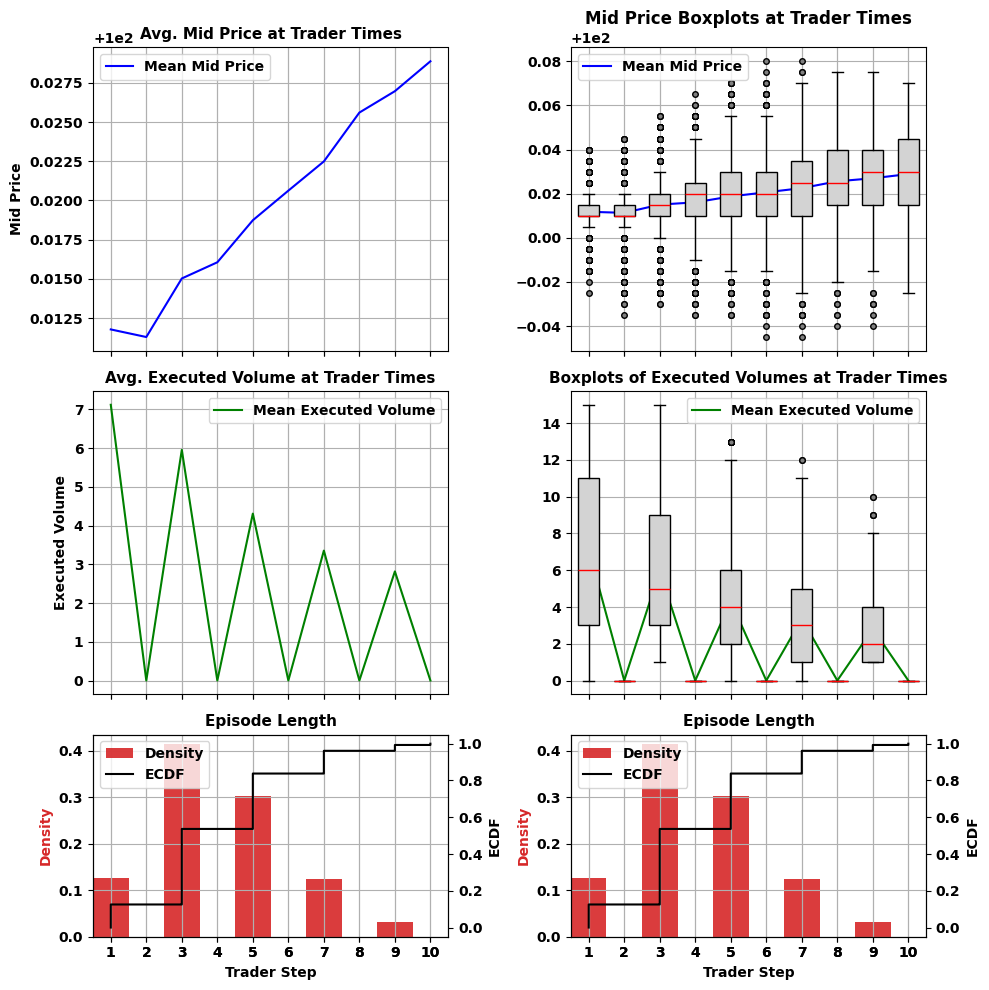

In [ ]:
run_id = 'T_10'
file_name = 'best_volume_T_10'

initial_inventory = 15
th = 10
tts = 1
trader_times_full = np.arange(0, th + tts, tts) 
trader_times = trader_times_full[1:]

types = ['best_volume']
run_names = [f'{type}_{run_id}' for type in types]
run_labels = ['BV1']
best_labels = ['BV1']
pdf_name = 's_11_ddqns'
title = f'{run_id}'


plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels)


plot_run_analysis(file_name, trader_times_full)

## T = 78, TTS = 6, Inv=25

[BV1] IS: mean=-0.316, std=0.377 

[BV1] IS: mean=-0.316, std=0.377 

[BV1] 0.6100% of runs did not reach full inventory
    Missing volume: avg=3.32, std=2.51, max=12.00



c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\numpy\lib\_histograms_impl.py:901: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


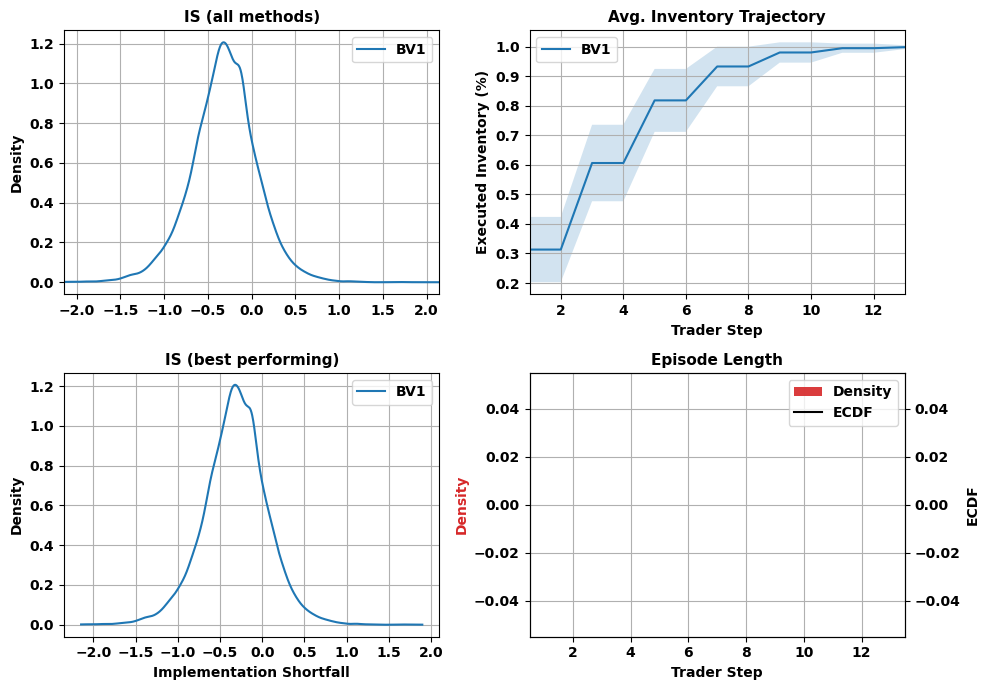

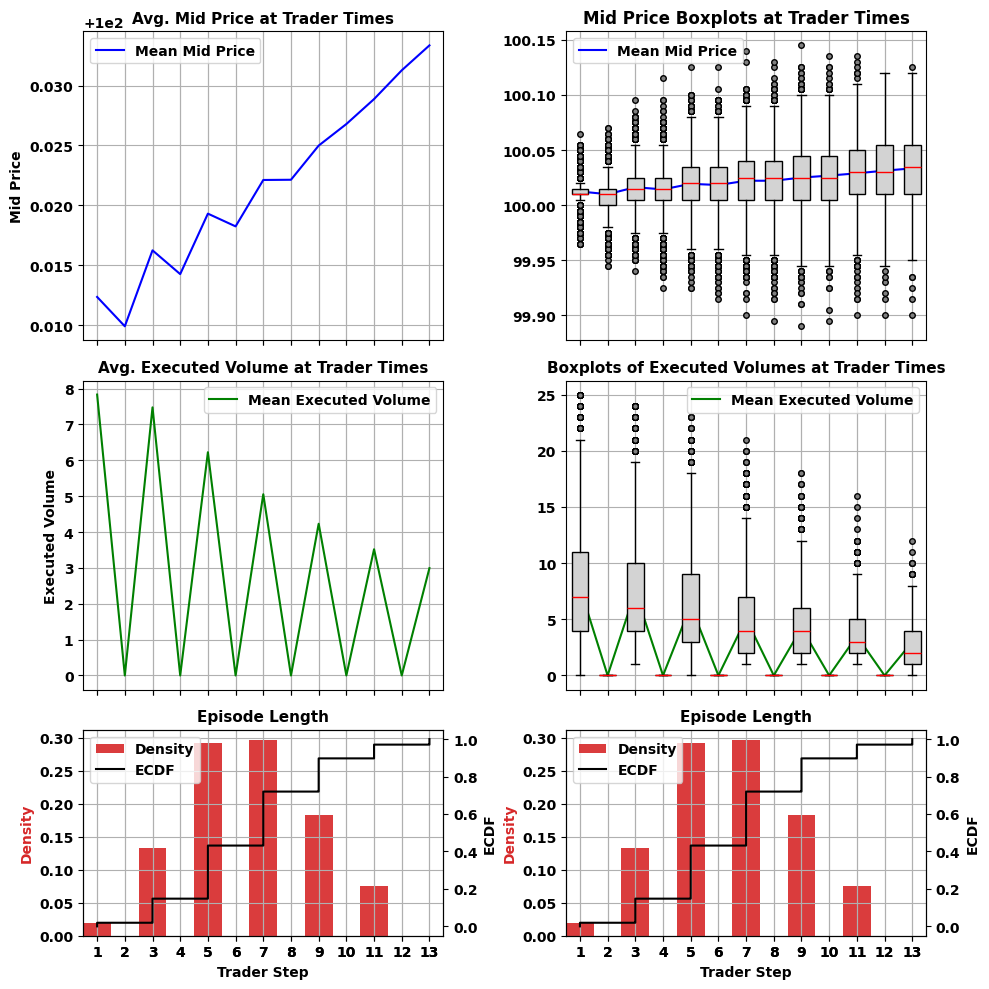

In [ ]:
run_id = 'T_ll'
file_name = 'best_volume_T_ll'

initial_inventory = 25
th = 78
tts = 6
trader_times_full = np.arange(0, th + tts, tts) 
trader_times = trader_times_full[1:]

types = ['best_volume']
run_names = [f'{type}_{run_id}' for type in types]
run_labels = ['BV1']
best_labels = ['BV1']
pdf_name = 's_11_ddqns'
title = f'{run_id}'


plot_overview(
    run_names,
    run_labels,
    initial_inventory,
    trader_times,
    title,
    metric='executed',
    kde_only=True, 
    best_labels=best_labels)


plot_run_analysis(file_name, trader_times_full)

### DDQN tx7ysrup

C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\2363283422.py:24: RuntimeWarning: Mean of empty slice
  mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\2363283422.py:25: RuntimeWarning: Mean of empty slice
  mean_executed = np.nanmean(arr_executed, axis=0)


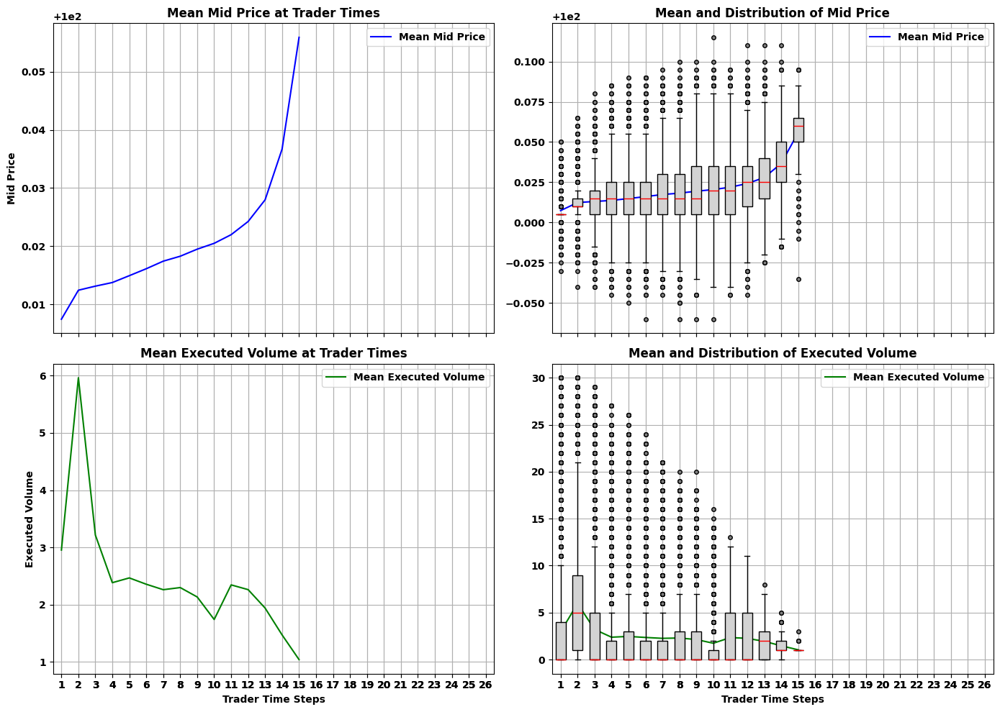

In [35]:
run_id = 'tx7ysrup'
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/ddqn_{run_id}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


NOTE: this seems pretty much like front loading... so its bad

### DDQN w8irrrky

C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\2794264883.py:24: RuntimeWarning: Mean of empty slice
  mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\2794264883.py:25: RuntimeWarning: Mean of empty slice
  mean_executed = np.nanmean(arr_executed, axis=0)


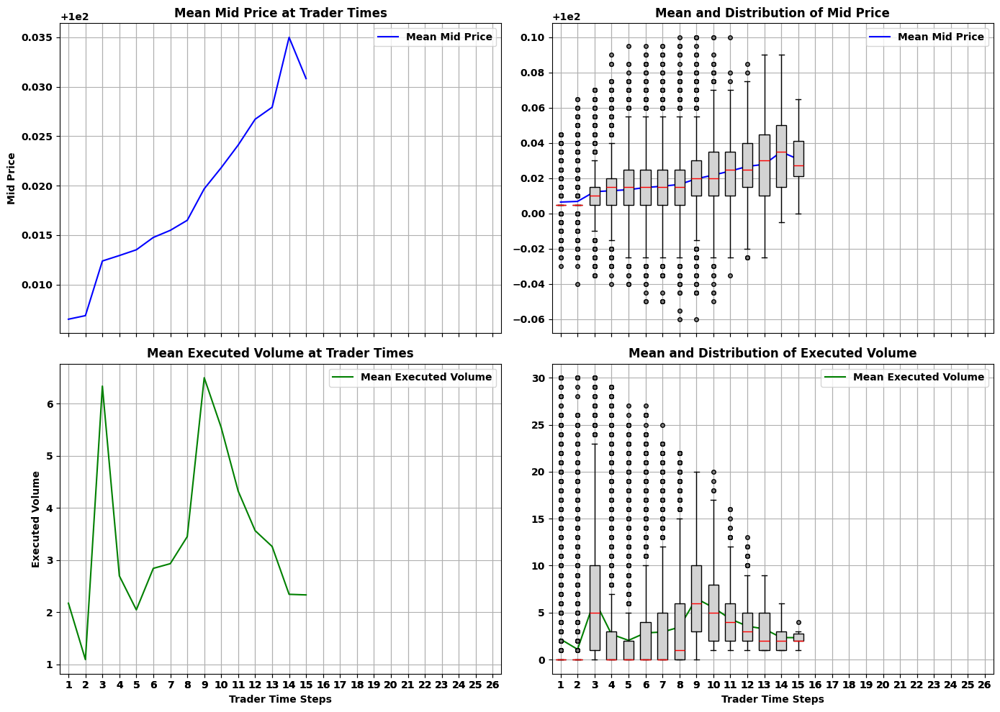

In [36]:
run_id = 'w8irrrky'
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/ddqn_{run_id}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


NOTE: already better... ! but does not execute at first time step !

### DDQN zxftmy9b

C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\1099663346.py:24: RuntimeWarning: Mean of empty slice
  mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\1099663346.py:25: RuntimeWarning: Mean of empty slice
  mean_executed = np.nanmean(arr_executed, axis=0)


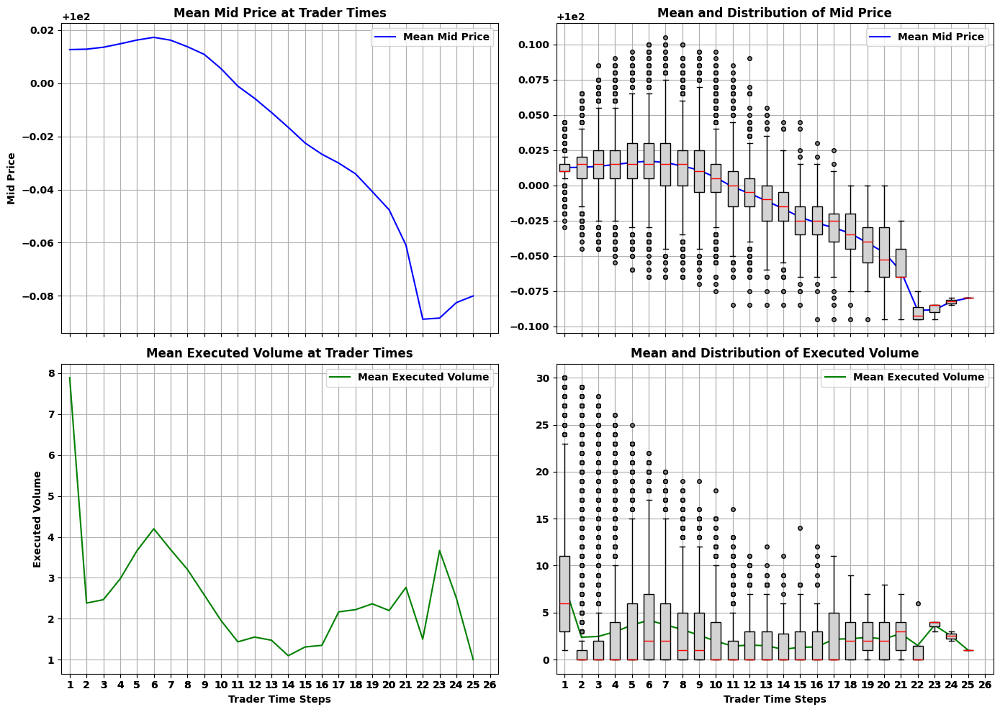

In [44]:
run_id = 'zxftmy9b'
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/ddqn_{run_id}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


NOTE: Executes at first time step, which is very good. This really seems to go in the good direction !

### DDQN 1dxwlv3l

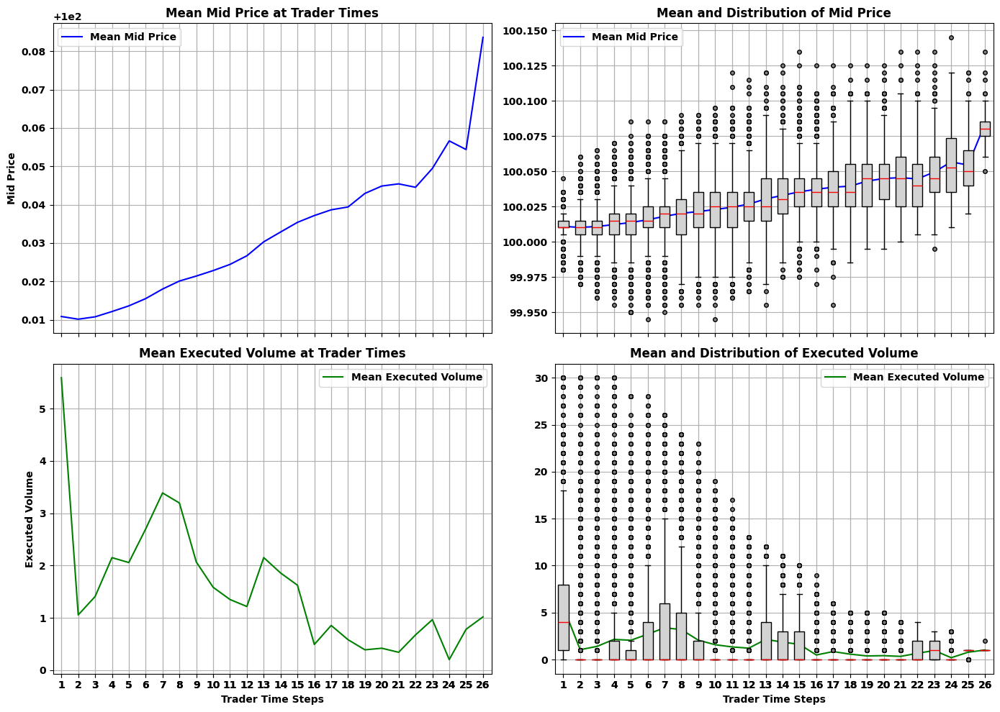

In [49]:
run_id = '1dxwlv3l'
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/ddqn_{run_id}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


NOTE: this is our best result. We see that it seems to learn to exeute a lot and then pause and then execute again. En terms of prices we see that the prices increase in average but not a lot. However, for the final time steps, the prices increase a lot. This means that the long trajectories correspond to the increasing trajectories: this is not good !

### DDQN ma1fyjnz

C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\922267660.py:24: RuntimeWarning: Mean of empty slice
  mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\922267660.py:25: RuntimeWarning: Mean of empty slice
  mean_executed = np.nanmean(arr_executed, axis=0)


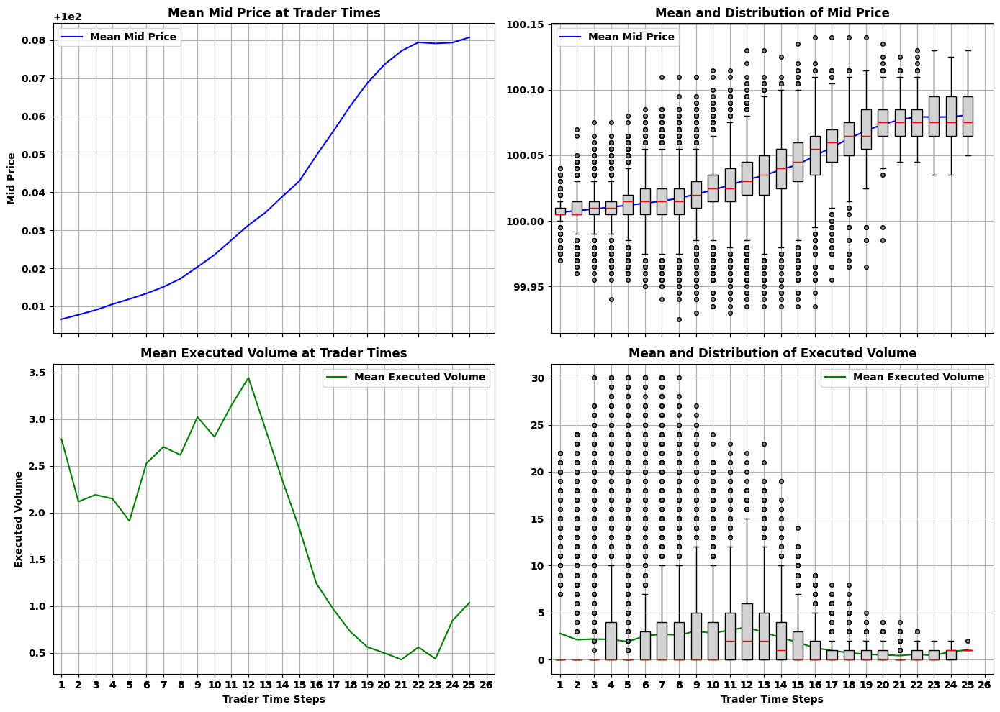

In [175]:
run_id = 'ma1fyjnz'
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/ddqn_{run_id}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


NOTE: Bad. 1) prices at the very right are very high: means that the longest episodes have increasing prices, we want the exact opposite. 2) First three steps it doesn't execute anything. 3) Price levels are same, a bit higher than those of BV3. Hypothesis: now that he observes the volume available, he only focuses on this and is waiting for huge volumes instead of 'smoothing' its impact in a consistent way like BV3. 

### DDQN ou984kkk

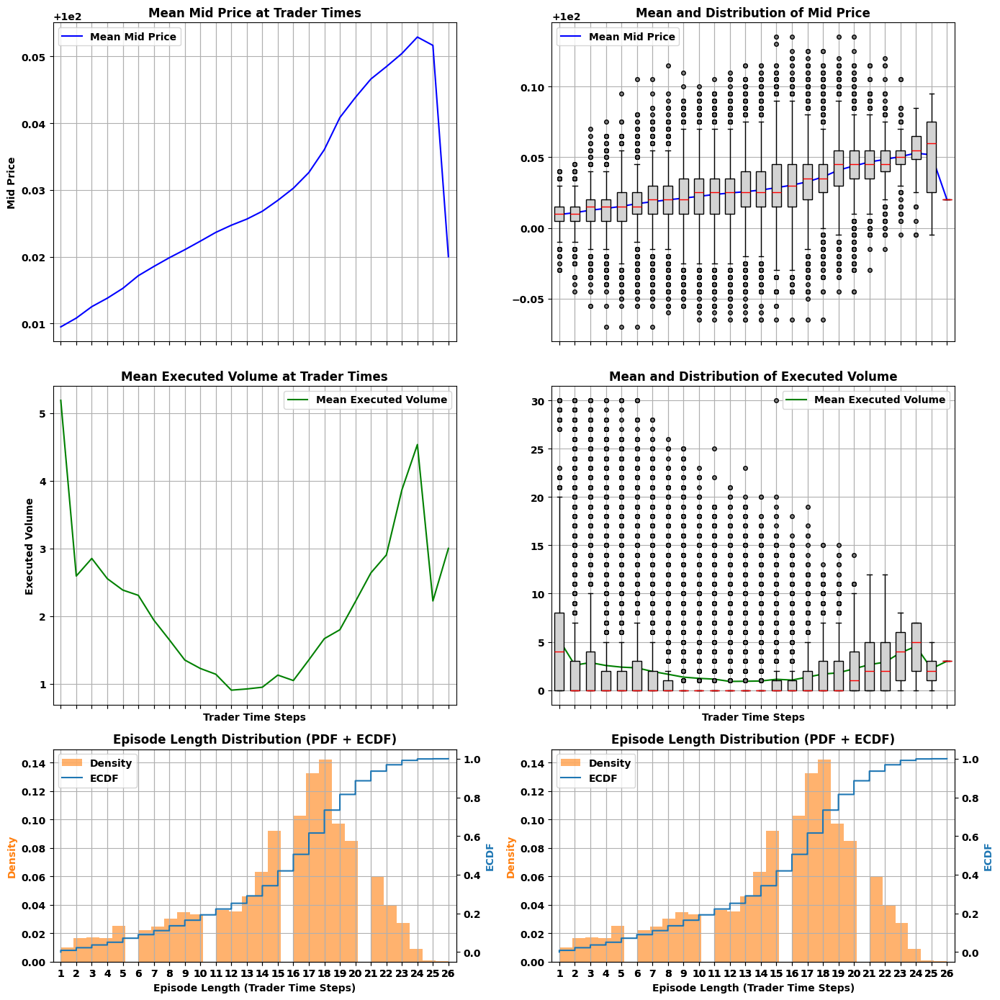

In [216]:
run_id = 'ou984kkk'
plot_run_analysis(run_id, trader_times)

NOTE: not sure what to really think about the strategy... but it performs very well and prices levels are beneath those of BV3 so good !

### DDQN nuy1one8

C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\1638963622.py:27: RuntimeWarning: Mean of empty slice
  mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\1638963622.py:28: RuntimeWarning: Mean of empty slice
  mean_executed = np.nanmean(arr_executed, axis=0)


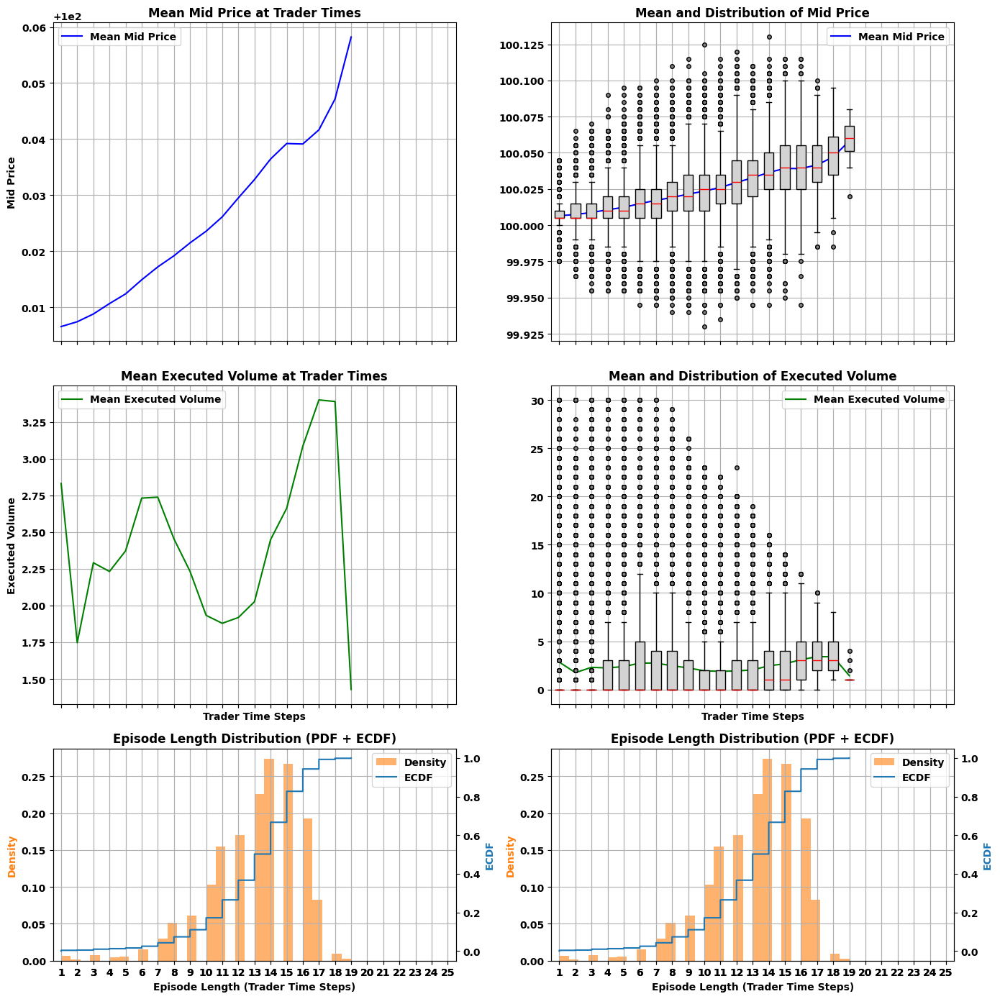

In [219]:
run_id = 'nuy1one8'
plot_run_analysis(run_id, trader_times)

NOTE: not bad at all in terms of price levels but does not execute at the very first time steps !! 

### DDQN fahbzybi

C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\1638963622.py:27: RuntimeWarning: Mean of empty slice
  mean_mid_prices = np.nanmean(arr_mid_prices, axis=0)
C:\Users\etoma\AppData\Local\Temp\ipykernel_17656\1638963622.py:28: RuntimeWarning: Mean of empty slice
  mean_executed = np.nanmean(arr_executed, axis=0)


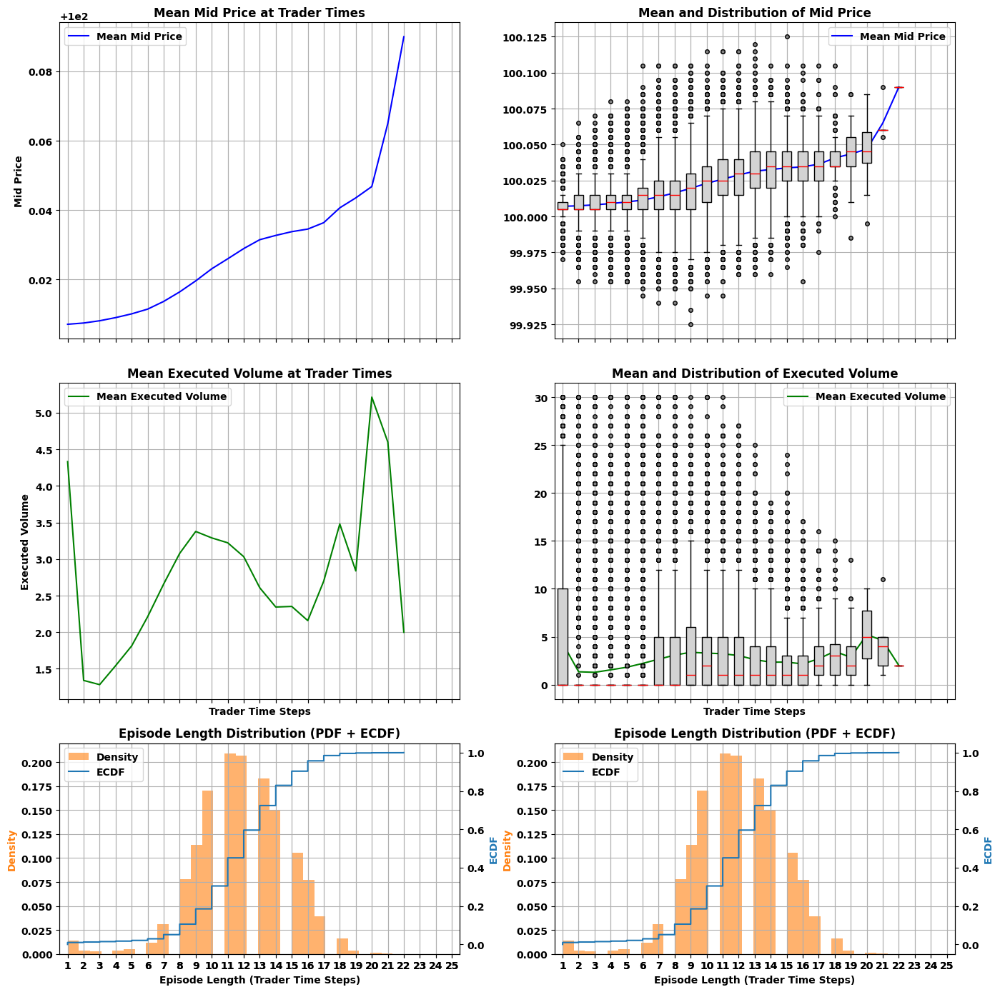

In [222]:
run_id = 'fahbzybi'
plot_run_analysis(run_id, trader_times)

NOTE: price levels are extremely good and he executes at the beginning. Maybe not enough though... but very good. 

### DDQN qy1rlvex

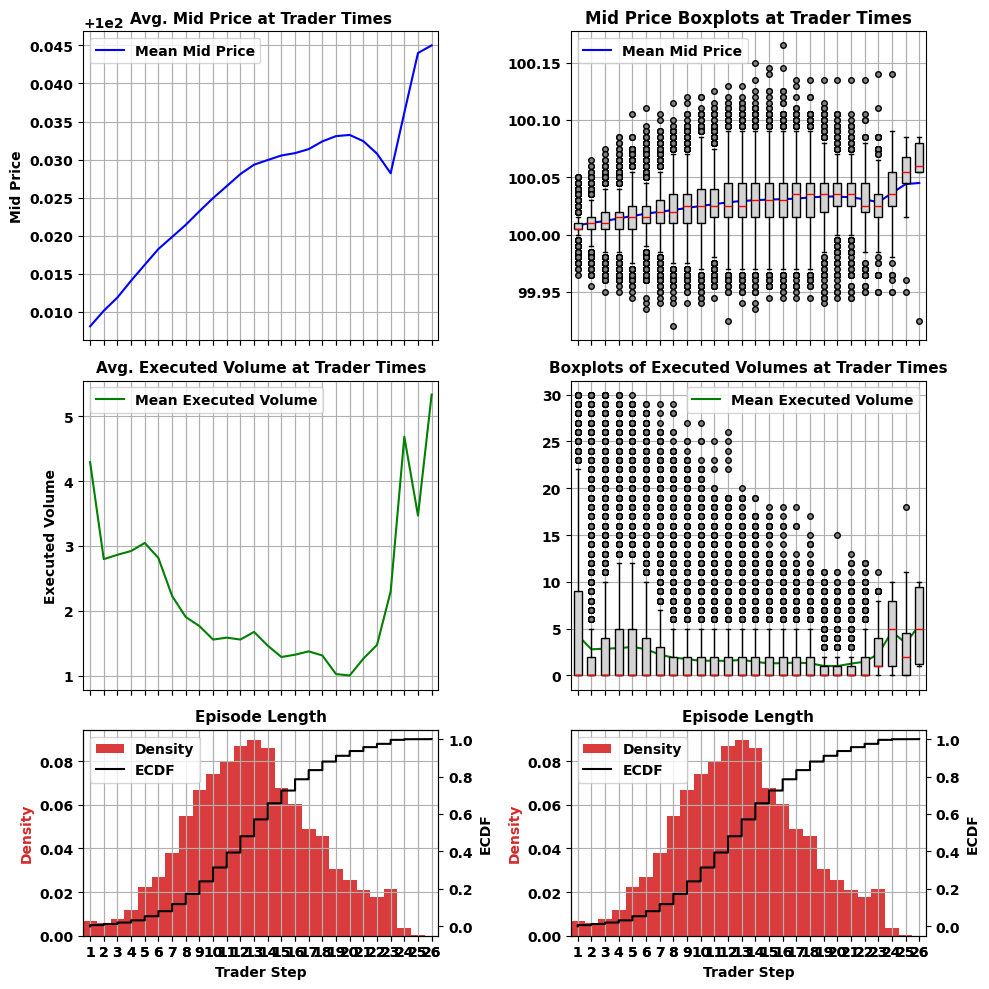

In [58]:
run_id = 'ddqn_qy1rlvex'
plot_run_analysis(run_id, trader_times_full)

NOTE: Price Level is excellent ! And executes at the beginning ! 

# $\theta$ interpretation

### $\theta = 0.85$

In [97]:
T = 78
trader_time_step = 3
name_run = 'theta_85'

#### BV4

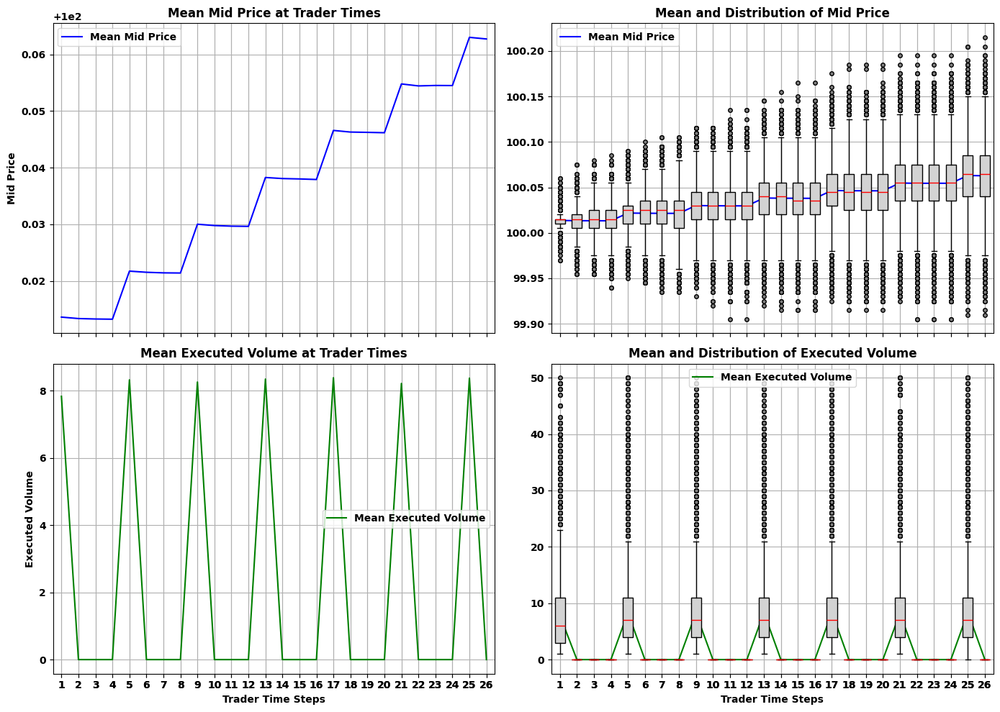

In [98]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_4_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv4_theta_85 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv4_theta_85, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv4_theta_85, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


### $\theta = 0.6$

In [99]:
T = 78
trader_time_step = 3
name_run = 'theta_6'

#### BV4

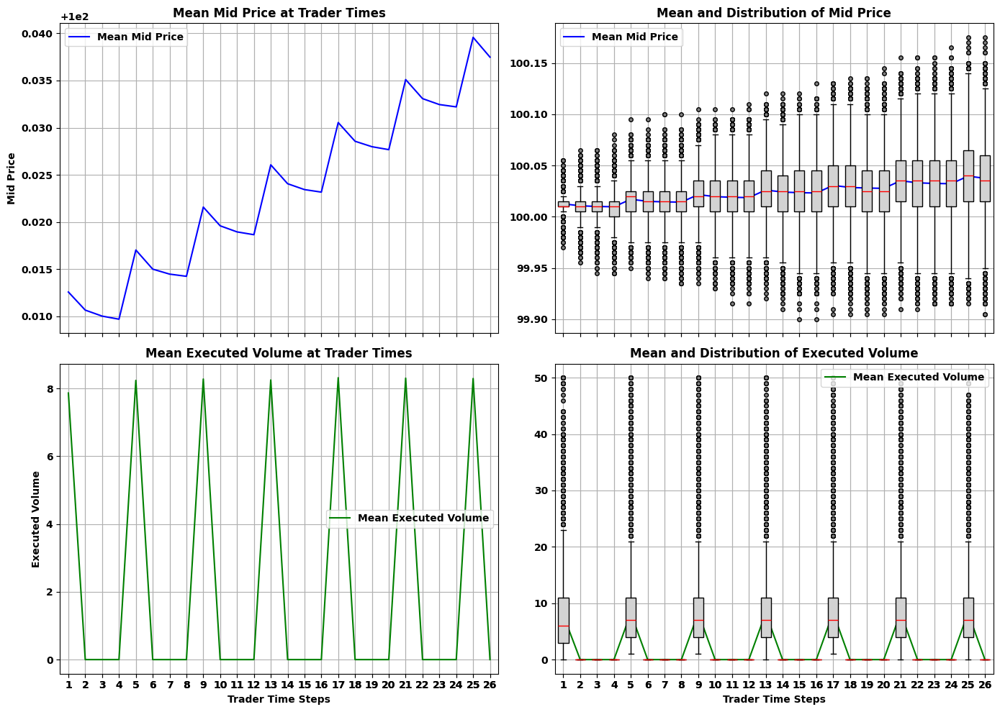

In [100]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_4_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv4_theta_6 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv4_theta_6, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv4_theta_6, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


### $\theta = 1.0$

In [103]:
T = 78
trader_time_step = 3
name_run = 'theta_1'

#### BV4

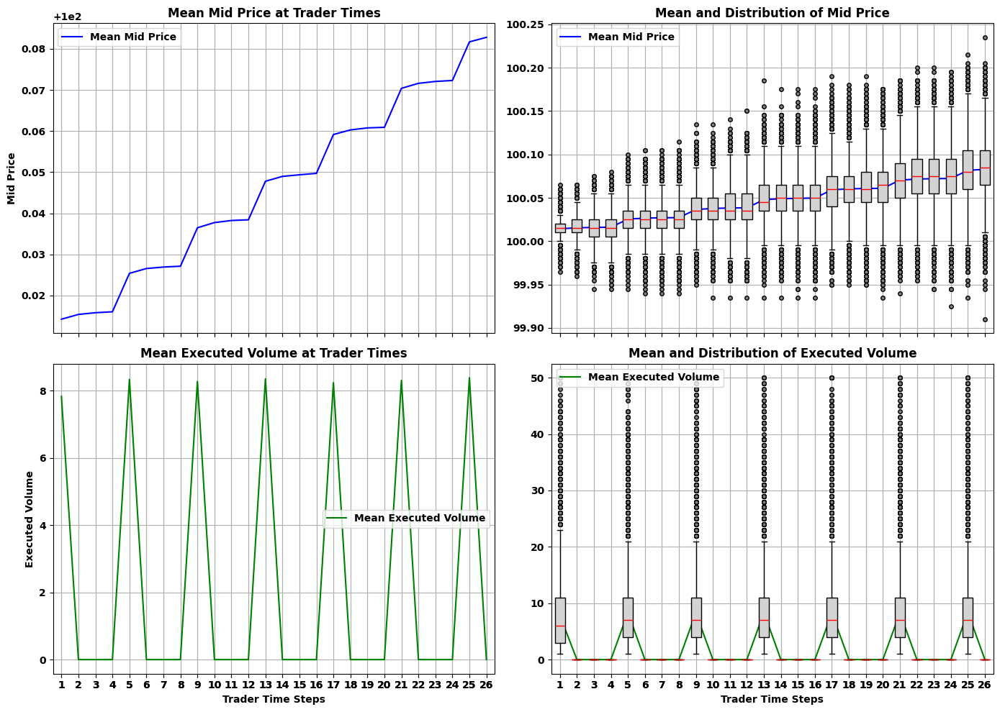

In [104]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_4_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv4_theta_1 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv4_theta_1, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv4_theta_1, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


### $\theta = 0.25$

In [105]:
T = 78
trader_time_step = 3
name_run = 'theta_25'

#### BV4

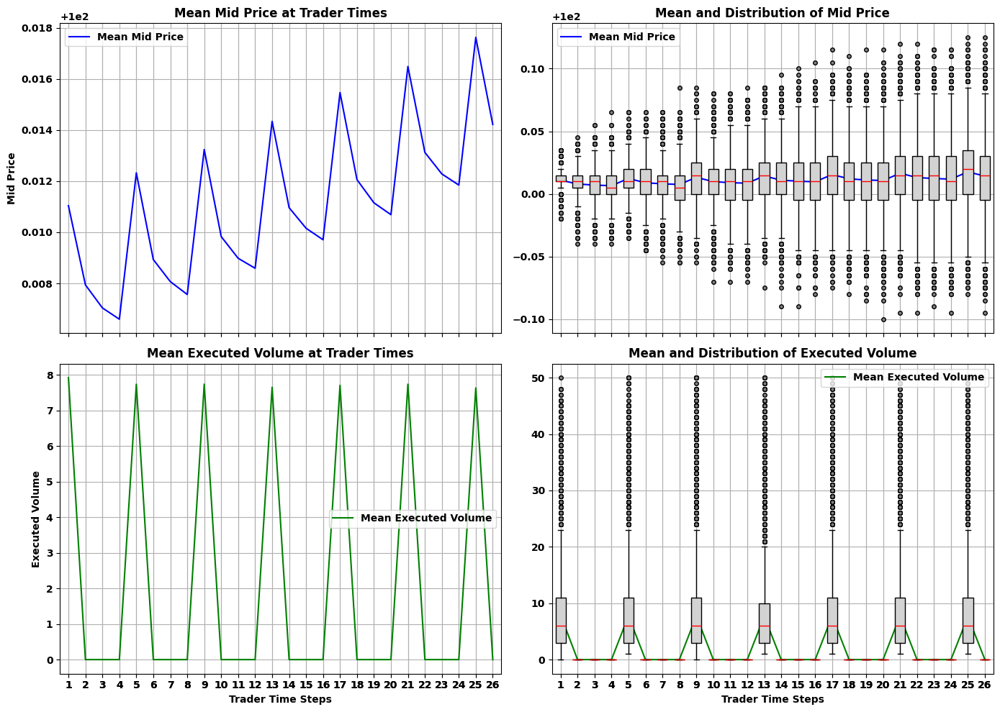

In [106]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_4_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv4_theta_25 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv4_theta_25, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv4_theta_25, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


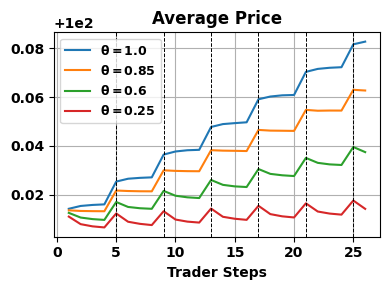

In [107]:
# --- 4. BV4 ---
plt.figure(figsize=(4, 3))
plt.plot(x_vals, mean_mid_prices_bv4_theta_1, label=r'$\mathbf{\theta}=1.0$')
plt.plot(x_vals, mean_mid_prices_bv4_theta_85, label=r'$\mathbf{\theta}=0.85$')
plt.plot(x_vals, mean_mid_prices_bv4_theta_6, label=r'$\mathbf{\theta}=0.6$')
plt.plot(x_vals, mean_mid_prices_bv4_theta_25, label=r'$\mathbf{\theta}=0.25$')
plt.title('Average Price')
for i in range(1, 7):
    plt.axvline(1+i*4, color='k', linestyle='--', linewidth=0.7)
plt.xlabel('Trader Steps')
plt.grid()
plt.legend(fontsize=9)
plt.tight_layout()
plt.savefig(f'theta_reinit.pdf', bbox_inches='tight')
plt.show()

In [88]:
1/1.15

0.8695652173913044

### $\theta = 0.25$ & $\theta^{\text{reinit}} = 1.0$

In [108]:
T = 78
trader_time_step = 3
name_run = 'theta_25_tr_1'

#### BV4

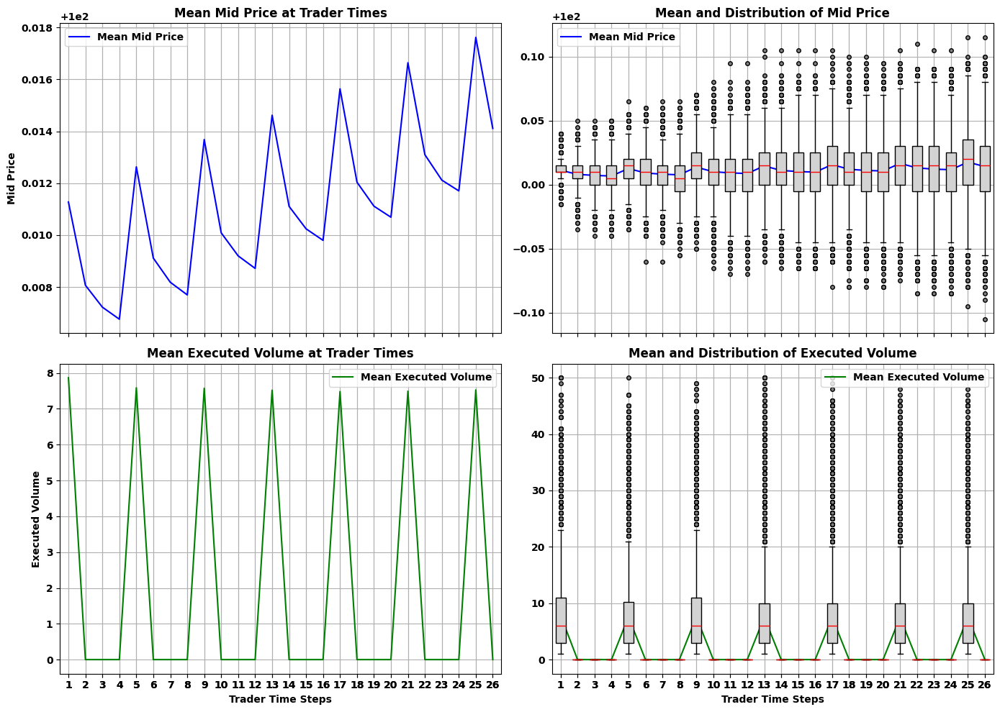

In [109]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_4_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv4_theta_25 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv4_theta_25, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv4_theta_25, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


### $\theta = 1.0$ & $\theta^{\text{reinit}}=0.05$

In [53]:
T = 78
trader_time_step = 3
name_run = 't_1_tr_05'

#### BV4

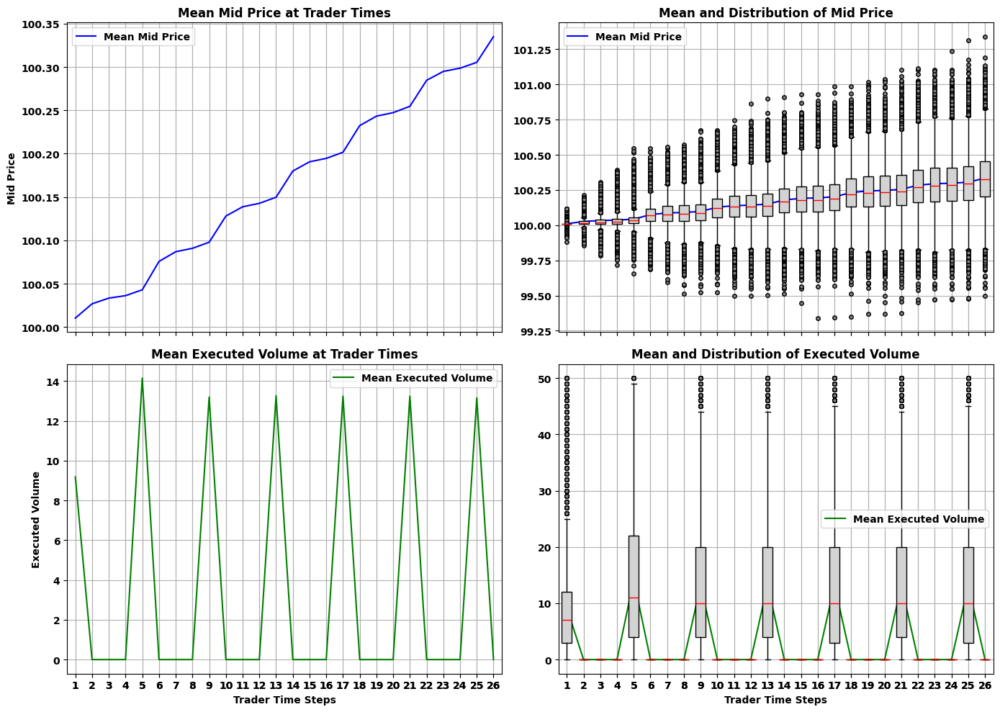

In [54]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_4_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv4_theta_1_tr_05 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv4_theta_1_tr_05, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv4_theta_1_tr_05, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


### $\theta = 0.85$ & $\theta^{\text{reinit}}=0.05$

In [48]:
T = 78
trader_time_step = 3
name_run = 't_85_tr_05'

#### BV4

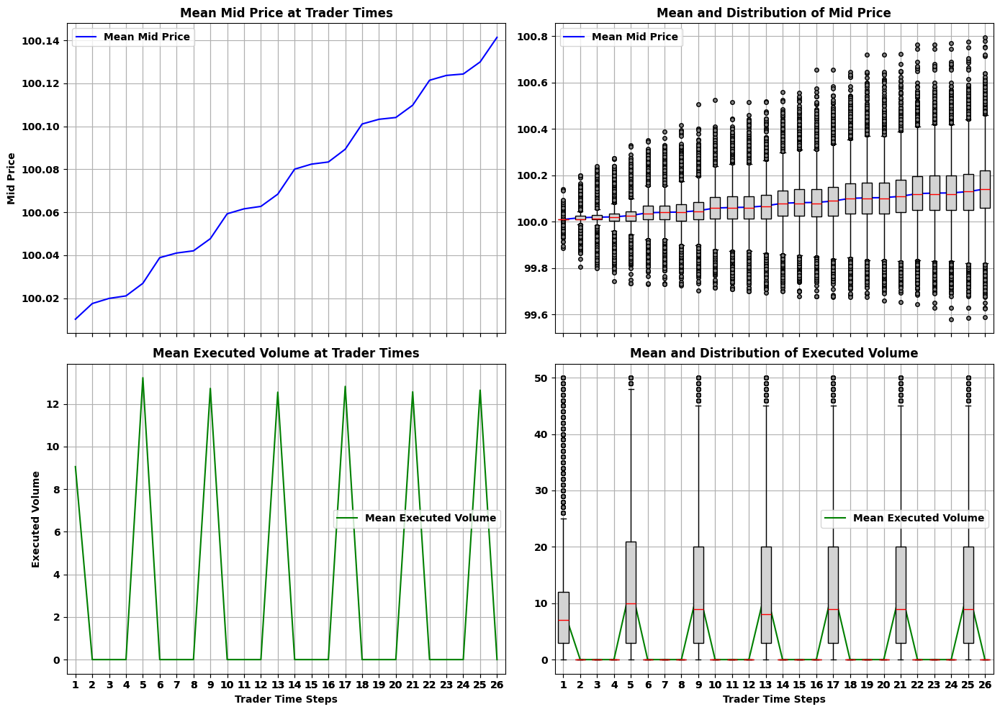

In [49]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_4_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv4_theta_85_tr_05 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv4_theta_85_tr_05, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv4_theta_85_tr_05, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


### $\theta = 0.6$ & $\theta^{\text{reinit}}=0.05$

In [43]:
T = 78
trader_time_step = 3
name_run = 't_6_tr_05'

#### BV4

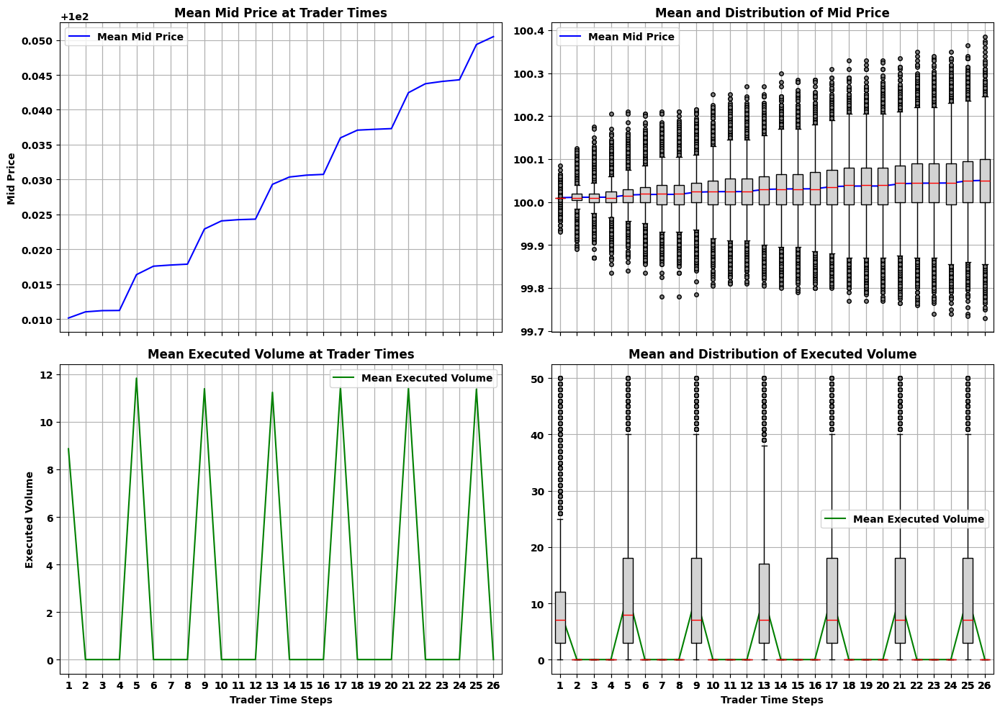

In [44]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_4_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv4_theta_6_tr_05 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv4_theta_6_tr_05, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv4_theta_6_tr_05, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


### $\theta = 0.25$ & $\theta^{\text{reinit}}=0.05$

In [41]:
T = 78
trader_time_step = 3
name_run = 't_25_tr_05'

#### BV4

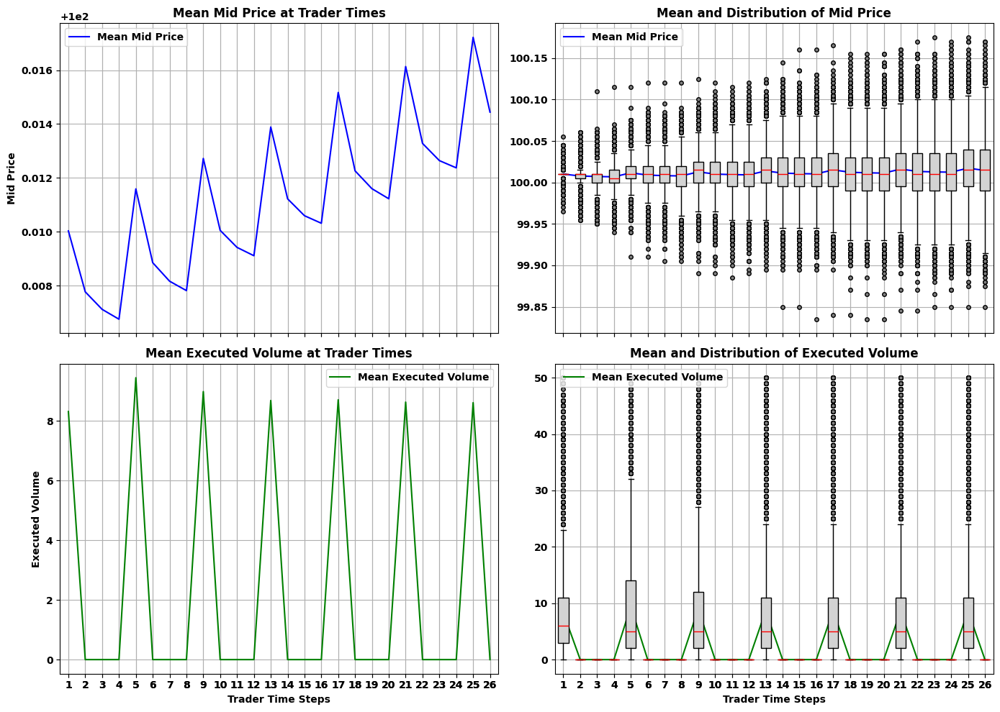

In [42]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_4_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv4_theta_25_tr_05 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv4_theta_25_tr_05, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv4_theta_25_tr_05, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


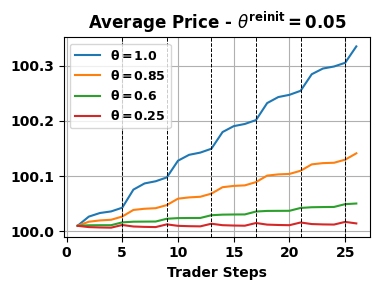

In [55]:
# --- 4. BV4 ---
plt.figure(figsize=(4, 3))
plt.plot(x_vals, mean_mid_prices_bv4_theta_1_tr_05, label=r'$\mathbf{\theta}=1.0$')
plt.plot(x_vals, mean_mid_prices_bv4_theta_85_tr_05, label=r'$\mathbf{\theta}=0.85$')
plt.plot(x_vals, mean_mid_prices_bv4_theta_6_tr_05, label=r'$\mathbf{\theta}=0.6$')
plt.plot(x_vals, mean_mid_prices_bv4_theta_25_tr_05, label=r'$\mathbf{\theta}=0.25$')
plt.title(r'Average Price - $\theta^{\text{reinit}}=0.05$')
for i in range(1, 7):
    plt.axvline(1+i*4, color='k', linestyle='--', linewidth=0.7)
plt.xlabel('Trader Steps')
plt.grid()
plt.legend(fontsize=9)
plt.tight_layout()
plt.savefig(f'theta_reinit.pdf', bbox_inches='tight')
plt.show()

In [56]:
run_name = 'best_volume_4_test_t_1_tr_05'
with open(f'data_wandb/dictionaries/{run_name}.pkl', 'rb') as f:
    dic = pickle.load(f)

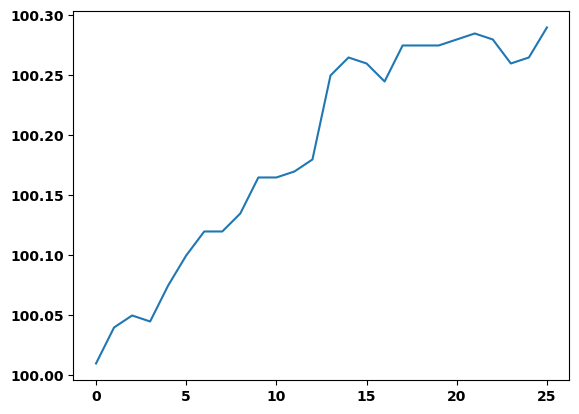

In [70]:
plt.plot(dic['mid_prices_events'][4])

In [68]:
lob = dic['lob'][4]

import pandas as pd
trader_indices = lob.index[lob['event'] == 'trader']
rows_to_include = set()
for idx in trader_indices:
    rows_to_include.update(range(max(0, idx - 3), min(len(lob), idx + 4)))
lob_filtered = lob.loc[sorted(rows_to_include)]

In [72]:
lob.iloc[13:55]

,time,p_mid,p_ref,side,depth,event,redrawn,q_bid3,q_bid2,q_bid1,q_ask1,q_ask2,q_ask3
13,3.227220,100.010002,100.014999,bid,3,cancel,False,17,0,0,0,9,20
14,3.317475,100.014999,100.025002,bid,2,limit,False,1,0,0,11,20,34
15,3.484049,100.014999,100.025002,ask,2,limit,False,1,0,0,11,21,34
16,3.538193,100.029999,100.035004,bid,1,limit,False,0,1,0,27,34,22
17,3.804917,100.029999,100.035004,ask,1,limit,False,0,1,0,28,34,22
18,3.809827,100.029999,100.035004,bid,2,limit,False,0,2,0,28,34,22
19,3.892754,100.029999,100.035004,ask,1,cancel,False,0,2,0,27,34,22
20,4.123223,100.040001,100.044998,bid,1,limit,False,2,1,0,43,22,18
21,4.314122,100.040001,100.044998,ask,1,cancel,False,2,1,0,42,22,18
22,4.384718,100.040001,100.044998,ask,1,limit,False,2,1,0,43,22,18


In [71]:
lob_filtered.iloc[:50]

,time,p_mid,p_ref,side,depth,event,redrawn,q_bid3,q_bid2,q_bid1,q_ask1,q_ask2,q_ask3
9,2.557893,100.004997,100.004997,ask,2,cancel,False,11,18,0,0,12,8
10,2.823481,100.004997,100.004997,ask,3,limit,False,11,18,0,0,12,9
11,2.895594,100.004997,100.004997,bid,3,cancel,False,10,18,0,0,12,9
12,3.000000,100.010002,100.014999,ask,12,trader,False,18,0,0,0,9,20
13,3.227220,100.010002,100.014999,bid,3,cancel,False,17,0,0,0,9,20
14,3.317475,100.014999,100.025002,bid,2,limit,False,1,0,0,11,20,34
15,3.484049,100.014999,100.025002,ask,2,limit,False,1,0,0,11,21,34
33,5.927711,100.040001,100.044998,bid,3,limit,False,4,2,0,43,23,5
34,5.935461,100.040001,100.044998,bid,3,cancel,False,3,2,0,43,23,5
35,5.962542,100.040001,100.044998,bid,2,limit,False,3,3,0,43,23,5


# $\theta^{\text{reinit}}$ interpretation: permanent and transient market impact

## T = 10, TTS = 1 (Inv=1000)

## $\theta^{\text{reinit}} = 1.0$

In [57]:
T = 60
trader_time_step = 3
name_run = 'tr_1'

#### BV4

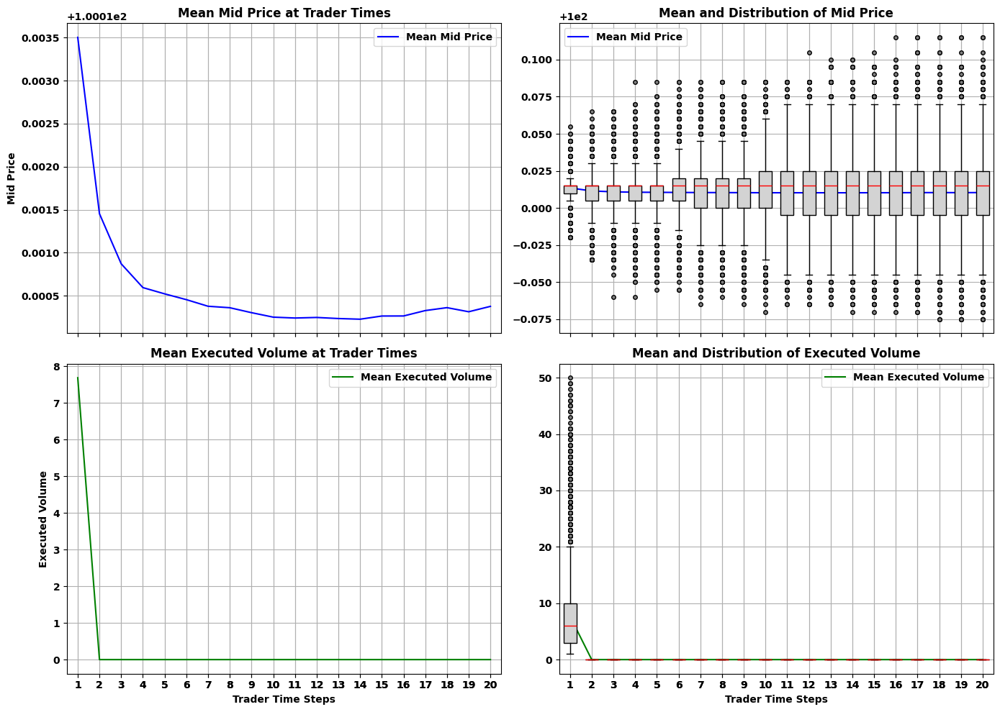

In [58]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_20_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv4_1 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv4_1, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv4_1, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


## $\theta^{\text{reinit}} = 0.85$

In [27]:
T = 60
trader_time_step = 3
name_run = 'tr_85'

#### BV4

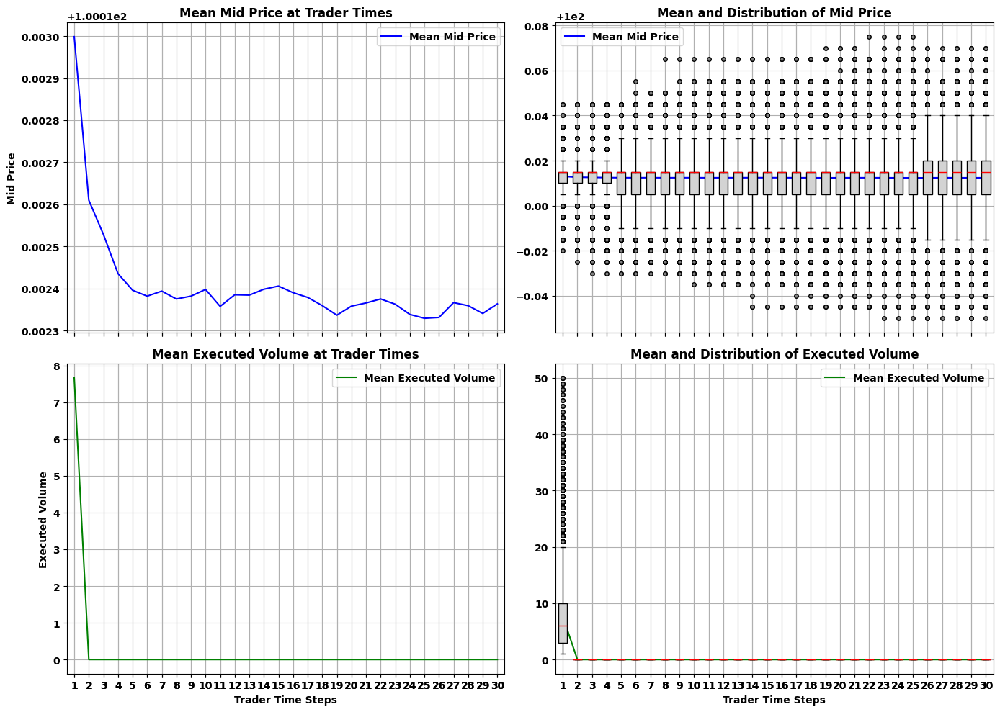

In [28]:
T = 60
trader_time_step = 3
name_run = 'tr_85'

trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_30_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv4 = np.nanmean(arr_mid_prices, axis=0)

### $\theta^{\text{reinit}} = 0.5$

In [29]:
T = 60
trader_time_step = 3
name_run = 'tr_5'

#### BV4

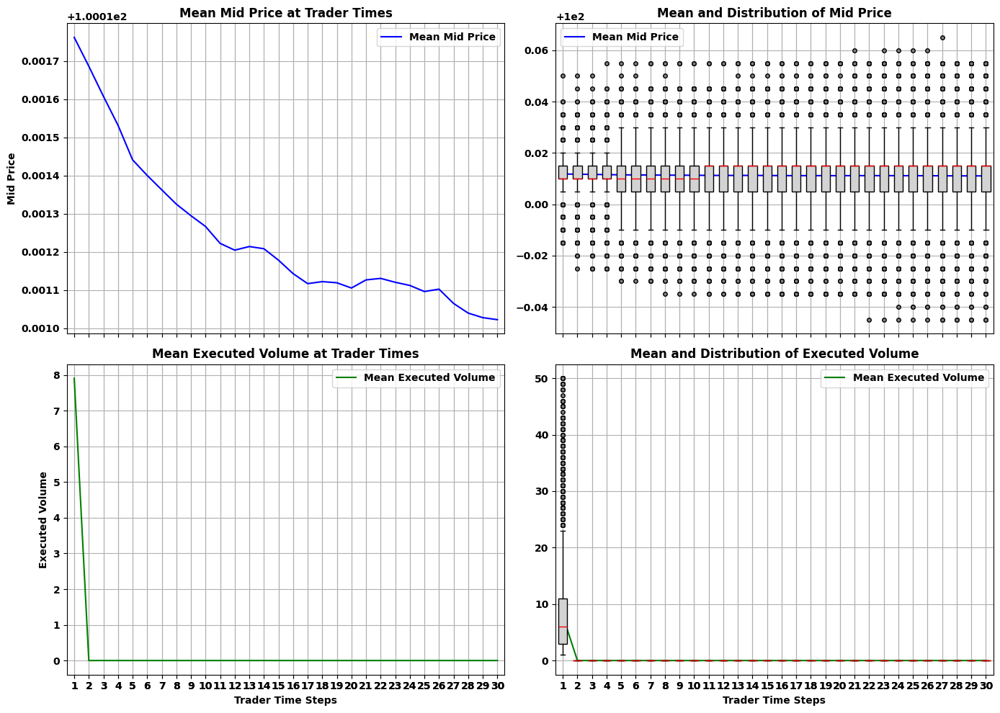

In [30]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_30_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv4_5 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv4_5, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv4_5, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


### $\theta^{\text{reinit}} = 0.25$

In [67]:
T = 60
trader_time_step = 3
name_run = 'tr_25'

#### BV4

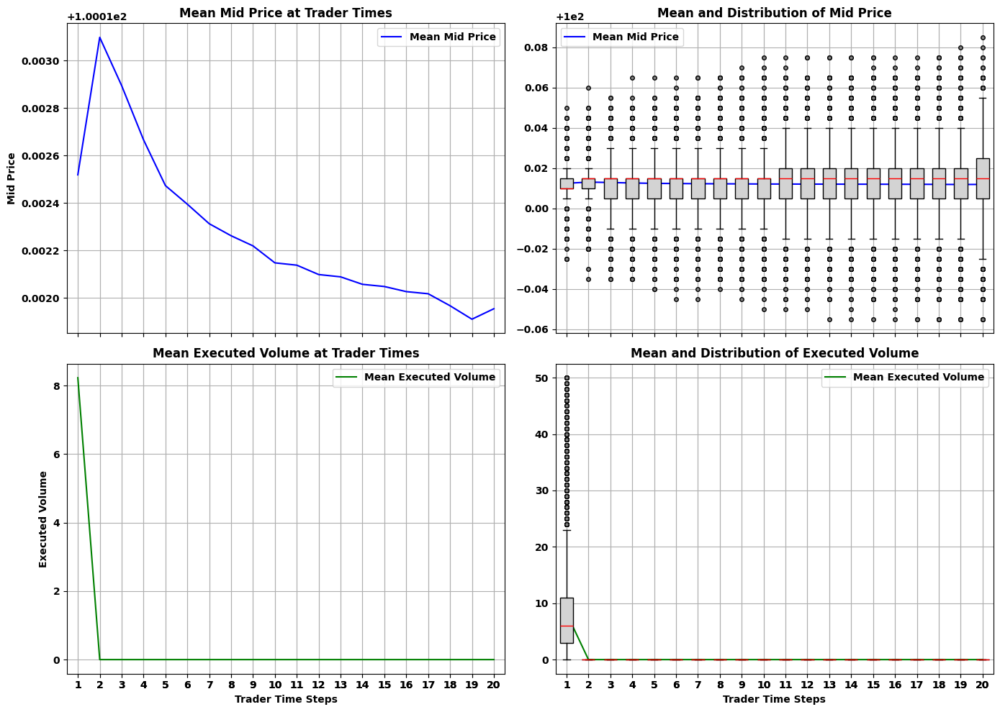

In [68]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_20_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv4_25 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv4_25, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv4_25, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


### $\theta^{\text{reinit}}$ put together

3 second steps

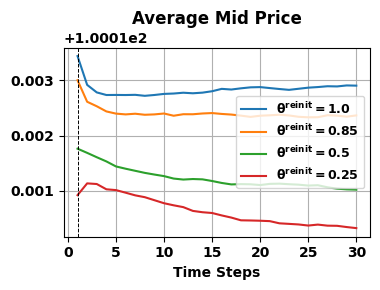

In [35]:
# --- 4. BV4 ---
plt.figure(figsize=(4, 3))
plt.plot(x_vals, mean_mid_prices_bv4_1, label=r'$\mathbf{\theta}^{\text{reinit}}=1.0$')
plt.plot(x_vals, mean_mid_prices_bv4, label=r'$\mathbf{\theta}^{\text{reinit}}=0.85$')
plt.plot(x_vals, mean_mid_prices_bv4_5, label=r'$\mathbf{\theta}^{\text{reinit}}=0.5$')
plt.plot(x_vals, mean_mid_prices_bv4_25, label=r'$\mathbf{\theta}^{\text{reinit}}=0.25$')
# plt.plot(x_vals, mean_mid_prices_bv4_05, label=r'$\mathbf{\theta}^{\text{reinit}}=0.05$')
plt.title('Average Mid Price')
for i in range(1):
    plt.axvline(1+i*4, color='k', linestyle='--', linewidth=0.7)
plt.xlabel('Time Steps')
plt.grid()
plt.legend(fontsize=9)
plt.tight_layout()
plt.savefig(f'./plots/theta_reinit.pdf', bbox_inches='tight')
plt.show()

## T = 78, TTS = 3 (Inv=1000)

### $\theta^{\text{reinit}} = 1.0$

In [ ]:
T = 78
trader_time_step = 3
name_run = 'tr_1'

#### BV4

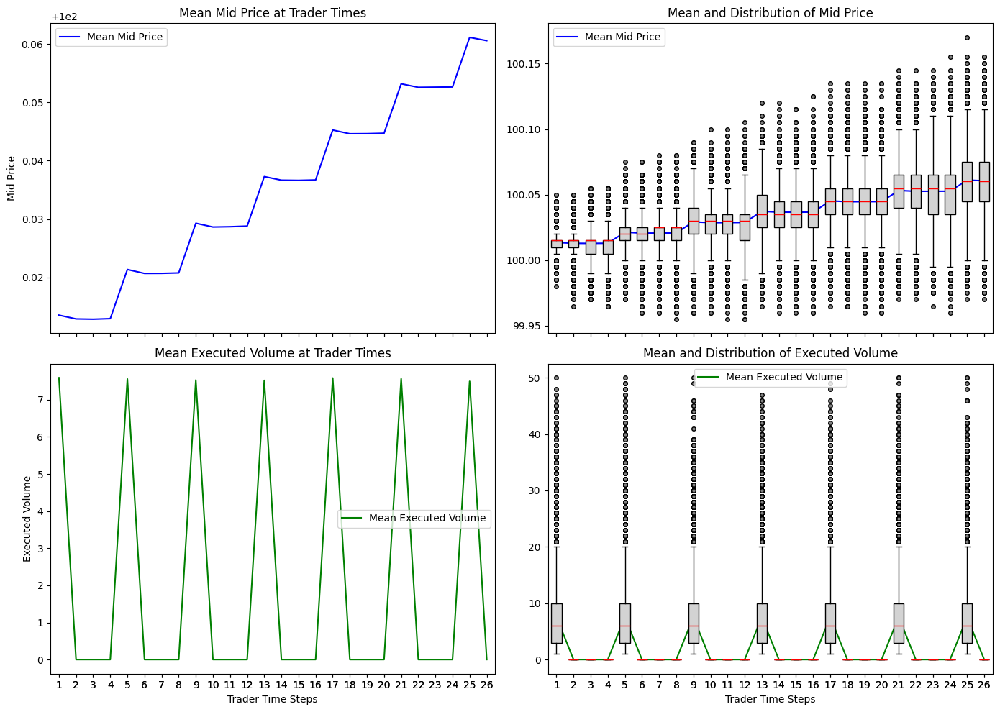

In [3]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/best_volume_4_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv4_1 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv4_1, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv4_1, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


### $\theta^{\text{reinit}} = 0.85$

In [4]:
T = 78
trader_time_step = 3
name_run = 'tr_85'

#### Front Load

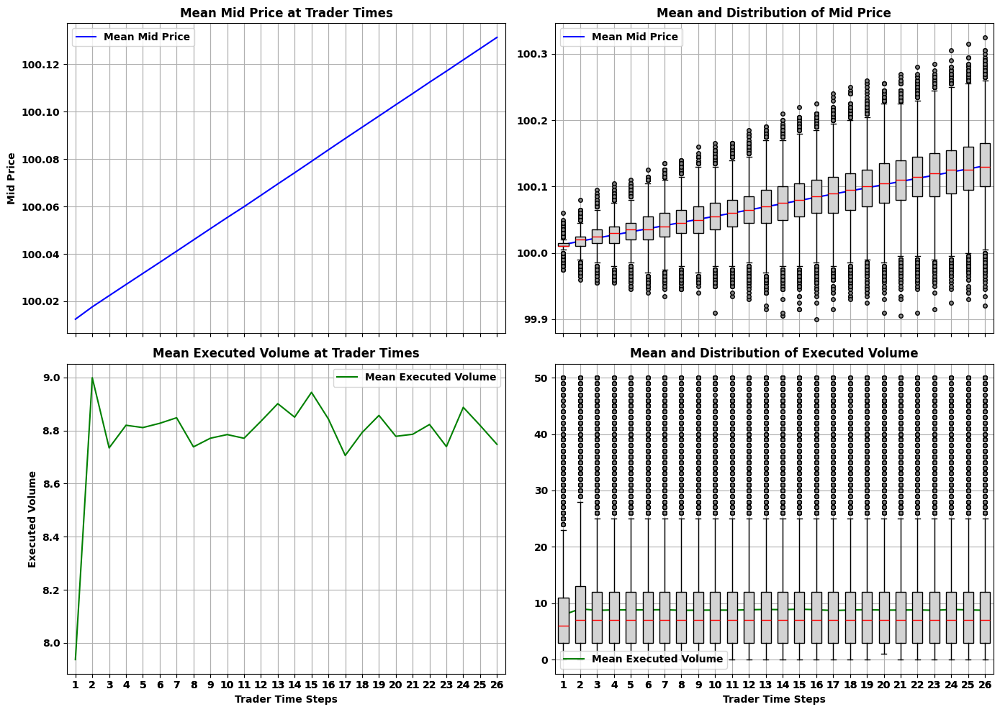

In [49]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/front_load_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_fl = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_fl, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_fl, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


#### BV2

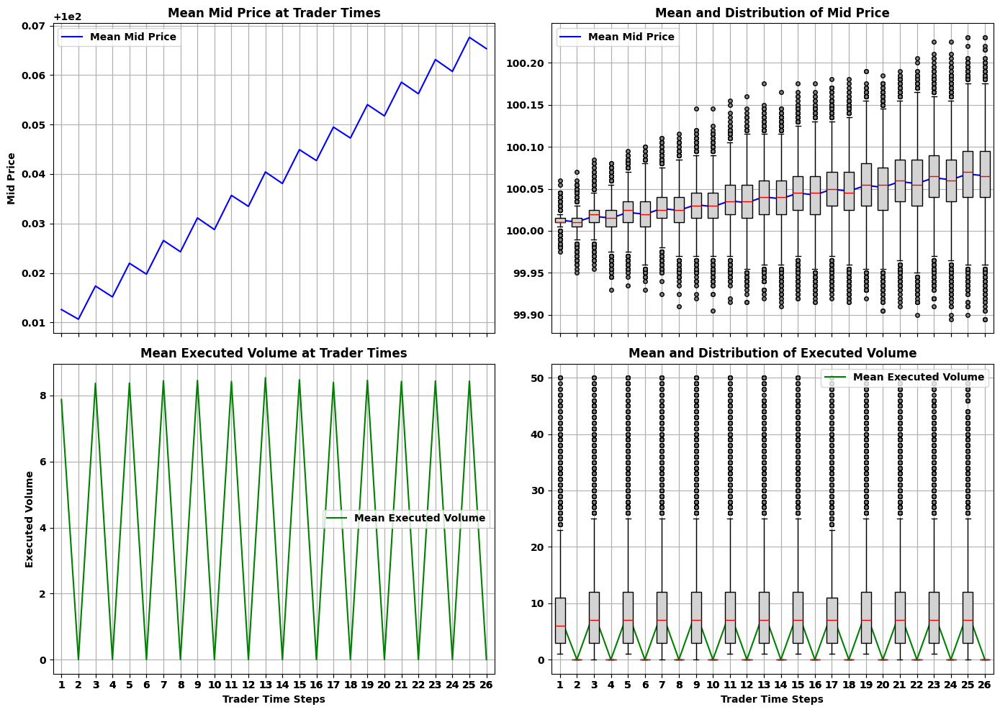

In [50]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv2 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv2, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv2, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


#### BV3

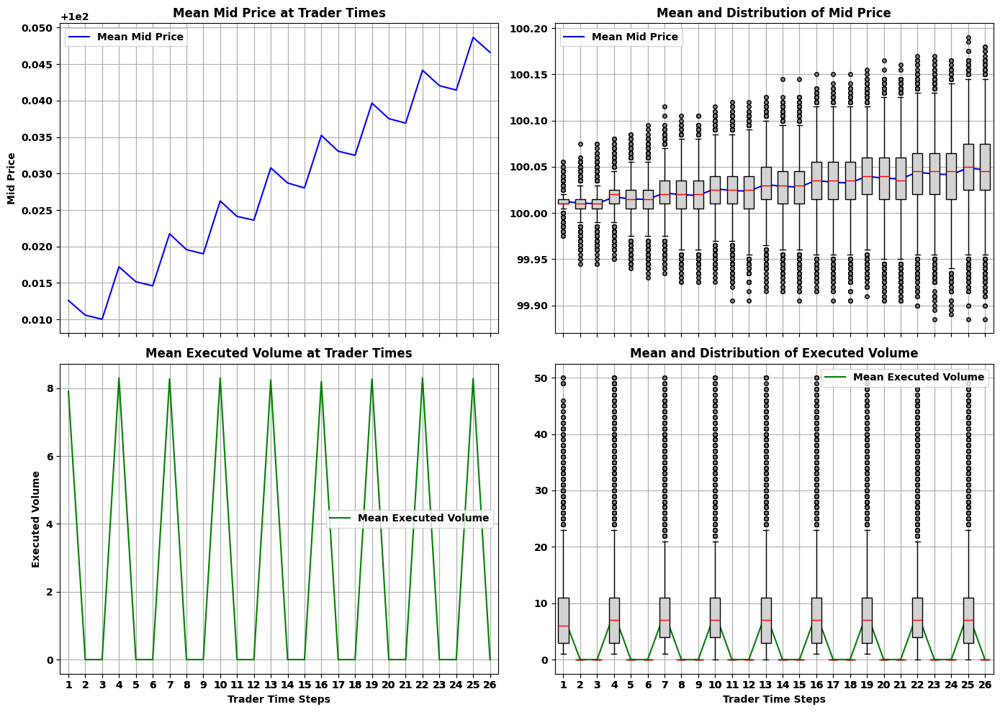

In [51]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_3_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv3 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv3, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv3, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


#### BV4

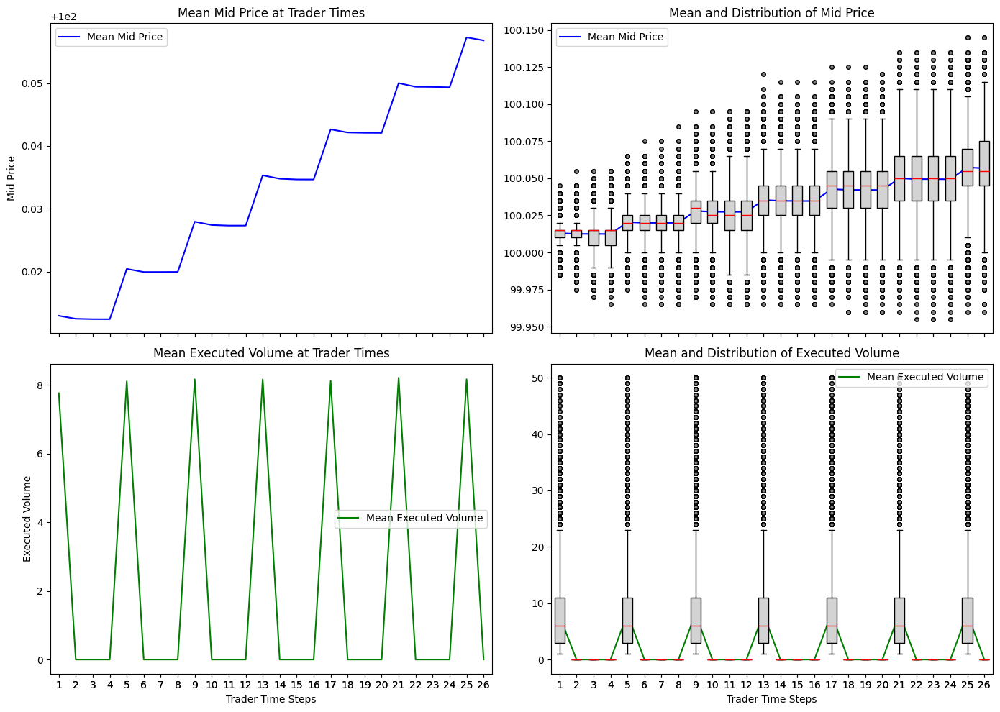

In [5]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/best_volume_4_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv4 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv4, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv4, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


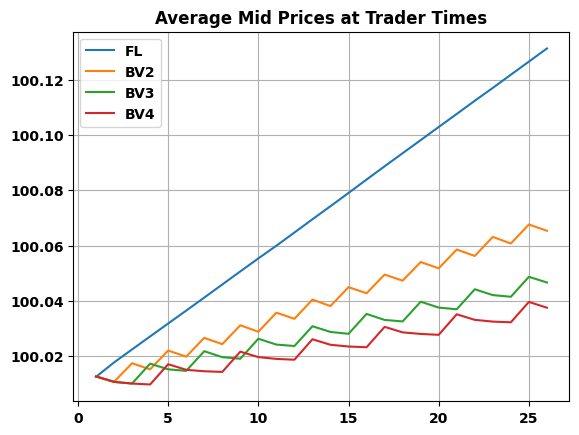

In [53]:
plt.plot(x_vals, mean_mid_prices_fl, label='FL')
plt.plot(x_vals, mean_mid_prices_bv2, label='BV2')
plt.plot(x_vals, mean_mid_prices_bv3, label='BV3')
plt.plot(x_vals, mean_mid_prices_bv4, label='BV4')
plt.legend()
plt.title('Average Mid Prices at Trader Times')
plt.grid()
plt.show()

### $\theta^{\text{reinit}} = 0.5$

In [6]:
T = 78
trader_time_step = 3
name_run = 'tr_5'

#### Front Load

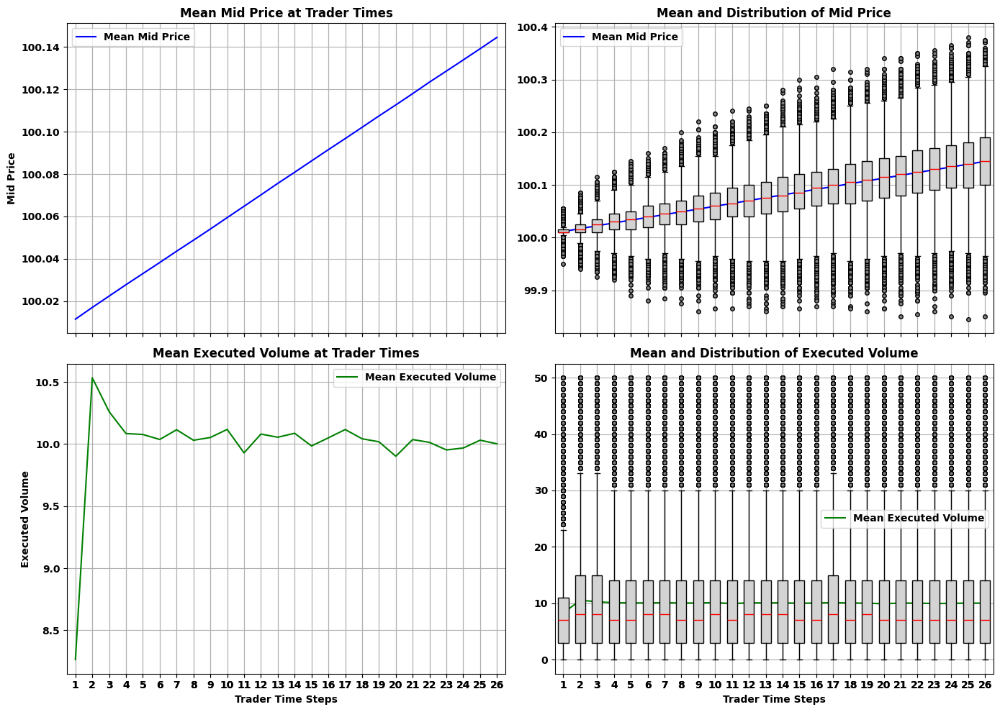

In [55]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/front_load_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_fl_5 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_fl_5, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_fl_5, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


#### BV2

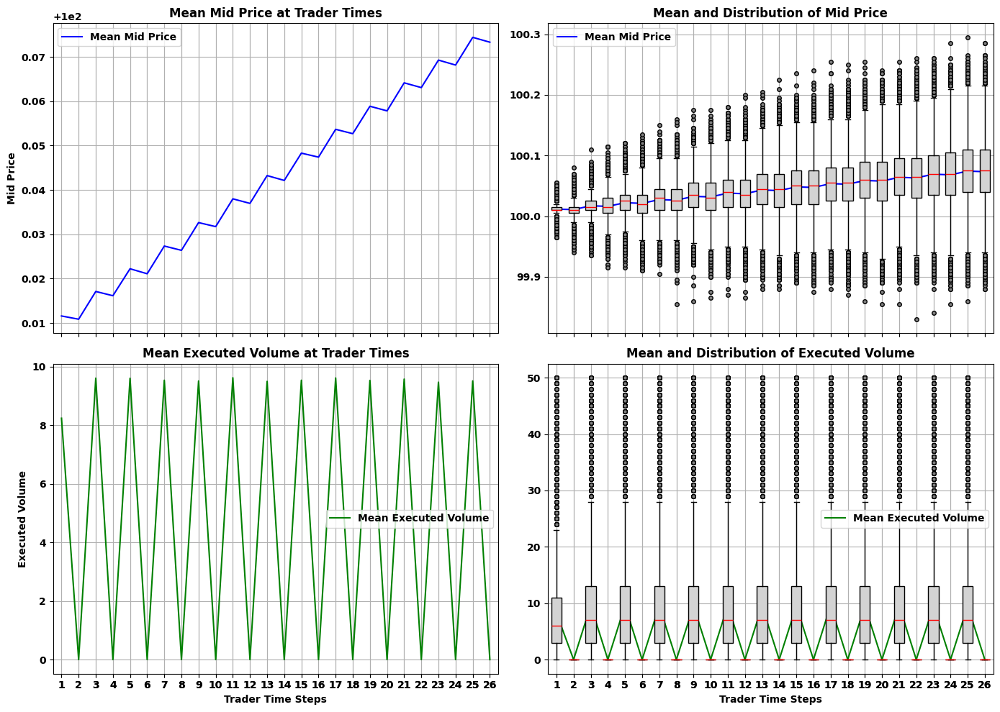

In [56]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv2_5 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv2_5, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv2_5, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


#### BV3

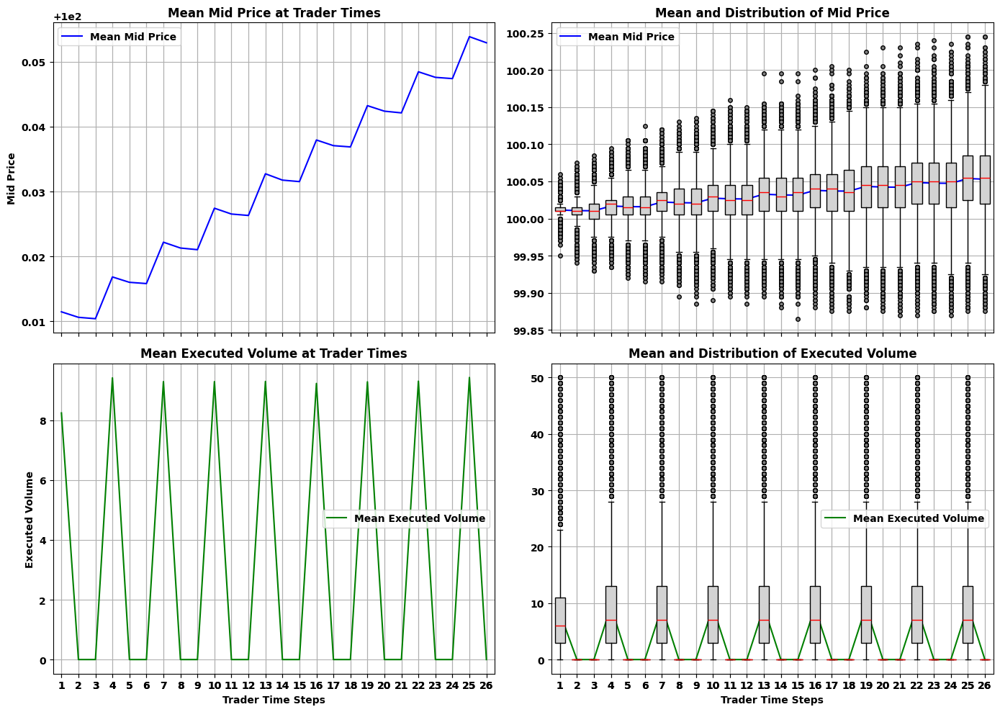

In [57]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_3_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv3_5 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv3_5, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv3_5, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


#### BV4

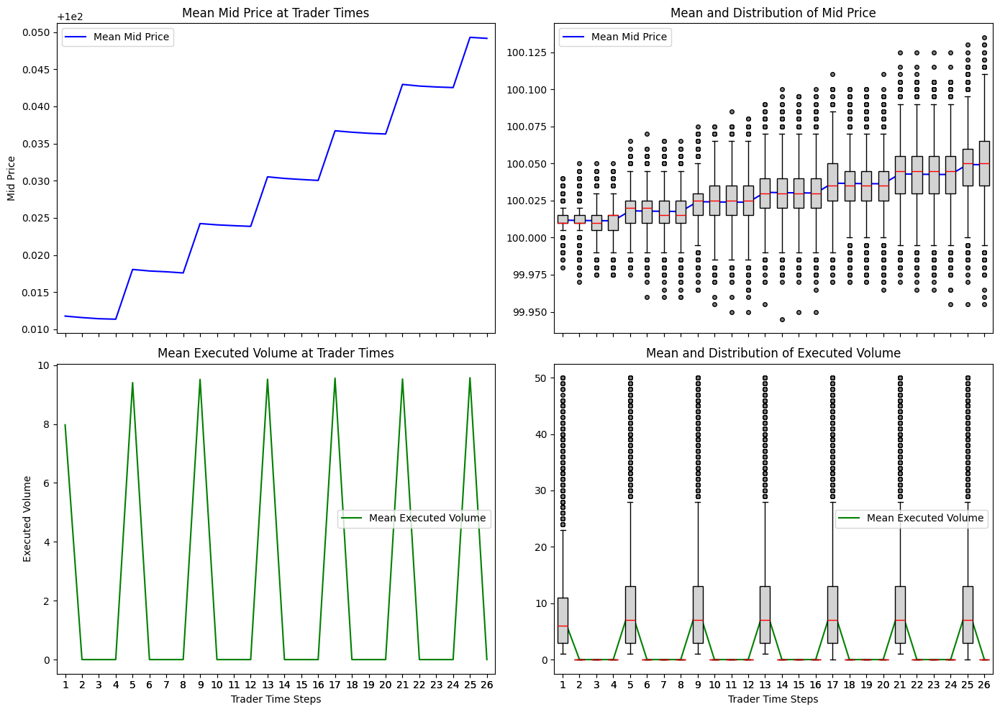

In [7]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/best_volume_4_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv4_5 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv4_5, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv4_5, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


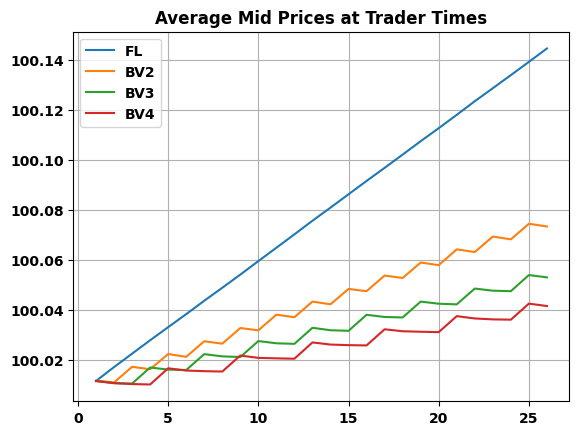

In [59]:
plt.plot(x_vals, mean_mid_prices_fl_5, label='FL')
plt.plot(x_vals, mean_mid_prices_bv2_5, label='BV2')
plt.plot(x_vals, mean_mid_prices_bv3_5, label='BV3')
plt.plot(x_vals, mean_mid_prices_bv4_5, label='BV4')
plt.legend()
plt.title('Average Mid Prices at Trader Times')
plt.grid()
plt.show()

### $\theta^{\text{reinit}} = 0.25$

In [8]:
T = 78
trader_time_step = 3
name_run = 'tr_25'

#### Front Load

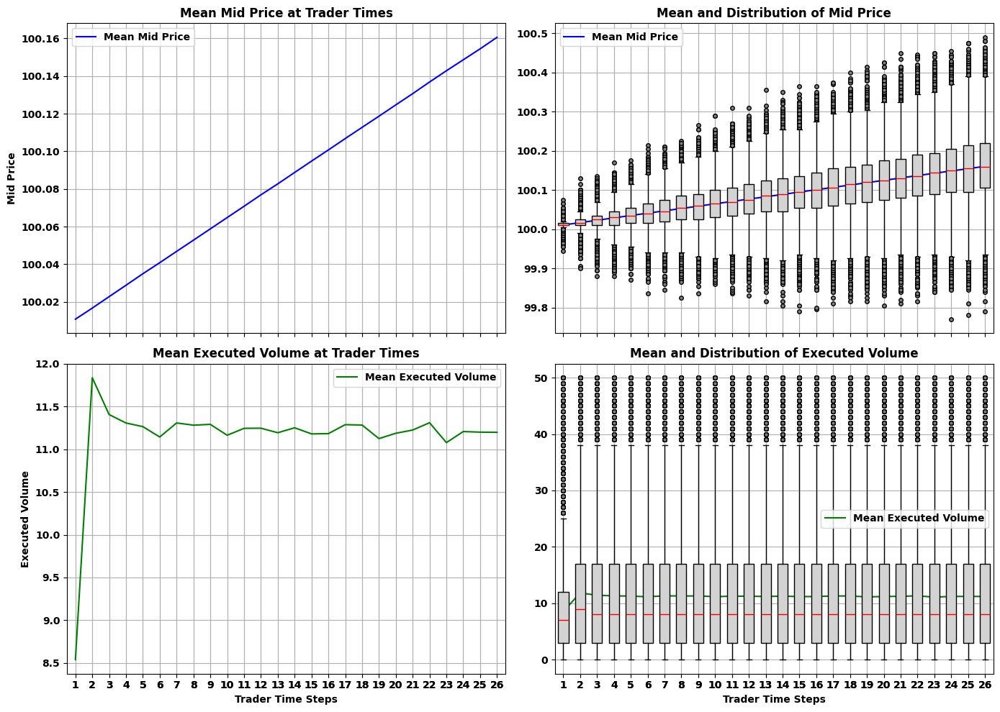

In [61]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/front_load_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_fl_25 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_fl_25, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_fl_25, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


#### BV2

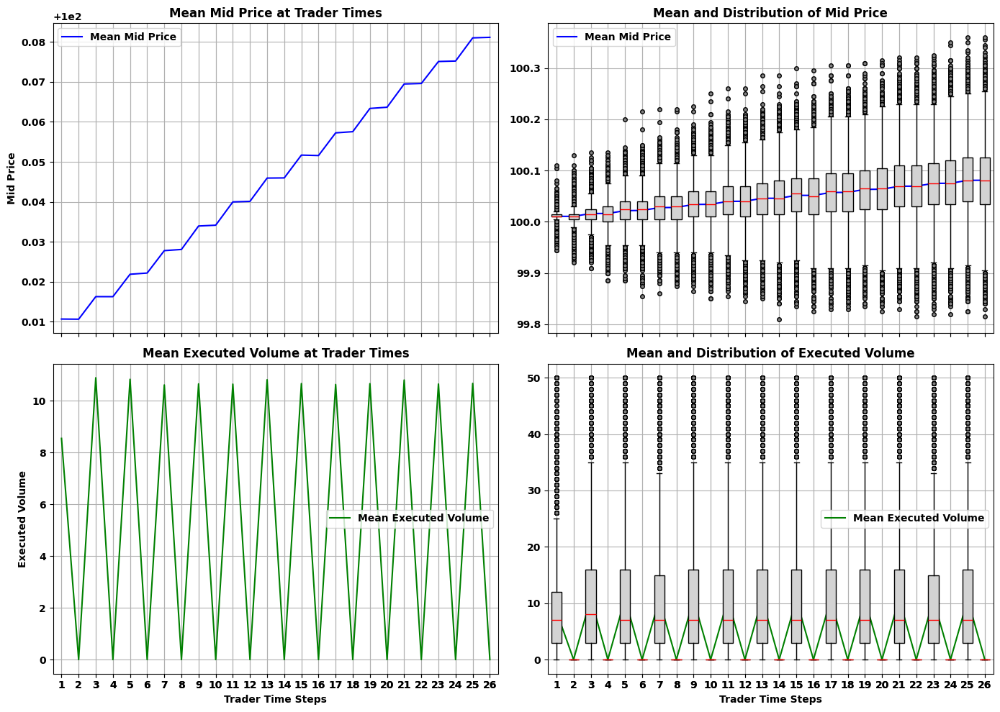

In [62]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv2_25 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv2_25, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv2_25, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


#### BV3

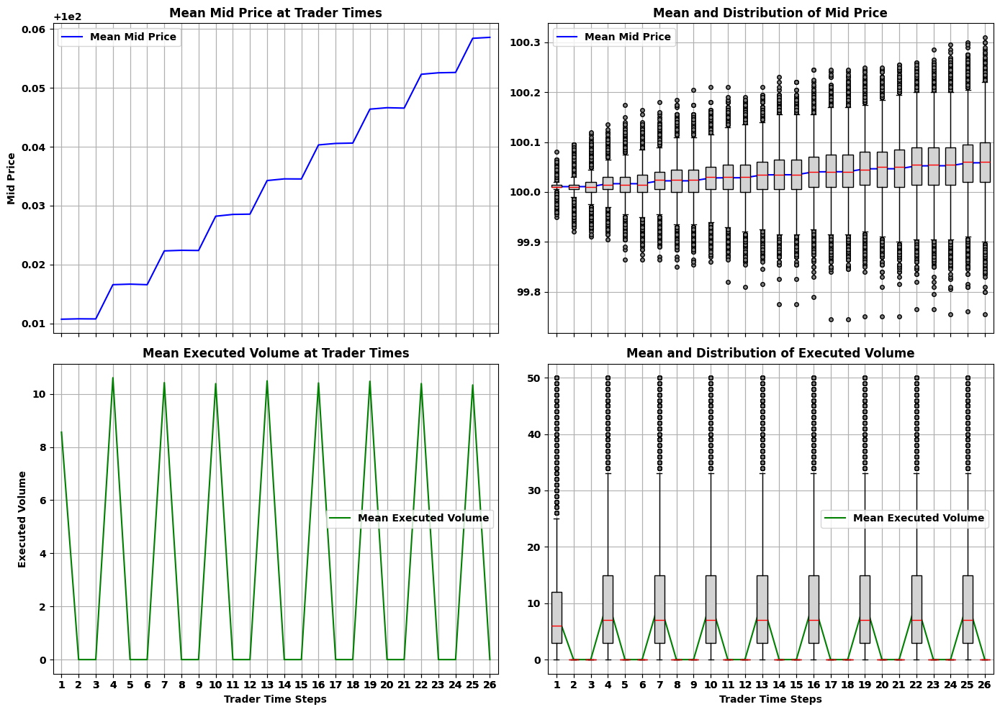

In [63]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_3_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv3_25 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv3_25, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv3_25, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


#### BV4

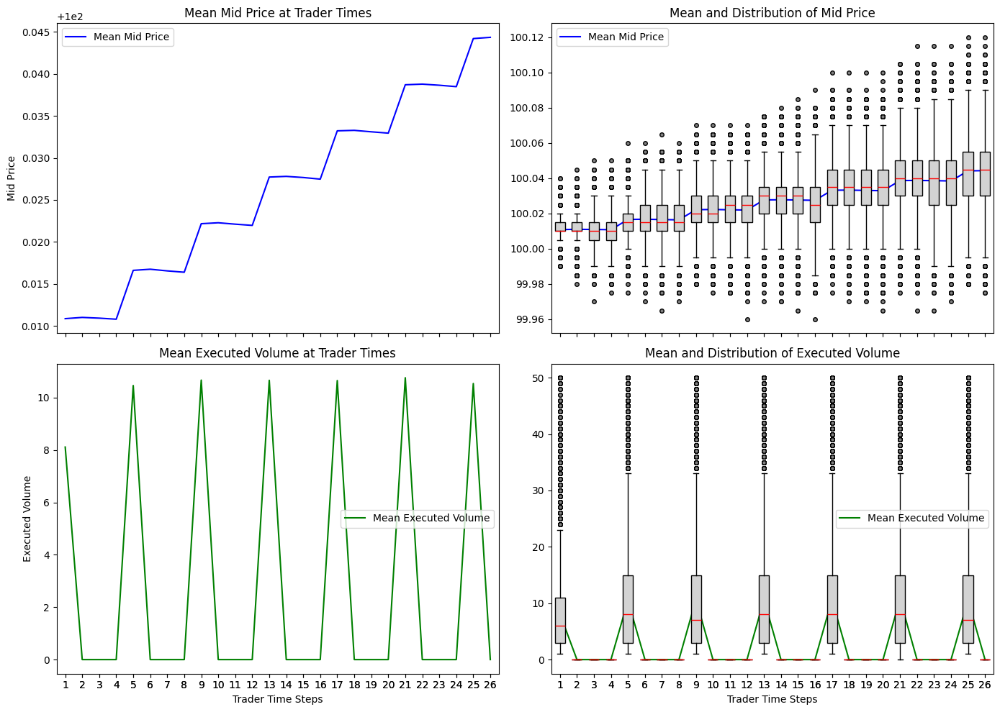

In [9]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/best_volume_4_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv4_25 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv4_25, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv4_25, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


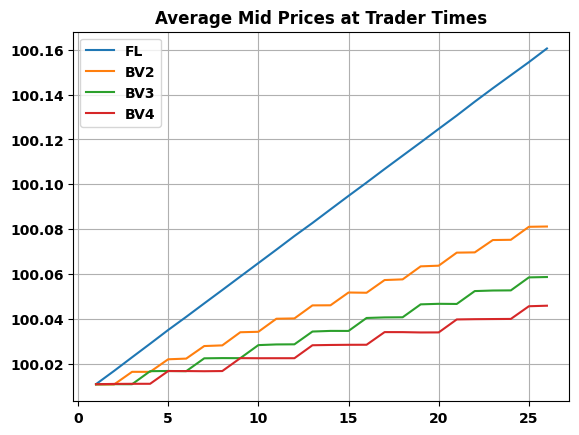

In [65]:
plt.plot(x_vals, mean_mid_prices_fl_25, label='FL')
plt.plot(x_vals, mean_mid_prices_bv2_25, label='BV2')
plt.plot(x_vals, mean_mid_prices_bv3_25, label='BV3')
plt.plot(x_vals, mean_mid_prices_bv4_25, label='BV4')
plt.legend()
plt.title('Average Mid Prices at Trader Times')
plt.grid()
plt.show()

### $\theta^{\text{reinit}} = 0.05$

In [203]:
T = 78
trader_time_step = 3
name_run = 'tr_05'

#### Front Load

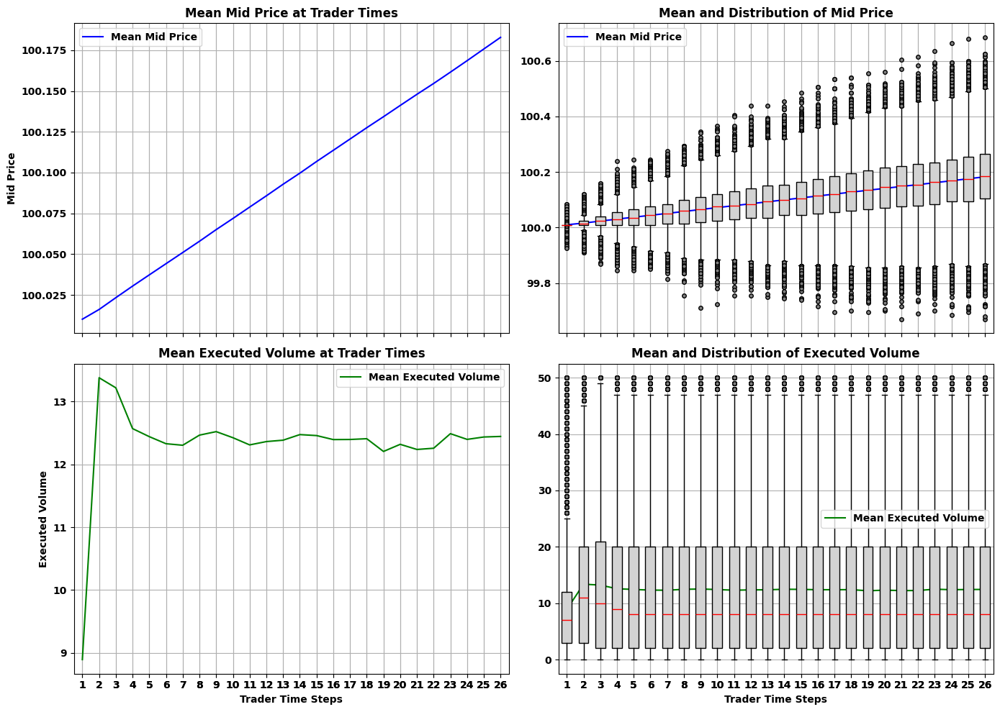

In [67]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/front_load_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_fl_05 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_fl_05, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_fl_05, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


#### BV2

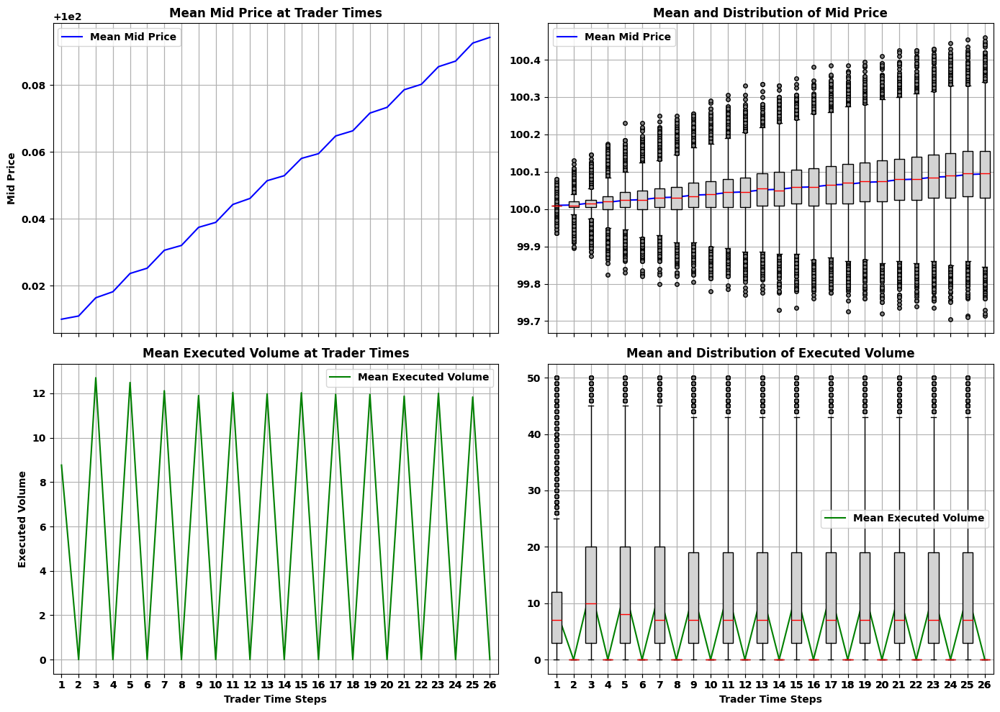

In [68]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv2_05 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv2_05, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv2_05, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


#### BV3

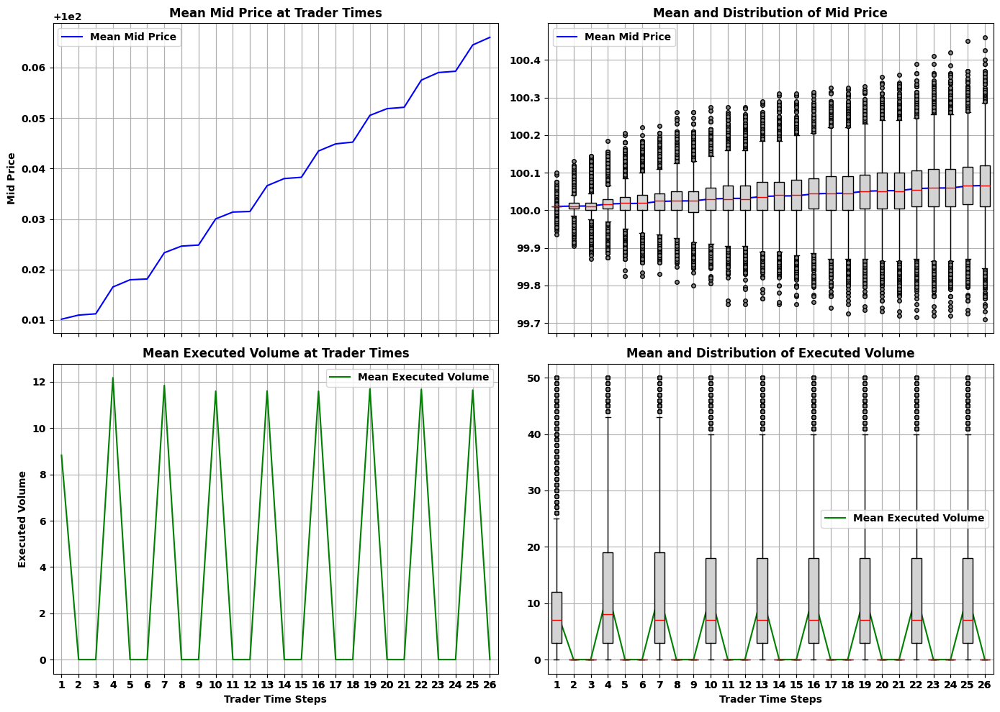

In [69]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_3_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv3_05 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv3_05, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv3_05, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


#### BV4

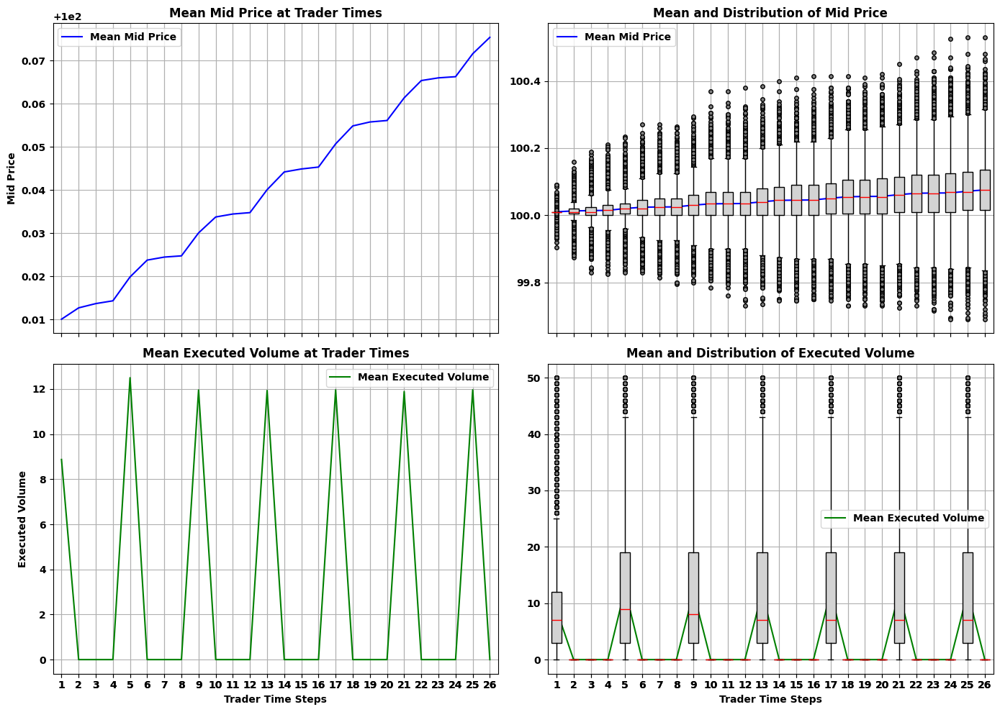

In [204]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_4_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv4_05 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv4_05, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv4_05, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


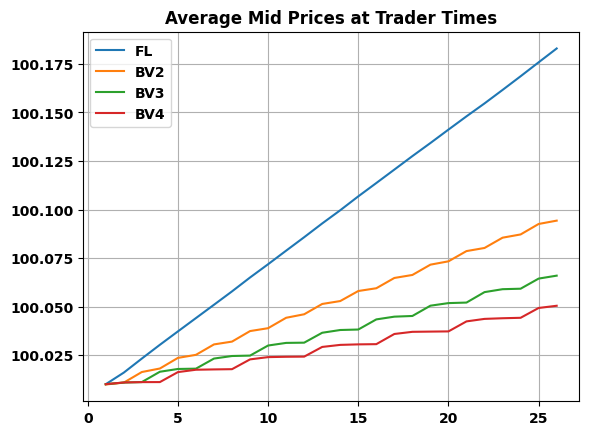

In [71]:
plt.plot(x_vals, mean_mid_prices_fl_05, label='FL')
plt.plot(x_vals, mean_mid_prices_bv2_05, label='BV2')
plt.plot(x_vals, mean_mid_prices_bv3_05, label='BV3')
plt.plot(x_vals, mean_mid_prices_bv4_05, label='BV4')
plt.legend()
plt.title('Average Mid Prices at Trader Times')
plt.grid()
plt.show()

### $\theta^{\text{reinit}}$ put together

3 second steps

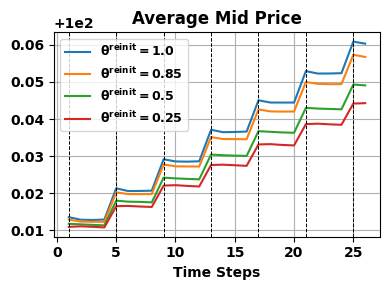

In [ ]:
# --- 4. BV4 ---
plt.figure(figsize=(4, 3))
plt.plot(x_vals, mean_mid_prices_bv4_1, label=r'$\mathbf{\theta}^{\text{reinit}}=1.0$')
plt.plot(x_vals, mean_mid_prices_bv4, label=r'$\mathbf{\theta}^{\text{reinit}}=0.85$')
plt.plot(x_vals, mean_mid_prices_bv4_5, label=r'$\mathbf{\theta}^{\text{reinit}}=0.5$')
plt.plot(x_vals, mean_mid_prices_bv4_25, label=r'$\mathbf{\theta}^{\text{reinit}}=0.25$')
# plt.plot(x_vals, mean_mid_prices_bv4_05, label=r'$\mathbf{\theta}^{\text{reinit}}=0.05$')
plt.title('Average Mid Price')
for i in range(7):
    plt.axvline(1+i*4, color='k', linestyle='--', linewidth=0.7)
plt.xlabel('Time Steps')
plt.grid()
plt.legend(fontsize=9)
plt.tight_layout()
plt.savefig(f'./plots/theta_reinit.pdf', bbox_inches='tight')
plt.show()

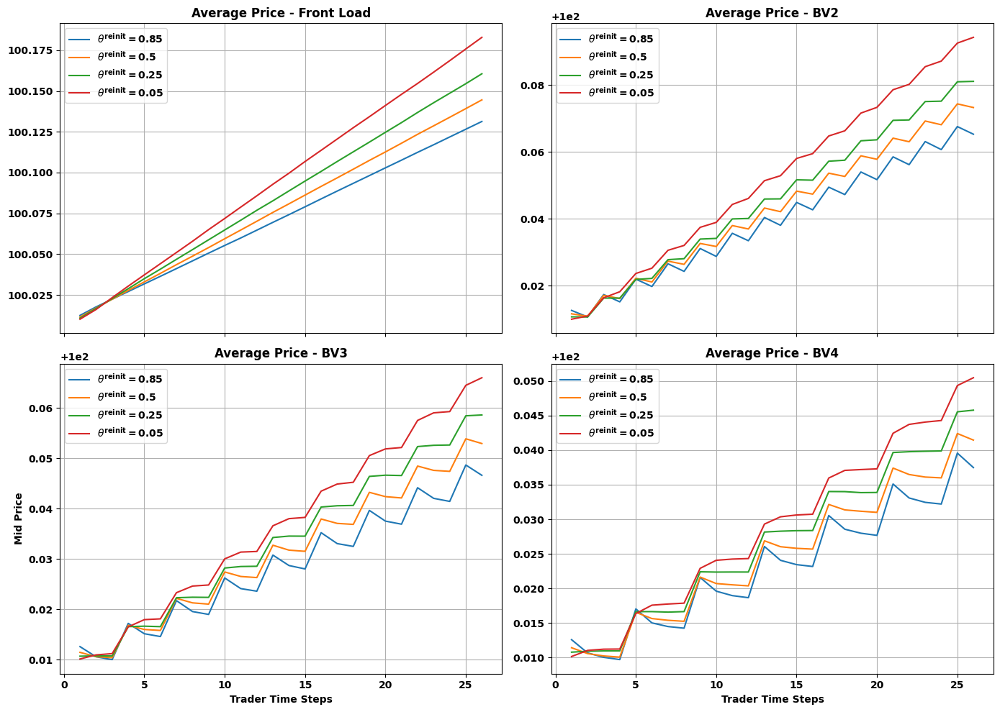

In [72]:
import matplotlib.pyplot as plt

fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- 1. Front Load ---
axs[0, 0].plot(x_vals, mean_mid_prices_fl, label=r'$\theta^{\text{reinit}}=0.85$')
axs[0, 0].plot(x_vals, mean_mid_prices_fl_5, label=r'$\theta^{\text{reinit}}=0.5$')
axs[0, 0].plot(x_vals, mean_mid_prices_fl_25, label=r'$\theta^{\text{reinit}}=0.25$')
axs[0, 0].plot(x_vals, mean_mid_prices_fl_05, label=r'$\theta^{\text{reinit}}=0.05$')
axs[0, 0].set_title('Average Price - Front Load')
axs[0, 0].grid()
axs[0, 0].legend()

# --- 2. BV2 ---
axs[0, 1].plot(x_vals, mean_mid_prices_bv2, label=r'$\theta^{\text{reinit}}=0.85$')
axs[0, 1].plot(x_vals, mean_mid_prices_bv2_5, label=r'$\theta^{\text{reinit}}=0.5$')
axs[0, 1].plot(x_vals, mean_mid_prices_bv2_25, label=r'$\theta^{\text{reinit}}=0.25$')
axs[0, 1].plot(x_vals, mean_mid_prices_bv2_05, label=r'$\theta^{\text{reinit}}=0.05$')
axs[0, 1].set_title('Average Price - BV2')
axs[0, 1].grid()
axs[0, 1].legend()

# --- 3. BV3 ---
axs[1, 0].plot(x_vals, mean_mid_prices_bv3, label=r'$\theta^{\text{reinit}}=0.85$')
axs[1, 0].plot(x_vals, mean_mid_prices_bv3_5, label=r'$\theta^{\text{reinit}}=0.5$')
axs[1, 0].plot(x_vals, mean_mid_prices_bv3_25, label=r'$\theta^{\text{reinit}}=0.25$')
axs[1, 0].plot(x_vals, mean_mid_prices_bv3_05, label=r'$\theta^{\text{reinit}}=0.05$')
axs[1, 0].set_title('Average Price - BV3')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Mid Price')
axs[1, 0].grid()
axs[1, 0].legend()

# --- 4. BV4 ---
axs[1, 1].plot(x_vals, mean_mid_prices_bv4, label=r'$\theta^{\text{reinit}}=0.85$')
axs[1, 1].plot(x_vals, mean_mid_prices_bv4_5, label=r'$\theta^{\text{reinit}}=0.5$')
axs[1, 1].plot(x_vals, mean_mid_prices_bv4_25, label=r'$\theta^{\text{reinit}}=0.25$')
axs[1, 1].plot(x_vals, mean_mid_prices_bv4_05, label=r'$\theta^{\text{reinit}}=0.05$')
axs[1, 1].set_title('Average Price - BV4')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


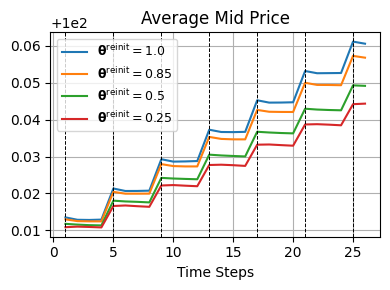

: 

In [ ]:
# --- 4. BV4 ---
plt.figure(figsize=(4, 3))
plt.plot(x_vals, mean_mid_prices_bv4_1, label=r'$\mathbf{\theta}^{\text{reinit}}=1.0$')
plt.plot(x_vals, mean_mid_prices_bv4, label=r'$\mathbf{\theta}^{\text{reinit}}=0.85$')
plt.plot(x_vals, mean_mid_prices_bv4_5, label=r'$\mathbf{\theta}^{\text{reinit}}=0.5$')
plt.plot(x_vals, mean_mid_prices_bv4_25, label=r'$\mathbf{\theta}^{\text{reinit}}=0.25$')
# plt.plot(x_vals, mean_mid_prices_bv4_05, label=r'$\mathbf{\theta}^{\text{reinit}}=0.05$')
plt.title('Average Mid Price')
for i in range(7):
    plt.axvline(1+i*4, color='k', linestyle='--', linewidth=0.7)
plt.xlabel('Time Steps')
# plt.grid()
plt.legend(fontsize=9)
plt.tight_layout()
plt.savefig(f'/home/te6653/research/qrm_optimal_execution/plots/theta_reinit.pdf', bbox_inches='tight')
plt.show()

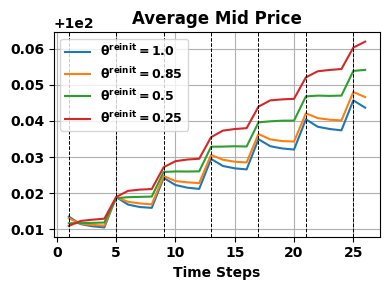

In [ ]:
# --- 4. BV4 ---
plt.figure(figsize=(4, 3))
plt.plot(x_vals, mean_mid_prices_bv4_1, label=r'$\mathbf{\theta}^{\text{reinit}}=1.0$')
plt.plot(x_vals, mean_mid_prices_bv4, label=r'$\mathbf{\theta}^{\text{reinit}}=0.85$')
plt.plot(x_vals, mean_mid_prices_bv4_5, label=r'$\mathbf{\theta}^{\text{reinit}}=0.5$')
plt.plot(x_vals, mean_mid_prices_bv4_25, label=r'$\mathbf{\theta}^{\text{reinit}}=0.25$')
# plt.plot(x_vals, mean_mid_prices_bv4_05, label=r'$\mathbf{\theta}^{\text{reinit}}=0.05$')
plt.title('Average Mid Price')
for i in range(7):
    plt.axvline(1+i*4, color='k', linestyle='--', linewidth=0.7)
plt.xlabel('Time Steps')
plt.grid()
plt.legend(fontsize=9)
plt.tight_layout()
# plt.savefig(f'./plots/theta_reinit.pdf', bbox_inches='tight')
plt.show()

### $\theta=1.0$ & $\theta^{\text{reinit}} = 1.0$

In [74]:
T = 78
trader_time_step = 3
name_run = 't_1_tr_1'

#### BV4

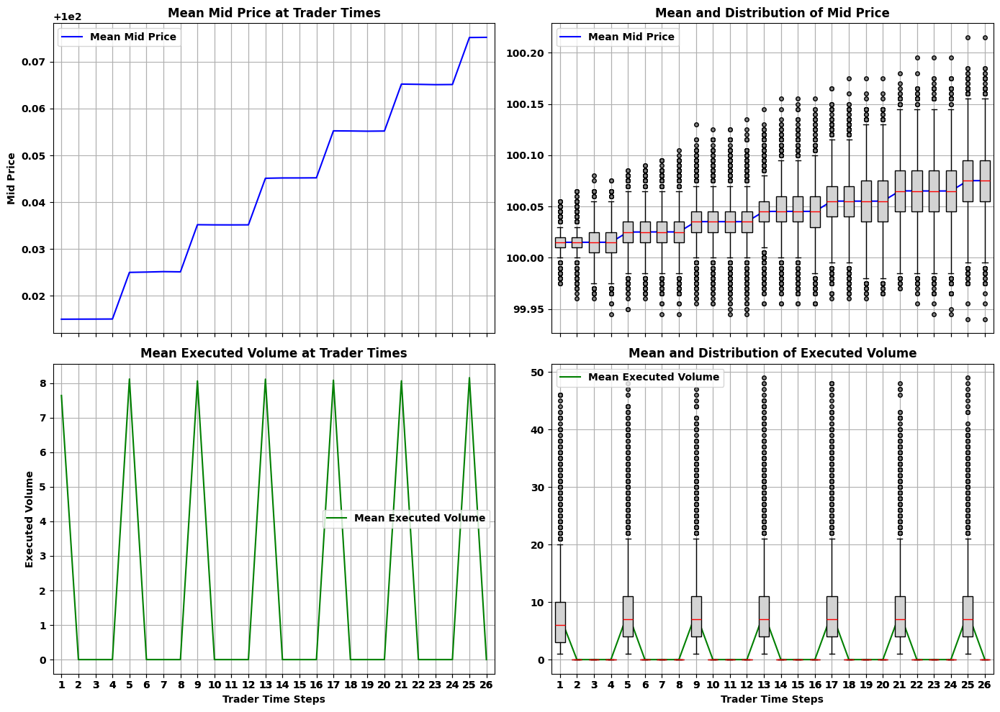

In [75]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_4_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv4_t_1_tr_1 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv4_t_1_tr_1, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv4_t_1_tr_1, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


### $\theta=1.0$ & $\theta^{\text{reinit}} = 0.85$

In [76]:
T = 78
trader_time_step = 3
name_run = 't_1_tr_85'

#### BV4

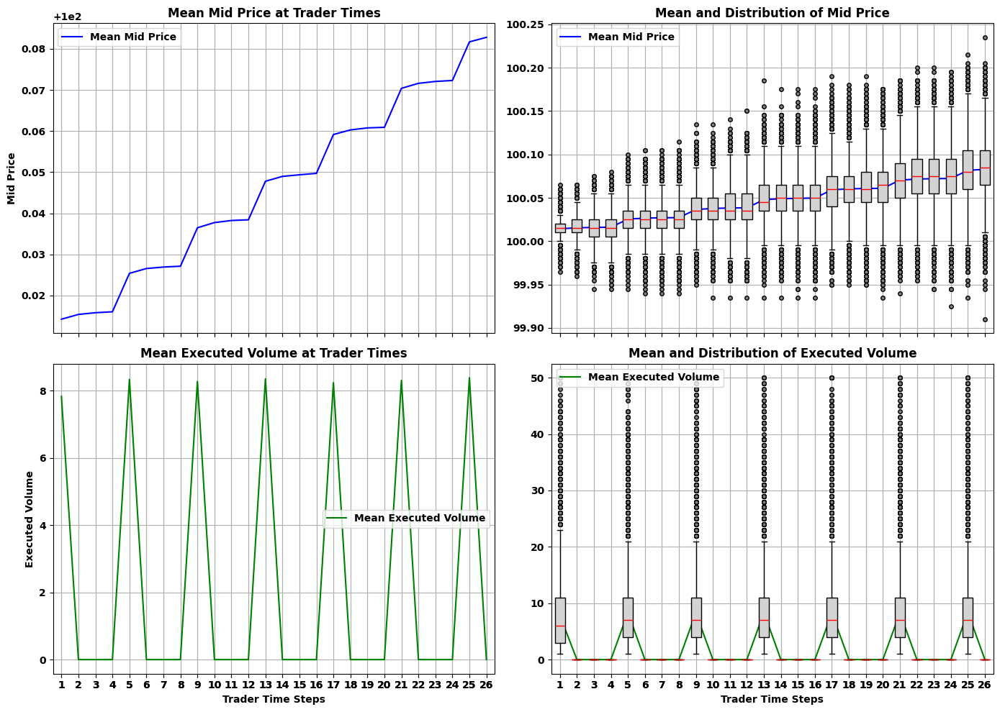

In [77]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_4_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv4_t_1_tr_85 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv4_t_1_tr_85, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv4_t_1_tr_85, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


### $\theta=1.0$ & $\theta^{\text{reinit}} = 0.5$

In [78]:
T = 78
trader_time_step = 3
name_run = 't_1_tr_5'

#### BV4

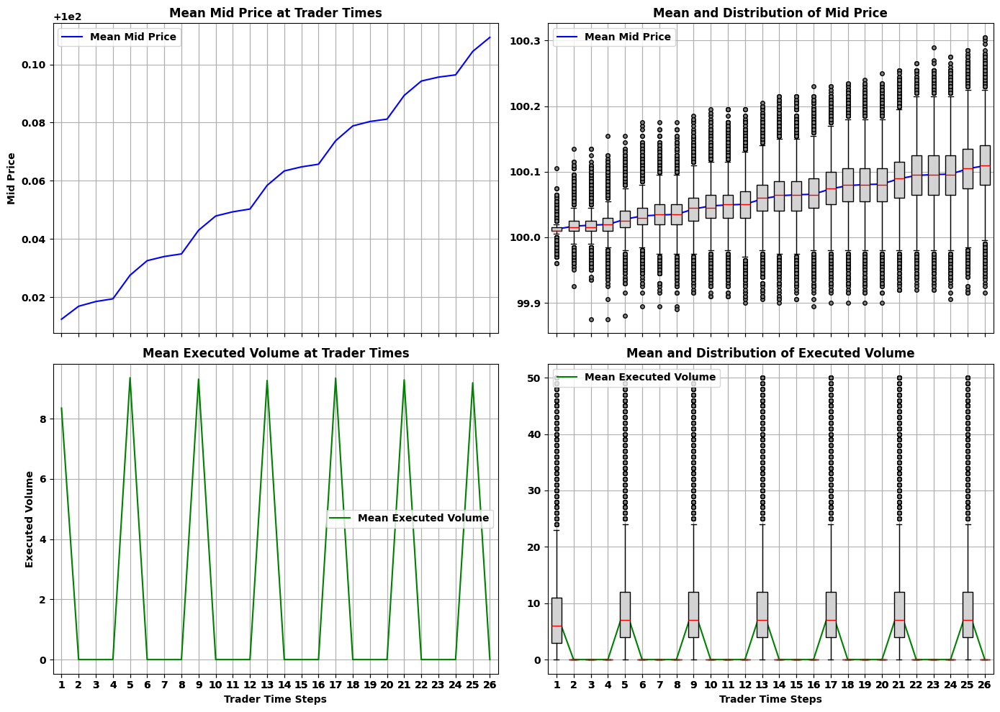

In [79]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_4_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv4_t_1_tr_5 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv4_t_1_tr_5, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv4_t_1_tr_5, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


### $\theta=1.0$ & $\theta^{\text{reinit}} = 0.25$

In [80]:
T = 78
trader_time_step = 3
name_run = 't_1_tr_25'

#### BV4

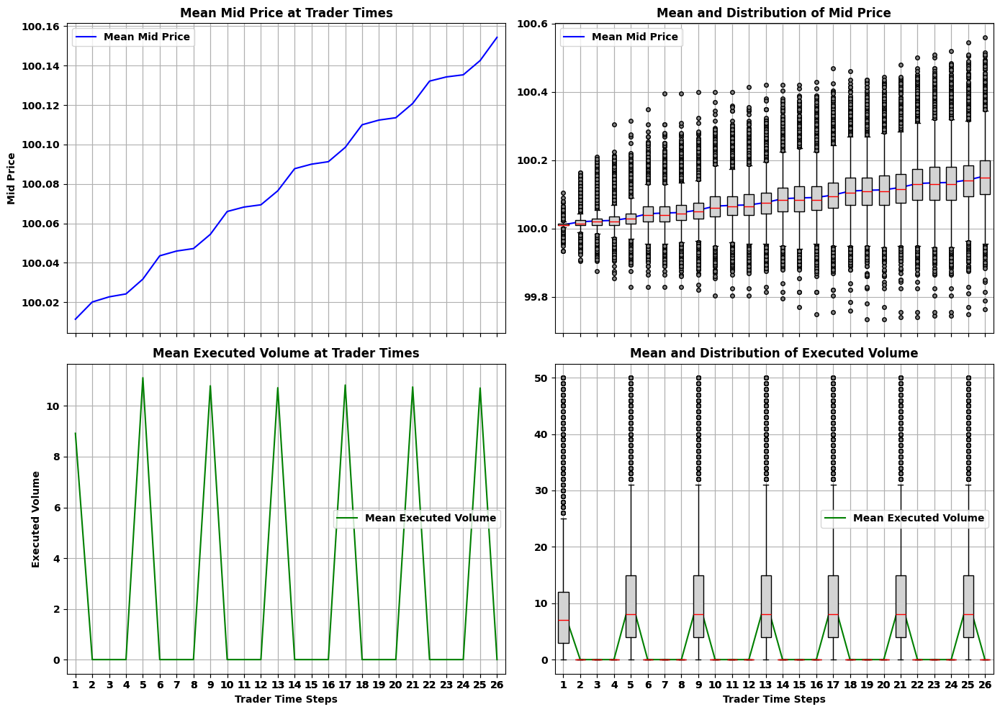

In [82]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_4_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv4_t_1_tr_25 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv4_t_1_tr_25, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv4_t_1_tr_25, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


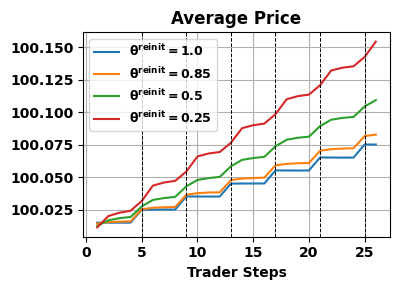

In [83]:
# --- 4. BV4 ---
plt.figure(figsize=(4, 3))
plt.plot(x_vals, mean_mid_prices_bv4_t_1_tr_1, label=r'$\mathbf{\theta}^{\text{reinit}}=1.0$')
plt.plot(x_vals, mean_mid_prices_bv4_t_1_tr_85, label=r'$\mathbf{\theta}^{\text{reinit}}=0.85$')
plt.plot(x_vals, mean_mid_prices_bv4_t_1_tr_5, label=r'$\mathbf{\theta}^{\text{reinit}}=0.5$')
plt.plot(x_vals, mean_mid_prices_bv4_t_1_tr_25, label=r'$\mathbf{\theta}^{\text{reinit}}=0.25$')
plt.title('Average Price')
for i in range(1, 7):
    plt.axvline(1+i*4, color='k', linestyle='--', linewidth=0.7)
plt.xlabel('Trader Steps')
plt.grid()
plt.legend(fontsize=9)
plt.tight_layout()
plt.savefig(f'theta_reinit.pdf', bbox_inches='tight')
plt.show()

### $\theta=0.7$ & $\theta^{\text{reinit}} = 0.85$

In [85]:
T = 78
trader_time_step = 3
name_run = 't_7_tr_85'

#### BV4

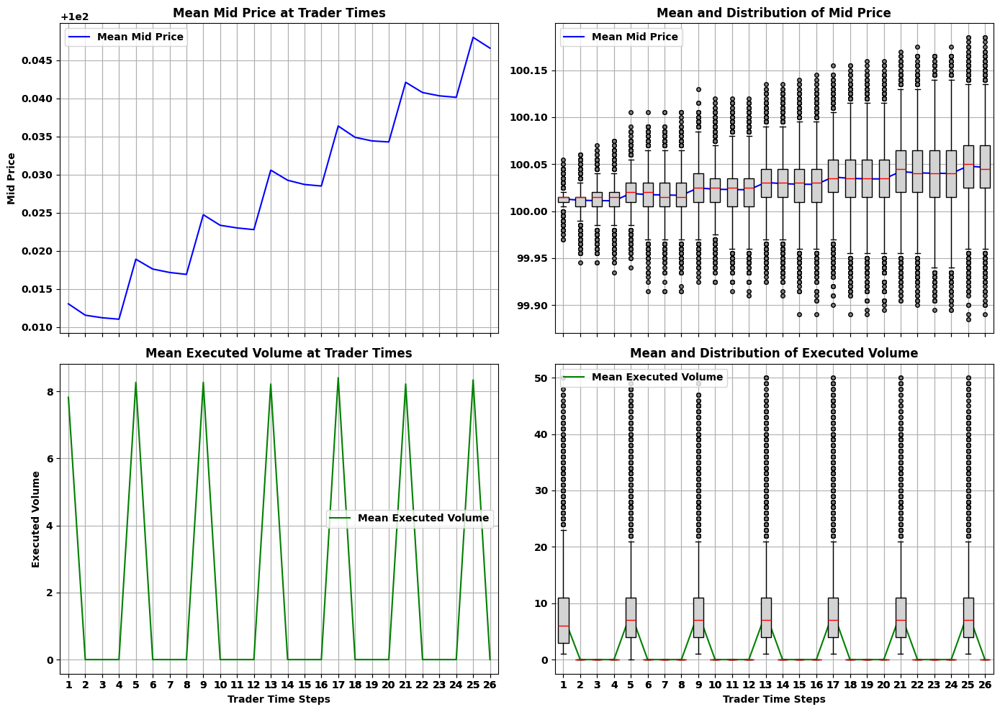

In [86]:
trader_times = np.arange(0, T + trader_time_step, trader_time_step)

with open(f'data_wandb/dictionaries/best_volume_4_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

mid_prices_events = dic['mid_prices_events']
executed = dic['executed']

# Prepare arrays
arr_mid_prices = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)
arr_executed = np.full((len(mid_prices_events), len(trader_times) - 1), np.nan)

for i, mid_prices in mid_prices_events.items():
    arr_mid_prices[i, :len(mid_prices)] = mid_prices

for i, execs in executed.items():
    arr_executed[i, :len(execs)] = execs

# X-axis values
x_vals = range(1, len(trader_times))

# Compute means
mean_mid_prices_bv4_t_7_tr_85 = np.nanmean(arr_mid_prices, axis=0)
mean_executed = np.nanmean(arr_executed, axis=0)

# Create 2x2 subplot
fig, axs = plt.subplots(2, 2, figsize=(14, 10), sharex=True)

# --- Mid Prices ---
# Top left: mean only
axs[0, 0].plot(x_vals, mean_mid_prices_bv4_t_7_tr_85, label='Mean Mid Price', color='blue')
axs[0, 0].set_title('Mean Mid Price at Trader Times')
axs[0, 0].set_ylabel('Mid Price')
axs[0, 0].grid()
axs[0, 0].legend()

# Top right: mean + boxplots
axs[0, 1].plot(x_vals, mean_mid_prices_bv4_t_7_tr_85, label='Mean Mid Price', color='blue')
axs[0, 1].boxplot(
    [arr_mid_prices[:, i][~np.isnan(arr_mid_prices[:, i])] for i in range(arr_mid_prices.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[0, 1].set_title('Mean and Distribution of Mid Price')
axs[0, 1].grid()
axs[0, 1].legend()

# --- Executed Volume ---
# Bottom left: mean only
axs[1, 0].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 0].set_title('Mean Executed Volume at Trader Times')
axs[1, 0].set_xlabel('Trader Time Steps')
axs[1, 0].set_ylabel('Executed Volume')
axs[1, 0].grid()
axs[1, 0].legend()

# Bottom right: mean + boxplots
axs[1, 1].plot(x_vals, mean_executed, label='Mean Executed Volume', color='green')
axs[1, 1].boxplot(
    [arr_executed[:, i][~np.isnan(arr_executed[:, i])] for i in range(arr_executed.shape[1])],
    positions=x_vals,
    widths=0.6,
    patch_artist=True,
    boxprops=dict(facecolor="lightgray", color="black"),
    medianprops=dict(color="red"),
    whiskerprops=dict(color="black"),
    capprops=dict(color="black"),
    flierprops=dict(markerfacecolor="gray", marker="o", markersize=4, linestyle="none")
)
axs[1, 1].set_title('Mean and Distribution of Executed Volume')
axs[1, 1].set_xlabel('Trader Time Steps')
axs[1, 1].grid()
axs[1, 1].legend()

plt.tight_layout()
plt.show()


# MEAN REVERSION ?

## Old

In [10]:
thetas = np.linspace(0.5, 1.0, 20)
theta_reinits = np.linspace(0.5, 1.0, 20)

initial_price = 100.005
tick = 0.01
prefix = 'best_volume_8'

# empirical price jumps after buying the best ask
df_price_jump_emp = pd.DataFrame(
    data=np.zeros((len(thetas), len(theta_reinits))),  # or np.nan
    index=thetas,
    columns=theta_reinits
)
# theoritical price jumps after buying the best ask
values = (1 + np.outer(thetas, theta_reinits)) * tick / 2
df_price_jump_theo = pd.DataFrame(
    data=values,
    index=thetas,
    columns=theta_reinits
)
# empirical price back to normal after buying the best ask
df_mr_emp = pd.DataFrame(
    data=np.zeros((len(thetas), len(theta_reinits))),
    index=thetas,
    columns=theta_reinits
)
# theoritical price back to normal after buying the best ask
values = tick * np.outer(thetas, np.ones(len(theta_reinits)))
df_mr_theo = pd.DataFrame(
    data=values,
    index=thetas,
    columns=theta_reinits
)

heatmap = np.zeros((len(thetas), len(theta_reinits)))
maxi_heatmap = -np.inf

for i, theta in enumerate(thetas):
    for j, theta_r in enumerate(theta_reinits):

        # load dictionary
        with open(f'data_wandb/dictionaries/{prefix}_heatmap_t_{i}_tr_{j}.pkl', 'rb') as f:
            dic = pickle.load(f)

        # extract mid prices
        prices = dic['mid_prices_events']
        prices_arr = np.zeros((len(prices), len(prices[0])))
        for k, v in prices.items():
            prices_arr[k] = v
        # compute mean price
        mean_price = np.nanmean(prices_arr, axis=0)
        # average size of mid price jumps after buying the best ask
        price_jump = mean_price[0] - initial_price 
        df_price_jump_emp.iloc[i, j] = price_jump
        # average gap between initial price and prices back to normal after buying the best ask
        df_mr_emp.iloc[i, j] = mean_price[1] - initial_price
        # gap between price after buying and immediate reaction
        price_reaction = mean_price[1] - mean_price[0]
        heatmap[i, j] = price_reaction

        max_abs_heatmap = max(np.max(np.abs(heatmap)), maxi_heatmap)

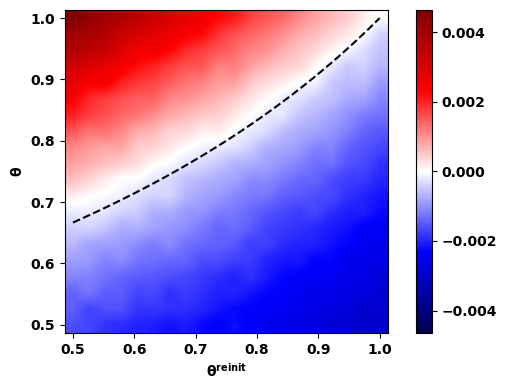

Error on Price Jump Empirical vs Theoretical (in %):
Max Error: 0.924%


Error on Price Back to Normal Empirical vs Theoretical (in %):
Max Error: 21.469%




In [148]:
# PLOT
dx = (theta_reinits[1] - theta_reinits[0]) / 2
dy = (thetas[1] - thetas[0]) / 2
extent = [
    theta_reinits[0] - dx, theta_reinits[-1] + dx,  # x-min, x-max
    thetas[0] - dy, thetas[-1] + dy                 # y-min, y-max
]
plt.figure(figsize=(6, 4))
plt.imshow(heatmap[::-1], cmap='seismic', vmin=-max_abs_heatmap, vmax=max_abs_heatmap, extent=extent, interpolation='bilinear')
plt.colorbar() 
x_pt = np.linspace(theta_reinits[0], theta_reinits[-1], 100)
y_pt = 1 / (2 - x_pt)
plt.plot(x_pt, y_pt, color='black', linestyle='--', label='Theoretical Reaction')
# plt.xticks(ticks=range(len(theta_reinits)), labels=theta_reinits)
# plt.yticks(ticks=range(len(thetas)), labels=thetas[::-1])
plt.xlabel(r'$\mathbf{\theta}^{\text{reinit}}$')
plt.ylabel(r'$\mathbf{\theta}$', rotation=90)
# plt.title('Average Price Reaction After Buying Best Ask')
plt.tight_layout()
plt.savefig(f'./plots/heatmap_theta_{theta}_theta_reinit_{theta_r}.pdf', bbox_inches='tight')
plt.show()

# Statistics
print("Error on Price Jump Empirical vs Theoretical (in %):")
df_error_jump = np.abs(df_price_jump_emp - df_price_jump_theo) / df_price_jump_theo * 100
print(f"Max Error: {round(np.max(df_error_jump), 3)}%")
print('\n')
print("Error on Price Back to Normal Empirical vs Theoretical (in %):")
df_error_mr = np.abs(df_mr_emp - df_mr_theo) / df_mr_theo * 100
print(f"Max Error: {round(np.max(df_error_mr), 3)}%")
print('\n')

# print("Price Jump Empirical:")
# print(df_price_jump_emp)
# print('\n')
# print("Gap Between Price After Buying and Normal Price Empirical:")
# print(df_mr_emp)
values_mr_emp = df_mr_emp.values
if np.min(values_mr_emp) < 0:
    print("BUYING ALL THE ASK IS PROFITABLE !!!!!!!")
    min_index_flat = np.argmin(values_mr_emp)
    min_coords = np.unravel_index(min_index_flat, values_mr_emp.shape)
    print("Minimum value:", values_mr_emp[min_coords])
    print("Location (row, col):", min_coords)

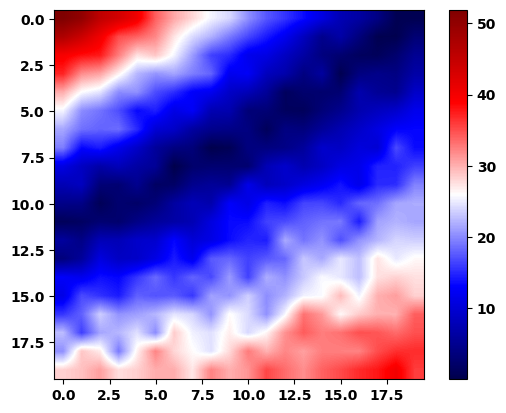

In [ ]:
# prices[-1] - initial_price
plt.imshow(df_error_mr.values[::-1], cmap='seismic', interpolation='bilinear')
plt.colorbar()

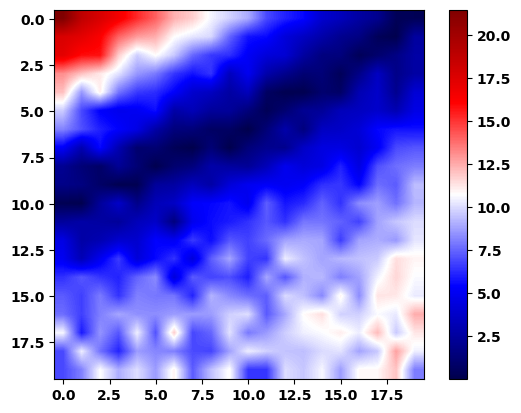

In [149]:
# prices[1] - initial_price
plt.imshow(df_error_mr.values[::-1], cmap='seismic', interpolation='bilinear')
plt.colorbar()

(np.float64(100.01250720329284),
 np.float64(100.01714694480896),
 np.float64(100.02019147758485))

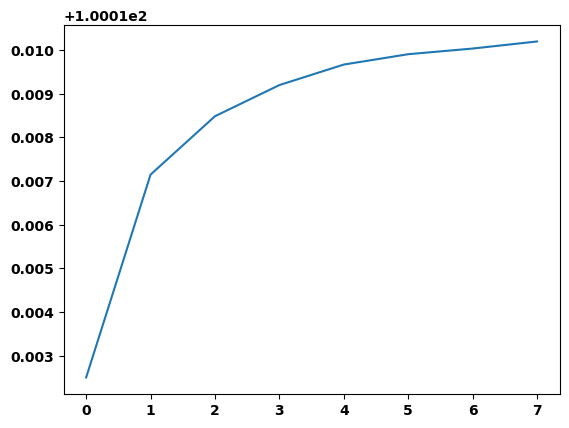

In [ ]:
i = 19 
j = 0
with open(f'data_wandb/dictionaries/{prefix}_heatmap_t_{i}_tr_{j}.pkl', 'rb') as f:
            dic = pickle.load(f)
prices = dic['mid_prices_events']-
prices_arr = np.zeros((len(prices), len(prices[0])))
for k, v in prices.items():
    prices_arr[k] = v
# compute mean price
mean_price = np.nanmean(prices_arr, axis=0)

plt.plot(mean_price)
mean_price[0], mean_price[1], mean_price[-1]

## New

### Long term heatmap

In [2]:
nb_grid = 60
thetas = np.linspace(0.5, 1.0, nb_grid)
theta_reinits = np.linspace(0.5, 1.0, nb_grid)

initial_price = 100.005
tick = 0.01
prefix = '10000_runs_event_time_long'

# empirical price jumps after buying the best ask
df_price_jump_emp = pd.DataFrame(
    data=np.zeros((len(thetas), len(theta_reinits))),  # or np.nan
    index=thetas,
    columns=theta_reinits
)
# theoritical price jumps after buying the best ask
values = (1 + np.outer(thetas, theta_reinits)) * tick / 2
df_price_jump_theo = pd.DataFrame(
    data=values,
    index=thetas,
    columns=theta_reinits
)
# empirical price back to normal after buying the best ask
df_mr_emp = pd.DataFrame(
    data=np.zeros((len(thetas), len(theta_reinits))),
    index=thetas,
    columns=theta_reinits
)
# theoritical price back to normal after buying the best ask
values = tick * np.outer(thetas, np.ones(len(theta_reinits)))
df_mr_theo = pd.DataFrame(
    data=values,
    index=thetas,
    columns=theta_reinits
)

heatmap = np.zeros((len(thetas), len(theta_reinits)))
maxi_heatmap = -np.inf

path = '/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/'

# with np.load(path + f'{prefix}_heatmap_t_{i}_tr_{j}.npz') as data:
        #     prices_arr = data['arr']
with np.load(path + f'{prefix}.npz') as data:
    all_prices = data['arr']

for i, theta in enumerate(thetas):
    for j, theta_r in enumerate(theta_reinits):
        
        prices_arr = all_prices[i, j]
        # print('prices_arr shape', prices_arr.shape)
        # compute mean price
        mean_price = np.nanmean(prices_arr, axis=0)
        # average size of mid price jumps after buying the best ask
        price_jump = mean_price[0] - initial_price 
        df_price_jump_emp.iloc[i, j] = price_jump
        # average gap between initial price and prices back to normal after buying the best ask
        df_mr_emp.iloc[i, j] = mean_price[1] - initial_price
        # gap between price after buying and immediate reaction
        price_reaction = mean_price[-1] - mean_price[0]
        heatmap[i, j] = price_reaction

        max_abs_heatmap = max(np.max(np.abs(heatmap)), maxi_heatmap)

Error on Price Jump Empirical vs Theoretical (in %):
Max Error: 6.258%


Error on Price Back to Normal Empirical vs Theoretical (in %):
Max Error: 38.4%




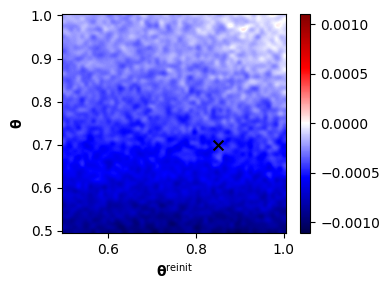

In [3]:
# PLOT
dx = (theta_reinits[1] - theta_reinits[0]) / 2
dy = (thetas[1] - thetas[0]) / 2
extent = [
    theta_reinits[0] - dx, theta_reinits[-1] + dx,  # x-min, x-max
    thetas[0] - dy, thetas[-1] + dy                 # y-min, y-max
]

plt.figure(figsize=(4, 3))
# ----- Left: bilinear -----
im_l = plt.imshow(
    heatmap[::-1], cmap='seismic',
    vmin=-max_abs_heatmap, vmax=max_abs_heatmap,
    extent=extent, interpolation='bicubic', aspect='auto'
)
plt.colorbar(im_l)
x_pt = np.linspace(theta_reinits[0], theta_reinits[-1], 100)
y_pt = 1 / (2 - x_pt)
# axes[0].plot(x_pt, y_pt, color='black', linestyle='--', label='Theoretical Reaction')
plt.xlabel(r'$\mathbf{\theta}^{\text{reinit}}$')
plt.ylabel(r'$\mathbf{\theta}$', rotation=90)
# axes[0].set_title("Bilinear interpolation")
plt.grid(False)
plt.scatter(0.85, 0.7, color='black', s=50, marker='x')

# # ----- Right: no interpolation -----
# im_r = axes[1].imshow(
#     heatmap[::-1], cmap='seismic',
#     vmin=-max_abs_heatmap, vmax=max_abs_heatmap,
#     extent=extent, interpolation='none', aspect='auto'
# )
# plt.colorbar(im_r, ax=axes[1])
# axes[1].plot(x_pt, y_pt, color='black', linestyle='--', label='Theoretical Reaction')
# axes[1].set_xlabel(r'$\mathbf{\theta}^{\text{reinit}}$')
# # axes[1].set_title("No interpolation")
# axes[1].grid(False)

plt.savefig(f'/home/te6653/research/qrm_optimal_execution/plots/heatmap_mr_long.pdf', bbox_inches='tight')

# Statistics
print("Error on Price Jump Empirical vs Theoretical (in %):")
df_error_jump = np.abs(df_price_jump_emp - df_price_jump_theo) / df_price_jump_theo * 100
print(f"Max Error: {round(np.max(df_error_jump), 3)}%")
print('\n')
print("Error on Price Back to Normal Empirical vs Theoretical (in %):")
df_error_mr = np.abs(df_mr_emp - df_mr_theo) / df_mr_theo * 100
print(f"Max Error: {round(np.max(df_error_mr), 3)}%")
print('\n')

# print("Price Jump Empirical:")
# print(df_price_jump_emp)
# print('\n')
# print("Gap Between Price After Buying and Normal Price Empirical:")
# print(df_mr_emp)
values_mr_emp = df_mr_emp.values
if np.min(values_mr_emp) < 0:
    print("BUYING ALL THE ASK IS PROFITABLE !!!!!!!")
    min_index_flat = np.argmin(values_mr_emp)
    min_coords = np.unravel_index(min_index_flat, values_mr_emp.shape)
    print("Minimum value:", values_mr_emp[min_coords])
    print("Location (row, col):", min_coords)

### Short term heatmap

In [4]:
nb_grid = 60
thetas = np.linspace(0.5, 1.0, nb_grid)
theta_reinits = np.linspace(0.5, 1.0, nb_grid)

initial_price = 100.005
tick = 0.01
prefix = '20000_runs_event_time'

# empirical price jumps after buying the best ask
df_price_jump_emp = pd.DataFrame(
    data=np.zeros((len(thetas), len(theta_reinits))),  # or np.nan
    index=thetas,
    columns=theta_reinits
)
# theoritical price jumps after buying the best ask
values = (1 + np.outer(thetas, theta_reinits)) * tick / 2
df_price_jump_theo = pd.DataFrame(
    data=values,
    index=thetas,
    columns=theta_reinits
)
# empirical price back to normal after buying the best ask
df_mr_emp = pd.DataFrame(
    data=np.zeros((len(thetas), len(theta_reinits))),
    index=thetas,
    columns=theta_reinits
)
# theoritical price back to normal after buying the best ask
values = tick * np.outer(thetas, np.ones(len(theta_reinits)))
df_mr_theo = pd.DataFrame(
    data=values,
    index=thetas,
    columns=theta_reinits
)

heatmap = np.zeros((len(thetas), len(theta_reinits)))
maxi_heatmap = -np.inf

path = '/scratch/network/te6653/qrm_optimal_execution/data_wandb/dictionaries/'

# with np.load(path + f'{prefix}_heatmap_t_{i}_tr_{j}.npz') as data:
        #     prices_arr = data['arr']
with np.load(path + f'{prefix}.npz') as data:
    all_prices = data['arr']

for i, theta in enumerate(thetas):
    for j, theta_r in enumerate(theta_reinits):
        
        prices_arr = all_prices[i, j]
        # print('prices_arr shape', prices_arr.shape)
        # compute mean price
        mean_price = np.nanmean(prices_arr, axis=0)
        # average size of mid price jumps after buying the best ask
        price_jump = mean_price[0] - initial_price 
        df_price_jump_emp.iloc[i, j] = price_jump
        # average gap between initial price and prices back to normal after buying the best ask
        df_mr_emp.iloc[i, j] = mean_price[1] - initial_price
        # gap between price after buying and immediate reaction
        price_reaction = mean_price[1] - mean_price[0]
        heatmap[i, j] = price_reaction

        max_abs_heatmap = max(np.max(np.abs(heatmap)), maxi_heatmap)

Error on Price Jump Empirical vs Theoretical (in %):
Max Error: 5.347%


Error on Price Back to Normal Empirical vs Theoretical (in %):
Max Error: 38.655%




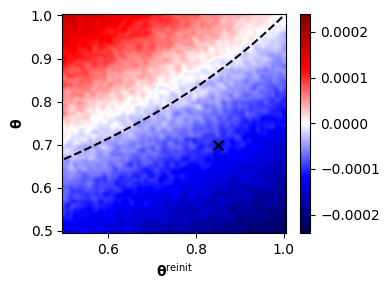

: 

In [ ]:
# PLOT
dx = (theta_reinits[1] - theta_reinits[0]) / 2
dy = (thetas[1] - thetas[0]) / 2
extent = [
    theta_reinits[0] - dx, theta_reinits[-1] + dx,  # x-min, x-max
    thetas[0] - dy, thetas[-1] + dy                 # y-min, y-max
]

plt.figure(figsize=(4, 3))
# ----- Left: bilinear -----
im_l = plt.imshow(
    heatmap[::-1], cmap='seismic',
    vmin=-max_abs_heatmap, vmax=max_abs_heatmap,
    extent=extent, interpolation='bicubic', aspect='auto'
)
plt.colorbar(im_l)
x_pt = np.linspace(theta_reinits[0], theta_reinits[-1], 100)
y_pt = 1 / (2 - x_pt)
plt.plot(x_pt, y_pt, color='black', linestyle='--', label='Theoretical Reaction')
plt.xlabel(r'$\mathbf{\theta}^{\text{reinit}}$')
plt.ylabel(r'$\mathbf{\theta}$', rotation=90)
# axes[0].set_title("Bilinear interpolation")
plt.grid(False)
plt.scatter(0.85, 0.7, color='black', s=50, marker='x')

# ----- Right: no interpolation -----
# im_r = axes[1].imshow(
#     heatmap[::-1], cmap='seismic',
#     vmin=-max_abs_heatmap, vmax=max_abs_heatmap,
#     extent=extent, interpolation='none', aspect='auto'
# )
# plt.colorbar(im_r, ax=axes[1])
# axes[1].plot(x_pt, y_pt, color='black', linestyle='--', label='Theoretical Reaction')
# axes[1].set_xlabel(r'$\mathbf{\theta}^{\text{reinit}}$')
# # axes[1].set_title("No interpolation")
# axes[1].grid(False)

plt.savefig(f'/home/te6653/research/qrm_optimal_execution/plots/heatmap_mr.pdf', bbox_inches='tight')

# Statistics
print("Error on Price Jump Empirical vs Theoretical (in %):")
df_error_jump = np.abs(df_price_jump_emp - df_price_jump_theo) / df_price_jump_theo * 100
print(f"Max Error: {round(np.max(df_error_jump), 3)}%")
print('\n')
print("Error on Price Back to Normal Empirical vs Theoretical (in %):")
df_error_mr = np.abs(df_mr_emp - df_mr_theo) / df_mr_theo * 100
print(f"Max Error: {round(np.max(df_error_mr), 3)}%")
print('\n')

# print("Price Jump Empirical:")
# print(df_price_jump_emp)
# print('\n')
# print("Gap Between Price After Buying and Normal Price Empirical:")
# print(df_mr_emp)
values_mr_emp = df_mr_emp.values
if np.min(values_mr_emp) < 0:
    print("BUYING ALL THE ASK IS PROFITABLE !!!!!!!")
    min_index_flat = np.argmin(values_mr_emp)
    min_coords = np.unravel_index(min_index_flat, values_mr_emp.shape)
    print("Minimum value:", values_mr_emp[min_coords])
    print("Location (row, col):", min_coords)

In [19]:
np.linspace(0.5, 1.0, 20)

array([0.5       , 0.52631579, 0.55263158, 0.57894737, 0.60526316,
       0.63157895, 0.65789474, 0.68421053, 0.71052632, 0.73684211,
       0.76315789, 0.78947368, 0.81578947, 0.84210526, 0.86842105,
       0.89473684, 0.92105263, 0.94736842, 0.97368421, 1.        ])

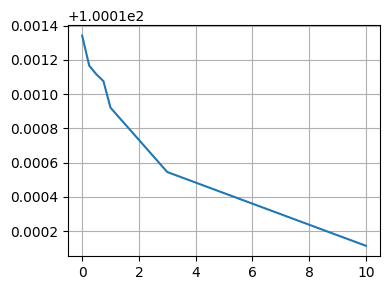

: 

In [ ]:
i = 0
j = 0
prices_arr = all_prices[i, j]
# compute mean price
mean_price = np.nanmean(prices_arr, axis=0)
plt.plot([0, 0.25, 0.5, 0.75, 1.0, 3., 10.], mean_price)

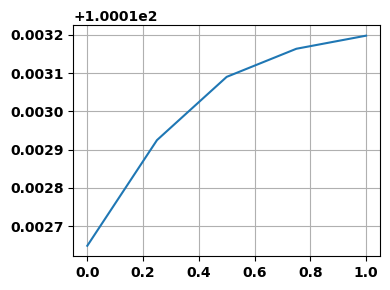

In [23]:
i = 18
j = 2
with open(f'data_wandb/dictionaries/{prefix}_heatmap_t_{i}_tr_{j}.pkl', 'rb') as f:
    dic = pickle.load(f)

# extract mid prices
prices = dic['mid_prices_events']
prices_arr = np.zeros((len(prices), len(prices[0])))
for k, v in prices.items():
    prices_arr[k] = v
# compute mean price
mean_price = np.nanmean(prices_arr, axis=0)
plt.plot([0, 0.25, 0.5, 0.75, 1.0], mean_price)

# STATS: Constant 0 Agent: T = 20_000

## TTS = 3

In [114]:
run_id = 'stats_tts_3'

with open(f'data_wandb/dictionaries/constant_0_{run_id}.pkl', 'rb') as f:
    dic = pickle.load(f)

lob = dic['lob'][0]
print('** Time Simulated', round(lob['time'].iloc[-1]/3600, 2), 'hours \n')
print(f"** Average Inter-event Time {round(np.float64(np.mean(lob['time'].diff().dropna())), 2)} s. (std. {round(np.float64(np.std(lob['time'].diff().dropna())), 2)} s.)")
print('   i.e.', round(1 / np.mean(lob['time'].diff().dropna()), 2), 'events per second in average \n')
price_changes = lob['p_mid'].diff() != 0
change_times = lob.loc[price_changes, 'time'].values
inter_times = np.diff(change_times)
avg_inter_time = inter_times.mean() if len(inter_times) > 0 else np.nan
avg_inter_time = np.float64(avg_inter_time)
std_inter_time = inter_times.std() if len(inter_times) > 0 else np.nan
std_inter_time = np.float64(std_inter_time)
print(f"** Average inter-time between mid price changes: {round(avg_inter_time, 2)} s. (std. {round(std_inter_time, 2)} s.) \n")
price_changes = lob['p_mid'].diff() != 0
change_indices = lob.index[price_changes].to_numpy()
events_between_changes = np.diff(change_indices)
mean_events = events_between_changes.mean() if len(events_between_changes) > 0 else np.nan
std_events = events_between_changes.std() if len(events_between_changes) > 0 else np.nan
print(f"** Mean number of events between mid price changes: {mean_events:.2f} (std. {std_events:.2f}) \n")
lob['second'] = lob['time'].astype(int)
events_per_second = lob.groupby('second').size()
max_events = events_per_second.max()
print(f"** Maximum number of events in a 1-second period: {max_events} (helpful infor for max_events parameters) \n")

** Time Simulated 5.56 hours 

** Average Inter-event Time 0.15 s. (std. 0.15 s.)
   i.e. 6.85 events per second in average 

** Average inter-time between mid price changes: 13.17 s. (std. 29.3 s.) 

** Mean number of events between mid price changes: 90.25 (std. 207.31) 

** Maximum number of events in a 1-second period: 20 (helpful infor for max_events parameters) 



## TTS = 20_000

In [115]:
run_id = 'stats_tts_3_2'

with open(f'data_wandb/dictionaries/constant_0_{run_id}.pkl', 'rb') as f:
    dic = pickle.load(f)

lob = dic['lob'][0]
print('** Time Simulated', round(lob['time'].iloc[-1]/3600, 2), 'hours \n')
print(f"** Average Inter-event Time {round(np.float64(np.mean(lob['time'].diff().dropna())), 2)} s. (std. {round(np.float64(np.std(lob['time'].diff().dropna())), 2)} s.)")
print('   i.e.', round(1 / np.mean(lob['time'].diff().dropna()), 2), 'events per second in average \n')
price_changes = lob['p_mid'].diff() != 0
change_times = lob.loc[price_changes, 'time'].values
inter_times = np.diff(change_times)
avg_inter_time = inter_times.mean() if len(inter_times) > 0 else np.nan
avg_inter_time = np.float64(avg_inter_time)
std_inter_time = inter_times.std() if len(inter_times) > 0 else np.nan
std_inter_time = np.float64(std_inter_time)
print(f"** Average inter-time between mid price changes: {round(avg_inter_time, 2)} s. (std. {round(std_inter_time, 2)} s.) \n")
price_changes = lob['p_mid'].diff() != 0
change_indices = lob.index[price_changes].to_numpy()
events_between_changes = np.diff(change_indices)
mean_events = events_between_changes.mean() if len(events_between_changes) > 0 else np.nan
std_events = events_between_changes.std() if len(events_between_changes) > 0 else np.nan
print(f"** Mean number of events between mid price changes: {mean_events:.2f} (std. {std_events:.2f}) \n")
lob['second'] = lob['time'].astype(int)
events_per_second = lob.groupby('second').size()
max_events = events_per_second.max()
print(f"** Maximum number of events in a 1-second period: {max_events} (helpful infor for max_events parameters) \n")

** Time Simulated 5.56 hours 

** Average Inter-event Time 0.15 s. (std. 0.15 s.)
   i.e. 6.54 events per second in average 

** Average inter-time between mid price changes: 14.25 s. (std. 31.73 s.) 

** Mean number of events between mid price changes: 93.17 (std. 213.44) 

** Maximum number of events in a 1-second period: 18 (helpful infor for max_events parameters) 



CONCLUSION: same metrics observed -> TTS has a negligible influence on the simulations

## Volumes 

In [68]:
import pickle
name_run = 'volumes'
with open(f'data_wandb/dictionaries/front_load_{name_run}.pkl', 'rb') as f:
    dic = pickle.load(f)

In [69]:
dic.keys()

dict_keys(['final_is', 'lob', 'mid_prices', 'mid_prices_events', 'actions', 'executed', 'index_actions', 'ba_vol', 'bb_vol'])

In [70]:
executed = np.array(dic['executed'][0])
np.mean(executed), np.std(executed)

(np.float64(8.2204), np.float64(7.069291608075027))

In [50]:
dic['executed'][0]

[0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,


In [43]:
ba_vols

array(10000)

# NN Inputs Normalization

## Best Ask Volume

Mean Best Ask Volume: 8.356, Std: 6.446
Mean Log1p Best Ask Volume: 2.017, Std: 0.674
Mean Best Bid Volume: 8.163, Std: 6.173
Mean Log1p Best Bid Volume: 2.007, Std: 0.657


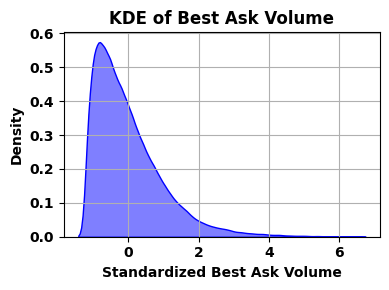

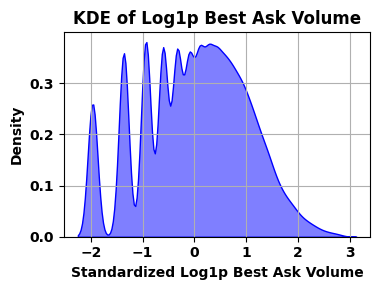

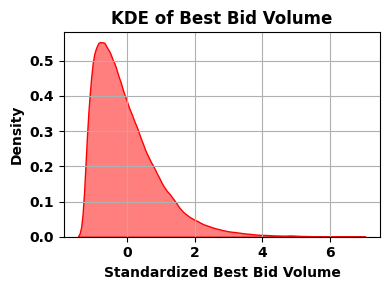

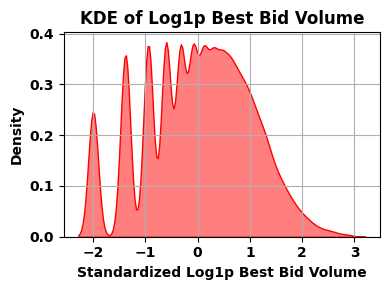

In [192]:
file_name = "best_volume_2_test_best_ask_volume"
with open(f'data_wandb/dictionaries/{file_name}.pkl', 'rb') as f:
    dic = pickle.load(f)

### BEST ASK

ba_vol = dic['ba_vol']
ba_vol_flat = []
for ep, ba_vols in ba_vol.items():
    ba_vol_flat += ba_vols


ba_vol_flat = np.array(ba_vol_flat, dtype=np.float64)
ba_vol_stand = (ba_vol_flat - np.mean(ba_vol_flat)) / np.std(ba_vol_flat)
# kde plot 
import seaborn as sns
plt.figure(figsize=(4, 3))
sns.kdeplot(ba_vol_stand, fill=True, color='blue', alpha=0.5)
plt.title('KDE of Best Ask Volume')
plt.xlabel('Standardized Best Ask Volume')
plt.ylabel('Density')
plt.grid()
plt.tight_layout()
plt.savefig(f'./plots/kde_best_ask_volume.pdf', bbox_inches='tight')
print(f"Mean Best Ask Volume: {np.mean(ba_vol_flat):.3f}, Std: {np.std(ba_vol_flat):.3f}")


log1p_ba_vol = np.log1p(ba_vol_flat)
log1p_ba_vol_stand = (log1p_ba_vol - np.mean(log1p_ba_vol)) / np.std(log1p_ba_vol)
# kde plot
plt.figure(figsize=(4, 3))
sns.kdeplot(log1p_ba_vol_stand, fill=True, color='blue', alpha=0.5)
plt.title('KDE of Log1p Best Ask Volume')
plt.xlabel('Standardized Log1p Best Ask Volume')
plt.ylabel('Density')
plt.grid()
plt.tight_layout()
plt.savefig(f'./plots/kde_log1p_best_ask_volume.pdf', bbox_inches='tight')
print(f"Mean Log1p Best Ask Volume: {np.mean(log1p_ba_vol):.3f}, Std: {np.std(log1p_ba_vol):.3f}")

### BEST BID

bb_vol = dic['bb_vol']
bb_vol_flat = []
for ep, bb_vols in bb_vol.items():
    bb_vol_flat += bb_vols

bb_vol_flat = np.array(bb_vol_flat, dtype=np.float64)
bb_vol_stand = (bb_vol_flat - np.mean(bb_vol_flat)) / np.std(bb_vol_flat)
# kde plot
plt.figure(figsize=(4, 3))
sns.kdeplot(bb_vol_stand, fill=True, color='red', alpha=0.5)
plt.title('KDE of Best Bid Volume')
plt.xlabel('Standardized Best Bid Volume')
plt.ylabel('Density')
plt.grid()
plt.tight_layout()  
print(f"Mean Best Bid Volume: {np.mean(bb_vol_flat):.3f}, Std: {np.std(bb_vol_flat):.3f}")

log1p_bb_vol = np.log1p(bb_vol_flat)
log1p_bb_vol_stand = (log1p_bb_vol - np.mean(log1p_bb_vol)) / np.std(log1p_bb_vol)
# kde plot
plt.figure(figsize=(4, 3))
sns.kdeplot(log1p_bb_vol_stand, fill=True, color='red', alpha=0.5)
plt.title('KDE of Log1p Best Bid Volume')
plt.xlabel('Standardized Log1p Best Bid Volume')
plt.ylabel('Density')
plt.grid()
plt.tight_layout()
print(f"Mean Log1p Best Bid Volume: {np.mean(log1p_bb_vol):.3f}, Std: {np.std(log1p_bb_vol):.3f}")


CONCLUSION: same normalization can be applied to best bid and best ask. Also regardless of the action space !

## Prices

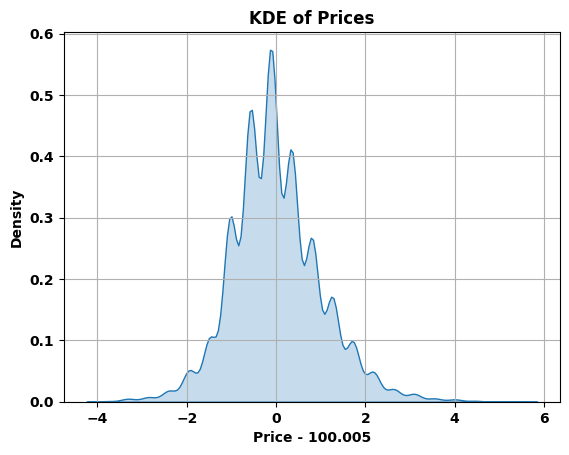

(Prices-100.005): Mean 0.0174, std 0.0219


In [191]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd 

# prices of run yf52szb3

df = pd.read_csv('wandb_export_2025-08-12T15_37_06.011+02_00.csv')
prices = df.iloc[:, 1].values - 100.005

sns.kdeplot((prices - prices.mean()) / prices.std(), fill=True)
plt.title('KDE of Prices')
plt.xlabel('Price - 100.005')
plt.ylabel('Density')
plt.grid()
plt.show()
print(f'(Prices-100.005): Mean {prices.mean():.4f}, std {prices.std():.4f}')

## Deprecated

(np.float64(2.133328491276248), np.float64(0.8318954004089124))

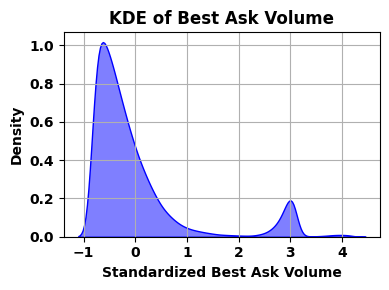

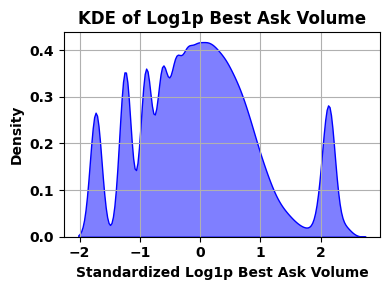

In [ ]:
file_name = "best_volume_test_best_ask_volume"
with open(f'data_wandb/dictionaries/{file_name}.pkl', 'rb') as f:
    dic = pickle.load(f)

ba_vol = dic['ba_vol']
ba_vol_flat = []
for ep, ba_vols in ba_vol.items():
    ba_vol_flat += ba_vols

ba_vol_flat = np.array(ba_vol_flat, dtype=np.float64)
ba_vol_stand = (ba_vol_flat - np.mean(ba_vol_flat)) / np.std(ba_vol_flat)
# kde plot 
import seaborn as sns
plt.figure(figsize=(4, 3))
sns.kdeplot(ba_vol_stand, fill=True, color='blue', alpha=0.5)
plt.title('KDE of Best Ask Volume')
plt.xlabel('Standardized Best Ask Volume')
plt.ylabel('Density')
plt.grid()
plt.tight_layout()

log1p_ba_vol = np.log1p(ba_vol_flat)
log1p_ba_vol_stand = (log1p_ba_vol - np.mean(log1p_ba_vol)) / np.std(log1p_ba_vol)
# kde plot
plt.figure(figsize=(4, 3))
sns.kdeplot(log1p_ba_vol_stand, fill=True, color='blue', alpha=0.5)
plt.title('KDE of Log1p Best Ask Volume')
plt.xlabel('Standardized Log1p Best Ask Volume')
plt.ylabel('Density')
plt.grid()
plt.tight_layout()
np.mean(log1p_ba_vol), np.std(log1p_ba_vol)

# Feature Importance

## Test

In [45]:
import os 
import torch
import shap
import pandas as pd
from stable_baselines3 import DQN, PPO
import zipfile

In [51]:
run_id = "gy8m4ozk"  # Replace this with your actual run ID

load_model_path = f"save_model/ddqn_{run_id}.zip"
base_output_dir = "shap_plots"
data_path = os.path.join(base_output_dir, run_id, "shap_data.npz")
output_dir = os.path.join(base_output_dir, run_id)
device = "cuda"

# Load the data
with np.load(data_path) as data:
    sample_states = data["sample_states"]
    background = data["background"]


with zipfile.ZipFile(load_model_path, "r") as zip_ref:
    zip_ref.extractall("save_model")  # extract to a folder
state_dict = torch.load("save_model/policy.pth", map_location=torch.device('cpu'))
model = DQN(policy='MlpPolicy', env=None)
model.policy.load_state_dict(state_dict)
model.policy.eval()

# custom_objects = {"n_steps": 1,}
# model = DQN.load(load_model_path, n_steps=5)

q_net = model.policy.q_net

# Wrapper
def model_predict(x):
    with torch.no_grad():
        x_t = torch.tensor(x, dtype=torch.float32, device=device)
        return q_net(x_t).cpu().numpy()

# KernelExplainer
explainer = shap.KernelExplainer(model_predict, background)

# Compute SHAP values (limit to 100 states for speed)
shap_values = explainer.shap_values(sample_states)

print("shap_values shape:", np.array(shap_values).shape)

# Iterate over both actions
feature_names = ["inventory", "time", "ask_price"]

# Gradient feature importance
states_t = torch.tensor(background, dtype=torch.float32, device=device, requires_grad=True)
num_actions = q_net(states_t).shape[1]  # Number of actions

gradient_importances = []

for action_idx in range(num_actions):
    q_vals = q_net(states_t)[:, action_idx].sum()
    grads = torch.autograd.grad(q_vals, states_t, retain_graph=True)[0]  # shape (N, num_features)
    gradient_importances.append(np.abs(grads.detach().cpu().numpy()).mean(axis=0))

gradient_importances = np.array(gradient_importances)  # shape (num_actions, num_features)


for action_idx in range(shap_values.shape[2]):
    values = shap_values[:, :, action_idx]
    shap_importance = np.abs(values).mean(0)
    grad_importance = gradient_importances[action_idx]

    df_compare = pd.DataFrame({
        "feature": feature_names,
        "SHAP": shap_importance,
        "Gradient": grad_importance
    }).sort_values("SHAP", ascending=False)

    print(f"\n=== Action {action_idx} Feature Importance ===")
    print(df_compare)

    # SHAP summary plot
    fig = plt.figure()
    shap.summary_plot(values, sample_states, feature_names=feature_names, 
                    title=f"SHAP Values for Action {action_idx}", show=False)
    fig.tight_layout()
    plt.savefig(os.path.join(output_dir, f"summary_action_{action_idx}.pdf"), bbox_inches='tight')
    plt.close(fig)

    fig = plt.figure()
    shap_values_obj = shap.Explanation(
        values=values,
        data=sample_states,
        feature_names=feature_names
    )
    shap.plots.bar(shap_values_obj, show=False)
    fig.tight_layout()
    plt.savefig(os.path.join(output_dir, f"bar_action_{action_idx}.pdf"), bbox_inches='tight')
    plt.close(fig)

    for feat in shap_values_obj.feature_names:
        fig = plt.figure()
        shap.plots.scatter(shap_values_obj[:, feat], color=shap_values_obj, show=False)
        fig.tight_layout() 
        plt.savefig(os.path.join(output_dir, f"scatter_action_{action_idx}_{feat}.pdf"), bbox_inches='tight')
        plt.close(fig)

    # Gradient bar plot
    plt.figure()
    plt.bar(feature_names, grad_importance)
    plt.title(f"Gradient-based Feature Importance (Action {action_idx})")
    plt.ylabel("Mean |∂Q/∂s|")
    plt.tight_layout()
    plt.savefig(os.path.join(output_dir, f"grad_bar_action_{action_idx}.pdf"), bbox_inches='tight')
    plt.close()

AttributeError: 'DQN' object has no attribute 'observation_space'

## Shapley

  0%|          | 0/100 [00:00<?, ?it/s]

shap_values shape: (100, 4, 2)

=== Action 0 Feature Importance ===
    feature  importance
0  cart_pos    0.287984
2  pole_ang    0.062877
1  cart_vel    0.059442
3  pole_vel    0.058157


C:\Users\etoma\AppData\Local\Temp\ipykernel_11916\1091744111.py:55: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(values, sample_states, feature_names=feature_names,


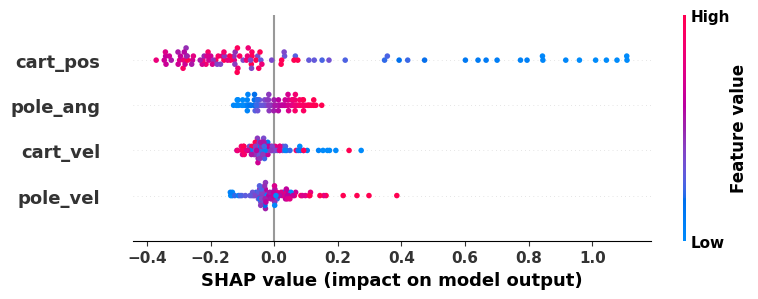

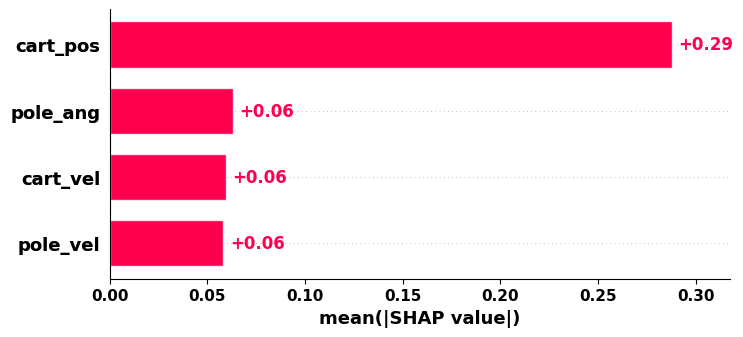

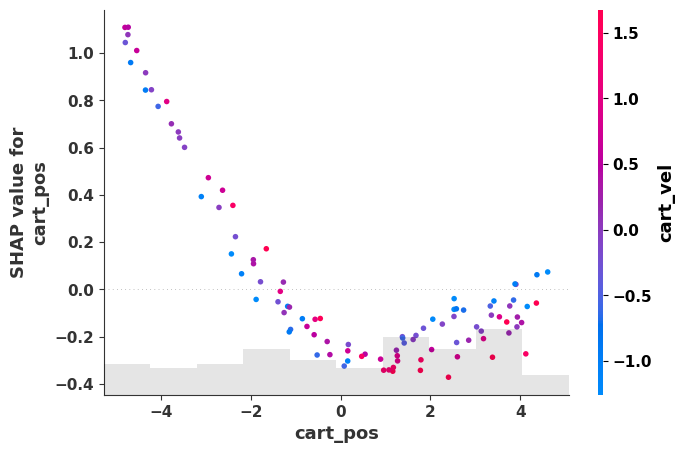

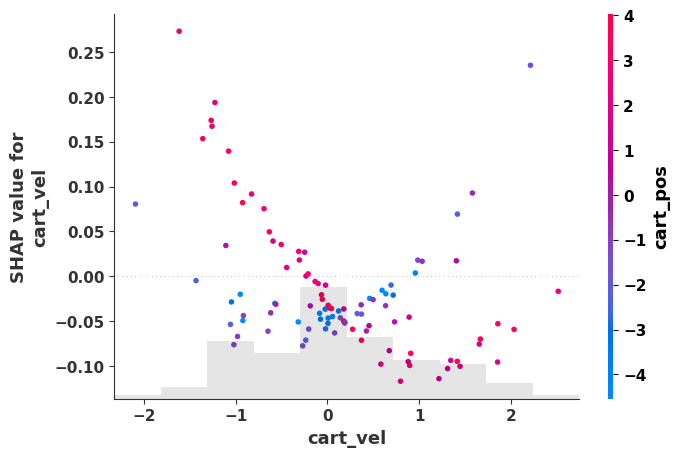

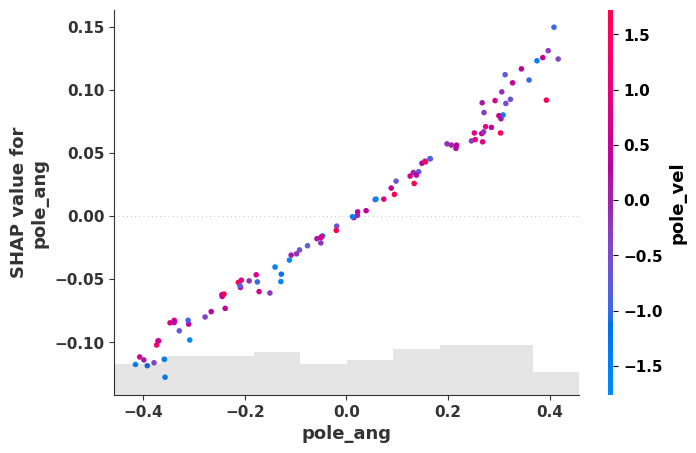

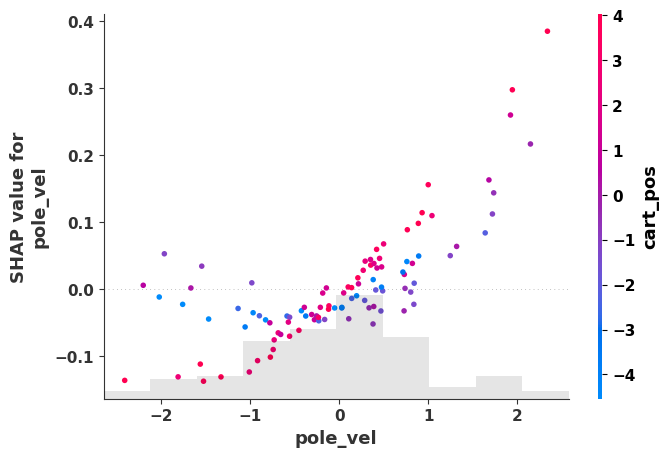


=== Action 1 Feature Importance ===
    feature  importance
0  cart_pos    0.473855
3  pole_vel    0.071025
1  cart_vel    0.062572
2  pole_ang    0.055913


C:\Users\etoma\AppData\Local\Temp\ipykernel_11916\1091744111.py:55: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(values, sample_states, feature_names=feature_names,


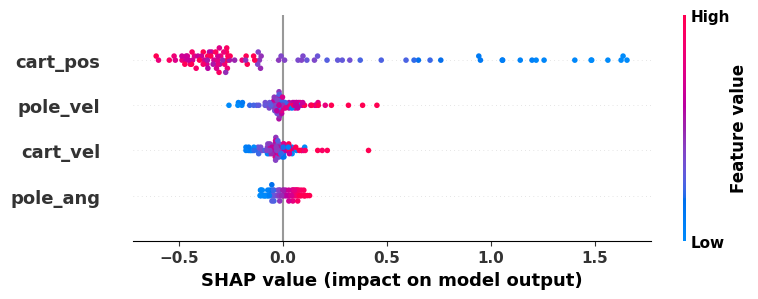

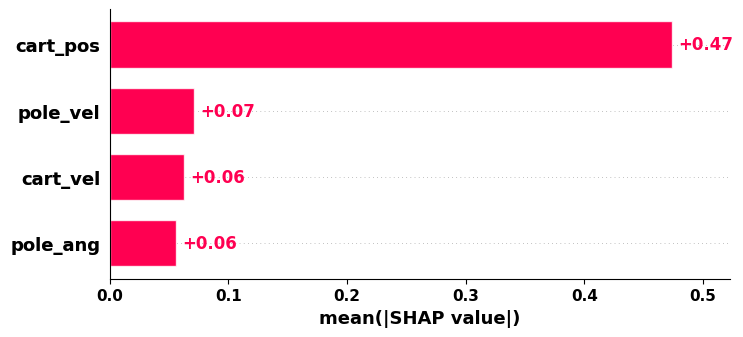

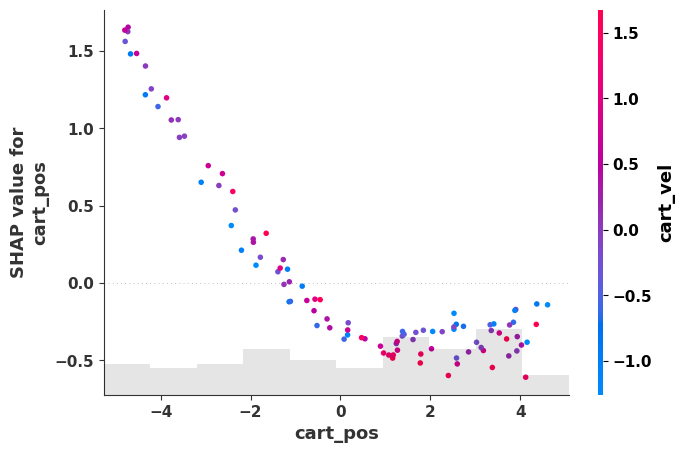

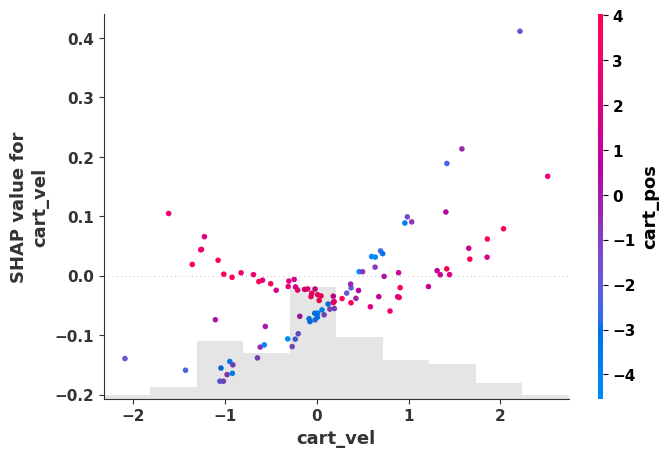

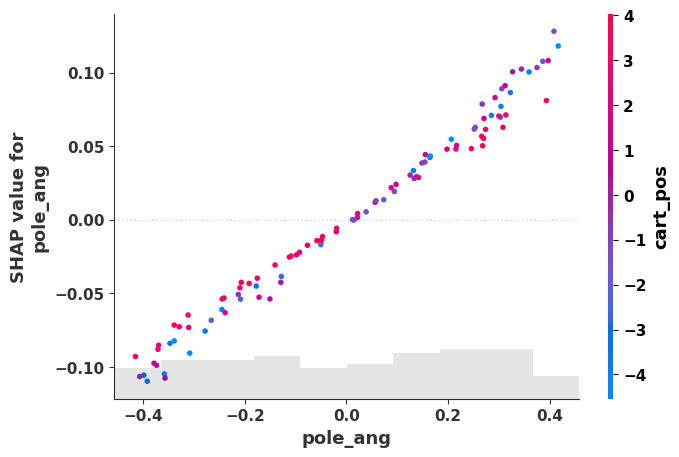

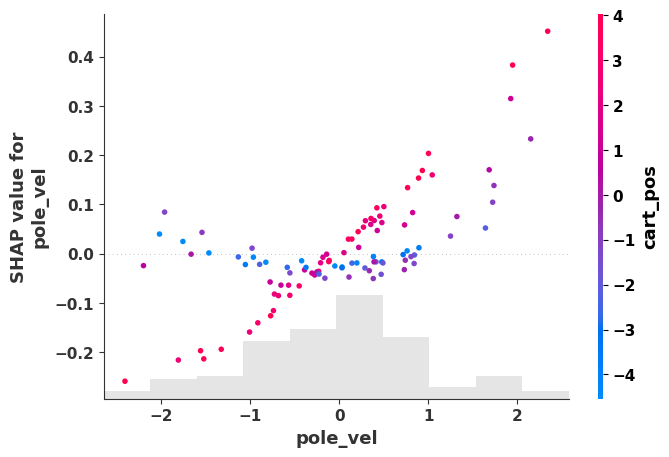

In [ ]:
import numpy as np
import torch
import shap
import pandas as pd
from stable_baselines3 import DQN
import gymnasium as gym

# 1. Train SB3 DQN
env = gym.make("CartPole-v1")
model = DQN("MlpPolicy", env, verbose=0)
model.learn(10_000)


buffer = model.replay_buffer
obs = buffer.observations[:buffer.size].squeeze(-1).astype(np.float32)  # shape: (N, state_dim)

sample_size = 3000
background_size = 6000

end_idx = buffer.size
sample_start = max(0, end_idx - sample_size)
bg_start = max(0, sample_start - background_size)

# Slice the buffer
sample_states = obs[sample_start:end_idx]
background = obs[bg_start:sample_start]

# Q-network prediction function
q_net = model.policy.q_net

# Wrapper
def model_predict(x):
    with torch.no_grad():
        x_t = torch.tensor(x, dtype=torch.float32)
        return q_net(x_t).cpu().numpy()

# KernelExplainer
explainer = shap.KernelExplainer(model_predict, background)

# Compute SHAP values (limit to 100 states for speed)
shap_values = explainer.shap_values(sample_states)

print("shap_values shape:", np.array(shap_values).shape)

# Iterate over both actions
feature_names = ["cart_pos", "cart_vel", "pole_ang", "pole_vel"]

for action_idx in range(shap_values.shape[2]):
    values = shap_values[:, :, action_idx]

    # Compute mean absolute importance
    importance = np.abs(values).mean(0)

    importance_df = pd.DataFrame({
        'feature': feature_names,
        'importance': importance
    }).sort_values('importance', ascending=False)

    print(f"\n=== Action {action_idx} Feature Importance ===")
    print(importance_df)

    # SHAP summary plot
    shap.summary_plot(values, sample_states, feature_names=feature_names, 
                      title=f"SHAP Values for Action {action_idx}")

    shap_values_obj = shap.Explanation(
        values=values,
        data=sample_states,
        feature_names=feature_names
    )
    shap.plots.bar(shap_values_obj)

    for feat in shap_values_obj.feature_names:
        shap.plots.scatter(shap_values_obj[:, feat], color=shap_values_obj)



In [3]:
import numpy as np
import torch
import shap
import pandas as pd
from stable_baselines3 import DQN
import gymnasium as gym

# 1. Train SB3 DQN
env = gym.make("CartPole-v1")
model = DQN("MlpPolicy", env, verbose=0)
model.learn(10_000)


c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/attr_value.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framework/tensor.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
c:\Users\etoma\AppData\Local\Programs\Python\Python313\Lib\site-packages\google\protobuf\runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.0 at tensorflow/core/framewo

In [2]:
import os 
import matplotlib.pyplot as plt

In [1]:
import matplotlib
matplotlib.use("Agg") 

In [4]:


# 2. Collect some states
states = np.array([env.observation_space.sample() for _ in range(1000)], dtype=np.float32)

# 3. Background
background = states[np.random.choice(len(states), min(500, len(states)), replace=False)]

# 4. Q-network prediction function
q_net = model.policy.q_net

def model_predict(x):
    with torch.no_grad():
        x_t = torch.tensor(x, dtype=torch.float32)
        return q_net(x_t).cpu().numpy()  # shape: (N, 2) for 2 actions

# 5. KernelExplainer
explainer = shap.KernelExplainer(model_predict, background)

# 6. Compute SHAP values (limit to 100 states for speed)
sample_states = states[:300]
shap_values = explainer.shap_values(sample_states)

print("shap_values shape:", np.array(shap_values).shape)  # (100, 4, 2) in your case

# 7. Iterate over both actions
feature_names = ["cart_pos", "cart_vel", "pole_ang", "pole_vel"]

base_output_dir = "shap_plots"
os.makedirs(base_output_dir, exist_ok=True)
output_dir = os.path.join(base_output_dir, "test_cartpole")
os.makedirs(output_dir, exist_ok=True)

for action_idx in range(shap_values.shape[2]):
    # Extract (N, 4) slice for this action
    values = shap_values[:, :, action_idx]

    # Compute mean absolute importance
    importance = np.abs(values).mean(0)

    importance_df = pd.DataFrame({
        'feature': feature_names,
        'importance': importance
    }).sort_values('importance', ascending=False)

    print(f"\n=== Action {action_idx} Feature Importance ===")
    print(importance_df)

    # SHAP summary plot
    fig = plt.figure()
    shap.summary_plot(values, sample_states, feature_names=feature_names, 
                      title=f"SHAP Values for Action {action_idx}", show=False)
    fig.tight_layout()
    plt.savefig(os.path.join(output_dir, f"summary_action_{action_idx}.pdf"), bbox_inches='tight')
    plt.close(fig)

    shap_values_obj = shap.Explanation(
        values=values,
        data=sample_states,
        feature_names=feature_names
    )
    fig = plt.figure()
    shap.plots.bar(shap_values_obj, show=False)
    fig.tight_layout()
    plt.savefig(os.path.join(output_dir, f"bar_action_{action_idx}.pdf"), bbox_inches='tight')
    plt.close(fig)

    for feat in shap_values_obj.feature_names:
        fig = plt.figure()
        shap.plots.scatter(shap_values_obj[:, feat], color=shap_values_obj, show=False)
        fig.tight_layout()
        plt.savefig(os.path.join(output_dir, f"scatter_action_{action_idx}_{feat}.pdf"), bbox_inches='tight')
        plt.close(fig)



Using 500 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


  0%|          | 0/300 [00:00<?, ?it/s]

shap_values shape: (300, 4, 2)

=== Action 0 Feature Importance ===
    feature  importance
0  cart_pos    0.231970
1  cart_vel    0.064938
3  pole_vel    0.032141
2  pole_ang    0.024999

=== Action 1 Feature Importance ===
    feature  importance
0  cart_pos    0.225304
1  cart_vel    0.063519
3  pole_vel    0.030283
2  pole_ang    0.024066


In [5]:
import pandas as pd
df = pd.read_csv('wandb_export_2025-08-04T16_34_04.083+02_00.csv')

In [9]:
prices = df.iloc[:, 1].to_numpy() - 100.005
prices.mean(), (prices-prices.mean()).std()

(np.float64(0.017727000000005124), np.float64(0.021651638991078817))

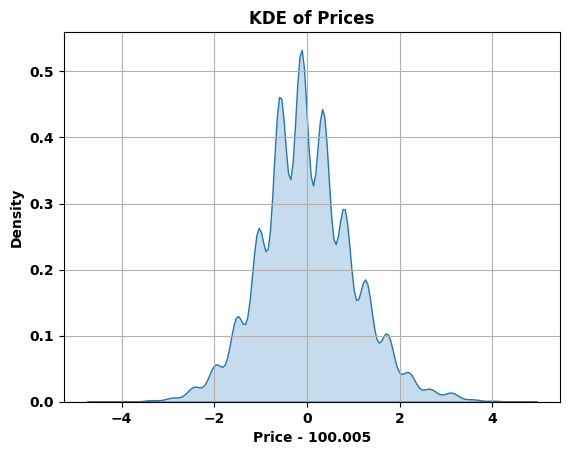

In [11]:
#kde plot of prices
import seaborn as sns
sns.kdeplot((prices - prices.mean()) / prices.std(), fill=True)
import matplotlib.pyplot as plt
plt.title('KDE of Prices')
plt.xlabel('Price - 100.005')
plt.ylabel('Density')
plt.grid()
plt.show()

Using 500 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


  0%|          | 0/300 [00:00<?, ?it/s]

shap_values shape: (300, 4, 2)

=== Action 0 Feature Importance ===
    feature  importance
0  cart_pos    0.307120
1  cart_vel    0.057352
3  pole_vel    0.050842
2  pole_ang    0.036731


C:\Users\etoma\AppData\Local\Temp\ipykernel_11916\2904410278.py:49: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(values, sample_states, feature_names=feature_names,



=== Action 1 Feature Importance ===
    feature  importance
0  cart_pos    0.312468
1  cart_vel    0.053168
3  pole_vel    0.045102
2  pole_ang    0.031124


C:\Users\etoma\AppData\Local\Temp\ipykernel_11916\2904410278.py:49: FutureWarning: The NumPy global RNG was seeded by calling `np.random.seed`. In a future version this function will no longer use the global RNG. Pass `rng` explicitly to opt-in to the new behaviour and silence this warning.
  shap.summary_plot(values, sample_states, feature_names=feature_names,


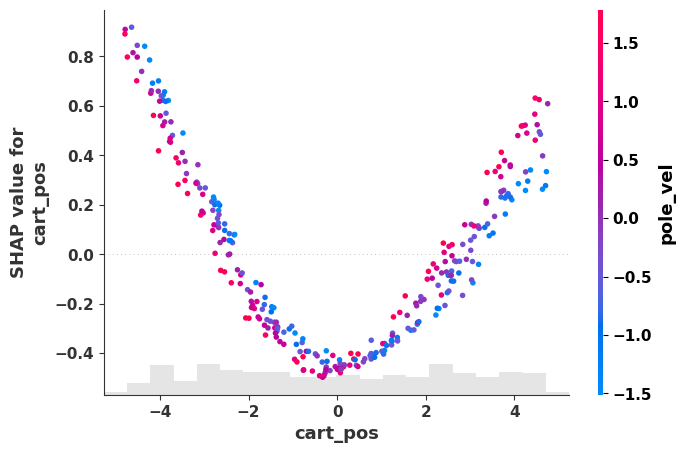

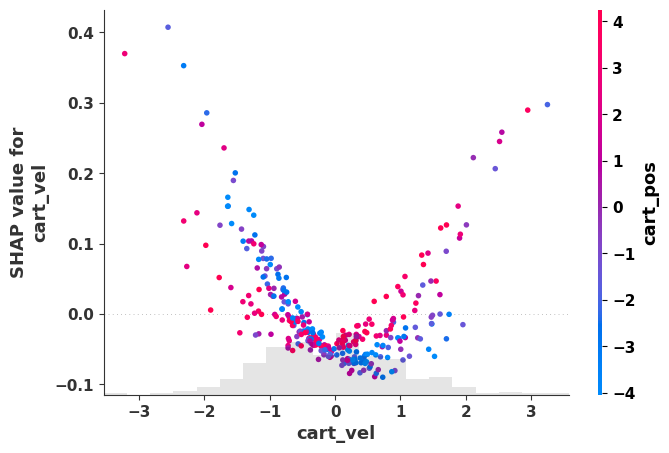

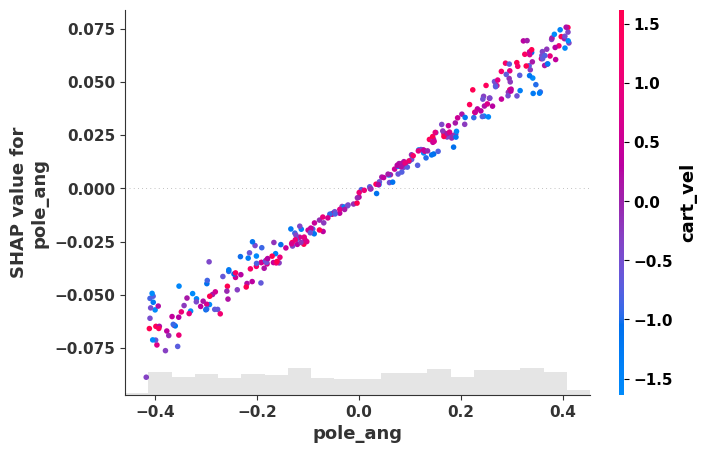

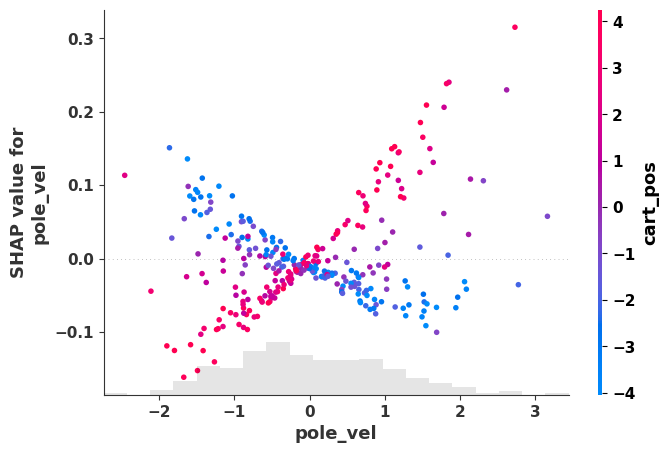

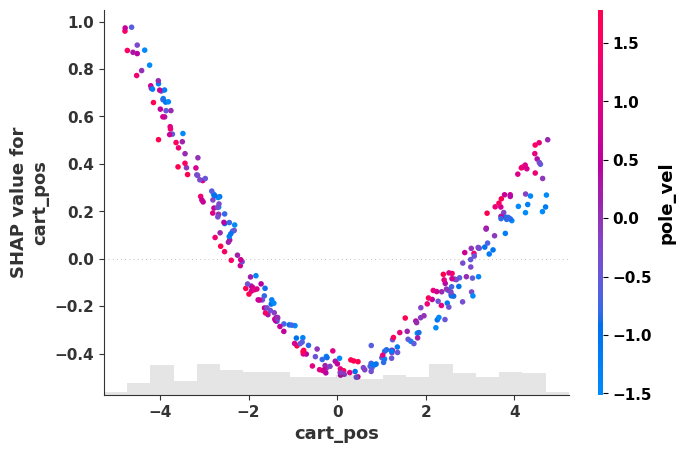

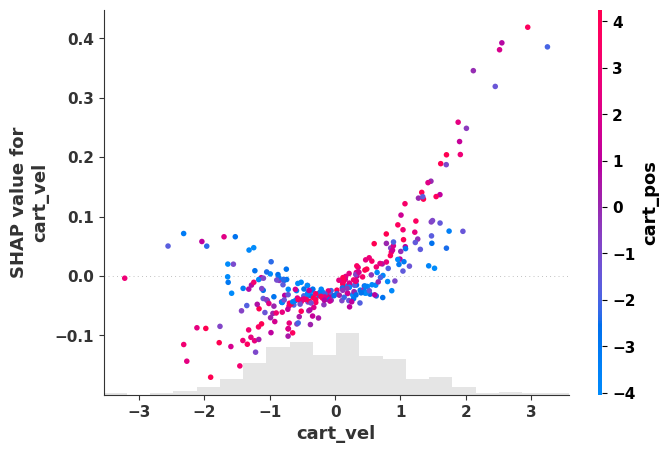

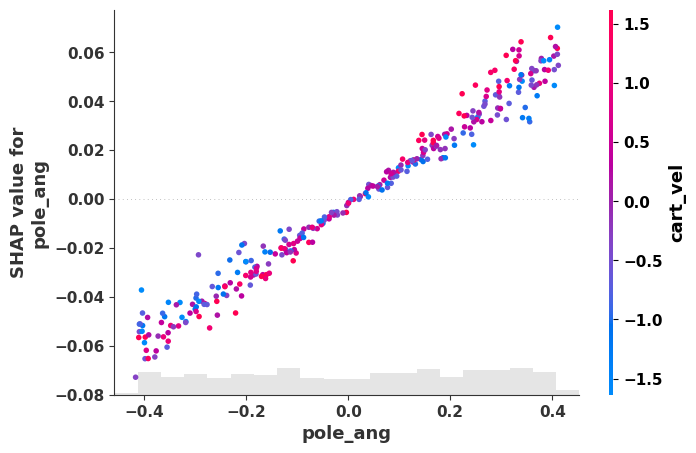

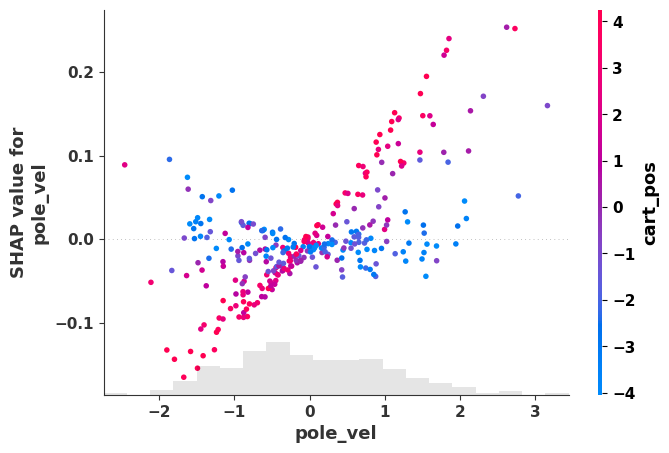

In [ ]:

# 2. Collect some states
states = np.array([env.observation_space.sample() for _ in range(1000)], dtype=np.float32)

# 3. Background
background = states[np.random.choice(len(states), min(500, len(states)), replace=False)]

# 4. Q-network prediction function
q_net = model.policy.q_net

def model_predict(x):
    with torch.no_grad():
        x_t = torch.tensor(x, dtype=torch.float32)
        return q_net(x_t).cpu().numpy()  # shape: (N, 2) for 2 actions

# 5. KernelExplainer
explainer = shap.KernelExplainer(model_predict, background)

# 6. Compute SHAP values (limit to 100 states for speed)
sample_states = states[:300]
shap_values = explainer.shap_values(sample_states)

print("shap_values shape:", np.array(shap_values).shape)  # (100, 4, 2) in your case

# 7. Iterate over both actions
feature_names = ["cart_pos", "cart_vel", "pole_ang", "pole_vel"]

base_output_dir = "shap_plots"
os.makedirs(base_output_dir, exist_ok=True)
output_dir = os.path.join(base_output_dir, "test_cartpole")
os.makedirs(output_dir, exist_ok=True)

for action_idx in range(shap_values.shape[2]):
    # Extract (N, 4) slice for this action
    values = shap_values[:, :, action_idx]

    # Compute mean absolute importance
    importance = np.abs(values).mean(0)

    importance_df = pd.DataFrame({
        'feature': feature_names,
        'importance': importance
    }).sort_values('importance', ascending=False)

    print(f"\n=== Action {action_idx} Feature Importance ===")
    print(importance_df)

    # SHAP summary plot
    fig = plt.figure()
    shap.summary_plot(values, sample_states, feature_names=feature_names, 
                      title=f"SHAP Values for Action {action_idx}", show=False)
    fig.tight_layout()
    plt.savefig(os.path.join(output_dir, f"summary_action_{action_idx}.pdf"), bbox_inches='tight')
    plt.close(fig)

    shap_values_obj = shap.Explanation(
        values=values,
        data=sample_states,
        feature_names=feature_names
    )
    fig = plt.figure()
    shap.plots.bar(shap_values_obj, show=False)
    fig.tight_layout()
    plt.savefig(os.path.join(output_dir, f"bar_action_{action_idx}.pdf"), bbox_inches='tight')
    plt.close(fig)

    for feat in shap_values_obj.feature_names:
        fig = plt.figure()
        shap.plots.scatter(shap_values_obj[:, feat], color=shap_values_obj, show=False)
        fig.tight_layout()
        plt.savefig(os.path.join(output_dir, f"scatter_action_{action_idx}_{feat}.pdf"), bbox_inches='tight')
        plt.close(fig)



# Almgren Chriss Plot

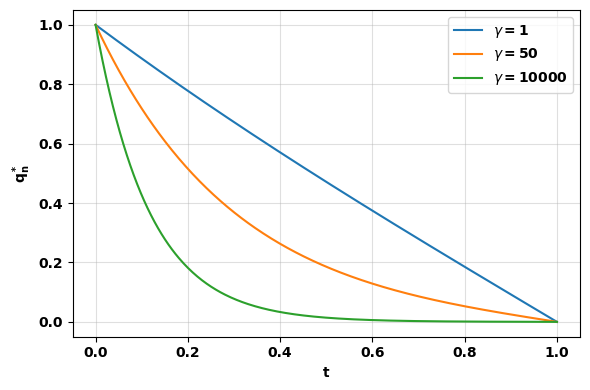

In [20]:
import numpy as np
import matplotlib.pyplot as plt

# ----- Parameters (all unknowns set to 1) -----
T = 1.0
q0 = 1.0
dt = 1.0
sigma2 = 1.0
V = 1.0
eta = 1.0

gammas = [1, 50, 10000]

# ----- Helper: solve for alpha via robust bisection -----
def alpha_from_gamma(gamma, dt=1.0, sigma2=1.0, V=1.0, eta=1.0, tol=1e-12, max_iter=200):
    """
    Solve for alpha>0 from:
        2 (cosh(alpha*dt) - 1) = (gamma * sigma^2 * V / (2*eta)) * dt^2
    using bisection (monotone in alpha for alpha>=0).
    """
    rhs = (gamma * sigma2 * V / (2.0 * eta)) * (dt ** 2)

    def f(a):
        return 2.0 * (np.cosh(a * dt) - 1.0) - rhs

    # f(0) <= 0; find an upper bound with f(hi) > 0
    lo, hi = 0.0, 1.0
    while f(hi) <= 0.0:
        hi *= 2.0
        if hi > 1e6:
            raise RuntimeError("Failed to bracket the root for alpha.")

    # Bisection
    for _ in range(max_iter):
        mid = 0.5 * (lo + hi)
        if f(mid) > 0:
            hi = mid
        else:
            lo = mid
        if abs(hi - lo) < tol:
            break

    return 0.5 * (lo + hi)

# ----- Time grid and plot -----
t = np.linspace(0.0, T, 400)

plt.figure(figsize=(6, 4))
for g in gammas:
    alpha = alpha_from_gamma(gamma=g, dt=dt, sigma2=sigma2, V=V, eta=eta)
    q_star = q0 * np.sinh(alpha * (T - t)) / np.sinh(alpha * T)
    plt.plot(t, q_star, label=rf"$\gamma={g}$")

plt.xlabel(r"$\mathbf{t}$")
plt.ylabel(r"$\mathbf{q_n^*}$")
plt.legend()
plt.grid(True, alpha=0.4)
plt.tight_layout()
plt.savefig("./plots/ac_plot.pdf", bbox_inches="tight")  # uncomment to save
plt.show()


# Tests 11/09/2025

pi shape (3, 51)


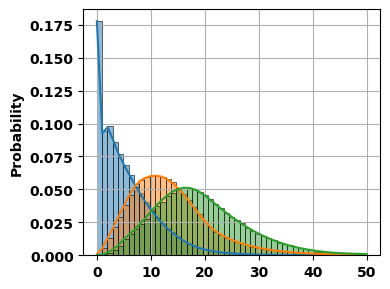

In [108]:
pi = np.load('calibration_data/invariant_distribution/qrm_paper.npy')
print('pi shape', pi.shape)
K = 3 
Q1 = 51
plt.figure(figsize=(4, 3))
for i in range(K):
        pi_i = pi[i]
        arr = np.zeros(100000)
        for k in range(len(arr)):
                u = np.random.random()
                cum = 0.0
                for q in range(Q1):
                        cum += pi[i, q]
                        if u < cum:
                                arr[k] = q
                                break
        
        sns.histplot(arr, bins=pi.shape[1], stat='probability', alpha=0.5, label=f"State {i}")
        plt.plot(pi_i)

pi shape (3, 51)


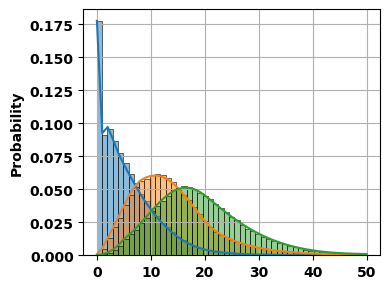

In [59]:
pi = np.load('calibration_data/invariant_distribution/qrm_paper.npy')
print('pi shape', pi.shape)
K = 3 
plt.figure(figsize=(4, 3))
for i in range(K):
        pi_i = pi[i]
        arr = np.random.choice(np.arange(len(pi_i)), p=pi_i/pi_i.sum(), size=100000)
        sns.histplot(arr, bins=pi.shape[1], stat='probability', alpha=0.5, label=f"State {i}")
        plt.plot(pi_i)

Invariant distribution has been checked ! 

intens_shape (3, 51, 2, 3)


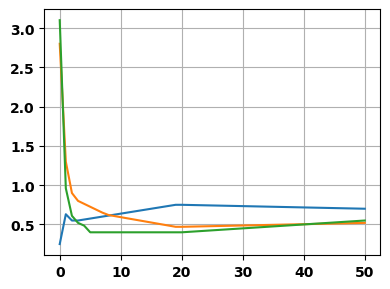

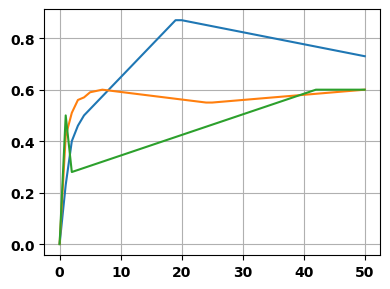

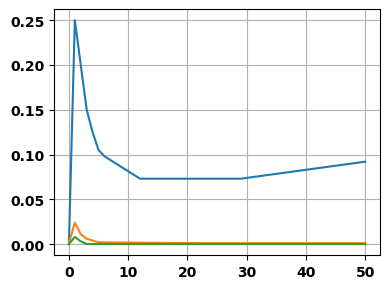

In [60]:
intens = np.load('calibration_data/intensity_table/qrm_paper.npy')
print('intens_shape', intens.shape)
intens_ask = intens[:, :, 0, :]
for i in range(3):
    plt.figure()
    for k in range(K):
        plt.plot(intens_ask[k,:, i], label=f'Type {i}')

        
# K = 3 
# plt.figure(figsize=(4, 3))

In [64]:
from src.qrm_core.intensity import IntensityTable

In [70]:
inten_arr = np.load("calibration_data/intensity_table/" + 'qrm_paper.npy')
K, Q1, *_ = inten_arr.shape
inten_table = IntensityTable(max_depth=K, max_queue=Q1-1)
inten_table._data = inten_arr
# this has been checked to be correct
all_rates = np.transpose(inten_table._data, (2,0,1,3)).copy()
all_rates.shape

(2, 3, 51, 3)

In [71]:
np.argmin([0,1,2,5])

np.int64(0)

Intensities are good ! 

In [21]:
import pandas as pd 

## Data for propagator model

### Invariant : ($\theta=0., \theta^{reinit}=0.$)

ergodic process, no price change

In [2]:
# pd.set_option("mode.dtype_backend", "pyarrow")
df = pd.read_parquet('simulations/lob_invariant.parquet')
print(len(df))
df.head()

30774345


,time,p_mid,side,event,q_bid3,q_bid2,q_bid1,q_ask1,q_ask2,q_ask3
0,0.034607,100.005,bid,limit,23,29,3,5,7,11
1,0.209744,100.005,bid,cancel,23,28,3,5,7,11
2,0.218871,100.005,bid,cancel,23,27,3,5,7,11
3,0.280412,100.005,ask,limit,23,27,3,5,7,12
4,0.308530,100.005,bid,cancel,23,26,3,5,7,12


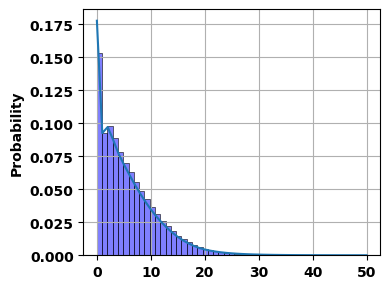

In [10]:
depth_1 = np.concatenate((df.q_ask1.to_numpy(), df.q_bid1.to_numpy()))

sns.histplot(depth_1, bins=51, stat='probability', label='Depth 1', color='blue', alpha=0.5)
pi = np.load('calibration_data/invariant_distribution/qrm_paper.npy')
plt.plot(pi[0])

<Axes: ylabel='Probability'>

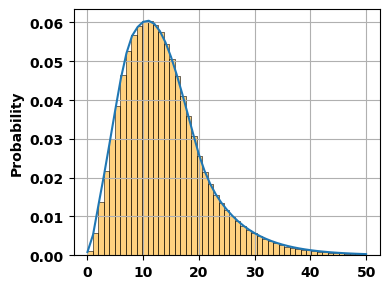

In [ ]:
depth_2 = np.concatenate((df.q_ask2.to_numpy(), df.q_bid2.to_numpy()))

pi = np.load('calibration_data/invariant_distribution/qrm_paper.npy')
plt.plot(pi[1])
sns.histplot(depth_2, bins=51, stat='probability', label='Depth 2', color='orange', alpha=0.5)

<Axes: ylabel='Probability'>

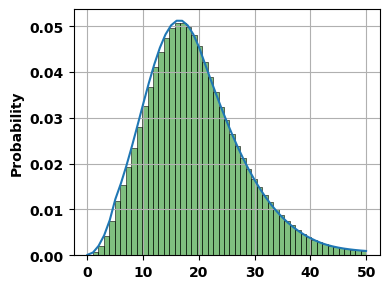

In [4]:
depth_3 = np.concatenate((df.q_ask3.to_numpy(), df.q_bid3.to_numpy()))
pi = np.load('calibration_data/invariant_distribution/qrm_paper.npy')
plt.plot(pi[2])
sns.histplot(depth_3, bins=51, stat='probability', label='Depth 2', color='green', alpha=0.5)

### Mean reversion : ($\theta=0.7, \theta^{reinit}=0.85$)

prices mean revert after buying the best ask

In [53]:
# pd.set_option("mode.dtype_backend", "pyarrow")
df = pd.read_parquet('simulations/lob_mean_reversion.parquet')
print(len(df))
df

65022165


,time,p_mid,side,event,q_bid3,q_bid2,q_bid1,q_ask1,q_ask2,q_ask3
0,3.460748e-02,100.005,bid,limit,23,29,3,5,7,11
1,2.097439e-01,100.005,bid,cancel,23,28,3,5,7,11
2,2.188706e-01,100.005,bid,cancel,23,27,3,5,7,11
3,2.804118e-01,100.005,ask,limit,23,27,3,5,7,12
4,3.085297e-01,100.005,bid,cancel,23,26,3,5,7,12
...,...,...,...,...,...,...,...,...,...,...
65022160,9.999999e+06,102.835,ask,limit,32,6,14,5,16,21
65022161,9.999999e+06,102.835,bid,limit,32,7,14,5,16,21
65022162,9.999999e+06,102.835,bid,limit,32,7,15,5,16,21
65022163,1.000000e+07,102.835,bid,market,32,7,14,5,16,21


In [54]:
len(df[df.event == 'market']), len(df[df.event == 'market']) / len(df) * 100

(2123397, 3.265651028383936)

In [56]:
import numpy as np
import pandas as pd

def extract_market_orders(df: pd.DataFrame, price_col: str = "price") -> pd.DataFrame:
    """
    Returns a DataFrame with:
      - time:      event time of each market order
      - sign:      +1 if side=='ask' (buy MKT), -1 if side=='bid' (sell MKT)
      - price_prev:price just BEFORE the market order (previous row's price)

    Assumes df has columns: 'time' (float), 'event' (str), 'side' (str), and the given price_col.
    """

    if price_col not in df.columns:
        raise ValueError(f"'{price_col}' not found in DataFrame columns: {df.columns.tolist()}")

    # Previous price for each row (price just before current event)
    df["price_prev"] = df[price_col].shift(1)

    # Filter market orders
    mo = df.loc[df["event"] == "market", ["time", "side", "price_prev"]].copy()

    # Trade sign: buy at ask => +1, sell at bid => -1
    mo["sign"] = np.where(mo["side"] == "ask",  +1,
                  np.where(mo["side"] == "bid", -1, np.nan))

    # Keep only required columns; drop rows where previous price is unavailable (first row edge case)
    mo = mo.dropna(subset=["price_prev"])[["time", "sign", "price_prev"]]

    return mo

In [57]:
market_df = extract_market_orders(df, price_col="p_mid")
market_df

,time,sign,price_prev
75,1.203635e+01,-1.0,100.005
90,1.387956e+01,1.0,100.005
145,2.180860e+01,-1.0,100.010
157,2.392482e+01,-1.0,100.005
185,2.842045e+01,-1.0,100.015
...,...,...,...
65022033,9.999978e+06,1.0,102.825
65022042,9.999979e+06,1.0,102.825
65022067,9.999984e+06,1.0,102.825
65022093,9.999989e+06,-1.0,102.835


In [59]:
market_df.to_parquet(
        "simulations/trades_mean_reversion.parquet",
        engine="pyarrow",
        compression="zstd",    
        index=False
    )

#### check volume distribution

In [5]:
df = pd.read_parquet('simulations/lob_mean_reversion.parquet')
print(len(df))
df.head()

65022165


,time,p_mid,side,event,q_bid3,q_bid2,q_bid1,q_ask1,q_ask2,q_ask3
0,0.034607,100.005,bid,limit,23,29,3,5,7,11
1,0.209744,100.005,bid,cancel,23,28,3,5,7,11
2,0.218871,100.005,bid,cancel,23,27,3,5,7,11
3,0.280412,100.005,ask,limit,23,27,3,5,7,12
4,0.308530,100.005,bid,cancel,23,26,3,5,7,12


<Axes: ylabel='Probability'>

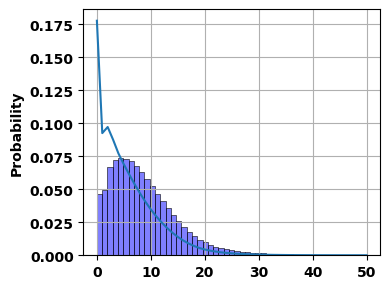

In [6]:
depth_1 = np.concatenate((df.q_ask1.to_numpy(), df.q_bid1.to_numpy()))
# depth_2 = np.concatenate((df.q_ask2.to_numpy(), df.q_bid2.to_numpy()))
# depth_3 = np.concatenate((df.q_ask3.to_numpy(), df.q_bid3.to_numpy()))

pi = np.load('calibration_data/invariant_distribution/qrm_paper.npy')
plt.plot(pi[0])
sns.histplot(depth_1, bins=51, stat='probability', label='Depth 1', color='blue', alpha=0.5)
# sns.histplot(depth_2, bins=51, stat='probability', label='Depth 2', color='orange', alpha=0.5)
# sns.histplot(depth_3, bins=51, stat='probability', label='Depth 3', color='green', alpha=0.5)

<Axes: ylabel='Probability'>

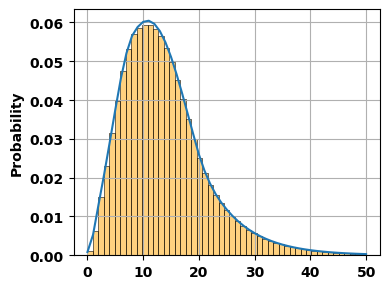

In [7]:
depth_2 = np.concatenate((df.q_ask2.to_numpy(), df.q_bid2.to_numpy()))

pi = np.load('calibration_data/invariant_distribution/qrm_paper.npy')
plt.plot(pi[1])
sns.histplot(depth_2, bins=51, stat='probability', label='Depth 2', color='orange', alpha=0.5)

<Axes: ylabel='Probability'>

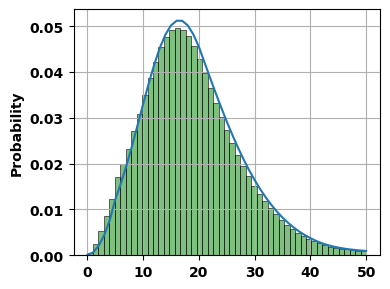

In [8]:
depth_3 = np.concatenate((df.q_ask3.to_numpy(), df.q_bid3.to_numpy()))

pi = np.load('calibration_data/invariant_distribution/qrm_paper.npy')
plt.plot(pi[2])
sns.histplot(depth_3, bins=51, stat='probability', label='Depth 3', color='green', alpha=0.5)

### Constant : ($\theta=0.7, \theta^{reinit}=0.6$)

prices stay at same level after buying the best ask

In [ ]:
# pd.set_option("mode.dtype_backend", "pyarrow")
df = pd.read_parquet('simulations/lob_constant.parquet')
print(len(df))
df.head()

64767610


,time,p_mid,side,event,q_bid3,q_bid2,q_bid1,q_ask1,q_ask2,q_ask3
0,3.460748e-02,100.005,bid,limit,23,29,3,5,7,11
1,2.097439e-01,100.005,bid,cancel,23,28,3,5,7,11
2,2.188706e-01,100.005,bid,cancel,23,27,3,5,7,11
3,2.804118e-01,100.005,ask,limit,23,27,3,5,7,12
4,3.085297e-01,100.005,bid,cancel,23,26,3,5,7,12
...,...,...,...,...,...,...,...,...,...,...
64767605,9.999998e+06,104.800,ask,limit,8,46,0,1,11,25
64767606,9.999999e+06,104.800,bid,limit,8,47,0,1,11,25
64767607,9.999999e+06,104.805,ask,cancel,8,47,0,0,11,25
64767608,9.999999e+06,104.805,ask,cancel,8,47,0,0,11,24


In [66]:
len(df[df.event == 'market']), len(df[df.event == 'market']) / len(df) * 100

(2095614, 3.235589517661683)

In [67]:
import numpy as np
import pandas as pd

def extract_market_orders(df: pd.DataFrame, price_col: str = "price") -> pd.DataFrame:
    """
    Returns a DataFrame with:
      - time:      event time of each market order
      - sign:      +1 if side=='ask' (buy MKT), -1 if side=='bid' (sell MKT)
      - price_prev:price just BEFORE the market order (previous row's price)

    Assumes df has columns: 'time' (float), 'event' (str), 'side' (str), and the given price_col.
    """

    if price_col not in df.columns:
        raise ValueError(f"'{price_col}' not found in DataFrame columns: {df.columns.tolist()}")

    # Previous price for each row (price just before current event)
    df["price_prev"] = df[price_col].shift(1)

    # Filter market orders
    mo = df.loc[df["event"] == "market", ["time", "side", "price_prev"]].copy()

    # Trade sign: buy at ask => +1, sell at bid => -1
    mo["sign"] = np.where(mo["side"] == "ask",  +1,
                  np.where(mo["side"] == "bid", -1, np.nan))

    # Keep only required columns; drop rows where previous price is unavailable (first row edge case)
    mo = mo.dropna(subset=["price_prev"])[["time", "sign", "price_prev"]]

    return mo

In [68]:
market_df = extract_market_orders(df, price_col="p_mid")
market_df.head()

,time,sign,price_prev
75,12.036351,-1.0,100.005
90,13.879564,1.0,100.005
145,21.808605,-1.0,100.010
157,23.924815,-1.0,100.005
185,28.420449,-1.0,100.015


In [69]:
market_df.to_parquet(
        "simulations/trades_constant.parquet",
        engine="pyarrow",
        compression="zstd",    
        index=False
    )

### Permanent : ($\theta=0.9, \theta^{reinit}=0.6$)

prices continue to increase after buying the ask

In [6]:
# pd.set_option("mode.dtype_backend", "pyarrow")
df = pd.read_parquet('simulations/lob_permanent.parquet')
print(len(df))
df.head()

65103047


,time,p_mid,side,event,q_bid3,q_bid2,q_bid1,q_ask1,q_ask2,q_ask3
0,0.034607,100.005,bid,limit,23,29,3,5,7,11
1,0.209744,100.005,bid,cancel,23,28,3,5,7,11
2,0.218871,100.005,bid,cancel,23,27,3,5,7,11
3,0.280412,100.005,ask,limit,23,27,3,5,7,12
4,0.308530,100.005,bid,cancel,23,26,3,5,7,12


In [4]:
len(df[df.event == 'market']), len(df[df.event == 'market']) / len(df) * 100

(2101655, 3.22819759880056)

In [5]:
import numpy as np
import pandas as pd

def extract_market_orders(df: pd.DataFrame, price_col: str = "price") -> pd.DataFrame:
    """
    Returns a DataFrame with:
      - time:      event time of each market order
      - sign:      +1 if side=='ask' (buy MKT), -1 if side=='bid' (sell MKT)
      - price_prev:price just BEFORE the market order (previous row's price)

    Assumes df has columns: 'time' (float), 'event' (str), 'side' (str), and the given price_col.
    """

    if price_col not in df.columns:
        raise ValueError(f"'{price_col}' not found in DataFrame columns: {df.columns.tolist()}")

    # Previous price for each row (price just before current event)
    df["price_prev"] = df[price_col].shift(1)

    # Filter market orders
    mo = df.loc[df["event"] == "market", ["time", "side", "price_prev"]].copy()

    # Trade sign: buy at ask => +1, sell at bid => -1
    mo["sign"] = np.where(mo["side"] == "ask",  +1,
                  np.where(mo["side"] == "bid", -1, np.nan))

    # Keep only required columns; drop rows where previous price is unavailable (first row edge case)
    mo = mo.dropna(subset=["price_prev"])[["time", "sign", "price_prev"]]

    return mo

In [7]:
market_df = extract_market_orders(df, price_col="p_mid")
market_df.head()

,time,sign,price_prev
75,12.036351,-1.0,100.005
90,13.879564,1.0,100.005
138,21.498711,-1.0,100.005
153,23.221552,-1.0,100.005
170,26.111982,1.0,100.005


In [8]:
market_df.to_parquet(
        "simulations/trades_permanent.parquet",
        engine="pyarrow",
        compression="zstd",    
        index=False
    )

## Length of runs

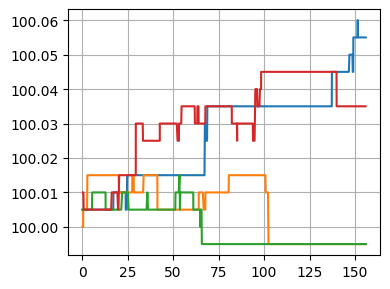

In [2]:
df1 = pd.read_parquet('simulations/t1.parquet')
plt.plot(df1.time, df1.p_mid)
df2 = pd.read_parquet('simulations/t2.parquet')
plt.plot(df2.time, df2.p_mid)
df3 = pd.read_parquet('simulations/t3.parquet')
plt.plot(df3.time, df3.p_mid)
df4 = pd.read_parquet('simulations/t4.parquet')
plt.plot(df4.time, df4.p_mid)

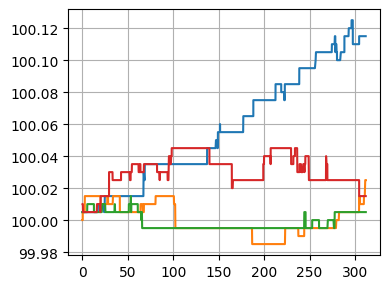

: 

In [ ]:
df1 = pd.read_parquet('simulations/t1_2.parquet')
plt.plot(df1.time, df1.p_mid)
df2 = pd.read_parquet('simulations/t2_2.parquet')
plt.plot(df2.time, df2.p_mid)
df3 = pd.read_parquet('simulations/t3_2.parquet')
plt.plot(df3.time, df3.p_mid)
df4 = pd.read_parquet('simulations/t4_2.parquet')
plt.plot(df4.time, df4.p_mid)

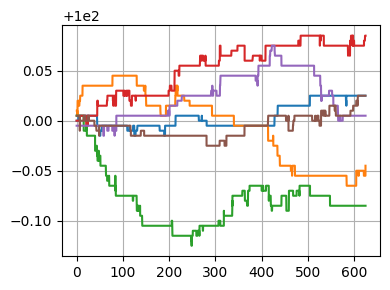

: 

In [ ]:
df1 = pd.read_parquet('simulations/t1_3.parquet')
plt.plot(df1.time, df1.p_mid)
df2 = pd.read_parquet('simulations/t2_3.parquet')
plt.plot(df2.time, df2.p_mid)
df3 = pd.read_parquet('simulations/t3_3.parquet')
plt.plot(df3.time, df3.p_mid)
df4 = pd.read_parquet('simulations/t4_3.parquet')
plt.plot(df4.time, df4.p_mid)
df5 = pd.read_parquet('simulations/t5_3.parquet')
plt.plot(df5.time, df5.p_mid)
df6 = pd.read_parquet('simulations/t6_3.parquet')
plt.plot(df6.time, df6.p_mid)

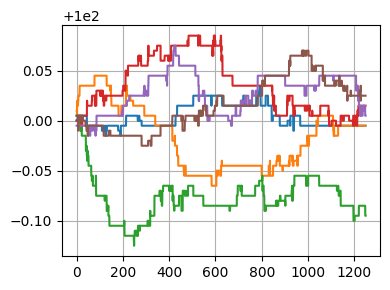

: 

In [ ]:
df1 = pd.read_parquet('simulations/t1_4.parquet')
plt.plot(df1.time, df1.p_mid)
df2 = pd.read_parquet('simulations/t2_4.parquet')
plt.plot(df2.time, df2.p_mid)
df3 = pd.read_parquet('simulations/t3_4.parquet')
plt.plot(df3.time, df3.p_mid)
df4 = pd.read_parquet('simulations/t4_4.parquet')
plt.plot(df4.time, df4.p_mid)
df5 = pd.read_parquet('simulations/t5_4.parquet')
plt.plot(df5.time, df5.p_mid)
df6 = pd.read_parquet('simulations/t6_4.parquet')
plt.plot(df6.time, df6.p_mid)

## NN

In [ ]:
# --- Imports that can vary by version ---
import numpy as np
import torch
import torch.nn as nn

# SB3
from stable_baselines3 import DQN
from stable_baselines3.common.callbacks import BaseCallback

# Try make_vec_env; if unavailable, define a simple fallback
try:
    from stable_baselines3.common.env_util import make_vec_env
    HAVE_MAKE_VEC_ENV = True
except Exception:
    HAVE_MAKE_VEC_ENV = False

# Gymnasium
import gymnasium as gym


# ---------- Metric buffer ----------
class MetricStore:
    def __init__(self):
        self.global_step = []
        self.td_loss = []
        self.q_mean = []
        self.q_std = []
        self.act_mean = {}
        self.act_std = {}
        self.w_norm = {}
        self.g_norm = {}

    def _ensure_key(self, d, k):
        if k not in d:
            d[k] = []

    def push_scalar(self, step, td_loss=None, q_mean=None, q_std=None):
        self.global_step.append(int(step))
        self.td_loss.append(float(td_loss) if td_loss is not None else np.nan)
        self.q_mean.append(float(q_mean) if q_mean is not None else np.nan)
        self.q_std.append(float(q_std) if q_std is not None else np.nan)


# ---------- Hooks ----------
def register_activation_hooks(module: nn.Module, store: MetricStore, prefix: str = ""):
    # Graceful no-op if the module is None or not a torch module
    if module is None or not isinstance(module, nn.Module):
        return
    for name, m in module.named_modules():
        if isinstance(m, nn.Linear):
            key = f"{prefix}{name}"
            store._ensure_key(store.act_mean, key)
            store._ensure_key(store.act_std, key)

            def fwd_hook(mod, inp, out, key=key):
                with torch.no_grad():
                    a = out[0] if isinstance(out, (tuple, list)) else out
                    a = a.detach()
                    store.act_mean[key].append(a.mean().item())
                    store.act_std[key].append(a.std(unbiased=False).item())

            m.register_forward_hook(fwd_hook)


def record_weight_and_grad_norms(module: nn.Module, store: MetricStore, prefix: str = ""):
    if module is None or not isinstance(module, nn.Module):
        return
    for name, m in module.named_modules():
        if isinstance(m, nn.Linear):
            key = f"{prefix}{name}"
            if key not in store.w_norm:
                store.w_norm[key] = []
            if key not in store.g_norm:
                store.g_norm[key] = []
            W = m.weight.detach()
            store.w_norm[key].append(W.norm().item())
            if m.weight.grad is not None:
                store.g_norm[key].append(m.weight.grad.detach().norm().item())
            else:
                store.g_norm[key].append(np.nan)


# ---------- Utility: find the Q network module safely ----------
def _get_q_network(policy) -> nn.Module:
    """
    Try common policy attributes first (older/newer SB3 variants).
    """
    for attr in ["q_net", "q_network", "qf", "q_net_online"]:
        if hasattr(policy, attr) and isinstance(getattr(policy, attr), nn.Module):
            return getattr(policy, attr)
    # fallback: look for a big Sequential with Linear inside
    for _, m in policy.named_modules():
        if isinstance(m, nn.Sequential) and any(isinstance(x, nn.Linear) for x in m):
            return m
    raise AttributeError("Could not find a Q-network module on the policy.")


def _locate_q_network(model) -> nn.Module:
    """
    Robust locator: check the model first (some SB3 versions place it here),
    then the policy, then scan.
    """
    for attr in ["q_net", "q_network", "qf", "q_net_online"]:
        if hasattr(model, attr) and isinstance(getattr(model, attr), nn.Module):
            return getattr(model, attr)
    policy = getattr(model, "policy", None)
    if policy is not None and isinstance(policy, nn.Module):
        try:
            return _get_q_network(policy)
        except Exception:
            pass
    # final fallback: scan everything for a Sequential with Linear
    for _, m in model.named_modules():
        if isinstance(m, nn.Sequential) and any(isinstance(x, nn.Linear) for x in m):
            return m
    raise AttributeError("Could not find a Q-network on model or policy.")


# ---------- Metrics callback (version-tolerant) ----------
class MetricsCallback(BaseCallback):
    def __init__(self, store: MetricStore, verbose=0):
        super().__init__(verbose)
        self.store = store
        self._q_net = None

    def _on_training_start(self):
        # features_extractor may be None or not a Module on some builds
        fx = getattr(self.model.policy, "features_extractor", None)
        if isinstance(fx, nn.Module):
            register_activation_hooks(fx, self.store, prefix="feat.")
        # Q net (we always try to hook this)
        try:
            self._q_net = _locate_q_network(self.model)
            register_activation_hooks(self._q_net, self.store, prefix="qnet.")
        except Exception as e:
            if self.verbose:
                print(f"[MetricsCallback] Q-net not found: {e}")
        return None

    def _on_step(self) -> bool:
        step = int(self.model.num_timesteps)
        td_loss = np.nan; q_mean = np.nan; q_std = np.nan
        log_dict = {}
        if hasattr(self.model.logger, "get_log_dict"):
            log_dict = self.model.logger.get_log_dict()
        elif hasattr(self.model.logger, "name_to_value"):
            log_dict = self.model.logger.name_to_value

        for k in ("train/td_loss", "train/loss", "loss"):
            if k in log_dict: td_loss = log_dict[k]; break
        for k in ("train/q_mean", "train/q_values_mean", "train/q_mean_value"):
            if k in log_dict: q_mean = log_dict[k]; break
        for k in ("train/q_std", "train/q_values_std"):
            if k in log_dict: q_std = log_dict[k]; break

        fx = getattr(self.model.policy, "features_extractor", None)
        if isinstance(fx, nn.Module):
            record_weight_and_grad_norms(fx, self.store, prefix="feat.")
        if self._q_net is not None:
            record_weight_and_grad_norms(self._q_net, self.store, prefix="qnet.")

        self.store.push_scalar(step, td_loss=td_loss, q_mean=q_mean, q_std=q_std)
        return True


# ---------- Baseline runner (version-tolerant env creation) ----------
def _make_env(seed: int):
    if HAVE_MAKE_VEC_ENV:
        return make_vec_env("CartPole-v1", n_envs=1, seed=seed)
    # Fallback: plain gymnasium env (SB3 will wrap it as VecEnv internally)
    return gym.make("CartPole-v1")

def run_baseline(total_timesteps=1000, seed=0):
    env = _make_env(seed)

    policy_kwargs = dict(
        net_arch=[30, 30, 30, 30, 30],
        activation_fn=nn.LeakyReLU,
        # keep ortho_init default for "plain" baseline behavior
    )

    model = DQN(
        policy="MlpPolicy",
        env=env,
        learning_rate=3e-4,
        buffer_size=50_000,
        learning_starts=500,
        batch_size=128,
        tau=1.0,
        gamma=0.99,
        train_freq=4,
        gradient_steps=1,
        target_update_interval=1_000,
        exploration_initial_eps=1.0,
        exploration_final_eps=0.05,
        exploration_fraction=0.2,
        policy_kwargs=policy_kwargs,
        seed=seed,
        verbose=0,
    )

    store = MetricStore()
    cb = MetricsCallback(store, verbose=1)

    # SB3<2.0 has no progress_bar; call learn defensively
    try:
        model.learn(total_timesteps=total_timesteps, callback=cb, progress_bar=True)
    except TypeError:
        model.learn(total_timesteps=total_timesteps, callback=cb)

    return model, store


# ---- Run
baseline_model, baseline_store = run_baseline(total_timesteps=1000, seed=0)

Output()

In [16]:
baseline_model.logger.name_to_value['train/loss']

np.float64(0.5872596502304077)

Available activation layers: ['qnet.q_net.0', 'qnet.q_net.2', 'qnet.q_net.4', 'qnet.q_net.6', 'qnet.q_net.8', 'qnet.q_net.10']
Available weight-norm layers: ['qnet.q_net.0', 'qnet.q_net.2', 'qnet.q_net.4', 'qnet.q_net.6', 'qnet.q_net.8', 'qnet.q_net.10']
Available grad-norm layers: ['qnet.q_net.0', 'qnet.q_net.2', 'qnet.q_net.4', 'qnet.q_net.6', 'qnet.q_net.8', 'qnet.q_net.10']


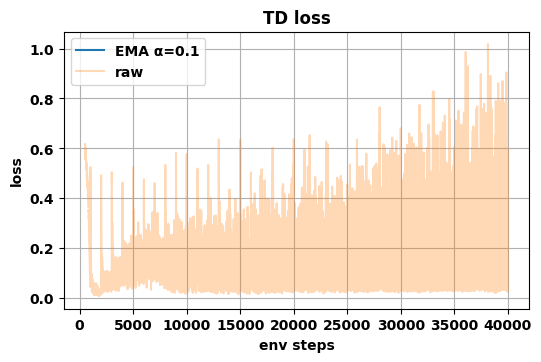

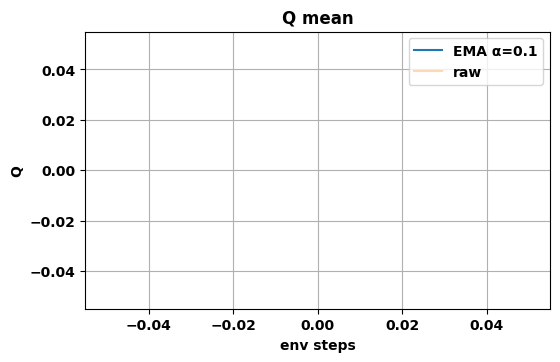

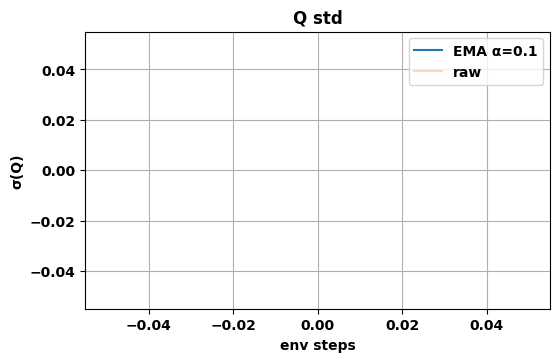

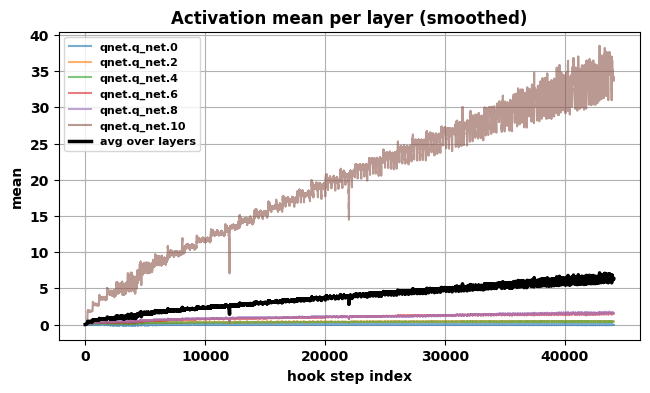

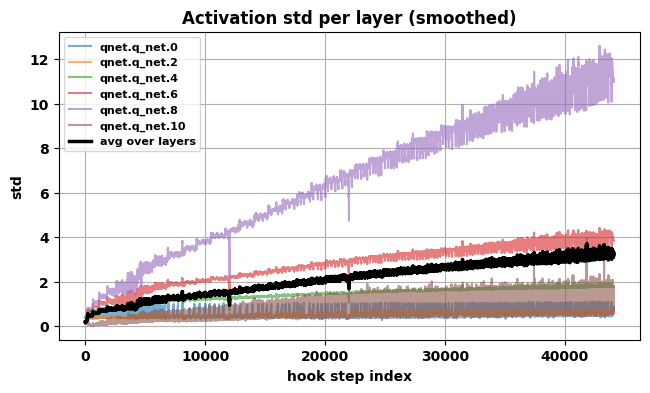

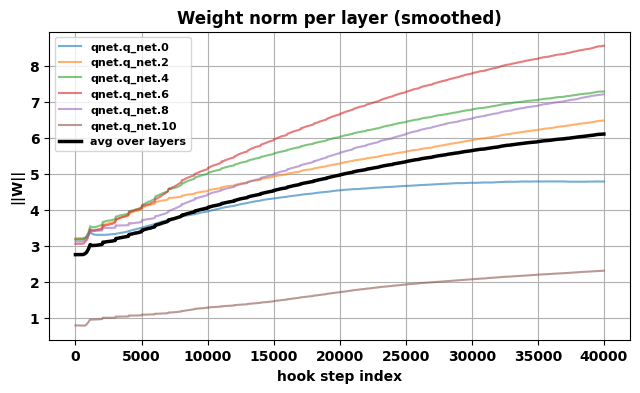

C:\Users\etoma\AppData\Local\Temp\ipykernel_3320\2759220083.py:41: RuntimeWarning: Mean of empty slice
  avg = np.nanmean(A, axis=0)


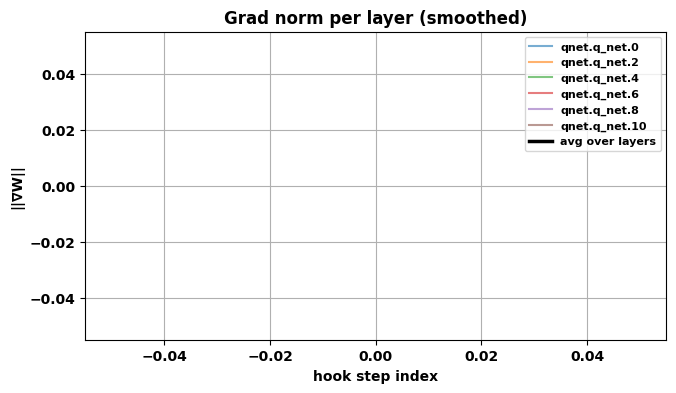

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from typing import Dict, List

# --- Small helpers ---
def ema(x, alpha=0.1):
    if len(x) == 0: return np.array([])
    y = np.array(x, dtype=float).copy()
    for i in range(1, len(y)):
        y[i] = alpha*y[i] + (1-alpha)*y[i-1]
    return y

def _plot_scalar(steps, y, title, ylabel, smooth=None):
    y = np.array(y, dtype=float)
    plt.figure(figsize=(6,3.6))
    if smooth is not None:
        ys = ema(y, alpha=smooth)
        plt.plot(steps, ys, label=f"EMA α={smooth}")
        plt.plot(steps, y, alpha=0.3, label="raw")
        plt.legend()
    else:
        plt.plot(steps, y)
    plt.title(title); plt.xlabel("env steps"); plt.ylabel(ylabel); plt.grid(True)
    plt.show()

def _plot_dict_series(steps, d: Dict[str, List[float]], title, ylabel, smooth=None, max_layers=8):
    """Plot up to `max_layers` per-layer curves + their average."""
    if not d:
        print(f"[skip] no data for: {title}")
        return
    # Align by padding with NaN and compute average
    L = max(len(v) for v in d.values())
    keys = list(d.keys())[:max_layers]
    A = []
    for k in d:
        v = np.array(d[k], dtype=float)
        if len(v) < L:
            v = np.concatenate([v, np.full(L-len(v), np.nan)])
        A.append(v)
    A = np.vstack(A)
    avg = np.nanmean(A, axis=0)

    plt.figure(figsize=(7.5,4.0))
    for k in keys:
        y = np.array(d[k], dtype=float)
        if smooth is not None:
            y = ema(y, alpha=smooth)
        plt.plot(y, alpha=0.6, label=k if len(keys) <= 8 else None)
    if smooth is not None:
        avg = ema(avg, alpha=smooth)
    plt.plot(avg, linewidth=2.5, label="avg over layers", color="k")
    plt.title(title + (" (smoothed)" if smooth else ""))
    plt.xlabel("hook step index"); plt.ylabel(ylabel); plt.grid(True)
    if len(keys) <= 8: plt.legend(loc="best", fontsize=8)
    plt.show()

# --- Quick inventory of what you captured ---
print("Available activation layers:", list(baseline_store.act_mean.keys()))
print("Available weight-norm layers:", list(baseline_store.w_norm.keys()))
print("Available grad-norm layers:", list(baseline_store.g_norm.keys()))

# --- Scalars logged per env step ---
steps = np.array(baseline_store.global_step, dtype=int)

_plot_scalar(steps, baseline_store.td_loss, "TD loss", "loss", smooth=0.1)
_plot_scalar(steps, baseline_store.q_mean,  "Q mean",  "Q",    smooth=0.1)
_plot_scalar(steps, baseline_store.q_std,   "Q std",   "σ(Q)", smooth=0.1)

# --- Per-layer series (index is “hook call index”, not env step) ---
_plot_dict_series(steps=None, d=baseline_store.act_mean, title="Activation mean per layer", ylabel="mean", smooth=0.2)
_plot_dict_series(steps=None, d=baseline_store.act_std,  title="Activation std per layer",  ylabel="std",  smooth=0.2)
_plot_dict_series(steps=None, d=baseline_store.w_norm,   title="Weight norm per layer",     ylabel="||W||", smooth=0.2)
_plot_dict_series(steps=None, d=baseline_store.g_norm,   title="Grad norm per layer",       ylabel="||∇W||", smooth=0.2)


In [3]:
model

NameError: name 'model' is not defined

# Trajectory mid price graph

In [2]:
import pandas as pd
import matplotlib.pyplot as plt

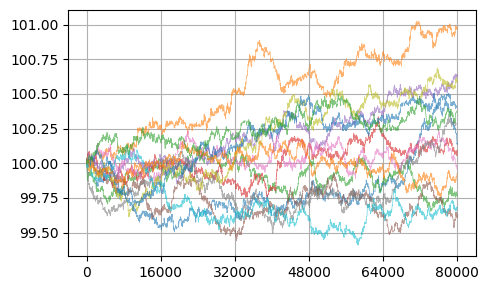

: 

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

plt.figure(figsize=(5,3))

for i in range(1,15):
    df1 = pd.read_parquet(f'simulations/paper_{i}.parquet')
    if df1.p_mid.min() > 99:
        plt.plot(df1.time, df1.p_mid, linewidth=0.5, alpha=0.6)

ax = plt.gca()
N = 80_000              # or your max step
ticks = np.linspace(0, N, 6, dtype=int)  # 6 ticks
ax.set_xticks(ticks)
plt.grid()
plt.tight_layout()
plt.savefig('./plots/price_paths.pdf', bbox_inches='tight')